## This is a note experimenting on the inconsistency issue of LIME and how BayLIME (with 3 options) improves on it 

In [1]:
import sys
sys.path.append("..")# allow the notebook to find the parent folder
from sklearn.datasets import load_boston,load_breast_cancer
import sklearn.ensemble
import sklearn.linear_model
import sklearn.model_selection
import numpy as np
from sklearn.metrics import r2_score
np.random.seed(1)
import lime
import lime.lime_tabular
from lime import submodular_pick
from lime import calculate_posteriors
import csv
import math


#load example dataset
boston = load_boston()
#cancer= load_breast_cancer()

#print a description of the variables
print(boston.DESCR)
#print(cancer.DESCR)

#train a regressor
rf = sklearn.ensemble.RandomForestRegressor(n_estimators=1000)
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(boston.data, boston.target, train_size=0.80, test_size=0.20)
rf.fit(train, labels_train);

#train a classifier
# rf = sklearn.ensemble.RandomForestClassifier(n_estimators=1000)
# train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(cancer.data, cancer.target, train_size=0.80, test_size=0.20)
# rf.fit(train, labels_train);






.. _boston_dataset:

Boston house prices dataset
---------------------------

**Data Set Characteristics:**  

    :Number of Instances: 506 

    :Number of Attributes: 13 numeric/categorical predictive. Median Value (attribute 14) is usually the target.

    :Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres
        - RAD      index of accessibility to radial highways
        - TAX      full-value property-tax rate per $10,000
        - PTRATIO  pu

In [2]:
# generate an "explainer" object
categorical_features  = np.argwhere(np.array([len(set(boston.data[:,x])) for x in range(boston.data.shape[1])]) <= 10).flatten()


explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=boston.feature_names, 
                                                   class_names=['price'], categorical_features=categorical_features, 
                                                    verbose=False, mode='regression',
                                                   discretize_continuous=False,feature_selection='none',
                                                   sample_around_instance=False)

# An example of classifier, rather than regressor...
# categorical_features = np.argwhere(np.array([len(set(cancer.data[:,x])) for x in range(cancer.data.shape[1])]) <= 10).flatten()

# explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=cancer.feature_names, 
#                                                    categorical_features=categorical_features, 
#                                                    class_names=cancer.target_names,
#                                                    verbose=False, mode='classification',
#                                                    discretize_continuous=False,
#                                                    feature_selection='none')


#generate an explanation for testing..
instance = 3
#use rf.predict_proba for classfication 
exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                 model_regressor='Bay_non_info_prior',
                                 num_samples=100,
                                 #labels=labels_test[i],
                                 )#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior'

exp.show_in_notebook(show_table=True)
#fig = exp.as_pyplot_figure(label=1)



print(exp.as_list())
#fig = exp.as_pyplot_figure(label=2)

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2821837772437905
the lambda is 0.5487903510433139
the regulation term lambda/alpha is 1.9447976648536767


[('LSTAT', -3.7117749701142193), ('RM', 1.8850031611392262), ('DIS', -1.0574761832021675), ('INDUS', -0.7839854507722949), ('TAX', -0.7446005752975973), ('NOX', -0.5775207670268152), ('CRIM', 0.5404029713137755), ('AGE', -0.40338448542779126), ('CHAS=0', -0.3850283021298633), ('RAD=4', -0.3007915034372075), ('B', -0.2110945112354009), ('ZN', -0.12024413153519864), ('PTRATIO', -0.06444912186641441)]


In [3]:
exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                  model_regressor='BayesianRidge_inf_prior_fit_alpha',
                                  num_samples=100,
                                  #labels=labels_test[i],
                                  top_labels=1)
#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior', 'BayesianRidge_inf_prior_fit_alpha'
  

alpha_init=1
lambda_init=1
with open('.\posterior_configure.csv') as csv_file:
    csv_reader=csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count == 1:
            alpha_init=float(row[0])
            lambda_init=float(row[1])
        line_count=line_count+1

exp.show_in_notebook(show_table=True)

exp=calculate_posteriors.get_posterior(exp,'.\data\prior_knowledge_tabular.csv',hyper_para_alpha=alpha_init, hyper_para_lambda=lambda_init,
                                        label=1)

exp.show_in_notebook(show_table=True)

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.113474180561117
the lambda is 20.0
the regulation term lambda/alpha is 176.25154815925757


In [4]:
exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                  model_regressor='Bay_info_prior',
                                  num_samples=100,
                                  #labels=labels_test[i],
                                  top_labels=1)
#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior', 'BayesianRidge_inf_prior_fit_alpha'
  

alpha_init=1
lambda_init=1
with open('.\posterior_configure.csv') as csv_file:
    csv_reader=csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count == 1:
            alpha_init=float(row[0])
            lambda_init=float(row[1])
        line_count=line_count+1

exp.show_in_notebook(show_table=True)

exp=calculate_posteriors.get_posterior(exp,'.\data\prior_knowledge_tabular.csv',hyper_para_alpha=alpha_init, hyper_para_lambda=lambda_init,
                                        label=1)

exp.show_in_notebook(show_table=True)

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


In [5]:
exp.as_list()

[('LSTAT', -4.574269203719008),
 ('RM', 1.7203511978075454),
 ('DIS', -1.3533428321434107),
 ('PTRATIO', -0.3757520330750844),
 ('TAX', -0.2934330625075643),
 ('RAD=4', -0.2809675686099691),
 ('B', 0.247792931167461),
 ('CHAS=0', -0.1807569361402992),
 ('ZN', -0.17834242928188765),
 ('NOX', -0.09198945800501514),
 ('CRIM', 0.08136795875849968),
 ('INDUS', 0.06967150517368757),
 ('AGE', 0.011447210336717938)]

In [6]:
k=3#number of explanations 
m=13# number of features
i=1
instance=3
explanations=np.array([])
while i<=k:
    exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                 model_regressor='Bay_non_info_prior',
                                 num_samples=100,
                                 #labels=labels_test[i],
                                 )#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior' 'BayesianRidge_inf_prior_fit_alpha'
    temp_list=exp.as_list()
    temp_array = np.array(temp_list)
    explanations=np.append(explanations,temp_array)
    i=i+1

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.3756786550639776
the lambda is 0.5513220738128569
the regulation term lambda/alpha is 1.4675363276068147
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.251708090554997
the lambda is 0.4811493752952507
the regulation term lambda/alpha is 1.9115371867243254
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3571166937389321
the lambda is 0.4782801736792113
the regulation term lambda/alpha is 1.3392825988382804


In [7]:
exps=explanations.reshape(k,2*m)# k exps, 13 features for this instance.. 

In [8]:
for exp in exps:
    #print(exp)
    i=1
    temp_vector=np.array([])
    while i<=(2*m-1):
        temp_vector=np.append(temp_vector,float(exp[i]))
        i=i+2
    #print(temp_vector)
    normlised_temp_vector=temp_vector/np.linalg.norm(temp_vector)
    #print(normlised_temp_vector)
    i=1
    while i<=(2*m-1):
        exp[i]=normlised_temp_vector[math.floor(i/2)]
        i=i+2

In [9]:
print(exps)

[['LSTAT' '-0.8066048395873953' 'RM' '0.3534211584807102' 'CHAS=0'
  '-0.2663661763123778' 'PTRATIO' '-0.2158419330851548' 'DIS'
  '-0.20857729278264972' 'TAX' '-0.16094573807918228' 'B'
  '0.12007040620142352' 'RAD=4' '-0.093526812375778' 'NOX'
  '-0.08937232544222505' 'AGE' '-0.061692424471191394' 'INDUS'
  '-0.047648124966020264' 'CRIM' '0.013750802449920253' 'ZN'
  '-0.010883777345780431']
 ['LSTAT' '-0.8558428207529889' 'RM' '0.39307863466990733' 'DIS'
  '-0.17236990524108228' 'RAD=4' '-0.16419416610483534' 'PTRATIO'
  '-0.15618642661565546' 'AGE' '-0.13230554125748603' 'CRIM'
  '-0.08890840422960931' 'INDUS' '0.05939566627771297' 'TAX'
  '-0.04069523820258217' 'B' '-0.029790752966329173' 'NOX'
  '0.017320782793975' 'CHAS=0' '0.010967692662899329' 'ZN'
  '0.007466453018965512']
 ['LSTAT' '-0.8279838012542706' 'RM' '0.3399687523683637' 'DIS'
  '-0.33222481527283954' 'CRIM' '0.15326085484966467' 'INDUS'
  '-0.1492749068223042' 'TAX' '-0.14042791967863635' 'PTRATIO'
  '-0.10671159238

In [10]:
feature_names=np.array([])
i=0
while i<=(2*m-1):
    feature_names=np.append(feature_names,exps[0,i])
    i=i+2
print(feature_names)

['LSTAT' 'RM' 'CHAS=0' 'PTRATIO' 'DIS' 'TAX' 'B' 'RAD=4' 'NOX' 'AGE'
 'INDUS' 'CRIM' 'ZN']


In [11]:
def rankings_in_k_exp (feature, k_exps):
    ranks=np.array([])
    for exp in k_exps:
        rank=math.ceil(exp.tolist().index(feature)/2)+1
        ranks=np.append(ranks,rank)
    return ranks

print(rankings_in_k_exp('LSTAT',exps))

[1. 1. 1.]


In [12]:
def importance_in_k_exp (feature, k_exps):
    importance_s=np.array([])
    for exp in k_exps:
        importance=exp[exp.tolist().index(feature)+1]
        importance_s=np.append(importance_s,importance)
    return importance_s

print(importance_in_k_exp('INDUS',exps))

['-0.047648124966020264' '0.05939566627771297' '-0.1492749068223042']


In [13]:
g_i_s=np.array([])
f_i_s=np.array([])
for feature in feature_names:
    g_i=importance_in_k_exp(feature,exps)
    f_i=rankings_in_k_exp(feature,exps)
    g_i_s=np.append(g_i_s,g_i)
    f_i_s=np.append(f_i_s,f_i)
g_i_s=g_i_s.reshape(m,k)
f_i_s=f_i_s.reshape(m,k)
print(g_i_s)
print(f_i_s)

[['-0.8066048395873953' '-0.8558428207529889' '-0.8279838012542706']
 ['0.3534211584807102' '0.39307863466990733' '0.3399687523683637']
 ['-0.2663661763123778' '0.010967692662899329' '-0.0005426242287322127']
 ['-0.2158419330851548' '-0.15618642661565546' '-0.10671159238148356']
 ['-0.20857729278264972' '-0.17236990524108228' '-0.33222481527283954']
 ['-0.16094573807918228' '-0.04069523820258217' '-0.14042791967863635']
 ['0.12007040620142352' '-0.029790752966329173' '-0.006254311671579373']
 ['-0.093526812375778' '-0.16419416610483534' '-0.03734893906484879']
 ['-0.08937232544222505' '0.017320782793975' '-0.029190080405645042']
 ['-0.061692424471191394' '-0.13230554125748603' '0.04420364602374686']
 ['-0.047648124966020264' '0.05939566627771297' '-0.1492749068223042']
 ['0.013750802449920253' '-0.08890840422960931' '0.15326085484966467']
 ['-0.010883777345780431' '0.007466453018965512' '-0.0858551987939331']]
[[ 1.  1.  1.]
 [ 2.  2.  2.]
 [ 3. 12. 13.]
 [ 4.  5.  7.]
 [ 5.  3.  3.]
 

In [14]:
#now calculate the index of dispersion of ranks for each feature
IoD_f_i_s=np.array([])
for f_i in f_i_s:
    if np.mean(f_i)==0:
        IoD_f_i=0
        IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
    else:
        IoD_f_i=np.var(f_i)/np.mean(f_i)
        IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
print(IoD_f_i_s)

[0.         0.         2.16666667 0.29166667 0.24242424 0.28571429
 0.43678161 0.84848485 0.08602151 0.34666667 0.75       1.42028986
 0.49019608]


In [15]:
#now calculate the weighted importance for each feature
weights_g_i_s=np.array([])
for g_i in g_i_s:
    weight=np.mean(abs(g_i.astype(np.float)))
    weights_g_i_s=np.append(weights_g_i_s,weight)
weights_g_i_s=weights_g_i_s/sum(weights_g_i_s)
print(weights_g_i_s)

[0.36460607 0.15906201 0.04068189 0.07008886 0.10441036 0.05007983
 0.02285574 0.04319905 0.01989368 0.03487338 0.03752577 0.03746741
 0.01525596]


In [16]:
np.dot(weights_g_i_s,IoD_f_i_s)

0.2974815493882417

In [17]:
def kendall_w(expt_ratings):
    if expt_ratings.ndim!=2:
        raise 'ratings matrix must be 2-dimensional'
    m = expt_ratings.shape[0] #raters
    n = expt_ratings.shape[1] # items rated
    denom = m**2*(n**3-n)
    rating_sums = np.sum(expt_ratings, axis=0)
    S = n*np.var(rating_sums)
    return 12*S/denom

In [18]:
ken_w=kendall_w(f_i_s.T)
print(ken_w)

0.663003663003663


## Now we have shown a toy example of calculating the inconsistency of k explanations for a given number of samples, while we want to see inconsistency as a function of the number of samples... Let us do it now...

In [19]:
n=10 #number of samples
inconsistency_non_info=np.array([])
ken_w_non_info=np.array([])
while n<=2000:


    k=100#number of explanations 
    m=13# number of features
    i=1
    instance=3
    explanations=np.array([])
    while i<=k:
        exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                         model_regressor='Bay_non_info_prior',
                                         num_samples=n)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior' 'BayesianRidge_inf_prior_fit_alpha'
        temp_list=exp.as_list()
        temp_array = np.array(temp_list)
        explanations=np.append(explanations,temp_array)
        i=i+1
    exps=explanations.reshape(k,2*m)# k exps, 13 features for this instance.. 
    for exp in exps:
    #print(exp)
        i=1
        temp_vector=np.array([])
        while i<=(2*m-1):
            temp_vector=np.append(temp_vector,float(exp[i]))
            i=i+2
    #print(temp_vector)
        normlised_temp_vector=temp_vector/np.linalg.norm(temp_vector)
    #print(normlised_temp_vector)
        i=1
        while i<=(2*m-1):
            exp[i]=normlised_temp_vector[math.floor(i/2)]
            i=i+2
    feature_names=np.array([])
    i=0
    while i<=(2*m-1):
        feature_names=np.append(feature_names,exps[0,i])
        i=i+2
    
    g_i_s=np.array([])
    f_i_s=np.array([])
    for feature in feature_names:
        g_i=importance_in_k_exp(feature,exps)
        f_i=rankings_in_k_exp(feature,exps)
        g_i_s=np.append(g_i_s,g_i)
        f_i_s=np.append(f_i_s,f_i)
    g_i_s=g_i_s.reshape(m,k)
    f_i_s=f_i_s.reshape(m,k)
    IoD_f_i_s=np.array([])
    for f_i in f_i_s:
        if np.mean(f_i)==0:
            IoD_f_i=0
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
        else:
            IoD_f_i=np.var(f_i)/np.mean(f_i)
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
    weights_g_i_s=np.array([])
    for g_i in g_i_s:
        weight=np.mean(abs(g_i.astype(np.float)))
        weights_g_i_s=np.append(weights_g_i_s,weight)
    weights_g_i_s=weights_g_i_s/sum(weights_g_i_s)
    
    inconsistency_non_info=np.append(inconsistency_non_info,np.dot(weights_g_i_s,IoD_f_i_s))
    
    ken_w_non_info=np.append(ken_w_non_info,kendall_w(f_i_s.T))
    
    print(n)
    n=n+10

using Bay_non_info_prior option for model regressor
Convergence after  14  iterations
the alpha is 500001.23715843813
the lambda is 0.16278626887760012
the regulation term lambda/alpha is 3.2557173218756883e-07
using Bay_non_info_prior option for model regressor
Convergence after  30  iterations
the alpha is 0.19671090813521402
the lambda is 2.1581111584030457
the regulation term lambda/alpha is 10.970978573895941
using Bay_non_info_prior option for model regressor
Convergence after  30  iterations
the alpha is 0.29337017323318254
the lambda is 1039.1583278213554
the regulation term lambda/alpha is 3542.140349064696
using Bay_non_info_prior option for model regressor
Convergence after  23  iterations
the alpha is 499999.5676290682
the lambda is 0.27653036540013287
the regulation term lambda/alpha is 5.530612090554463e-07
using Bay_non_info_prior option for model regressor
Convergence after  23  iterations
the alpha is 1.0813439765546673
the lambda is 0.18360972402138065
the regulation 

using Bay_non_info_prior option for model regressor
Convergence after  14  iterations
the alpha is 500000.4381993502
the lambda is 0.3151792020470471
the regulation term lambda/alpha is 6.303578516492922e-07
using Bay_non_info_prior option for model regressor
Convergence after  26  iterations
the alpha is 499999.58017165464
the lambda is 0.19017024290924311
the regulation term lambda/alpha is 3.80340805174188e-07
using Bay_non_info_prior option for model regressor
Convergence after  21  iterations
the alpha is 499996.89281620213
the lambda is 0.4736973563751563
the regulation term lambda/alpha is 9.47400600245903e-07
using Bay_non_info_prior option for model regressor
Convergence after  10  iterations
the alpha is 500000.2482837201
the lambda is 0.8471865617034418
the regulation term lambda/alpha is 1.6943722820367765e-06
using Bay_non_info_prior option for model regressor
Convergence after  43  iterations
the alpha is 500000.07873747754
the lambda is 0.43288854577529123
the regulation

using Bay_non_info_prior option for model regressor
Convergence after  16  iterations
the alpha is 500001.9974061091
the lambda is 0.18289561400606807
the regulation term lambda/alpha is 3.657897667507066e-07
using Bay_non_info_prior option for model regressor
Convergence after  22  iterations
the alpha is 500000.65924527374
the lambda is 0.10252853437015697
the regulation term lambda/alpha is 2.0505679837486358e-07
using Bay_non_info_prior option for model regressor
Convergence after  67  iterations
the alpha is 0.8658517676798821
the lambda is 0.2531838740335146
the regulation term lambda/alpha is 0.2924101832256354
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 500004.92871174414
the lambda is 0.5360551097844084
the regulation term lambda/alpha is 1.072099651428531e-06
using Bay_non_info_prior option for model regressor
Convergence after  312  iterations
the alpha is 2.7172305263406744
the lambda is 4.481676165582559
the regulation 

using Bay_non_info_prior option for model regressor
Convergence after  17  iterations
the alpha is 0.8040198180770426
the lambda is 0.26864695918978027
the regulation term lambda/alpha is 0.33412977286094464
using Bay_non_info_prior option for model regressor
Convergence after  11  iterations
the alpha is 0.30518078637939855
the lambda is 0.3704665275849066
the regulation term lambda/alpha is 1.2139248082424996
using Bay_non_info_prior option for model regressor
Convergence after  23  iterations
the alpha is 0.45488482778427697
the lambda is 0.31335374468884564
the regulation term lambda/alpha is 0.6888639179617779
using Bay_non_info_prior option for model regressor
Convergence after  31  iterations
the alpha is 0.34502799110487475
the lambda is 1521.3461275256757
the regulation term lambda/alpha is 4409.341174476615
using Bay_non_info_prior option for model regressor
Convergence after  12  iterations
the alpha is 0.348580260533298
the lambda is 0.399900212607963
the regulation term la

using Bay_non_info_prior option for model regressor
Convergence after  12  iterations
the alpha is 1.0429359030506942
the lambda is 0.5802472948061704
the regulation term lambda/alpha is 0.5563594973659337
using Bay_non_info_prior option for model regressor
Convergence after  12  iterations
the alpha is 2.0094492754861473
the lambda is 0.3996275025377675
the regulation term lambda/alpha is 0.19887414298680686
using Bay_non_info_prior option for model regressor
Convergence after  18  iterations
the alpha is 0.28717918707898465
the lambda is 0.598804202925283
the regulation term lambda/alpha is 2.085123956982963
using Bay_non_info_prior option for model regressor
Convergence after  29  iterations
the alpha is 0.3714668245766004
the lambda is 0.3129893024272247
the regulation term lambda/alpha is 0.8425767301937969
using Bay_non_info_prior option for model regressor
Convergence after  43  iterations
the alpha is 0.21342963441508064
the lambda is 0.3802685245263194
the regulation term lamb

using Bay_non_info_prior option for model regressor
Convergence after  10  iterations
the alpha is 0.47588461508986946
the lambda is 0.42882503782222936
the regulation term lambda/alpha is 0.9011113707494977
using Bay_non_info_prior option for model regressor
Convergence after  11  iterations
the alpha is 0.42656596150874365
the lambda is 0.7460712980954852
the regulation term lambda/alpha is 1.7490174214948289
using Bay_non_info_prior option for model regressor
Convergence after  17  iterations
the alpha is 0.245664657921297
the lambda is 1.4104637353406537
the regulation term lambda/alpha is 5.7414190029422985
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.7212430633094695
the lambda is 0.43699825879799314
the regulation term lambda/alpha is 0.6058959607774929
using Bay_non_info_prior option for model regressor
Convergence after  14  iterations
the alpha is 0.19282020185171905
the lambda is 0.45810150084326956
the regulation term l

using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.2930529821184912
the lambda is 0.25952357523905045
the regulation term lambda/alpha is 0.8855858533257183
using Bay_non_info_prior option for model regressor
Convergence after  13  iterations
the alpha is 0.17949771704684922
the lambda is 0.23581733529577847
the regulation term lambda/alpha is 1.3137623094907092
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.6444051196065118
the lambda is 0.3705272418019238
the regulation term lambda/alpha is 0.5749911515727498
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.42996660200039344
the lambda is 0.5195267262542685
the regulation term lambda/alpha is 1.2082955369956692
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.5899426503187919
the lambda is 0.35357505288946606
the regulation term lamb

using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.44505148105994286
the lambda is 0.2676842895862999
the regulation term lambda/alpha is 0.6014681468956761
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 1.5312368882336231
the lambda is 0.5021666585673237
the regulation term lambda/alpha is 0.32794838109379937
using Bay_non_info_prior option for model regressor
Convergence after  12  iterations
the alpha is 0.20643986065966444
the lambda is 0.5597491604628557
the regulation term lambda/alpha is 2.711439344486165
using Bay_non_info_prior option for model regressor
Convergence after  21  iterations
the alpha is 0.38019625318712713
the lambda is 0.19052114093621528
the regulation term lambda/alpha is 0.5011126210190281
using Bay_non_info_prior option for model regressor
Convergence after  24  iterations
the alpha is 0.6745111433739649
the lambda is 0.42618301874882447
the regulation term la

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4082702185125421
the lambda is 0.3843102207678965
the regulation term lambda/alpha is 0.9413133834940509
using Bay_non_info_prior option for model regressor
Convergence after  10  iterations
the alpha is 0.21169674278585837
the lambda is 0.4696380620217695
the regulation term lambda/alpha is 2.2184472743486254
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.17942790117057214
the lambda is 0.2943261430105959
the regulation term lambda/alpha is 1.640358835445533
using Bay_non_info_prior option for model regressor
Convergence after  10  iterations
the alpha is 0.3081364110798043
the lambda is 0.419165354276024
the regulation term lambda/alpha is 1.360323996788112
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.4632613996671984
the lambda is 0.7804108154450463
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.47598146769440697
the lambda is 0.3766829163980825
the regulation term lambda/alpha is 0.7913814758853661
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4538846276539345
the lambda is 0.49465871882698803
the regulation term lambda/alpha is 1.0898336023932096
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.4462122260103882
the lambda is 0.7467735513749448
the regulation term lambda/alpha is 1.6735837967773644
using Bay_non_info_prior option for model regressor
Convergence after  12  iterations
the alpha is 0.24215912065548018
the lambda is 0.3195332806329012
the regulation term lambda/alpha is 1.3195178433419457
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.42136632832538723
the lambda is 0.535067720515529
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  11  iterations
the alpha is 0.19876786776802688
the lambda is 0.6228090162388429
the regulation term lambda/alpha is 3.1333485800919068
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.3142609608107154
the lambda is 0.5382310365440046
the regulation term lambda/alpha is 1.712688191226495
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.19486773050723163
the lambda is 0.26338209695078574
the regulation term lambda/alpha is 1.3515942134965826
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.18955690468906355
the lambda is 0.46342572581670544
the regulation term lambda/alpha is 2.444784201223785
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.3909042705208075
the lambda is 0.7357910998871837
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.21361985186193028
the lambda is 0.7479099052549283
the regulation term lambda/alpha is 3.5011254746975844
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.293123895565464
the lambda is 0.6428265606244076
the regulation term lambda/alpha is 2.1930199835272175
using Bay_non_info_prior option for model regressor
Convergence after  11  iterations
the alpha is 0.24828687992985596
the lambda is 0.34788658117353305
the regulation term lambda/alpha is 1.401147661414148
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.31797048446364357
the lambda is 0.4999239330322278
the regulation term lambda/alpha is 1.5722337684125165
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.2981674983392933
the lambda is 0.35223229551662244
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.30796389793773865
the lambda is 0.43019758624904275
the regulation term lambda/alpha is 1.3969091478898485
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.5473694019021486
the lambda is 0.4190895372371793
the regulation term lambda/alpha is 0.7656429748919333
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.332173814460938
the lambda is 0.5518799459608922
the regulation term lambda/alpha is 1.6614191785601766
using Bay_non_info_prior option for model regressor
Convergence after  9  iterations
the alpha is 0.5137062521536434
the lambda is 0.4779123833818382
the regulation term lambda/alpha is 0.9303223026355154
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.5035801439014118
the lambda is 0.4989665372295009
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2597674595881115
the lambda is 0.4571763892164676
the regulation term lambda/alpha is 1.759944798095068
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2574336967278736
the lambda is 0.5851487438915531
the regulation term lambda/alpha is 2.2730075795403684
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.40234663364834333
the lambda is 0.4783625923043616
the regulation term lambda/alpha is 1.1889315140199666
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4022238594117155
the lambda is 0.5571790661207333
the regulation term lambda/alpha is 1.385246183395615
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.35071996999563143
the lambda is 0.46035881824855734
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2697331748652098
the lambda is 0.35214790389478595
the regulation term lambda/alpha is 1.3055416860412523
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.34395382894006904
the lambda is 0.3930494275683353
the regulation term lambda/alpha is 1.1427389216150308
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.39429334273852024
the lambda is 0.4983938071901989
the regulation term lambda/alpha is 1.2640178089963694
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.39983397455840547
the lambda is 0.4241581830068684
the regulation term lambda/alpha is 1.0608357718358667
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2641412417329167
the lambda is 0.36661247915220774
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2674251049717096
the lambda is 0.5280781410370936
the regulation term lambda/alpha is 1.974676764520511
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3842663604010662
the lambda is 0.5467592101596781
the regulation term lambda/alpha is 1.4228651438263162
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.23976480593629845
the lambda is 0.33897836392613045
the regulation term lambda/alpha is 1.413795334150048
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.18159648619491436
the lambda is 0.40910428252031494
the regulation term lambda/alpha is 2.2528204762795236
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.2699206598784749
the lambda is 0.4992262867869599
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4834167906748183
the lambda is 0.4912255186137351
the regulation term lambda/alpha is 1.0161531996603104
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.49211408345329166
the lambda is 0.6468789081219634
the regulation term lambda/alpha is 1.3144897288503652
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.37321975123745477
the lambda is 0.431846216715215
the regulation term lambda/alpha is 1.1570829659560544
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.34977952136893103
the lambda is 0.5447360224022397
the regulation term lambda/alpha is 1.5573696832516324
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.2514857379884857
the lambda is 0.496621527333922
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.256604155161702
the lambda is 0.5042488866294094
the regulation term lambda/alpha is 1.9650846507596547
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4189442141346366
the lambda is 0.4683734061125287
the regulation term lambda/alpha is 1.117985140527581
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.4106695945064125
the lambda is 0.3889759578764134
the regulation term lambda/alpha is 0.9471749627432904
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.29241800160674014
the lambda is 0.39111689838741376
the regulation term lambda/alpha is 1.3375267467746714
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.36840738899875214
the lambda is 0.5939661571737044
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.3156234358019543
the lambda is 0.49431406000310546
the regulation term lambda/alpha is 1.5661513180956403
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.46682119040522396
the lambda is 0.3676750609727338
the regulation term lambda/alpha is 0.7876143339885098
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.2659647579957669
the lambda is 0.371519863422581
the regulation term lambda/alpha is 1.3968762862502786
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.39531219631716036
the lambda is 0.6635555777371627
the regulation term lambda/alpha is 1.678560853722787
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.27339734059746024
the lambda is 0.5528900535333422
the regulation term lambda/a

Convergence after  6  iterations
the alpha is 0.31326454244877616
the lambda is 0.3394136649858716
the regulation term lambda/alpha is 1.0834729725001395
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.23576509122779662
the lambda is 0.29361185392949135
the regulation term lambda/alpha is 1.245357624406758
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.5025699751785351
the lambda is 0.44099992365450164
the regulation term lambda/alpha is 0.877489594355172
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.27578398997394754
the lambda is 0.574801015229348
the regulation term lambda/alpha is 2.0842435968949746
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.3535770416473717
the lambda is 0.5316358239746087
the regulation term lambda/alpha is 1.5035926017640535
using Bay_non_info_prior 

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.26734075389305473
the lambda is 0.43929262945534886
the regulation term lambda/alpha is 1.6431936510176846
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3037521234026921
the lambda is 0.4845401793199772
the regulation term lambda/alpha is 1.5951828546647218
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3168362167194736
the lambda is 0.30175121512154407
the regulation term lambda/alpha is 0.9523886449784061
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.2749480514135009
the lambda is 0.4391312470437659
the regulation term lambda/alpha is 1.5971426048891904
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.5150462962445586
the lambda is 0.5941599420989357
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.27377163956938266
the lambda is 0.5706630123718572
the regulation term lambda/alpha is 2.0844489709359855
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.29474817830605404
the lambda is 0.6446897329664696
the regulation term lambda/alpha is 2.1872560389399625
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2787498108849047
the lambda is 0.3926756203804431
the regulation term lambda/alpha is 1.4087027328695774
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.254078031111935
the lambda is 0.5222749140331157
the regulation term lambda/alpha is 2.0555689594549227
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.30582379334279314
the lambda is 0.35719731041032576
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3471905848973535
the lambda is 0.44592468003285984
the regulation term lambda/alpha is 1.284380105424509
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.24718514094348865
the lambda is 0.3828836614768377
the regulation term lambda/alpha is 1.5489752337676819
using Bay_non_info_prior option for model regressor
Convergence after  8  iterations
the alpha is 0.41090754136919244
the lambda is 0.439772879153706
the regulation term lambda/alpha is 1.070247768362515
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.34842303345458514
the lambda is 0.43486362476120854
the regulation term lambda/alpha is 1.2480909211126836
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.2768860203534004
the lambda is 0.504573645787669
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.41631243303300297
the lambda is 0.6538888709087265
the regulation term lambda/alpha is 1.5706686109393466
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3394868889084915
the lambda is 0.4556943953099654
the regulation term lambda/alpha is 1.3423033707578544
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.381660663181191
the lambda is 0.7636697359625263
the regulation term lambda/alpha is 2.0009128779404204
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.3610043177793022
the lambda is 0.458591138733868
the regulation term lambda/alpha is 1.2703203705564123
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3789946736660704
the lambda is 0.479927929513521
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.27847418328789814
the lambda is 0.48562652837303155
the regulation term lambda/alpha is 1.7438834819060076
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.32557840074003874
the lambda is 0.5295489545605292
the regulation term lambda/alpha is 1.626486748988465
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.4610092879288311
the lambda is 0.5677583640361639
the regulation term lambda/alpha is 1.2315551527972952
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3066498043194681
the lambda is 0.3785078554188359
the regulation term lambda/alpha is 1.2343326168390638
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.24008413041951357
the lambda is 0.4745860110315359
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.25056942028466256
the lambda is 0.48982555925144583
the regulation term lambda/alpha is 1.9548497126863018
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.28707400307190817
the lambda is 0.5175006321258587
the regulation term lambda/alpha is 1.8026732709622326
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.23085482015903905
the lambda is 0.3751420546619555
the regulation term lambda/alpha is 1.625012873473965
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2723006896538995
the lambda is 0.4374969070747406
the regulation term lambda/alpha is 1.6066683768991161
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3712547037716479
the lambda is 0.5674349822676615
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.42832958677243455
the lambda is 0.646661839514862
the regulation term lambda/alpha is 1.5097295621990836
using Bay_non_info_prior option for model regressor
Convergence after  7  iterations
the alpha is 0.40946518011909927
the lambda is 0.6514597222614208
the regulation term lambda/alpha is 1.591001515860112
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.2124938134231832
the lambda is 0.4012504501866433
the regulation term lambda/alpha is 1.8882923870708166
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.42812152346489035
the lambda is 0.5305800209230417
the regulation term lambda/alpha is 1.239321061526947
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3549739104911756
the lambda is 0.3998145686403308
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.24158165709940554
the lambda is 0.4405228223763207
the regulation term lambda/alpha is 1.823494497328724
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.301745823689836
the lambda is 0.51790284091246
the regulation term lambda/alpha is 1.7163546278102308
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.28457213541564735
the lambda is 0.4920228269300094
the regulation term lambda/alpha is 1.7289915831406284
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.37638414835862644
the lambda is 0.5322694711779334
the regulation term lambda/alpha is 1.4141654835866688
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3592032344618995
the lambda is 0.4724530191449373
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.32633551420004603
the lambda is 0.4998528892439202
the regulation term lambda/alpha is 1.531714654070739
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.32863662667570875
the lambda is 0.5965652875337324
the regulation term lambda/alpha is 1.8152732809128107
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.29456334266077844
the lambda is 0.4485149182411825
the regulation term lambda/alpha is 1.5226433614915076
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.24468619384969323
the lambda is 0.34603334994433244
the regulation term lambda/alpha is 1.4141923763663393
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.355935503632267
the lambda is 0.5116343247693209
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3415956416212231
the lambda is 0.418231099782931
the regulation term lambda/alpha is 1.224345538479337
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.26236725789824517
the lambda is 0.4979616884231071
the regulation term lambda/alpha is 1.8979566749759353
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.25600685551018176
the lambda is 0.4504254556751611
the regulation term lambda/alpha is 1.7594273199345907
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.43740670719910363
the lambda is 0.7916164919300908
the regulation term lambda/alpha is 1.8097950463520305
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.33631100065607633
the lambda is 0.3987528617127026
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.35571776176886005
the lambda is 0.44315549111371505
the regulation term lambda/alpha is 1.245806475645348
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.32897882310050464
the lambda is 0.44744035226445733
the regulation term lambda/alpha is 1.3600886161835473
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.294690197327671
the lambda is 0.49820784217179453
the regulation term lambda/alpha is 1.6906155911858474
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3650554004124294
the lambda is 0.6094394739209522
the regulation term lambda/alpha is 1.6694437973864364
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.316690577099421
the lambda is 0.5016210294936796
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.25972661465666835
the lambda is 0.4873845995998085
the regulation term lambda/alpha is 1.8765292892454646
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3353630478500194
the lambda is 0.4486983090902997
the regulation term lambda/alpha is 1.3379479700189447
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.26406709769032105
the lambda is 0.3932609764783588
the regulation term lambda/alpha is 1.4892464071368219
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3974170254426703
the lambda is 0.5113634316835838
the regulation term lambda/alpha is 1.28671747546294
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3711984090495571
the lambda is 0.4703054250404886
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.4360680061222553
the lambda is 0.4927557111405311
the regulation term lambda/alpha is 1.1299973954117215
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.31489537516188915
the lambda is 0.5716262467243675
the regulation term lambda/alpha is 1.8152894320232293
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3044306455351187
the lambda is 0.3788576729095862
the regulation term lambda/alpha is 1.2444794190927855
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.37376220098314916
the lambda is 0.5219024341436019
the regulation term lambda/alpha is 1.396348889135345
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2932145921651718
the lambda is 0.36071042934049063
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.4304459490609734
the lambda is 0.5762047710959499
the regulation term lambda/alpha is 1.3386228221056613
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3123839166510639
the lambda is 0.48078728334580867
the regulation term lambda/alpha is 1.5390910277972252
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3852026017035075
the lambda is 0.546847293536077
the regulation term lambda/alpha is 1.4196355141884225
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3741026117351451
the lambda is 0.4485776556482711
the regulation term lambda/alpha is 1.1990765142421738
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2932665726998306
the lambda is 0.432247077944101
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.341598030513533
the lambda is 0.5033156324738031
the regulation term lambda/alpha is 1.4734149131865775
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.34695014665460344
the lambda is 0.5846636002752227
the regulation term lambda/alpha is 1.685151615910018
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.26470334877736557
the lambda is 0.4926586306011927
the regulation term lambda/alpha is 1.8611726405303388
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.40257272302525726
the lambda is 0.5711718375348264
the regulation term lambda/alpha is 1.4188041187753082
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.31836850160702956
the lambda is 0.47563404330976006
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3963648040415133
the lambda is 0.5050343643558463
the regulation term lambda/alpha is 1.2741655142088535
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.28128802449039964
the lambda is 0.5362158515674924
the regulation term lambda/alpha is 1.9062875233986134
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3702975400640776
the lambda is 0.5457475239221219
the regulation term lambda/alpha is 1.4738081269124386
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.25264830445790404
the lambda is 0.41246023170015034
the regulation term lambda/alpha is 1.6325470008007672
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.36561930746766624
the lambda is 0.45156642312274076
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3152956170025845
the lambda is 0.48514922593885335
the regulation term lambda/alpha is 1.5387122426598037
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.34028319551122266
the lambda is 0.4723780552096321
the regulation term lambda/alpha is 1.3881909581222707
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2533667997790418
the lambda is 0.4002739444454042
the regulation term lambda/alpha is 1.579820026911491
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30259363203619566
the lambda is 0.44321400885139023
the regulation term lambda/alpha is 1.4647169071898176
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3834606863603528
the lambda is 0.3912824764641053
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.23245732077185421
the lambda is 0.42687966087817875
the regulation term lambda/alpha is 1.8363786498990962
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.46167482326112064
the lambda is 0.6266680296539572
the regulation term lambda/alpha is 1.3573796925450217
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.30724133268152765
the lambda is 0.455653866931185
the regulation term lambda/alpha is 1.4830487257503697
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2498167691719913
the lambda is 0.5321410891162652
the regulation term lambda/alpha is 2.130125575156655
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3695539754542569
the lambda is 0.5139822516955366
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.39757588729796717
the lambda is 0.501989212180716
the regulation term lambda/alpha is 1.2626248930546817
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28629523916965394
the lambda is 0.5477781611226236
the regulation term lambda/alpha is 1.9133331127382773
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2287895244179089
the lambda is 0.5167785733447674
the regulation term lambda/alpha is 2.258751027432599
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.232583557952695
the lambda is 0.5052330335273195
the regulation term lambda/alpha is 2.1722646173900158
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3155871458482463
the lambda is 0.44977176555976034
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.35873184448122397
the lambda is 0.6007781684778523
the regulation term lambda/alpha is 1.6747277324840253
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.34762587672970413
the lambda is 0.5483994566953427
the regulation term lambda/alpha is 1.5775564864572775
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2579694498430453
the lambda is 0.44706711623300643
the regulation term lambda/alpha is 1.7330234898163817
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2995458100688873
the lambda is 0.4398594742191216
the regulation term lambda/alpha is 1.4684213880940815
using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.3811061213010966
the lambda is 0.47104831329917085
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3986256896038233
the lambda is 0.5762687252545404
the regulation term lambda/alpha is 1.4456387038860161
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.25433882703421234
the lambda is 0.41079514570814624
the regulation term lambda/alpha is 1.615149171278077
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3475437321183946
the lambda is 0.4652087921893008
the regulation term lambda/alpha is 1.3385618821369571
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30993862458450655
the lambda is 0.500215761045501
the regulation term lambda/alpha is 1.6139187612259482
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.25288617879454295
the lambda is 0.4973628154612986
the regulation term lambda/a

the alpha is 0.40204790228294957
the lambda is 0.540345600408414
the regulation term lambda/alpha is 1.3439831356914642
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3180575774577521
the lambda is 0.4892764941303304
the regulation term lambda/alpha is 1.5383267961767755
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.42426761027439414
the lambda is 0.6080423082946461
the regulation term lambda/alpha is 1.4331575014679911
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.25608961614183723
the lambda is 0.4822875097312282
the regulation term lambda/alpha is 1.883276319427608
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.5096763381896922
the lambda is 0.5133479848327329
the regulation term lambda/alpha is 1.0072038789481224
using Bay_non_info_prior option for model regressor
Converg

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2870671433549109
the lambda is 0.5608668281819634
the regulation term lambda/alpha is 1.9537827339875837
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3647670276016535
the lambda is 0.5734265538067271
the regulation term lambda/alpha is 1.5720350536533192
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.37542915593153287
the lambda is 0.46599507750045976
the regulation term lambda/alpha is 1.2412330532619673
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32226182699240163
the lambda is 0.47948546763322225
the regulation term lambda/alpha is 1.4878754710359403
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4070999572523358
the lambda is 0.49897824872037355
the regulation term lambd

Convergence after  4  iterations
the alpha is 0.3187269674386104
the lambda is 0.5948708616405444
the regulation term lambda/alpha is 1.8663963906823218
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.30021035039077104
the lambda is 0.5283940221975342
the regulation term lambda/alpha is 1.760079296099372
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33052942743014824
the lambda is 0.5242547376247555
the regulation term lambda/alpha is 1.586106089557027
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3754928779280583
the lambda is 0.6092930880655384
the regulation term lambda/alpha is 1.6226488540277308
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.38241736217369854
the lambda is 0.5169505482721969
the regulation term lambda/alpha is 1.3517967524638481
using Bay_non_info_prior o

Convergence after  5  iterations
the alpha is 0.31098268009313534
the lambda is 0.46687020002482926
the regulation term lambda/alpha is 1.5012739612540724
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.37936863200217724
the lambda is 0.46488005174551583
the regulation term lambda/alpha is 1.2254045604457036
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4987018973578014
the lambda is 0.5314183092842527
the regulation term lambda/alpha is 1.065603143079639
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3163574051507092
the lambda is 0.665206104810363
the regulation term lambda/alpha is 2.1027043906036154
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2702141384048658
the lambda is 0.4839644017749392
the regulation term lambda/alpha is 1.7910402639620886
using Bay_non_info_prior 

Convergence after  5  iterations
the alpha is 0.29328092328025096
the lambda is 0.40542718688245327
the regulation term lambda/alpha is 1.3823851287287394
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.24614262361749834
the lambda is 0.5125310088758143
the regulation term lambda/alpha is 2.082252156669457
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3016574529485122
the lambda is 0.4481460712994965
the regulation term lambda/alpha is 1.485612461814386
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.294683031030667
the lambda is 0.48543949370647443
the regulation term lambda/alpha is 1.6473276116667737
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.31665600631521573
the lambda is 0.4895751668555591
the regulation term lambda/alpha is 1.5460788903154759
using Bay_non_info_prior 

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.38283026347923405
the lambda is 0.5143600155400595
the regulation term lambda/alpha is 1.3435719811319464
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3409674420476563
the lambda is 0.6443656690983228
the regulation term lambda/alpha is 1.8898158288328926
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3605932479509105
the lambda is 0.5090089702027205
the regulation term lambda/alpha is 1.4115876353625307
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2571776276244671
the lambda is 0.5670656303754927
the regulation term lambda/alpha is 2.20495707816205
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2786197842865759
the lambda is 0.6173700550037002
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2860390765183559
the lambda is 0.46357383847261496
the regulation term lambda/alpha is 1.6206661135785976
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.27779131031247123
the lambda is 0.5338371998144459
the regulation term lambda/alpha is 1.9217202986442001
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28772986764264563
the lambda is 0.5003610984795295
the regulation term lambda/alpha is 1.7389960332549392
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36801431788947525
the lambda is 0.532936695655295
the regulation term lambda/alpha is 1.4481411992653788
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2912482672792611
the lambda is 0.476260264807334
the regulation term lambda/a

the alpha is 0.3560999770029503
the lambda is 0.5519071349032632
the regulation term lambda/alpha is 1.549865685328844
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3117836825688566
the lambda is 0.47490049700552617
the regulation term lambda/alpha is 1.5231730316760426
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.26327435695704604
the lambda is 0.4185204530554255
the regulation term lambda/alpha is 1.5896742010605625
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28707213332203835
the lambda is 0.4718093757986651
the regulation term lambda/alpha is 1.643522031688767
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.5030166343930769
the lambda is 0.5433367768548212
the regulation term lambda/alpha is 1.0801566781392693
using Bay_non_info_prior option for model regressor
Converg

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3314296013202605
the lambda is 0.4415188479266146
the regulation term lambda/alpha is 1.3321647980983293
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.24446420257975193
the lambda is 0.5119635094870256
the regulation term lambda/alpha is 2.0942269014622172
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2881769773752438
the lambda is 0.5276654835854572
the regulation term lambda/alpha is 1.8310466311067186
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3159195803642233
the lambda is 0.4330090717587369
the regulation term lambda/alpha is 1.3706306879096295
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3055490632239997
the lambda is 0.46086002822783134
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36468522361372474
the lambda is 0.5653411115916227
the regulation term lambda/alpha is 1.5502166662788428
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32335755296747243
the lambda is 0.5412986080088452
the regulation term lambda/alpha is 1.673994013875087
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.42420421169030387
the lambda is 0.4978448333765419
the regulation term lambda/alpha is 1.1735971017185478
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31860353908945827
the lambda is 0.4726384001498805
the regulation term lambda/alpha is 1.4834687696836035
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.39003573952599363
the lambda is 0.46684008719685943
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2864427442545881
the lambda is 0.4136749647745763
the regulation term lambda/alpha is 1.4441802875862173
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.292449477366102
the lambda is 0.5314089939355805
the regulation term lambda/alpha is 1.8170967468351389
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.294697726556089
the lambda is 0.47094858365706005
the regulation term lambda/alpha is 1.598073351839807
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3755204526491184
the lambda is 0.5482882956961879
the regulation term lambda/alpha is 1.4600757211179163
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3560842750997944
the lambda is 0.5112733705584945
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3100757134803059
the lambda is 0.4824534512204092
the regulation term lambda/alpha is 1.5559214419127725
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.26413439747967915
the lambda is 0.5086294208565754
the regulation term lambda/alpha is 1.9256462835201391
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.35875470863037945
the lambda is 0.45796648129301454
the regulation term lambda/alpha is 1.276544865547261
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.40984101738036693
the lambda is 0.46550073822017984
the regulation term lambda/alpha is 1.1358080779605229
210
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3803981741825723
the lambda is 0.5055298689463241
the regulation term la

Convergence after  4  iterations
the alpha is 0.37101104803668583
the lambda is 0.602139596283052
the regulation term lambda/alpha is 1.6229694492103428
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3013432702778502
the lambda is 0.4846732434728941
the regulation term lambda/alpha is 1.6083758665856602
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.42970278103649234
the lambda is 0.6331820492081055
the regulation term lambda/alpha is 1.4735349109931237
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36733803808337573
the lambda is 0.5589867528384254
the regulation term lambda/alpha is 1.52172303133919
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3921615475123428
the lambda is 0.4940632483913509
the regulation term lambda/alpha is 1.2598462330777112
using Bay_non_info_prior op

Convergence after  4  iterations
the alpha is 0.2612790891467026
the lambda is 0.5482130338140291
the regulation term lambda/alpha is 2.0981894709002877
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28446159278161065
the lambda is 0.4539208528370704
the regulation term lambda/alpha is 1.5957192969300376
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3460465176934265
the lambda is 0.5235507930130174
the regulation term lambda/alpha is 1.5129491737201863
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.27408155430979136
the lambda is 0.5168387253302292
the regulation term lambda/alpha is 1.8857114504905796
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4750332732605772
the lambda is 0.48675909835330455
the regulation term lambda/alpha is 1.0246842184595673
using Bay_non_info_prior

Convergence after  4  iterations
the alpha is 0.328646679614473
the lambda is 0.49543364411916135
the regulation term lambda/alpha is 1.5074962713767315
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3234130384790795
the lambda is 0.4399981307929844
the regulation term lambda/alpha is 1.360483587372271
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3065086660953078
the lambda is 0.47903468857637105
the regulation term lambda/alpha is 1.5628748598821571
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3207298087744385
the lambda is 0.43129389612487673
the regulation term lambda/alpha is 1.3447265714805925
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2786348892113824
the lambda is 0.508629856869621
the regulation term lambda/alpha is 1.8254349206202825
using Bay_non_info_prior op

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3390430824389271
the lambda is 0.5302648491348576
the regulation term lambda/alpha is 1.5640043304242193
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28111953527369987
the lambda is 0.4113518006887034
the regulation term lambda/alpha is 1.4632629507167068
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.304776148505924
the lambda is 0.46363200072375615
the regulation term lambda/alpha is 1.5212214046163932
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2858278223927499
the lambda is 0.45076821698356734
the regulation term lambda/alpha is 1.5770620690807922
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31349019681615037
the lambda is 0.46202166029111447
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.34987500358672213
the lambda is 0.5068280034267767
the regulation term lambda/alpha is 1.448597351142724
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2335662644651059
the lambda is 0.5083859863810373
the regulation term lambda/alpha is 2.1766242121707977
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.314446196419849
the lambda is 0.5089323954814053
the regulation term lambda/alpha is 1.6185039007496154
230
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.40947169636678626
the lambda is 0.5332321872152949
the regulation term lambda/alpha is 1.302244311259183
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.44519354772757974
the lambda is 0.4662288797377224
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33584151579545846
the lambda is 0.5542119786693633
the regulation term lambda/alpha is 1.6502187865508016
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28430766657065076
the lambda is 0.4543351453287351
the regulation term lambda/alpha is 1.5980404285574632
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2979897202696368
the lambda is 0.4817499148995265
the regulation term lambda/alpha is 1.6166662207797429
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30952980478660974
the lambda is 0.5773446269595525
the regulation term lambda/alpha is 1.8652311280898284
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3308168256938411
the lambda is 0.4945059269840436
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30219143082556654
the lambda is 0.3590363265909746
the regulation term lambda/alpha is 1.1881088937899784
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.34883524818681344
the lambda is 0.5246388266956933
the regulation term lambda/alpha is 1.5039730916605392
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3818858996486598
the lambda is 0.45829786623137536
the regulation term lambda/alpha is 1.2000910917449834
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.3135879449136522
the lambda is 0.4526176611063159
the regulation term lambda/alpha is 1.4433515970486241
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3053154976348022
the lambda is 0.45813563109878586
the regulation term lambda

the alpha is 0.36286610621069837
the lambda is 0.4548621695609556
the regulation term lambda/alpha is 1.2535261954083958
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2657301820685486
the lambda is 0.44118208197769715
the regulation term lambda/alpha is 1.6602633488727616
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3274678386909997
the lambda is 0.4351060365259435
the regulation term lambda/alpha is 1.3286985319389233
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2437748540726588
the lambda is 0.4222456557605708
the regulation term lambda/alpha is 1.732113254120614
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32626013854644337
the lambda is 0.45668046898129044
the regulation term lambda/alpha is 1.3997433796721128
using Bay_non_info_prior option for model regressor
Conve

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33556095319137763
the lambda is 0.5516408562360104
the regulation term lambda/alpha is 1.6439363727799337
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4579385988229405
the lambda is 0.5588491038701651
the regulation term lambda/alpha is 1.220358155671086
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.317315620125556
the lambda is 0.5531341977291097
the regulation term lambda/alpha is 1.7431672525614863
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3283882519110187
the lambda is 0.43656303460823864
the regulation term lambda/alpha is 1.3294112443661088
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3222421660674719
the lambda is 0.42347540059921995
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.40150801585723417
the lambda is 0.6146977514724702
the regulation term lambda/alpha is 1.5309725514696593
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3681736582497397
the lambda is 0.5973572276832144
the regulation term lambda/alpha is 1.6224876883451962
250
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2839972237629287
the lambda is 0.4629931158851496
the regulation term lambda/alpha is 1.6302733870090245
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36821221464270726
the lambda is 0.5931621502212673
the regulation term lambda/alpha is 1.6109246967725908
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3156278995338203
the lambda is 0.553964143652835
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4006544024676416
the lambda is 0.6264677613332191
the regulation term lambda/alpha is 1.5636113255583535
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36001629579311495
the lambda is 0.4357303707184266
the regulation term lambda/alpha is 1.2103073550004555
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.22012457106099528
the lambda is 0.390032461333343
the regulation term lambda/alpha is 1.7718715337110968
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2774105196731988
the lambda is 0.5261806222566551
the regulation term lambda/alpha is 1.896757999215451
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3513143719151444
the lambda is 0.5102474703714377
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3750816931204887
the lambda is 0.5388233009847746
the regulation term lambda/alpha is 1.4365491861307307
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3108393415091971
the lambda is 0.589869692891169
the regulation term lambda/alpha is 1.8976674253240107
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.34284772072445535
the lambda is 0.5069738318784616
the regulation term lambda/alpha is 1.478714313186038
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33918662016156254
the lambda is 0.581700564946993
the regulation term lambda/alpha is 1.7149867664883578
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36131423373120575
the lambda is 0.5660642780632845
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33379804956921455
the lambda is 0.4540571108370563
the regulation term lambda/alpha is 1.3602749070075242
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3913285476527521
the lambda is 0.5461612235694774
the regulation term lambda/alpha is 1.3956590359825143
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36766894142548573
the lambda is 0.5124273520290769
the regulation term lambda/alpha is 1.3937194423938821
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33395291838779695
the lambda is 0.5327101928867187
the regulation term lambda/alpha is 1.5951655564456495
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.25583343873444825
the lambda is 0.5258504183191124
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3610382964544112
the lambda is 0.4773015142483774
the regulation term lambda/alpha is 1.3220246132771316
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33484418021658074
the lambda is 0.5145324374241503
the regulation term lambda/alpha is 1.5366324631694221
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.26970700535022096
the lambda is 0.4676222141716
the regulation term lambda/alpha is 1.7338156032112753
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.35755890134039614
the lambda is 0.525278502370655
the regulation term lambda/alpha is 1.4690684539009413
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31521112765536563
the lambda is 0.570756845540516
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2441962067268288
the lambda is 0.5098583937565504
the regulation term lambda/alpha is 2.087904642707681
270
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3050272662280192
the lambda is 0.5267080414284774
the regulation term lambda/alpha is 1.726757243513908
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3529478638702772
the lambda is 0.4730955251149328
the regulation term lambda/alpha is 1.3404119235265148
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3019369877428759
the lambda is 0.536684273384958
the regulation term lambda/alpha is 1.7774711120917344
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33436596542010805
the lambda is 0.4019359586712291
the regulation term lambda/a

Convergence after  4  iterations
the alpha is 0.2821759320118392
the lambda is 0.5417148010824201
the regulation term lambda/alpha is 1.9197767762124072
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2659673928221223
the lambda is 0.5582415141308347
the regulation term lambda/alpha is 2.098909600186155
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.384483608160882
the lambda is 0.5106094455472774
the regulation term lambda/alpha is 1.328039569722358
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3366113957289845
the lambda is 0.5073704728784584
the regulation term lambda/alpha is 1.5072884617577145
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28900542913692623
the lambda is 0.4427181937648972
the regulation term lambda/alpha is 1.5318680866550236
using Bay_non_info_prior opti

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2933020232982832
the lambda is 0.5031564141470997
the regulation term lambda/alpha is 1.7154890664882938
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3132667445271097
the lambda is 0.45155290789052216
the regulation term lambda/alpha is 1.4414326313894623
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3760152517938731
the lambda is 0.5761834041319811
the regulation term lambda/alpha is 1.5323405138040458
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31570431238861146
the lambda is 0.5496874844140569
the regulation term lambda/alpha is 1.7411465819238712
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.35490326975059916
the lambda is 0.5527136091996157
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3156439131663962
the lambda is 0.42762906973188447
the regulation term lambda/alpha is 1.3547831968058694
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2826720981841717
the lambda is 0.41907631180399924
the regulation term lambda/alpha is 1.4825528041007958
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3104768693463737
the lambda is 0.5339824328424637
the regulation term lambda/alpha is 1.7198783083796916
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33998798972674626
the lambda is 0.600151560807648
the regulation term lambda/alpha is 1.765214004441743
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3595785970761317
the lambda is 0.5555978086010676
the regulation term lambda/al

Convergence after  4  iterations
the alpha is 0.3099593628485178
the lambda is 0.5455693513700256
the regulation term lambda/alpha is 1.7601318648878956
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2532726199902247
the lambda is 0.4764227780178297
the regulation term lambda/alpha is 1.8810670416573954
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33596297617421456
the lambda is 0.46871828891443706
the regulation term lambda/alpha is 1.3951486388529368
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.23935389553206626
the lambda is 0.5173157919935577
the regulation term lambda/alpha is 2.1613009090309663
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31025590344281423
the lambda is 0.5369468164903597
the regulation term lambda/alpha is 1.7306578554413508
using Bay_non_info_prio

Convergence after  4  iterations
the alpha is 0.3065384245245957
the lambda is 0.4972626371885266
the regulation term lambda/alpha is 1.622186967130536
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31045748878227153
the lambda is 0.39384985602884015
the regulation term lambda/alpha is 1.268611227816292
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.274574106315981
the lambda is 0.47467360551861665
the regulation term lambda/alpha is 1.728763181231519
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3874386322790235
the lambda is 0.5134598266109924
the regulation term lambda/alpha is 1.325267497437405
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31458020845937257
the lambda is 0.47528416101076326
the regulation term lambda/alpha is 1.5108520759726858
using Bay_non_info_prior op

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.301822457625311
the lambda is 0.480680936112775
the regulation term lambda/alpha is 1.5925949973858566
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3035479039254963
the lambda is 0.4860097781142594
the regulation term lambda/alpha is 1.601097460496868
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33690872208937356
the lambda is 0.5584135524561293
the regulation term lambda/alpha is 1.657462439657457
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32835168257359304
the lambda is 0.4772109805810206
the regulation term lambda/alpha is 1.453353236507518
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.23313243478840837
the lambda is 0.4368080741734268
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.27383399323723523
the lambda is 0.5411781268210668
the regulation term lambda/alpha is 1.9763000218611237
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3155970472690653
the lambda is 0.6017599202354655
the regulation term lambda/alpha is 1.9067349502875082
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3367799779333188
the lambda is 0.4309436977967588
the regulation term lambda/alpha is 1.2796001129321413
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3467915649572076
the lambda is 0.5187445936461974
the regulation term lambda/alpha is 1.495839709106558
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3024284956600466
the lambda is 0.5075877493976596
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32698102460970024
the lambda is 0.4467813731111751
the regulation term lambda/alpha is 1.366383182768707
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2650522635011809
the lambda is 0.4051029192493971
the regulation term lambda/alpha is 1.5283888313128564
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2551462645093776
the lambda is 0.4126153866957634
the regulation term lambda/alpha is 1.6171719679658418
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33294387379941975
the lambda is 0.4664075690338723
the regulation term lambda/alpha is 1.4008594412968747
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2775173616206869
the lambda is 0.4724888282399179
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.387777048651147
the lambda is 0.5058220513667969
the regulation term lambda/alpha is 1.3044146194991697
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.293154151271047
the lambda is 0.4769305967272021
the regulation term lambda/alpha is 1.6268935461406362
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3433629591826237
the lambda is 0.5291220572782741
the regulation term lambda/alpha is 1.5409992345646435
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3125516947725935
the lambda is 0.46081347554505986
the regulation term lambda/alpha is 1.4743592284160825
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.304654613674311
the lambda is 0.5674155653620497
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3666291750237601
the lambda is 0.5236792280677967
the regulation term lambda/alpha is 1.428362126483411
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2690697559927845
the lambda is 0.4885328667041214
the regulation term lambda/alpha is 1.8156364876520055
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.40263780320355386
the lambda is 0.49804197223801605
the regulation term lambda/alpha is 1.2369478679731185
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31092744923583293
the lambda is 0.522324701760336
the regulation term lambda/alpha is 1.6798925377738585
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3137110251717631
the lambda is 0.5785360049164214
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3314833728537417
the lambda is 0.4510500010398273
the regulation term lambda/alpha is 1.3607017364302048
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.24370544443676406
the lambda is 0.393133201492819
the regulation term lambda/alpha is 1.6131490307957728
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.300397658043289
the lambda is 0.4895632366000614
the regulation term lambda/alpha is 1.6297172214622013
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31974184836784014
the lambda is 0.5127683983252344
the regulation term lambda/alpha is 1.603694983758682
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28749316075359166
the lambda is 0.5046268846302969
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.306435157757168
the lambda is 0.4940460518036005
the regulation term lambda/alpha is 1.612236844556535
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4414512380781648
the lambda is 0.46717500668035034
the regulation term lambda/alpha is 1.0582709173365843
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28405622584430934
the lambda is 0.4416276711065095
the regulation term lambda/alpha is 1.5547192102332754
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.42256472618860985
the lambda is 0.5433711737005313
the regulation term lambda/alpha is 1.2858886225586186
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2967713633907883
the lambda is 0.4375407335295069
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3745697527189677
the lambda is 0.5058150182459492
the regulation term lambda/alpha is 1.3503893856198588
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2361616154935345
the lambda is 0.4771591902285779
the regulation term lambda/alpha is 2.020477329609228
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37285902157942746
the lambda is 0.5906854122895477
the regulation term lambda/alpha is 1.584205767068233
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3043293852747984
the lambda is 0.5071012932340461
the regulation term lambda/alpha is 1.6662909261166219
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.317817834964392
the lambda is 0.500562031867344
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3419424832719552
the lambda is 0.5351103171109469
the regulation term lambda/alpha is 1.5649132333327551
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4056364775571118
the lambda is 0.5013179051751162
the regulation term lambda/alpha is 1.2358797418669847
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2734204757847679
the lambda is 0.4595576824929245
the regulation term lambda/alpha is 1.680772740863346
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2814563237219544
the lambda is 0.5333307525954714
the regulation term lambda/alpha is 1.8948970324871406
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3870197820058213
the lambda is 0.4587531294809712
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3056978715579938
the lambda is 0.44250641691134923
the regulation term lambda/alpha is 1.4475286159373912
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.41437196876288473
the lambda is 0.46747205465863445
the regulation term lambda/alpha is 1.1281459410835173
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.25142359348371146
the lambda is 0.4664566873602339
the regulation term lambda/alpha is 1.8552621927681316
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2823395135195396
the lambda is 0.5384340441396341
the regulation term lambda/alpha is 1.9070445982842257
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4161191569046515
the lambda is 0.5445017801217098
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.4338852844765588
the lambda is 0.5776137385440043
the regulation term lambda/alpha is 1.3312591120504127
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30447993555042224
the lambda is 0.47214541288749284
the regulation term lambda/alpha is 1.5506618261527614
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3306806541160168
the lambda is 0.5272658996693453
the regulation term lambda/alpha is 1.5944866840754406
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3014427848609742
the lambda is 0.3997501730543867
the regulation term lambda/alpha is 1.3261228768130975
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3100375520862897
the lambda is 0.5109182188457074
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33245933189699656
the lambda is 0.5098551708626649
the regulation term lambda/alpha is 1.5335865832174311
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3631423532046497
the lambda is 0.48543308350997727
the regulation term lambda/alpha is 1.3367570023880149
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33279004846311805
the lambda is 0.49602007689107475
the regulation term lambda/alpha is 1.490489511876275
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3617148976467468
the lambda is 0.5505330091282967
the regulation term lambda/alpha is 1.522008113876335
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.31344332513612916
the lambda is 0.48822782103487294
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3289544437129022
the lambda is 0.47544685554209903
the regulation term lambda/alpha is 1.4453273534649353
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32549300213322346
the lambda is 0.5377721273778386
the regulation term lambda/alpha is 1.6521772322396346
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32103636412764364
the lambda is 0.4565028575232851
the regulation term lambda/alpha is 1.4219661961464907
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3396817643628364
the lambda is 0.6601309362353317
the regulation term lambda/alpha is 1.943380556426345
using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.2969890074577561
the lambda is 0.5479105894126108
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2718592681739043
the lambda is 0.5038215409822293
the regulation term lambda/alpha is 1.853243938918949
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3366373894157668
the lambda is 0.48605807712854665
the regulation term lambda/alpha is 1.4438624241118878
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36775683844404844
the lambda is 0.5519622507148887
the regulation term lambda/alpha is 1.5008891555904154
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.25045948581328625
the lambda is 0.42296293100106375
the regulation term lambda/alpha is 1.6887479011929944
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.334021144179557
the lambda is 0.5346831437675607
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28311179221295124
the lambda is 0.4917583087053758
the regulation term lambda/alpha is 1.7369757185369539
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3752183613057947
the lambda is 0.4958548271955718
the regulation term lambda/alpha is 1.3215100281072358
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3512444219955384
the lambda is 0.4524400275833017
the regulation term lambda/alpha is 1.2881059434704667
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30268691065140496
the lambda is 0.5592214049128214
the regulation term lambda/alpha is 1.8475242411683244
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33223619988839964
the lambda is 0.45382670483942206
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.27203061624127456
the lambda is 0.49110112461479927
the regulation term lambda/alpha is 1.8053156346902606
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34367253408163767
the lambda is 0.5114455810732316
the regulation term lambda/alpha is 1.4881770591296082
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.29692123040142737
the lambda is 0.44286551698222504
the regulation term lambda/alpha is 1.4915252654163058
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2853875899405521
the lambda is 0.395064860289082
the regulation term lambda/alpha is 1.3843098796670743
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3112289005312537
the lambda is 0.522220149799939
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32867541280564977
the lambda is 0.5342491698938076
the regulation term lambda/alpha is 1.625461318610152
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2830175489099101
the lambda is 0.45745842544426735
the regulation term lambda/alpha is 1.6163606363147647
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3276473352554928
the lambda is 0.4307196111499208
the regulation term lambda/alpha is 1.3145829823827329
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3768040881281728
the lambda is 0.5789555016678904
the regulation term lambda/alpha is 1.5364894381691376
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3833887987439792
the lambda is 0.6460513462706436
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3097741450794007
the lambda is 0.4986945097274943
the regulation term lambda/alpha is 1.60986485686102
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2689544164834421
the lambda is 0.5047747652508449
the regulation term lambda/alpha is 1.8768041508696356
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3219817685322687
the lambda is 0.4756995259429061
the regulation term lambda/alpha is 1.4774113705609764
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.32359805705702827
the lambda is 0.5443267485311131
the regulation term lambda/alpha is 1.682107591997023
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28151043803628134
the lambda is 0.4517840357153479
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2937883914855314
the lambda is 0.47429924642920535
the regulation term lambda/alpha is 1.6144247362223088
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.38883950396354605
the lambda is 0.5370736583911945
the regulation term lambda/alpha is 1.3812219512592154
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.38950318512515547
the lambda is 0.5409283835168475
the regulation term lambda/alpha is 1.3887649810695024
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2723460238571467
the lambda is 0.5269353057566025
the regulation term lambda/alpha is 1.9348008033816393
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3562568480805564
the lambda is 0.431600697110855
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3723373151896273
the lambda is 0.5553823424095429
the regulation term lambda/alpha is 1.491610751199333
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2914361944834031
the lambda is 0.5388657914603447
the regulation term lambda/alpha is 1.8490009191052366
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2918791282353253
the lambda is 0.5691883676326636
the regulation term lambda/alpha is 1.9500824573306244
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3100840971772046
the lambda is 0.5757704465566043
the regulation term lambda/alpha is 1.8568203006798094
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31990975090285007
the lambda is 0.4657648051936777
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2888884336098281
the lambda is 0.48894327184927505
the regulation term lambda/alpha is 1.6924986083369489
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.250808840919188
the lambda is 0.42874695512643674
the regulation term lambda/alpha is 1.7094571050810023
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.277624637244975
the lambda is 0.47033961628328064
the regulation term lambda/alpha is 1.694156617189038
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33210893618700205
the lambda is 0.47112828177189037
the regulation term lambda/alpha is 1.418595618597297
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30675604926432753
the lambda is 0.4509804858294968
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.29273260454072264
the lambda is 0.4666380138550169
the regulation term lambda/alpha is 1.594075981345296
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3738647671361966
the lambda is 0.5425291886698692
the regulation term lambda/alpha is 1.4511375137744105
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3023407990326555
the lambda is 0.5131745137338195
the regulation term lambda/alpha is 1.697337955630633
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32241846179843936
the lambda is 0.5483796897841983
the regulation term lambda/alpha is 1.7008321630385392
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34574050478288165
the lambda is 0.5407126315145162
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28595819300695713
the lambda is 0.49221766472639594
the regulation term lambda/alpha is 1.7212924013491044
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3062130433414525
the lambda is 0.5604245238163078
the regulation term lambda/alpha is 1.8301784852168717
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2532815186694797
the lambda is 0.5179444370954555
the regulation term lambda/alpha is 2.0449357687694074
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3159321432027247
the lambda is 0.4762890060916696
the regulation term lambda/alpha is 1.5075674202167153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30575131059310795
the lambda is 0.43399045002809333
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2761073928467561
the lambda is 0.500119793189954
the regulation term lambda/alpha is 1.8113234420620106
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3012269855541227
the lambda is 0.5155341267220369
the regulation term lambda/alpha is 1.711447351815725
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3681919967496396
the lambda is 0.46160784259742055
the regulation term lambda/alpha is 1.2537150363735394
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3597056767811259
the lambda is 0.5442670945374642
the regulation term lambda/alpha is 1.5130900891192787
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.38557338958209925
the lambda is 0.5433292227912203
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28276300461422105
the lambda is 0.5540280558016928
the regulation term lambda/alpha is 1.9593371366157457
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3004660974513153
the lambda is 0.4774407524900841
the regulation term lambda/alpha is 1.5890004114938263
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.4021292543478781
the lambda is 0.4661441118926843
the regulation term lambda/alpha is 1.1591897551662023
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.276144538019044
the lambda is 0.4896799976415221
the regulation term lambda/alpha is 1.7732742467198532
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2839444667015022
the lambda is 0.5078730600508453
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33004274801408734
the lambda is 0.46284420037391083
the regulation term lambda/alpha is 1.402376519886918
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.4130921685763696
the lambda is 0.5840453544701314
the regulation term lambda/alpha is 1.413837876624275
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3235169890380363
the lambda is 0.5032858943377645
the regulation term lambda/alpha is 1.5556706800290867
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29854944783666115
the lambda is 0.474594242674544
the regulation term lambda/alpha is 1.5896671258765762
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.297768136682531
the lambda is 0.5179279486780655
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3255808258917633
the lambda is 0.5035495625444542
the regulation term lambda/alpha is 1.5466192186386771
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3361493896036769
the lambda is 0.5124942294364583
the regulation term lambda/alpha is 1.5246025882739025
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3230016429461658
the lambda is 0.48759055455245065
the regulation term lambda/alpha is 1.5095606019369896
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2847388872386011
the lambda is 0.5318433540941447
the regulation term lambda/alpha is 1.8678283084265863
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34385347893104024
the lambda is 0.5523205771013222
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.30500031401002103
the lambda is 0.4435164825884014
the regulation term lambda/alpha is 1.4541509048211316
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32926962154769385
the lambda is 0.48771651788422543
the regulation term lambda/alpha is 1.4812071505162554
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3689012395956509
the lambda is 0.5347245532056251
the regulation term lambda/alpha is 1.4495059810363649
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.316215240851986
the lambda is 0.4791662339947641
the regulation term lambda/alpha is 1.5153166960066047
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2888723180047893
the lambda is 0.49816724925105216
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31964932970212856
the lambda is 0.5132107602956846
the regulation term lambda/alpha is 1.6055430517371334
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31158519713104715
the lambda is 0.4949122024642932
the regulation term lambda/alpha is 1.5883687897282937
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30023765491223536
the lambda is 0.48432551812318947
the regulation term lambda/alpha is 1.6131404912044298
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3220072751366483
the lambda is 0.5627270818562818
the regulation term lambda/alpha is 1.7475601494328994
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3805284751446069
the lambda is 0.5427270793471489
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3310250374634134
the lambda is 0.5114720256904159
the regulation term lambda/alpha is 1.5451158305418107
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31154324190946675
the lambda is 0.5262702944436569
the regulation term lambda/alpha is 1.689236753197134
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33549003104448666
the lambda is 0.47717422983617575
the regulation term lambda/alpha is 1.4223201457002503
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3159544467610077
the lambda is 0.4807320693600983
the regulation term lambda/alpha is 1.5215233534083814
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3052844213558278
the lambda is 0.4575483118016577
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3071998205901197
the lambda is 0.46449072765187716
the regulation term lambda/alpha is 1.512014970450202
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2658242628446713
the lambda is 0.519272048664589
the regulation term lambda/alpha is 1.9534411310227706
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.29930003496244884
the lambda is 0.4758322579056507
the regulation term lambda/alpha is 1.589816913871561
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36811239615418584
the lambda is 0.5651465720198605
the regulation term lambda/alpha is 1.53525547611047
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34194824161041565
the lambda is 0.49835713115718266
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146315380756454
the lambda is 0.5374627518757192
the regulation term lambda/alpha is 1.7082291087630876
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28111967236900787
the lambda is 0.461672764726547
the regulation term lambda/alpha is 1.642264167555441
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3387918850619788
the lambda is 0.5562668763928795
the regulation term lambda/alpha is 1.641913224371108
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2917219533103733
the lambda is 0.545069286874677
the regulation term lambda/alpha is 1.868454810100488
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2904665551497752
the lambda is 0.5006667895445818
the regulation term lambda/alpha i

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29582176703981494
the lambda is 0.5292062180019267
the regulation term lambda/alpha is 1.7889360316433385
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2999723408690772
the lambda is 0.5489365843647528
the regulation term lambda/alpha is 1.8299573313138757
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3142999234160984
the lambda is 0.4820990749758179
the regulation term lambda/alpha is 1.5338822540455153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30443828822606245
the lambda is 0.5039694827369307
the regulation term lambda/alpha is 1.6554076876253658
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3171878180479212
the lambda is 0.497743662549584
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3255936235791128
the lambda is 0.5423126958481023
the regulation term lambda/alpha is 1.6656121513888646
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.33234050493956024
the lambda is 0.5081799192031987
the regulation term lambda/alpha is 1.5290941418519444
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.26307343003043376
the lambda is 0.4584577425545724
the regulation term lambda/alpha is 1.7426987685587843
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27325689247366747
the lambda is 0.47994075160792926
the regulation term lambda/alpha is 1.7563719885095999
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2875238111538836
the lambda is 0.4771192962975645
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.28334955109440896
the lambda is 0.4651501284286905
the regulation term lambda/alpha is 1.6416123711228596
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31109058697098424
the lambda is 0.5511771721878207
the regulation term lambda/alpha is 1.7717577942634104
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2773047359979169
the lambda is 0.49255051121489885
the regulation term lambda/alpha is 1.7762066321817125
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30600347643090947
the lambda is 0.4649594173428128
the regulation term lambda/alpha is 1.5194579576869383
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2823078833296913
the lambda is 0.48687544828114265
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3084048811122365
the lambda is 0.4684464182214763
the regulation term lambda/alpha is 1.5189332170491703
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2983673754588329
the lambda is 0.4950574431058664
the regulation term lambda/alpha is 1.659221093943536
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3962167004418402
the lambda is 0.5829683668829201
the regulation term lambda/alpha is 1.4713371905647192
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31435945578188307
the lambda is 0.5498992708492596
the regulation term lambda/alpha is 1.7492690635996164
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3296218418217937
the lambda is 0.5845765376227882
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2768407866753184
the lambda is 0.5323898956247404
the regulation term lambda/alpha is 1.9230905316315707
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3043091702774536
the lambda is 0.484139217637012
the regulation term lambda/alpha is 1.5909452127111339
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30786508583123984
the lambda is 0.5065647818667829
the regulation term lambda/alpha is 1.645411594819371
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29579029725681066
the lambda is 0.605201646954922
the regulation term lambda/alpha is 2.046049693203677
440
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32740146003629955
the lambda is 0.4778963225587984
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35458990960268216
the lambda is 0.47009665601585476
the regulation term lambda/alpha is 1.325747414929539
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2876261502415995
the lambda is 0.5412109727077362
the regulation term lambda/alpha is 1.881647312850835
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3374707144523453
the lambda is 0.5107103479515754
the regulation term lambda/alpha is 1.5133471619318646
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2894563985571941
the lambda is 0.42879206614236887
the regulation term lambda/alpha is 1.4813701416852365
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.332350614240967
the lambda is 0.5094866925450643
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3398506358619743
the lambda is 0.4811821982306596
the regulation term lambda/alpha is 1.4158637573539372
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29675972713756715
the lambda is 0.48355280694352265
the regulation term lambda/alpha is 1.6294421470449896
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3225506722734557
the lambda is 0.526687446017561
the regulation term lambda/alpha is 1.6328828035151015
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29503406883654676
the lambda is 0.5209328857825728
the regulation term lambda/alpha is 1.765670276103528
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2774225048375893
the lambda is 0.48865590241066154
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28750418753776125
the lambda is 0.5201368967267436
the regulation term lambda/alpha is 1.8091454638671236
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3150663873994719
the lambda is 0.4641384611414833
the regulation term lambda/alpha is 1.4731449615188665
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30784450872682645
the lambda is 0.4740616742517077
the regulation term lambda/alpha is 1.539938705459834
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3493553153284083
the lambda is 0.5524139237733771
the regulation term lambda/alpha is 1.58123806776515
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.25140134827137256
the lambda is 0.5063659368315429
the regulation term lambda/alp

the regulation term lambda/alpha is 1.6225767795049706
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.288141022208204
the lambda is 0.4485896257249925
the regulation term lambda/alpha is 1.5568405438669268
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29485790494324016
the lambda is 0.553663451793943
the regulation term lambda/alpha is 1.8777297217129814
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3247521225666602
the lambda is 0.540799342962803
the regulation term lambda/alpha is 1.6652680779685924
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.285922553466746
the lambda is 0.4237875043158512
the regulation term lambda/alpha is 1.4821758520883506
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29352187786193634
the lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2888907637737908
the lambda is 0.47323993297845635
the regulation term lambda/alpha is 1.6381275981153065
460
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2670361163501456
the lambda is 0.530171070157091
the regulation term lambda/alpha is 1.9853908804677007
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35210116777067746
the lambda is 0.5627951697755993
the regulation term lambda/alpha is 1.5983905232093585
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3601040730563192
the lambda is 0.5722834065760016
the regulation term lambda/alpha is 1.5892166998247148
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2992532448990914
the lambda is 0.5009688347099077
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.304331416009894
the lambda is 0.48029701692599713
the regulation term lambda/alpha is 1.5782038647971275
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3005423917762902
the lambda is 0.5433836232469594
the regulation term lambda/alpha is 1.8080099117978303
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.36136204394188026
the lambda is 0.5056881000944599
the regulation term lambda/alpha is 1.3993946198062581
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3118329123792791
the lambda is 0.4529582885254171
the regulation term lambda/alpha is 1.4525672901854845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.357717998862103
the lambda is 0.4846533564066781
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32460737195589784
the lambda is 0.5414735670573119
the regulation term lambda/alpha is 1.6680877079121854
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27555325142238934
the lambda is 0.49055971564539025
the regulation term lambda/alpha is 1.780271918814786
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2616385236639978
the lambda is 0.4864013794108158
the regulation term lambda/alpha is 1.8590587219314216
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36906092455173073
the lambda is 0.5267302846977051
the regulation term lambda/alpha is 1.4272177021652535
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3197982521384626
the lambda is 0.5268626446103711
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2916509027659386
the lambda is 0.5331431728586874
the regulation term lambda/alpha is 1.828018249909399
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3327223814801524
the lambda is 0.5092721057841597
the regulation term lambda/alpha is 1.530621725892338
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3143504523116841
the lambda is 0.49836558027456823
the regulation term lambda/alpha is 1.5853821001677129
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3072478402334295
the lambda is 0.47997413150252355
the regulation term lambda/alpha is 1.5621725156403587
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3066445051227414
the lambda is 0.5212827206089802
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3465474219257732
the lambda is 0.53060125746473
the regulation term lambda/alpha is 1.5311072133105614
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2968601563193368
the lambda is 0.5454258172019133
the regulation term lambda/alpha is 1.8373156706661258
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37812000843083343
the lambda is 0.5807632735118745
the regulation term lambda/alpha is 1.5359231475795045
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3399966382692352
the lambda is 0.5035028916762004
the regulation term lambda/alpha is 1.4809055002405305
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3535226558179585
the lambda is 0.5512639106804306
the regulation term lambda/alph

480
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30614339155346476
the lambda is 0.5279240672898797
the regulation term lambda/alpha is 1.7244339804659259
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30926948403236854
the lambda is 0.4666334468476803
the regulation term lambda/alpha is 1.508824733573914
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3082975820253396
the lambda is 0.4717187637476036
the regulation term lambda/alpha is 1.5300761058477328
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30629907626189823
the lambda is 0.5280768074216505
the regulation term lambda/alpha is 1.7240561540907922
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34917565513168297
the lambda is 0.5197279746564863
the regulation term lam

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2897521544564114
the lambda is 0.6029692884281784
the regulation term lambda/alpha is 2.0809829337054526
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30398196148348977
the lambda is 0.5190563581392216
the regulation term lambda/alpha is 1.7075235504308475
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29986453782389233
the lambda is 0.46762660274171297
the regulation term lambda/alpha is 1.559459501731231
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2766375978562653
the lambda is 0.5142993403771668
the regulation term lambda/alpha is 1.859108611275555
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3844449128956116
the lambda is 0.4978430420231472
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3337327943496636
the lambda is 0.46166869582334813
the regulation term lambda/alpha is 1.3833483063089138
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35816369981615465
the lambda is 0.5510922553684469
the regulation term lambda/alpha is 1.5386602708519104
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2621411219115552
the lambda is 0.4596876378369283
the regulation term lambda/alpha is 1.7535884278088352
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2989647320701878
the lambda is 0.5371992654023747
the regulation term lambda/alpha is 1.7968650070612902
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2865872286399769
the lambda is 0.47653600633258375
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3051087331244697
the lambda is 0.459127023183198
the regulation term lambda/alpha is 1.5047980386582256
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2891960045895249
the lambda is 0.5301873699183394
the regulation term lambda/alpha is 1.8333149888113758
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3043920144263461
the lambda is 0.4708362239481134
the regulation term lambda/alpha is 1.5468087257001346
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.338177825521784
the lambda is 0.5626013870176235
the regulation term lambda/alpha is 1.6636258931216739
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33177777065876474
the lambda is 0.5073051331005347
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.328635759942611
the lambda is 0.5568585663045706
the regulation term lambda/alpha is 1.6944551816327404
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2770473883102011
the lambda is 0.5066935033462658
the regulation term lambda/alpha is 1.8289055400837684
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.254927534235129
the lambda is 0.5069245471124945
the regulation term lambda/alpha is 1.9885044925941167
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3618692078660202
the lambda is 0.5287741540592071
the regulation term lambda/alpha is 1.4612300316388964
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3356354130331607
the lambda is 0.5623274086538579
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3108996173417314
the lambda is 0.5348071326237928
the regulation term lambda/alpha is 1.7201923154377803
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28103145402434454
the lambda is 0.4971302045821366
the regulation term lambda/alpha is 1.7689486264376384
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.255130595389283
the lambda is 0.5086697883904399
the regulation term lambda/alpha is 1.9937624008375086
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32279795468096
the lambda is 0.5202564269794424
the regulation term lambda/alpha is 1.6117091804179555
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32882715916498184
the lambda is 0.4993471171379336
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.342830871902866
the lambda is 0.5086449607889368
the regulation term lambda/alpha is 1.4836614858099793
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30268639192067703
the lambda is 0.5168670758795789
the regulation term lambda/alpha is 1.7075993162422405
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2749519737351609
the lambda is 0.48565179424102234
the regulation term lambda/alpha is 1.7663149954646684
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31542935894179525
the lambda is 0.5230822338954634
the regulation term lambda/alpha is 1.658318159255383
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2810198999608993
the lambda is 0.5130698217350018
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2600910593954043
the lambda is 0.47432293110993945
the regulation term lambda/alpha is 1.8236802611075087
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31309199381819824
the lambda is 0.4812268623069471
the regulation term lambda/alpha is 1.5370142699540859
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33396437709318694
the lambda is 0.4588287640705107
the regulation term lambda/alpha is 1.3738853468868104
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30597385562897644
the lambda is 0.4460821540721342
the regulation term lambda/alpha is 1.4579093797250864
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3727990941965082
the lambda is 0.5431712625893742
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2515917266675653
the lambda is 0.4334299952311631
the regulation term lambda/alpha is 1.7227513836488966
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2621898845441342
the lambda is 0.4694056440349939
the regulation term lambda/alpha is 1.7903270557181974
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35438588706422
the lambda is 0.49623428239649764
the regulation term lambda/alpha is 1.4002653618838174
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28240374835083465
the lambda is 0.4644697661937697
the regulation term lambda/alpha is 1.6447011376660323
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2787386838453474
the lambda is 0.49030811820736186
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27545058183577165
the lambda is 0.5100258247434233
the regulation term lambda/alpha is 1.8516055451554987
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3708500909638468
the lambda is 0.554831087317673
the regulation term lambda/alpha is 1.4961061108968747
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.2806455569961464
the lambda is 0.4812838012390277
the regulation term lambda/alpha is 1.714916873762004
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3113569443118608
the lambda is 0.455379570843786
the regulation term lambda/alpha is 1.4625643627452534
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2764424658052654
the lambda is 0.4449371158491214
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3111402861137882
the lambda is 0.49089087420538524
the regulation term lambda/alpha is 1.577715571122988
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3256309497711483
the lambda is 0.5359221370737177
the regulation term lambda/alpha is 1.6457960689865656
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3166753712972649
the lambda is 0.5113387918592281
the regulation term lambda/alpha is 1.614709693919429
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33736951610476285
the lambda is 0.5108440516219136
the regulation term lambda/alpha is 1.5141974222214019
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3168233617568637
the lambda is 0.5162830568109495
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.321870237227152
the lambda is 0.5708360275227986
the regulation term lambda/alpha is 1.7734973958463425
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2586014975933742
the lambda is 0.44883429641279815
the regulation term lambda/alpha is 1.7356214120559603
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31275292699947066
the lambda is 0.5665399695913761
the regulation term lambda/alpha is 1.8114617664068575
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32596971855488854
the lambda is 0.46975254333695543
the regulation term lambda/alpha is 1.4410925819106597
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2910692779404245
the lambda is 0.4812833478791403
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3328759834219053
the lambda is 0.5001527402113163
the regulation term lambda/alpha is 1.5025197524610698
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37676459246504723
the lambda is 0.5239063800989296
the regulation term lambda/alpha is 1.3905403813855806
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3043686370358299
the lambda is 0.4493996741830682
the regulation term lambda/alpha is 1.4764979682521147
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3271050584291324
the lambda is 0.48748132636836156
the regulation term lambda/alpha is 1.4902897824613581
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3209474382714336
the lambda is 0.513171159688141
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34531784021585277
the lambda is 0.45665195654345475
the regulation term lambda/alpha is 1.322410554456175
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35146602657247467
the lambda is 0.48996586222339616
the regulation term lambda/alpha is 1.3940632242654665
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.308379304441105
the lambda is 0.5046304289465839
the regulation term lambda/alpha is 1.6363952498730647
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.372056396987563
the lambda is 0.5083487497177974
the regulation term lambda/alpha is 1.366321756147067
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33632663008703184
the lambda is 0.5150771422015357
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3353252658220422
the lambda is 0.5369159187904676
the regulation term lambda/alpha is 1.6011794323765929
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2880730896518756
the lambda is 0.4754455198241728
the regulation term lambda/alpha is 1.6504336465399425
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3547681594896797
the lambda is 0.6167157281114024
the regulation term lambda/alpha is 1.7383626788788604
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34312610119013914
the lambda is 0.591588376756242
the regulation term lambda/alpha is 1.7241135976083046
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2933573363245797
the lambda is 0.4785687699373182
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2636505715930414
the lambda is 0.48736878712905884
the regulation term lambda/alpha is 1.848540605029821
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2715192815595552
the lambda is 0.5363963323588643
the regulation term lambda/alpha is 1.9755367989997088
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29376614354551894
the lambda is 0.458444825142808
the regulation term lambda/alpha is 1.5605774702617226
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3243256933941232
the lambda is 0.4874913870691607
the regulation term lambda/alpha is 1.503092098462755
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.335363864613685
the lambda is 0.5058950820279776
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2875016200193151
the lambda is 0.561819270518016
the regulation term lambda/alpha is 1.9541429731083653
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28672944556243884
the lambda is 0.5382468773881839
the regulation term lambda/alpha is 1.877194287919669
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.353665557681856
the lambda is 0.5294211365969845
the regulation term lambda/alpha is 1.4969541848155639
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3209142864242398
the lambda is 0.5504665411878382
the regulation term lambda/alpha is 1.7153070600918547
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3171614715507492
the lambda is 0.5515422542072964
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30513724430102435
the lambda is 0.43469012931884643
the regulation term lambda/alpha is 1.424572507740207
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3403848362463357
the lambda is 0.5567441671659541
the regulation term lambda/alpha is 1.6356315202097889
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29949256923074286
the lambda is 0.47618538096481616
the regulation term lambda/alpha is 1.589973942218049
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3992359590788481
the lambda is 0.5887813838286304
the regulation term lambda/alpha is 1.4747704219507631
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37813724218127975
the lambda is 0.5038291209725804
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3165625429517678
the lambda is 0.5472891570425965
the regulation term lambda/alpha is 1.728850014721997
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31525502547095
the lambda is 0.45494350684728624
the regulation term lambda/alpha is 1.4430967632241858
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.4100561074807617
the lambda is 0.5092537659635298
the regulation term lambda/alpha is 1.2419124033835347
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2985564570414382
the lambda is 0.53818559993862
the regulation term lambda/alpha is 1.8026258928438532
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3122237199270421
the lambda is 0.48725375852395825
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2961838613046043
the lambda is 0.5513085629318981
the regulation term lambda/alpha is 1.8613727314632988
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32345385793337117
the lambda is 0.5689800908764837
the regulation term lambda/alpha is 1.7590765326215059
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3034907424242248
the lambda is 0.49414332558591384
the regulation term lambda/alpha is 1.6281990074517378
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2706728713263452
the lambda is 0.4609194904775821
the regulation term lambda/alpha is 1.7028654856284435
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3218938567241753
the lambda is 0.5802398355239027
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3074357730544963
the lambda is 0.5651641387862981
the regulation term lambda/alpha is 1.8383161242791244
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33482434509630965
the lambda is 0.4915141802714222
the regulation term lambda/alpha is 1.4679762313282265
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2903522804330593
the lambda is 0.5001719583879813
the regulation term lambda/alpha is 1.7226382986969375
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3171657397697141
the lambda is 0.5458022450189983
the regulation term lambda/alpha is 1.7208739046508976
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2640161125385479
the lambda is 0.46966122321203807
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3475461925218644
the lambda is 0.5299487578795065
the regulation term lambda/alpha is 1.52482970402896
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3484445726890031
the lambda is 0.49437675308576307
the regulation term lambda/alpha is 1.4188103125572533
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3137468055111315
the lambda is 0.517981293474179
the regulation term lambda/alpha is 1.6509532029507832
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2900845117106994
the lambda is 0.5265647542214292
the regulation term lambda/alpha is 1.8152115434090155
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2901690308277994
the lambda is 0.4985703898374553
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2956736407129967
the lambda is 0.45753414203199455
the regulation term lambda/alpha is 1.5474295947676715
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3290677757341484
the lambda is 0.5427409451033623
the regulation term lambda/alpha is 1.6493287557327978
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3397714737934567
the lambda is 0.5062849627645166
the regulation term lambda/alpha is 1.4900749527674642
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089316654070589
the lambda is 0.5446083731255169
the regulation term lambda/alpha is 1.762876500238078
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3400415952076547
the lambda is 0.5286050015362085
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32695038388811176
the lambda is 0.5080265304939715
the regulation term lambda/alpha is 1.5538337176806227
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34777012210949115
the lambda is 0.5385577672419176
the regulation term lambda/alpha is 1.548602749353952
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.300074763316744
the lambda is 0.5471623920307302
the regulation term lambda/alpha is 1.8234202236233137
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30452050294881616
the lambda is 0.44502658043673665
the regulation term lambda/alpha is 1.4614010423841208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3129146271458864
the lambda is 0.522991001237061
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27564276985817415
the lambda is 0.533431491006907
the regulation term lambda/alpha is 1.9352275819945224
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2945914244513012
the lambda is 0.5387860945870886
the regulation term lambda/alpha is 1.828926607726679
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3260114937077501
the lambda is 0.5557431836999971
the regulation term lambda/alpha is 1.704673591042737
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35689478212930914
the lambda is 0.5479914528695634
the regulation term lambda/alpha is 1.5354426018787146
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3247363387840016
the lambda is 0.4818916323591271
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28535389203175565
the lambda is 0.5353002792765159
the regulation term lambda/alpha is 1.8759172179678731
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2585184982919855
the lambda is 0.4601295434387792
the regulation term lambda/alpha is 1.7798708660263172
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2820020816223927
the lambda is 0.5183078166315854
the regulation term lambda/alpha is 1.8379574138236736
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30572752671830694
the lambda is 0.5137779027205752
the regulation term lambda/alpha is 1.680509139086985
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3228082885982998
the lambda is 0.4991679588798621
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35353937206169983
the lambda is 0.5054559929388096
the regulation term lambda/alpha is 1.4297021290477294
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3427701937542514
the lambda is 0.4920702207947052
the regulation term lambda/alpha is 1.435568873142728
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3112070407992458
the lambda is 0.5366484098667706
the regulation term lambda/alpha is 1.7244096036148266
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30248688482794145
the lambda is 0.4728538910651642
the regulation term lambda/alpha is 1.5632211338158668
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3225959604085224
the lambda is 0.4622443262962839
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28510441565701117
the lambda is 0.46469719392227915
the regulation term lambda/alpha is 1.6299193151793316
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3327790911830308
the lambda is 0.49571206039587634
the regulation term lambda/alpha is 1.489613000124552
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33696126130641296
the lambda is 0.5568134515908871
the regulation term lambda/alpha is 1.6524553874000174
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2716245570051695
the lambda is 0.4423164954546315
the regulation term lambda/alpha is 1.6284112906853756
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2892334049043861
the lambda is 0.5281044718164011
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3678677363303936
the lambda is 0.5489118343809269
the regulation term lambda/alpha is 1.4921445404712848
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3090266709769721
the lambda is 0.528674129126686
the regulation term lambda/alpha is 1.7107718484469627
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3194276399933729
the lambda is 0.5500357258985393
the regulation term lambda/alpha is 1.7219415511755676
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37686319208543434
the lambda is 0.576678349384523
the regulation term lambda/alpha is 1.5302060840523553
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3312416018594688
the lambda is 0.5937303987839979
the regulation term lambda/alph

Convergence after  3  iterations
the alpha is 0.30195655941427235
the lambda is 0.5799798642258684
the regulation term lambda/alpha is 1.9207394114931586
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31097200476591996
the lambda is 0.5330176913967052
the regulation term lambda/alpha is 1.714037544305402
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3084933213361431
the lambda is 0.49440947671804925
the regulation term lambda/alpha is 1.602658607248507
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35274788875911955
the lambda is 0.5259451200614677
the regulation term lambda/alpha is 1.4909943810340394
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2793761957304944
the lambda is 0.48394508277390963
the regulation term lambda/alpha is 1.7322344930230082
using Bay_non_info_prior

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31378200724638294
the lambda is 0.503371385892315
the regulation term lambda/alpha is 1.6042072976385344
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2797607669057873
the lambda is 0.5323135869427852
the regulation term lambda/alpha is 1.9027456667004636
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36637794945302626
the lambda is 0.5603271342146521
the regulation term lambda/alpha is 1.529369152950326
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32840696043687667
the lambda is 0.5236745114555
the regulation term lambda/alpha is 1.5945901717760818
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32567853196428337
the lambda is 0.49702042800500035
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30226077097931425
the lambda is 0.49976830255119264
the regulation term lambda/alpha is 1.6534342214901423
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30665426492300313
the lambda is 0.551835355436338
the regulation term lambda/alpha is 1.7995358896276776
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3096739693271906
the lambda is 0.4898286881003828
the regulation term lambda/alpha is 1.5817560938835227
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3336261762681636
the lambda is 0.49822275917011205
the regulation term lambda/alpha is 1.4933563209669982
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3529251558734454
the lambda is 0.5757020046913349
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2821195945807082
the lambda is 0.4908005065930236
the regulation term lambda/alpha is 1.7396895360014295
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2921013501174004
the lambda is 0.49851168667910983
the regulation term lambda/alpha is 1.7066394471602053
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30851280892193766
the lambda is 0.5750100577456677
the regulation term lambda/alpha is 1.8638125909746628
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.313536422255971
the lambda is 0.46881992112276344
the regulation term lambda/alpha is 1.4952646258750093
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3350319344595455
the lambda is 0.47794363874259804
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3311023282250531
the lambda is 0.4944539892575572
the regulation term lambda/alpha is 1.4933570292549334
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3161448394373879
the lambda is 0.5075191301589587
the regulation term lambda/alpha is 1.6053373860605817
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29740576466547797
the lambda is 0.46867867946448244
the regulation term lambda/alpha is 1.5758896939729876
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3712712857665108
the lambda is 0.4559376607613192
the regulation term lambda/alpha is 1.228044500721379
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.363504185319951
the lambda is 0.5100141586813133
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30919156763618105
the lambda is 0.42929239205934205
the regulation term lambda/alpha is 1.3884349930412108
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.300287027392506
the lambda is 0.5575984124134947
the regulation term lambda/alpha is 1.8568847853845392
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3049623693997969
the lambda is 0.45614125187055365
the regulation term lambda/alpha is 1.4957296297516813
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33999141318769177
the lambda is 0.47722731049756534
the regulation term lambda/alpha is 1.4036451862803743
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3098204847369559
the lambda is 0.47987569923320816
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31946262778364276
the lambda is 0.5837372297365492
the regulation term lambda/alpha is 1.827247317742241
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30463730092496477
the lambda is 0.4848682582373616
the regulation term lambda/alpha is 1.5916247181982142
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3227448173174192
the lambda is 0.4693249485566991
the regulation term lambda/alpha is 1.4541672658220208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3183844674251024
the lambda is 0.511000863564213
the regulation term lambda/alpha is 1.6049805057918607
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3109127687360312
the lambda is 0.5099149571421449
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3768940203509053
the lambda is 0.5511987625261422
the regulation term lambda/alpha is 1.4624768045217362
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32683826751907774
the lambda is 0.5213070735454959
the regulation term lambda/alpha is 1.5950001127547493
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3644905544590538
the lambda is 0.5031104428663136
the regulation term lambda/alpha is 1.3803113323827767
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2935530619596126
the lambda is 0.5434576132277837
the regulation term lambda/alpha is 1.85130963921798
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29098931946763046
the lambda is 0.5075910996542775
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3184727924746658
the lambda is 0.5090684728801399
the regulation term lambda/alpha is 1.598467702451021
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3776629700247348
the lambda is 0.5221832838799895
the regulation term lambda/alpha is 1.3826700665034473
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28548237447935776
the lambda is 0.552372561052179
the regulation term lambda/alpha is 1.9348744806384506
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29306447715789546
the lambda is 0.5276493602714001
the regulation term lambda/alpha is 1.8004548534454976
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28730693758310866
the lambda is 0.48432080646089914
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3099126016721121
the lambda is 0.4952896790454488
the regulation term lambda/alpha is 1.598159211252293
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3505340844997792
the lambda is 0.5290995437249049
the regulation term lambda/alpha is 1.509409689730866
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3835385134451643
the lambda is 0.5861441902890483
the regulation term lambda/alpha is 1.5282537991399165
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29619211319487326
the lambda is 0.4686990383857889
the regulation term lambda/alpha is 1.5824156603299508
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33690018771842184
the lambda is 0.4970392796023516
the regulation term lambda/alp

Convergence after  3  iterations
the alpha is 0.3049937951683465
the lambda is 0.5108425909883759
the regulation term lambda/alpha is 1.6749278151918063
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35350589311300895
the lambda is 0.5350650313632531
the regulation term lambda/alpha is 1.5135957894546421
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31392510639535653
the lambda is 0.5178870061996229
the regulation term lambda/alpha is 1.6497151570521322
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.40518718991503855
the lambda is 0.5254981143169324
the regulation term lambda/alpha is 1.2969267721102467
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30053300924614634
the lambda is 0.5487727099004777
the regulation term lambda/alpha is 1.82599812006346
using Bay_non_info_prior 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31868709617678
the lambda is 0.5085198422906159
the regulation term lambda/alpha is 1.5956712662395753
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2936169519390565
the lambda is 0.5737917908871366
the regulation term lambda/alpha is 1.954218879726786
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32257421178076373
the lambda is 0.47564392073988226
the regulation term lambda/alpha is 1.4745255614641375
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27672862410841764
the lambda is 0.44846146493259814
the regulation term lambda/alpha is 1.620582136659988
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2967028770505167
the lambda is 0.5321061808194657
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3387305951611161
the lambda is 0.547626578304728
the regulation term lambda/alpha is 1.6167024358819766
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2932483221618335
the lambda is 0.4773993555679414
the regulation term lambda/alpha is 1.6279696062659188
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37651824445519844
the lambda is 0.4641189463990457
the regulation term lambda/alpha is 1.232659912856549
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30668399290379644
the lambda is 0.48961401567823737
the regulation term lambda/alpha is 1.5964772437008936
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32906021555656106
the lambda is 0.4640560649591165
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3191301443097341
the lambda is 0.56958093770205
the regulation term lambda/alpha is 1.784792028763159
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3298803586135086
the lambda is 0.4868383761546409
the regulation term lambda/alpha is 1.4758028583478835
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32383854912776144
the lambda is 0.5157199066607203
the regulation term lambda/alpha is 1.592521668744438
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3276303767773391
the lambda is 0.4669248687288676
the regulation term lambda/alpha is 1.4251574390679729
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28157339231938033
the lambda is 0.49056926189226585
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28589360683015896
the lambda is 0.513325492673334
the regulation term lambda/alpha is 1.7955123179032322
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35032824336132645
the lambda is 0.4497836934551628
the regulation term lambda/alpha is 1.2838921839118138
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31571808987268746
the lambda is 0.5116361659442898
the regulation term lambda/alpha is 1.620547514875077
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3038740771240546
the lambda is 0.5181408712955856
the regulation term lambda/alpha is 1.7051170544042753
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3206623092175891
the lambda is 0.4986222330578727
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3142489194870971
the lambda is 0.4564805249857083
the regulation term lambda/alpha is 1.4526080972076378
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31184418032395006
the lambda is 0.5225557583235088
the regulation term lambda/alpha is 1.6756950788072018
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3600366040877172
the lambda is 0.5330349711756354
the regulation term lambda/alpha is 1.4805021631794135
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3710168907702062
the lambda is 0.4934596257991977
the regulation term lambda/alpha is 1.3300193012097337
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2637422432184698
the lambda is 0.5690063271539029
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28243935093387806
the lambda is 0.5105375780328241
the regulation term lambda/alpha is 1.8076007339088742
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3088197294162426
the lambda is 0.5097650191841717
the regulation term lambda/alpha is 1.6506879924665858
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3378321983152691
the lambda is 0.5358621447621914
the regulation term lambda/alpha is 1.5861784265516288
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31942450790879123
the lambda is 0.5375782010733745
the regulation term lambda/alpha is 1.6829585324958067
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32955881438872414
the lambda is 0.5490321530825347
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30096679528736037
the lambda is 0.5007390074284412
the regulation term lambda/alpha is 1.6637682803192297
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29957224270275484
the lambda is 0.5460619377311267
the regulation term lambda/alpha is 1.8228055203129976
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3695919429117545
the lambda is 0.543387932668701
the regulation term lambda/alpha is 1.470237495946828
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33582704286418874
the lambda is 0.5075496159433296
the regulation term lambda/alpha is 1.5113423017234109
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33177817095987755
the lambda is 0.5486939330760048
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35614413343029383
the lambda is 0.5506280483365233
the regulation term lambda/alpha is 1.5460820399679414
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2998519073529917
the lambda is 0.4807039563164559
the regulation term lambda/alpha is 1.6031378975040553
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35295874342677946
the lambda is 0.5043795388510263
the regulation term lambda/alpha is 1.429004234189367
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.283583351629862
the lambda is 0.49948793926794044
the regulation term lambda/alpha is 1.761344368056842
670
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31979913536858656
the lambda is 0.4691821109774
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.307481906480784
the lambda is 0.5630656028885205
the regulation term lambda/alpha is 1.8312154016896898
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33250136982857936
the lambda is 0.5238455390017163
the regulation term lambda/alpha is 1.575468814675212
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33143720187523396
the lambda is 0.5186021201940338
the regulation term lambda/alpha is 1.5647070312561235
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3387211092241524
the lambda is 0.5309280163411428
the regulation term lambda/alpha is 1.5674488594975504
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3768998975190153
the lambda is 0.5716717726703242
the regulation term lambda/alp

Convergence after  3  iterations
the alpha is 0.32772209713182665
the lambda is 0.5273668320980827
the regulation term lambda/alpha is 1.609189116979038
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3268240934308774
the lambda is 0.4856694556226496
the regulation term lambda/alpha is 1.4860270873064247
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3241905712110631
the lambda is 0.5957480790874481
the regulation term lambda/alpha is 1.8376477664416355
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28056011953555515
the lambda is 0.48859489750631646
the regulation term lambda/alpha is 1.741498037266117
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34130588295047076
the lambda is 0.5422816621813672
the regulation term lambda/alpha is 1.588843583630996
using Bay_non_info_prior o

Convergence after  3  iterations
the alpha is 0.2800081905193236
the lambda is 0.4732482721789189
the regulation term lambda/alpha is 1.690122961407658
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3075699877306861
the lambda is 0.4859683935318482
the regulation term lambda/alpha is 1.580025402079773
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3321914259753724
the lambda is 0.5103715121174304
the regulation term lambda/alpha is 1.5363777394882783
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2896093483698981
the lambda is 0.48861610638137437
the regulation term lambda/alpha is 1.6871558502224129
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3141837010849038
the lambda is 0.5051299523860882
the regulation term lambda/alpha is 1.6077535233108218
using Bay_non_info_prior opt

the alpha is 0.3158214344059532
the lambda is 0.5228125271964177
the regulation term lambda/alpha is 1.655405460936513
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3886909099205281
the lambda is 0.5652841724031072
the regulation term lambda/alpha is 1.4543282540841653
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31943578125048194
the lambda is 0.5092472599088359
the regulation term lambda/alpha is 1.594208569607659
using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3251849043985008
the lambda is 0.4487408152825685
the regulation term lambda/alpha is 1.379955862688678
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30207659160338635
the lambda is 0.5278774256273302
the regulation term lambda/alpha is 1.7474953051655544
using Bay_non_info_prior option for model regressor
Convergen

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3811938647700425
the lambda is 0.4823610559159708
the regulation term lambda/alpha is 1.265395643780778
690
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31825842722935627
the lambda is 0.5024950283318483
the regulation term lambda/alpha is 1.5788899376723182
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33560430032158495
the lambda is 0.5188965292021941
the regulation term lambda/alpha is 1.5461557813918763
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28527031718347223
the lambda is 0.529860669564382
the regulation term lambda/alpha is 1.8573985362227539
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3195681042167514
the lambda is 0.4915760242176667
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.381265107223064
the lambda is 0.5150258274325883
the regulation term lambda/alpha is 1.3508338887441538
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29338402233168326
the lambda is 0.5160854612896735
the regulation term lambda/alpha is 1.7590782796829223
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2934876070542251
the lambda is 0.521593087886626
the regulation term lambda/alpha is 1.777223553396092
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2902823509716928
the lambda is 0.5017763405804673
the regulation term lambda/alpha is 1.728580256087972
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3102925165834368
the lambda is 0.5359559366801196
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2927454005739563
the lambda is 0.5218224825553494
the regulation term lambda/alpha is 1.7825130011684718
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31589604449303493
the lambda is 0.5415163038732109
the regulation term lambda/alpha is 1.7142231228069416
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32633266780897796
the lambda is 0.5141288439669515
the regulation term lambda/alpha is 1.5754746449960133
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29637213564985065
the lambda is 0.46214239646247046
the regulation term lambda/alpha is 1.559331464981139
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31301447716604974
the lambda is 0.5582804691802699
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2888311441182373
the lambda is 0.536431115310057
the regulation term lambda/alpha is 1.8572481750460437
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.325828468939826
the lambda is 0.5032306592843879
the regulation term lambda/alpha is 1.5444649785262459
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3193953583800619
the lambda is 0.5486967929057672
the regulation term lambda/alpha is 1.7179235029860702
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27092852212063195
the lambda is 0.4910579757801802
the regulation term lambda/alpha is 1.8125001086505568
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3288386169851658
the lambda is 0.48033283544722744
the regulation term lambda/alp

Convergence after  3  iterations
the alpha is 0.336098855149644
the lambda is 0.5534578883280903
the regulation term lambda/alpha is 1.6467116143007086
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31591457028068287
the lambda is 0.5131702320025628
the regulation term lambda/alpha is 1.6243955812060926
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30305618761874337
the lambda is 0.5054478326651743
the regulation term lambda/alpha is 1.6678353827279304
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32523761373362803
the lambda is 0.4752952682808612
the regulation term lambda/alpha is 1.461378537447183
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3215861054299208
the lambda is 0.5468401841890079
the regulation term lambda/alpha is 1.7004471740405276
using Bay_non_info_prior o

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28544153164865094
the lambda is 0.49824116389316875
the regulation term lambda/alpha is 1.7455104063358664
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29906348639498037
the lambda is 0.47627791898142324
the regulation term lambda/alpha is 1.5925645912934736
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3102508412699312
the lambda is 0.4977152724591577
the regulation term lambda/alpha is 1.6042350454937997
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32011808942586634
the lambda is 0.498691331068763
the regulation term lambda/alpha is 1.5578355223947788
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2638993525261629
the lambda is 0.47661168570783496
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.337923205622938
the lambda is 0.5219024830939087
the regulation term lambda/alpha is 1.5444410872340588
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3033533538751649
the lambda is 0.45200532462538784
the regulation term lambda/alpha is 1.490029099237834
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3305688960334872
the lambda is 0.4676510978087061
the regulation term lambda/alpha is 1.4146857233698487
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29550827839340277
the lambda is 0.5054438670357831
the regulation term lambda/alpha is 1.7104220219607464
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27406724175067043
the lambda is 0.469369901461942
the regulation term lambda/alp

the alpha is 0.3100455298430428
the lambda is 0.5330689507550842
the regulation term lambda/alpha is 1.7193247424819982
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28768544789233724
the lambda is 0.4845311265653831
the regulation term lambda/alpha is 1.6842392624138325
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3115968953289363
the lambda is 0.48390308128703813
the regulation term lambda/alpha is 1.552977865123487
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3156441762516912
the lambda is 0.52947241915642
the regulation term lambda/alpha is 1.6774344625773308
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3156944087167855
the lambda is 0.5073752026484624
the regulation term lambda/alpha is 1.6071719632628552
using Bay_non_info_prior option for model regressor
Convergen

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2831140491332958
the lambda is 0.49102051126061247
the regulation term lambda/alpha is 1.7343558638781296
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2968483184612256
the lambda is 0.5457335399790778
the regulation term lambda/alpha is 1.8384255730603427
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2963564206816726
the lambda is 0.48416434152140614
the regulation term lambda/alpha is 1.6337231378613017
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33621410143152397
the lambda is 0.5061817590329302
the regulation term lambda/alpha is 1.5055339941951338
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27336286416267513
the lambda is 0.5024102390259243
the regulation term lambda

Convergence after  3  iterations
the alpha is 0.3172003074950027
the lambda is 0.5110214183558462
the regulation term lambda/alpha is 1.6110369576608845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.25842887068503284
the lambda is 0.5122330901500103
the regulation term lambda/alpha is 1.9821047423695481
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29116489299469495
the lambda is 0.5051989190400878
the regulation term lambda/alpha is 1.7350955805282906
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31127587227617737
the lambda is 0.5366696750014611
the regulation term lambda/alpha is 1.7240966062583374
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33516040883863907
the lambda is 0.5046529665550409
the regulation term lambda/alpha is 1.5057057851901683
using Bay_non_info_prio

Convergence after  3  iterations
the alpha is 0.3029720818003191
the lambda is 0.5600832902937765
the regulation term lambda/alpha is 1.8486300353671286
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3392375015936644
the lambda is 0.5381356775038036
the regulation term lambda/alpha is 1.5863095175968418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3422350857072738
the lambda is 0.5819320950731971
the regulation term lambda/alpha is 1.700387012835221
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34449835817046415
the lambda is 0.5242311574520013
the regulation term lambda/alpha is 1.5217232390773894
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3190040997989245
the lambda is 0.47770274899684895
the regulation term lambda/alpha is 1.4974815348704162
using Bay_non_info_prior o

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28291469958539317
the lambda is 0.5078596293574701
the regulation term lambda/alpha is 1.795098063486026
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29066599666595755
the lambda is 0.4872793198814501
the regulation term lambda/alpha is 1.6764235427284835
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.330414897126801
the lambda is 0.5427753405025479
the regulation term lambda/alpha is 1.6427084408795614
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.274721978540502
the lambda is 0.49197046581037296
the regulation term lambda/alpha is 1.7907939816975444
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32391710112196603
the lambda is 0.5395245898314346
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31881250318379184
the lambda is 0.4838138360756928
the regulation term lambda/alpha is 1.5175497549315986
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3238895652224492
the lambda is 0.49281480744516415
the regulation term lambda/alpha is 1.5215519743795887
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27217751556736225
the lambda is 0.5055066848632
the regulation term lambda/alpha is 1.857268348597628
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33506592619397096
the lambda is 0.49216724223473907
the regulation term lambda/alpha is 1.4688668818858697
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3227711268722321
the lambda is 0.5134146396692775
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29962287068086757
the lambda is 0.49832304316171927
the regulation term lambda/alpha is 1.6631675747225918
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31231832314811153
the lambda is 0.4266000814944317
the regulation term lambda/alpha is 1.3659143568471455
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3482255072043272
the lambda is 0.533840757701874
the regulation term lambda/alpha is 1.5330317471219417
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3421521694614044
the lambda is 0.504957511986603
the regulation term lambda/alpha is 1.4758272986591816
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3203104290018984
the lambda is 0.47730249709376854
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3293108354081295
the lambda is 0.5380988747542806
the regulation term lambda/alpha is 1.634015091205216
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2853497634216794
the lambda is 0.5479523078817722
the regulation term lambda/alpha is 1.920283028488194
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30327567430640906
the lambda is 0.5378161293908568
the regulation term lambda/alpha is 1.7733572948797867
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3141475476402665
the lambda is 0.5244311697589038
the regulation term lambda/alpha is 1.6693785251490654
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3307186939571732
the lambda is 0.49919391303658006
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3105128130738693
the lambda is 0.5358259096824168
the regulation term lambda/alpha is 1.7256161005985502
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30822731474171516
the lambda is 0.4868419461577233
the regulation term lambda/alpha is 1.5794899506738447
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29447085000117007
the lambda is 0.5294324569855519
the regulation term lambda/alpha is 1.7979112600905935
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31884613527417094
the lambda is 0.49391598944202053
the regulation term lambda/alpha is 1.549073157237141
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3053718763041848
the lambda is 0.4563622019541451
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.345569118119231
the lambda is 0.5245389395106357
the regulation term lambda/alpha is 1.5178987704846214
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36564336069628206
the lambda is 0.556086481055488
the regulation term lambda/alpha is 1.5208439174078032
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3012893811568908
the lambda is 0.48941464219242453
the regulation term lambda/alpha is 1.624400569024937
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29014800268336877
the lambda is 0.562215855433325
the regulation term lambda/alpha is 1.937686457372781
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3906442909900664
the lambda is 0.5448245952150604
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33780224162120176
the lambda is 0.4716859772038378
the regulation term lambda/alpha is 1.3963376173588808
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3002786264074621
the lambda is 0.4740484488382593
the regulation term lambda/alpha is 1.5786952754839128
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3033940760427988
the lambda is 0.5212623340830363
the regulation term lambda/alpha is 1.7181032038657986
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35703903201033177
the lambda is 0.5300789519731954
the regulation term lambda/alpha is 1.4846526694533957
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.326293672746104
the lambda is 0.5163728848576319
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2908244309327905
the lambda is 0.5098512079036506
the regulation term lambda/alpha is 1.7531237188992461
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36863003988006254
the lambda is 0.5061712242553974
the regulation term lambda/alpha is 1.3731144223082992
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3446353312184874
the lambda is 0.5233536448186237
the regulation term lambda/alpha is 1.5185722339269818
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2803608928650659
the lambda is 0.4955824910679744
the regulation term lambda/alpha is 1.767659126790169
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3079639253045689
the lambda is 0.4953155727605365
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31582477650720214
the lambda is 0.5097727733516972
the regulation term lambda/alpha is 1.6141000050389405
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3227136569668255
the lambda is 0.540922996375386
the regulation term lambda/alpha is 1.6761701424708904
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3411665812844567
the lambda is 0.577328010884662
the regulation term lambda/alpha is 1.6922173581922417
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3482278669681383
the lambda is 0.5750887322135052
the regulation term lambda/alpha is 1.6514724603189899
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2779108362515172
the lambda is 0.4674461757218701
the regulation term lambda/alph

Convergence after  3  iterations
the alpha is 0.33199684077616476
the lambda is 0.5224839751139092
the regulation term lambda/alpha is 1.5737618884939106
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2840465564834339
the lambda is 0.489810903782962
the regulation term lambda/alpha is 1.7244035972375136
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28403958656186534
the lambda is 0.5210205105269825
the regulation term lambda/alpha is 1.8343235773352369
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35612099486291626
the lambda is 0.4750114336682773
the regulation term lambda/alpha is 1.3338484406153202
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.289149532019443
the lambda is 0.5094118255759688
the regulation term lambda/alpha is 1.7617591217187751
using Bay_non_info_prior o

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34181822238729925
the lambda is 0.5375135651501164
the regulation term lambda/alpha is 1.5725129028992588
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30391030354797977
the lambda is 0.5060847761984257
the regulation term lambda/alpha is 1.66524389035243
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3052002611997652
the lambda is 0.5080336817352116
the regulation term lambda/alpha is 1.6645912416263766
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33172845976564813
the lambda is 0.533662853385958
the regulation term lambda/alpha is 1.6087340042002058
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29577899990481066
the lambda is 0.4458915462998341
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  4  iterations
the alpha is 0.3583083370395294
the lambda is 0.4609456756320324
the regulation term lambda/alpha is 1.286449764023157
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3388310410841696
the lambda is 0.5306290658984346
the regulation term lambda/alpha is 1.5660580099171615
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2960632574530273
the lambda is 0.4545216879997544
the regulation term lambda/alpha is 1.5352181554371627
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.38764299946237785
the lambda is 0.5974118675321989
the regulation term lambda/alpha is 1.541139317260339
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28923424788340574
the lambda is 0.5050717868635767
the regulation term lambda/alp

Convergence after  3  iterations
the alpha is 0.30092408812863153
the lambda is 0.5205761515510529
the regulation term lambda/alpha is 1.7299251608217217
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2996188882906915
the lambda is 0.48736782591690936
the regulation term lambda/alpha is 1.6266258402376257
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3335140177580736
the lambda is 0.5323817365369939
the regulation term lambda/alpha is 1.5962799408424753
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27973647014170794
the lambda is 0.4683679171441911
the regulation term lambda/alpha is 1.6743183929750987
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27986780595134353
the lambda is 0.5080585567344602
the regulation term lambda/alpha is 1.8153519123338853
using Bay_non_info_prio

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28396161876033005
the lambda is 0.4815097931471928
the regulation term lambda/alpha is 1.6956861819892561
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31561680242754425
the lambda is 0.5459999698157871
the regulation term lambda/alpha is 1.7299458254955602
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.347034576127623
the lambda is 0.5014174817528283
the regulation term lambda/alpha is 1.4448631814958706
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.303510008207348
the lambda is 0.48538064926811353
the regulation term lambda/alpha is 1.5992245268449845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35757651455595324
the lambda is 0.5040722700728085
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2988187702203525
the lambda is 0.5308583045845121
the regulation term lambda/alpha is 1.77652262002501
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3336095598310871
the lambda is 0.4881412899410623
the regulation term lambda/alpha is 1.4632113365942438
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2902706385189564
the lambda is 0.48538113036718467
the regulation term lambda/alpha is 1.672167508376795
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34321384148266326
the lambda is 0.5098212833303967
the regulation term lambda/alpha is 1.4854333412894982
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2981337044825166
the lambda is 0.5048989795919516
the regulation term lambda/alph

Convergence after  3  iterations
the alpha is 0.34209166652662887
the lambda is 0.5537844690267819
the regulation term lambda/alpha is 1.6188189401090676
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29397112398329667
the lambda is 0.4512132534633699
the regulation term lambda/alpha is 1.5348897107629103
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3511190240948202
the lambda is 0.5214041369039798
the regulation term lambda/alpha is 1.4849783153964733
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3154449107947941
the lambda is 0.5073321713682984
the regulation term lambda/alpha is 1.6083067249049152
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3030599557194131
the lambda is 0.48769067105397174
the regulation term lambda/alpha is 1.609221745896044
using Bay_non_info_prior 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3334602365146035
the lambda is 0.5237251603039302
the regulation term lambda/alpha is 1.5705775470503343
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28646421703489
the lambda is 0.47496301672672075
the regulation term lambda/alpha is 1.6580186581169838
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.4016018851539425
the lambda is 0.5483120491695335
the regulation term lambda/alpha is 1.3653124386090814
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28778287905352795
the lambda is 0.5125955667035205
the regulation term lambda/alpha is 1.7811885418248843
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3264975657023372
the lambda is 0.5387001776880233
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33634831766614504
the lambda is 0.4920695500041568
the regulation term lambda/alpha is 1.4629760999505834
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3726865415049924
the lambda is 0.5701758153077787
the regulation term lambda/alpha is 1.5299071788460084
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3134010595312307
the lambda is 0.5059643409486521
the regulation term lambda/alpha is 1.6144308564414163
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3481284639948947
the lambda is 0.5202423684302667
the regulation term lambda/alpha is 1.4943976785474686
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3091621943763058
the lambda is 0.5033506860665619
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3520603692220898
the lambda is 0.6100523094764101
the regulation term lambda/alpha is 1.7328059696817837
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33267190106093636
the lambda is 0.5464588940938613
the regulation term lambda/alpha is 1.642636159985646
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28164949897217156
the lambda is 0.4682346445337217
the regulation term lambda/alpha is 1.662472847430791
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2989930560413739
the lambda is 0.5166524342412551
the regulation term lambda/alpha is 1.7279746930636477
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.332059405126022
the lambda is 0.49362368313497135
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3153896327104519
the lambda is 0.4941413949030036
the regulation term lambda/alpha is 1.5667648636905493
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2662075067873464
the lambda is 0.5486189055827146
the regulation term lambda/alpha is 2.0608694029840637
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3099187686708702
the lambda is 0.49905162863207836
the regulation term lambda/alpha is 1.6102659118462905
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3166145893275697
the lambda is 0.47201913000251283
the regulation term lambda/alpha is 1.4908319007187678
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3000303337807155
the lambda is 0.48076980361028626
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.360696323159253
the lambda is 0.47396494340649764
the regulation term lambda/alpha is 1.3140276542193496
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31872939168259146
the lambda is 0.4835532622919496
the regulation term lambda/alpha is 1.5171279301831662
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34910077798369343
the lambda is 0.5079814765580121
the regulation term lambda/alpha is 1.4551141349267918
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3830754952581824
the lambda is 0.5238749644087389
the regulation term lambda/alpha is 1.3675501849985512
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31119018117476144
the lambda is 0.5656602829446902
the regulation term lambda/

Convergence after  3  iterations
the alpha is 0.29789132788414235
the lambda is 0.475232037146475
the regulation term lambda/alpha is 1.5953201475247545
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36276738586094265
the lambda is 0.5812906454926992
the regulation term lambda/alpha is 1.60237846109882
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31549154895261566
the lambda is 0.4972307892035083
the regulation term lambda/alpha is 1.5760510570068818
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3280540448591536
the lambda is 0.5149341572586063
the regulation term lambda/alpha is 1.569662576419954
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3168640524993724
the lambda is 0.5616215046924539
the regulation term lambda/alpha is 1.7724367919379755
using Bay_non_info_prior opt

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3172153728592658
the lambda is 0.5691334424359784
the regulation term lambda/alpha is 1.7941546694474901
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2989667475949138
the lambda is 0.5003135733132759
the regulation term lambda/alpha is 1.673475653523775
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.26700755663964854
the lambda is 0.5004278305387498
the regulation term lambda/alpha is 1.874208493709875
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3360432711879155
the lambda is 0.53242509699993
the regulation term lambda/alpha is 1.5843944594331656
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3190927099002021
the lambda is 0.4790507809382438
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33591057060821033
the lambda is 0.550828091914974
the regulation term lambda/alpha is 1.6398057700822786
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3052612027784891
the lambda is 0.5448388027890623
the regulation term lambda/alpha is 1.784828199030655
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31074126145371517
the lambda is 0.4927608811331348
the regulation term lambda/alpha is 1.585759415495362
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.39275468847851575
the lambda is 0.5701772551654426
the regulation term lambda/alpha is 1.4517388891632088
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3492421728693886
the lambda is 0.5198400873566406
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28127958122318375
the lambda is 0.47941020291171554
the regulation term lambda/alpha is 1.7043903465261607
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30711885071274353
the lambda is 0.48072667298593535
the regulation term lambda/alpha is 1.565278952660486
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2586114350034414
the lambda is 0.505874165368856
the regulation term lambda/alpha is 1.956116771720184
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3461951551560519
the lambda is 0.5272182103259757
the regulation term lambda/alpha is 1.522893092158743
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30176097055296836
the lambda is 0.5317790468374299
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29137601886262254
the lambda is 0.5316553328208531
the regulation term lambda/alpha is 1.8246365466044652
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3061169091577943
the lambda is 0.4488054493883671
the regulation term lambda/alpha is 1.4661243334226304
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3409884992330701
the lambda is 0.5825089660268771
the regulation term lambda/alpha is 1.7082950519944795
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32565667606978477
the lambda is 0.4653114139095323
the regulation term lambda/alpha is 1.4288403957357256
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31245331621510897
the lambda is 0.49673785180182617
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31414143526721755
the lambda is 0.4805973179681002
the regulation term lambda/alpha is 1.5298756038320465
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30699434638424017
the lambda is 0.500387785005028
the regulation term lambda/alpha is 1.6299576552420703
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3656088032519571
the lambda is 0.6169464927396286
the regulation term lambda/alpha is 1.6874497748744406
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2854440847744106
the lambda is 0.4910752156754139
the regulation term lambda/alpha is 1.7203902335671653
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2927471202663533
the lambda is 0.4912443107546384
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31045224279926403
the lambda is 0.49463883265399444
the regulation term lambda/alpha is 1.5932847776971095
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3295176644842561
the lambda is 0.5222641791461827
the regulation term lambda/alpha is 1.584935302219999
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32908172841776
the lambda is 0.5245627883432743
the regulation term lambda/alpha is 1.5940197921817056
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35712460703256194
the lambda is 0.5648525215349894
the regulation term lambda/alpha is 1.5816678840153047
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29929726773679555
the lambda is 0.46005220347621856
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3270191248217876
the lambda is 0.5206327660971164
the regulation term lambda/alpha is 1.59205601929502
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3029808650229908
the lambda is 0.5194938059131176
the regulation term lambda/alpha is 1.714609290173151
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3031652728073686
the lambda is 0.4824826322499046
the regulation term lambda/alpha is 1.591483839102094
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30429906460651723
the lambda is 0.4879473782627013
the regulation term lambda/alpha is 1.6035125802757753
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3151746263898389
the lambda is 0.5235368736035371
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33895325620754124
the lambda is 0.5352968807786788
the regulation term lambda/alpha is 1.5792646064769362
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089994534096662
the lambda is 0.5385495737411321
the regulation term lambda/alpha is 1.7428819624063614
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34081873311634897
the lambda is 0.5333471974259334
the regulation term lambda/alpha is 1.5648998884220924
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3289611864642104
the lambda is 0.5030948153076001
the regulation term lambda/alpha is 1.529343995609448
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2955911604305339
the lambda is 0.4930053369423465
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31533890707747264
the lambda is 0.5062132033701774
the regulation term lambda/alpha is 1.6052989085987117
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3449177366520523
the lambda is 0.5286625848711209
the regulation term lambda/alpha is 1.5327207872885575
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2792109141999159
the lambda is 0.49489154957967696
the regulation term lambda/alpha is 1.7724649159858166
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29853695011336884
the lambda is 0.5416275712300651
the regulation term lambda/alpha is 1.8142731444947873
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3073932174134443
the lambda is 0.5207071117323918
the regulation term lambda/

Convergence after  3  iterations
the alpha is 0.31023072508371397
the lambda is 0.5435199337639282
the regulation term lambda/alpha is 1.7519861503636123
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3386305734488504
the lambda is 0.5005798173970807
the regulation term lambda/alpha is 1.4782475554372603
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35086922892283634
the lambda is 0.5116349732506352
the regulation term lambda/alpha is 1.4581927711966862
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2943693998639405
the lambda is 0.4836626014382192
the regulation term lambda/alpha is 1.64304646359904
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3316427480113058
the lambda is 0.494017817712759
the regulation term lambda/alpha is 1.4896083833436267
using Bay_non_info_prior opt

Convergence after  3  iterations
the alpha is 0.3008841354794965
the lambda is 0.5168330771994076
the regulation term lambda/alpha is 1.7177146158795296
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30711726989705057
the lambda is 0.5216879282300863
the regulation term lambda/alpha is 1.698660346925337
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29922280864168066
the lambda is 0.5235929694746058
the regulation term lambda/alpha is 1.7498431080553367
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2895406625098544
the lambda is 0.535371901120927
the regulation term lambda/alpha is 1.8490387377030537
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3127034099216986
the lambda is 0.5421842560454054
the regulation term lambda/alpha is 1.7338610288297438
using Bay_non_info_prior op

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36442139475202306
the lambda is 0.5552832157715443
the regulation term lambda/alpha is 1.5237393406866149
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32561304698078797
the lambda is 0.5414884654746727
the regulation term lambda/alpha is 1.6629814760052348
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.303934252457371
the lambda is 0.5577459680741191
the regulation term lambda/alpha is 1.835087567671719
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3095687952507176
the lambda is 0.49743481223155245
the regulation term lambda/alpha is 1.6068635465298866
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3538985964875186
the lambda is 0.518903462975847
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2960208036107058
the lambda is 0.5084730931152378
the regulation term lambda/alpha is 1.7176937800085361
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33224512491318936
the lambda is 0.4807266335800011
the regulation term lambda/alpha is 1.446903498450452
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3154314305666968
the lambda is 0.48295325861971466
the regulation term lambda/alpha is 1.5310879380410887
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.363403698609027
the lambda is 0.5229354858791447
the regulation term lambda/alpha is 1.4389932955573803
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30375378865173847
the lambda is 0.47679119133743236
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28918696650330006
the lambda is 0.5222458472793152
the regulation term lambda/alpha is 1.8059107351691648
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35562579389841525
the lambda is 0.5913111884990752
the regulation term lambda/alpha is 1.662734252251634
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2600743149554674
the lambda is 0.5079029819867604
the regulation term lambda/alpha is 1.9529148123440363
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30994640817659985
the lambda is 0.49915759507336527
the regulation term lambda/alpha is 1.6104642025370965
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3536341787082852
the lambda is 0.5394607395265492
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3498860889188935
the lambda is 0.5240893565461161
the regulation term lambda/alpha is 1.4978856637755735
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29032253754533893
the lambda is 0.5254246408902471
the regulation term lambda/alpha is 1.8097962539618297
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3448945520482556
the lambda is 0.4980963680386543
the regulation term lambda/alpha is 1.4441990025083482
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3099733233357635
the lambda is 0.5086008033257986
the regulation term lambda/alpha is 1.640788948715053
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2975673651707037
the lambda is 0.5212079354884679
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3494159406230216
the lambda is 0.470769641666658
the regulation term lambda/alpha is 1.347304421278715
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2861971911554563
the lambda is 0.5282225800628938
the regulation term lambda/alpha is 1.845659553576731
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2951897069775681
the lambda is 0.4886254767998251
the regulation term lambda/alpha is 1.6552930717091585
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27318379895282674
the lambda is 0.5029529185447883
the regulation term lambda/alpha is 1.8410788651183447
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3236264010268593
the lambda is 0.5219166555357387
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3732797611285682
the lambda is 0.5243985127291522
the regulation term lambda/alpha is 1.4048404637414413
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3298392208843431
the lambda is 0.4929908684616945
the regulation term lambda/alpha is 1.494639925294269
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3145870471976836
the lambda is 0.49379875939106926
the regulation term lambda/alpha is 1.5696728895540657
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3272353153865815
the lambda is 0.5525504125602145
the regulation term lambda/alpha is 1.6885415069197394
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.4041903686225139
the lambda is 0.5675095202235552
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3291123082716732
the lambda is 0.5505957505156664
the regulation term lambda/alpha is 1.6729722246096148
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3372904854112346
the lambda is 0.541425593562329
the regulation term lambda/alpha is 1.6052204760599957
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30554609578111946
the lambda is 0.5652774821263372
the regulation term lambda/alpha is 1.8500563087910589
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32381705079412393
the lambda is 0.5242397353226501
the regulation term lambda/alpha is 1.6189380208269228
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34267112402762545
the lambda is 0.5236909444098043
the regulation term lambda/a

Convergence after  3  iterations
the alpha is 0.3180196843559663
the lambda is 0.5534685739548092
the regulation term lambda/alpha is 1.7403594845886958
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33275728539105975
the lambda is 0.5125691336808779
the regulation term lambda/alpha is 1.5403693808792238
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3304869094544834
the lambda is 0.5444839551845347
the regulation term lambda/alpha is 1.6475204905491856
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2956452675678794
the lambda is 0.4615621569654816
the regulation term lambda/alpha is 1.5612025883671825
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29362776498131893
the lambda is 0.49104975549634017
the regulation term lambda/alpha is 1.6723546410114913
using Bay_non_info_prior

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3300623842741681
the lambda is 0.4708275391059718
the regulation term lambda/alpha is 1.4264804519950276
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3142964627312408
the lambda is 0.5137198883264904
the regulation term lambda/alpha is 1.634507381541164
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2875653702574529
the lambda is 0.4771399113166468
the regulation term lambda/alpha is 1.6592398135056066
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2980909987450232
the lambda is 0.4748864147233348
the regulation term lambda/alpha is 1.5930920984619745
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27059307818165296
the lambda is 0.4840343191998111
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36824417789727987
the lambda is 0.519438702329555
the regulation term lambda/alpha is 1.4105822535894925
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29683095156743644
the lambda is 0.48953335116361874
the regulation term lambda/alpha is 1.6491991437503533
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3294749618834652
the lambda is 0.4900078255494841
the regulation term lambda/alpha is 1.4872384315588725
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32259042745633043
the lambda is 0.49364422069441
the regulation term lambda/alpha is 1.5302506791254225
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32876983508383806
the lambda is 0.4864199841986478
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3066486831074843
the lambda is 0.4913324990753866
the regulation term lambda/alpha is 1.6022651527356089
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30418848321753456
the lambda is 0.4731590557700946
the regulation term lambda/alpha is 1.5554798484324075
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35103334516418144
the lambda is 0.5047388285078399
the regulation term lambda/alpha is 1.4378657625011921
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.26360732069155407
the lambda is 0.4777241893588771
the regulation term lambda/alpha is 1.8122569134483955
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3389147570904658
the lambda is 0.5369247283033863
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3138350151617917
the lambda is 0.4265112857277349
the regulation term lambda/alpha is 1.3590302710736566
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28807191091176887
the lambda is 0.4840065821161236
the regulation term lambda/alpha is 1.6801588901333941
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35464382616090406
the lambda is 0.5256329008396674
the regulation term lambda/alpha is 1.482143102644016
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3214636874636028
the lambda is 0.48134948446157205
the regulation term lambda/alpha is 1.497368142136029
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2741760925798659
the lambda is 0.49001153500890254
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33118478244992
the lambda is 0.500532230363648
the regulation term lambda/alpha is 1.511338252503603
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3428082269820808
the lambda is 0.5127794599114327
the regulation term lambda/alpha is 1.4958201686864319
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.343173437919763
the lambda is 0.5429778001652837
the regulation term lambda/alpha is 1.582225604221259
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29584526021482527
the lambda is 0.5154994009787882
the regulation term lambda/alpha is 1.7424629368895859
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3014565264300529
the lambda is 0.5093423952296555
the regulation term lambda/alpha is

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3223920938862623
the lambda is 0.5115949278372902
the regulation term lambda/alpha is 1.5868718170792904
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29061647344628294
the lambda is 0.5622664456618717
the regulation term lambda/alpha is 1.934737005766468
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34274164785945394
the lambda is 0.5503832291205368
the regulation term lambda/alpha is 1.6058253572563475
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34831645230557395
the lambda is 0.531847840583577
the regulation term lambda/alpha is 1.5269099035178308
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28527348552057225
the lambda is 0.4741375711093491
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3129091533347913
the lambda is 0.49555667037628026
the regulation term lambda/alpha is 1.5837078113405927
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3124762764301219
the lambda is 0.49920655352603366
the regulation term lambda/alpha is 1.5975822524167518
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30698396331184313
the lambda is 0.531758778844212
the regulation term lambda/alpha is 1.7322037708661546
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3456735223436815
the lambda is 0.5121133900370441
the regulation term lambda/alpha is 1.4814944071067206
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3202962003072715
the lambda is 0.510981492197683
the regulation term lambda/al

Convergence after  3  iterations
the alpha is 0.28424458564114147
the lambda is 0.532147215305388
the regulation term lambda/alpha is 1.8721454767733847
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3374293111285596
the lambda is 0.49778778821499975
the regulation term lambda/alpha is 1.4752357658263542
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2871928818964666
the lambda is 0.5152354803897593
the regulation term lambda/alpha is 1.7940398696075706
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3643269867511978
the lambda is 0.5324843336741678
the regulation term lambda/alpha is 1.4615561104118981
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3307578062182238
the lambda is 0.46979307532895354
the regulation term lambda/alpha is 1.4203537044232255
using Bay_non_info_prior 

Convergence after  3  iterations
the alpha is 0.3404846118694799
the lambda is 0.5408253745766619
the regulation term lambda/alpha is 1.5883988753770166
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089059628561797
the lambda is 0.5199709997284364
the regulation term lambda/alpha is 1.683266308363637
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3087338609351632
the lambda is 0.4983811183918764
the regulation term lambda/alpha is 1.61427423892626
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2528445424042716
the lambda is 0.5268004717037199
the regulation term lambda/alpha is 2.083495521376221
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2708059478140642
the lambda is 0.5043094365280164
the regulation term lambda/alpha is 1.862253915022118
using Bay_non_info_prior option 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3115390454219855
the lambda is 0.5324120019510223
the regulation term lambda/alpha is 1.7089735934378956
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31009177819762845
the lambda is 0.5784486283849513
the regulation term lambda/alpha is 1.8654110461977258
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3687248282824266
the lambda is 0.5544023124664169
the regulation term lambda/alpha is 1.5035665351012646
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2931271101024338
the lambda is 0.49289759374619574
the regulation term lambda/alpha is 1.6815148676420675
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35887211189447693
the lambda is 0.5429988963800825
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3425903488852032
the lambda is 0.544673892819392
the regulation term lambda/alpha is 1.589869342763955
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33548568689505776
the lambda is 0.4964752709106903
the regulation term lambda/alpha is 1.4798702010377904
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32196825893021086
the lambda is 0.5448445909411906
the regulation term lambda/alpha is 1.6922307582477873
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28913790019737245
the lambda is 0.5127285471204172
the regulation term lambda/alpha is 1.7733010676580843
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3545250176155613
the lambda is 0.5115156013573001
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35230158881322404
the lambda is 0.49009106649575496
the regulation term lambda/alpha is 1.3911122800969862
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.341510426220024
the lambda is 0.5433810603098687
the regulation term lambda/alpha is 1.591111188973733
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3282013323673177
the lambda is 0.4952537175731021
the regulation term lambda/alpha is 1.508993622910775
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3314525355229124
the lambda is 0.5406921957970533
the regulation term lambda/alpha is 1.6312809161168018
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37354703872725614
the lambda is 0.5594247003200262
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3133105741207247
the lambda is 0.4878740341209247
the regulation term lambda/alpha is 1.5571578951335912
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3392274766414637
the lambda is 0.5327224308858016
the regulation term lambda/alpha is 1.5703988254726389
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3392953603321819
the lambda is 0.5512131713328307
the regulation term lambda/alpha is 1.624582106849837
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29860851145135076
the lambda is 0.5046850420307647
the regulation term lambda/alpha is 1.6901227616647756
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31164583850685385
the lambda is 0.5147487549679151
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3148831039183232
the lambda is 0.5832149038778051
the regulation term lambda/alpha is 1.8521632206378524
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33349579026980525
the lambda is 0.563309156982667
the regulation term lambda/alpha is 1.6891042508420806
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27547560370119933
the lambda is 0.511192661005239
the regulation term lambda/alpha is 1.8556730764431515
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33131695336950745
the lambda is 0.4956304341526604
the regulation term lambda/alpha is 1.4959404555428808
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3181453336006537
the lambda is 0.5338166401573695
the regulation term lambda/al

Convergence after  3  iterations
the alpha is 0.33005135322569035
the lambda is 0.5923391760391788
the regulation term lambda/alpha is 1.7946879182589963
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3879226670924654
the lambda is 0.5488426998096171
the regulation term lambda/alpha is 1.4148250318118036
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3286029052743402
the lambda is 0.47801516673916833
the regulation term lambda/alpha is 1.4546894110387993
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32443294709872683
the lambda is 0.5588117998889973
the regulation term lambda/alpha is 1.7224261743026599
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089942099568801
the lambda is 0.49283883581162463
the regulation term lambda/alpha is 1.594977575406348
using Bay_non_info_prior

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3638027432928894
the lambda is 0.5119309927382122
the regulation term lambda/alpha is 1.407166389413584
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3256470172067555
the lambda is 0.5526096337972675
the regulation term lambda/alpha is 1.6969589911717566
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2936677738347279
the lambda is 0.5084596508341794
the regulation term lambda/alpha is 1.7314111255541895
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3216595499765926
the lambda is 0.5025869320161146
the regulation term lambda/alpha is 1.5624809897691154
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30142236982519377
the lambda is 0.5075350432393265
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3365815651513694
the lambda is 0.5219088014853402
the regulation term lambda/alpha is 1.5506161225752944
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35875819452831975
the lambda is 0.49211635326966313
the regulation term lambda/alpha is 1.3717215683858515
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.320654201103258
the lambda is 0.5158789701364637
the regulation term lambda/alpha is 1.608832718740332
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3273236425508727
the lambda is 0.5010812102846448
the regulation term lambda/alpha is 1.5308433157460255
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29691142037402396
the lambda is 0.4821688948927689
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34138174567380813
the lambda is 0.47932479303673226
the regulation term lambda/alpha is 1.404072710714677
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29604266320038286
the lambda is 0.5165342500499467
the regulation term lambda/alpha is 1.744796660271629
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27477876355815956
the lambda is 0.5034080479346889
the regulation term lambda/alpha is 1.8320485958083792
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3304607043970556
the lambda is 0.5527595408885956
the regulation term lambda/alpha is 1.6726937077046327
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3126491187792188
the lambda is 0.5308173400374421
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.321718636450506
the lambda is 0.50987705894133
the regulation term lambda/alpha is 1.5848539722993966
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3041837351449526
the lambda is 0.520687278441842
the regulation term lambda/alpha is 1.7117525307318586
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3355417567188805
the lambda is 0.5144353272240337
the regulation term lambda/alpha is 1.5331484589413762
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3295992406335172
the lambda is 0.5208462516962006
the regulation term lambda/alpha is 1.580241054849188
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32689532960947587
the lambda is 0.4894631676511594
the regulation term lambda/alpha i

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30039081468999057
the lambda is 0.5014912558995304
the regulation term lambda/alpha is 1.669462684526754
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3446605764410045
the lambda is 0.5280581652196593
the regulation term lambda/alpha is 1.5321107237515659
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3576847492215389
the lambda is 0.5450505478605058
the regulation term lambda/alpha is 1.5238294309353353
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3133558712127893
the lambda is 0.5105798012166608
the regulation term lambda/alpha is 1.6293928026321978
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3024900156210718
the lambda is 0.4807080219095249
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3588854301691811
the lambda is 0.5634348194224962
the regulation term lambda/alpha is 1.5699573514502638
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30165283268489557
the lambda is 0.5260064200265697
the regulation term lambda/alpha is 1.7437476563531307
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3696774379592341
the lambda is 0.4997508354800738
the regulation term lambda/alpha is 1.3518564677327791
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3271319852720107
the lambda is 0.5095380823220091
the regulation term lambda/alpha is 1.5575917527548628
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3188445228424611
the lambda is 0.47452333546186354
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3211821368681396
the lambda is 0.47380225742711224
the regulation term lambda/alpha is 1.4751824682629544
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2721376239780295
the lambda is 0.5081157932497605
the regulation term lambda/alpha is 1.8671280575698062
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29430301102874423
the lambda is 0.5109528693264225
the regulation term lambda/alpha is 1.736145571669052
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3329498852003615
the lambda is 0.4970953916783145
the regulation term lambda/alpha is 1.4930036434137048
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3641799896484263
the lambda is 0.5634088921463879
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34482414547499873
the lambda is 0.5327150851724086
the regulation term lambda/alpha is 1.544889162093299
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3207834535991064
the lambda is 0.4636606781274422
the regulation term lambda/alpha is 1.445400855079309
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3025895597771746
the lambda is 0.5113323696539194
the regulation term lambda/alpha is 1.6898546335520033
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32318123875209226
the lambda is 0.49971977927630795
the regulation term lambda/alpha is 1.5462524409086627
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.38037957310043125
the lambda is 0.5218982374053144
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3321885178681982
the lambda is 0.47933259195393385
the regulation term lambda/alpha is 1.442953522385496
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30132528247773904
the lambda is 0.5074129743240107
the regulation term lambda/alpha is 1.68393760441093
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.370553365060545
the lambda is 0.5876353907943453
the regulation term lambda/alpha is 1.5858320182798264
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.26901635601041984
the lambda is 0.47231492071331127
the regulation term lambda/alpha is 1.7557107966142291
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29460887076820136
the lambda is 0.5172778432040984
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30114472787268093
the lambda is 0.5214778859941934
the regulation term lambda/alpha is 1.7316520520813028
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3246803052236321
the lambda is 0.5540552859564319
the regulation term lambda/alpha is 1.706464103434952
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31449389771347414
the lambda is 0.48758983386484506
the regulation term lambda/alpha is 1.550395214056183
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33200870431757856
the lambda is 0.5266659104394874
the regulation term lambda/alpha is 1.586301514359431
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3105310598759975
the lambda is 0.5731276770493129
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3426986414012976
the lambda is 0.506319752856894
the regulation term lambda/alpha is 1.4774489644503648
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35788104656601843
the lambda is 0.5124845829571834
the regulation term lambda/alpha is 1.4319969941818227
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2729222746324024
the lambda is 0.46796348852931685
the regulation term lambda/alpha is 1.7146401449262962
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2934369825247584
the lambda is 0.47273037989896843
the regulation term lambda/alpha is 1.61101159039857
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31344218570854127
the lambda is 0.4974239552617135
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3224279583205792
the lambda is 0.5099206035313804
the regulation term lambda/alpha is 1.5815024422428765
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32574423828680465
the lambda is 0.5222043771031102
the regulation term lambda/alpha is 1.603111630921098
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2973888306541785
the lambda is 0.5100291378150206
the regulation term lambda/alpha is 1.7150245242670628
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3012942701423118
the lambda is 0.5107935416867855
the regulation term lambda/alpha is 1.6953310842769094
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30938808420127284
the lambda is 0.5088227605213523
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3298978456122227
the lambda is 0.5189769282718303
the regulation term lambda/alpha is 1.573144338995957
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28549237544156697
the lambda is 0.5354808648353313
the regulation term lambda/alpha is 1.8756398100198324
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3610903650913023
the lambda is 0.5068381991052996
the regulation term lambda/alpha is 1.4036325754001902
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.375607793888611
the lambda is 0.5576166988897966
the regulation term lambda/alpha is 1.48457169409845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3483989742476426
the lambda is 0.5955408042836193
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3341416396575945
the lambda is 0.4927243254915432
the regulation term lambda/alpha is 1.4745971977525858
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3465542533839128
the lambda is 0.5176529408655681
the regulation term lambda/alpha is 1.4937140023848219
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2890680104510835
the lambda is 0.5070124025926046
the regulation term lambda/alpha is 1.7539554162407118
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3006487169161248
the lambda is 0.5157096928657502
the regulation term lambda/alpha is 1.7153231124868669
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2935222790366242
the lambda is 0.506440680095035
the regulation term lambda/alph

Convergence after  3  iterations
the alpha is 0.3495064413294231
the lambda is 0.542103534186715
the regulation term lambda/alpha is 1.5510544873642595
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3052160295092103
the lambda is 0.4961307312612361
the regulation term lambda/alpha is 1.6255067994266819
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29643046703390413
the lambda is 0.5436991107267478
the regulation term lambda/alpha is 1.8341539456690275
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3189698142853057
the lambda is 0.487315986143887
the regulation term lambda/alpha is 1.5277808880937003
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31141371937088763
the lambda is 0.5172691673680003
the regulation term lambda/alpha is 1.6610352569340174
using Bay_non_info_prior op

Convergence after  3  iterations
the alpha is 0.3028981809108026
the lambda is 0.5074781918276592
the regulation term lambda/alpha is 1.6754085161610832
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34460625221069574
the lambda is 0.5615289697321559
the regulation term lambda/alpha is 1.6294799242029754
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31445071497709065
the lambda is 0.5206928595721875
the regulation term lambda/alpha is 1.655880666736988
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30804002262758795
the lambda is 0.5117162370810933
the regulation term lambda/alpha is 1.6612004917937055
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28549228854313613
the lambda is 0.5237218531470508
the regulation term lambda/alpha is 1.8344518369291072
using Bay_non_info_prior

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3114831732703876
the lambda is 0.521794639841338
the regulation term lambda/alpha is 1.675193668931793
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33391888823723564
the lambda is 0.5361580752401554
the regulation term lambda/alpha is 1.605653630648282
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2807217049728864
the lambda is 0.5065999814491303
the regulation term lambda/alpha is 1.8046341714049523
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3371810961817626
the lambda is 0.5303150008530789
the regulation term lambda/alpha is 1.5727898356650591
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2847915650499757
the lambda is 0.5082985741878752
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33820256822130224
the lambda is 0.5245776166747461
the regulation term lambda/alpha is 1.5510752015682203
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34675890924487196
the lambda is 0.5153466674983208
the regulation term lambda/alpha is 1.4861814758287772
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33926899809557926
the lambda is 0.5355274679070221
the regulation term lambda/alpha is 1.5784745170148222
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2874179685538996
the lambda is 0.5050948223561401
the regulation term lambda/alpha is 1.7573529758680326
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33227284109299937
the lambda is 0.5084767032162524
the regulation term lambda

Convergence after  3  iterations
the alpha is 0.32134186597554376
the lambda is 0.5183621889792629
the regulation term lambda/alpha is 1.6131175046413457
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30568935997086694
the lambda is 0.5072538280073534
the regulation term lambda/alpha is 1.6593767871269585
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3480885272146628
the lambda is 0.5090916091799419
the regulation term lambda/alpha is 1.4625348708088561
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29746959696681824
the lambda is 0.5346886975844394
the regulation term lambda/alpha is 1.7974566242616121
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31267110381772645
the lambda is 0.5309245692137688
the regulation term lambda/alpha is 1.6980288959585936
using Bay_non_info_prio

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.271933916785146
the lambda is 0.4957840372929556
the regulation term lambda/alpha is 1.8231783778728594
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3674712726832844
the lambda is 0.49137577170518304
the regulation term lambda/alpha is 1.337181456708561
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37966818572793803
the lambda is 0.5490089861762303
the regulation term lambda/alpha is 1.4460231507773427
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3159268536913154
the lambda is 0.527308966339858
the regulation term lambda/alpha is 1.6690856132637557
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29719647012967815
the lambda is 0.5389687566882632
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31621263969741525
the lambda is 0.49544405946756365
the regulation term lambda/alpha is 1.5668066271533467
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31040613854108856
the lambda is 0.48770777595980236
the regulation term lambda/alpha is 1.5711924327657725
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3402364856071012
the lambda is 0.5185471285770052
the regulation term lambda/alpha is 1.524078546872289
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31926613260682135
the lambda is 0.5235755794989703
the regulation term lambda/alpha is 1.6399346063547477
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32828598123159264
the lambda is 0.5555565614033791
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.353087311775697
the lambda is 0.5127014943040628
the regulation term lambda/alpha is 1.452053011266977
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3081639681266465
the lambda is 0.5092985202874286
the regulation term lambda/alpha is 1.6526867932792249
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3434197476789647
the lambda is 0.5315181514207901
the regulation term lambda/alpha is 1.5477215710893344
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31753224312325823
the lambda is 0.509635967161913
the regulation term lambda/alpha is 1.604989660732138
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29872651641764403
the lambda is 0.507360738983847
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2935846743084028
the lambda is 0.5032309299269027
the regulation term lambda/alpha is 1.714091279159457
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3113092861969801
the lambda is 0.48868063194622136
the regulation term lambda/alpha is 1.5697592510523761
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30125277524447236
the lambda is 0.4792718858823684
the regulation term lambda/alpha is 1.5909293632014847
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3244089286544545
the lambda is 0.5588972839096925
the regulation term lambda/alpha is 1.7228172055184223
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3041099212886594
the lambda is 0.5085579267208306
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30097061065786745
the lambda is 0.4969792407679033
the regulation term lambda/alpha is 1.6512550500581977
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2968879688932901
the lambda is 0.5786579682544668
the regulation term lambda/alpha is 1.949078537643446
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31525668261524337
the lambda is 0.49974492808052245
the regulation term lambda/alpha is 1.5852001103825568
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35260344220648776
the lambda is 0.5092857257520581
the regulation term lambda/alpha is 1.4443583493260845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32631627584585293
the lambda is 0.5674019781235815
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3127820425003059
the lambda is 0.534524418159826
the regulation term lambda/alpha is 1.7089357620628212
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28118313051620464
the lambda is 0.48127961724269863
the regulation term lambda/alpha is 1.711623369293708
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32226278637689854
the lambda is 0.5594737933289163
the regulation term lambda/alpha is 1.7360794264175154
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31086924617329875
the lambda is 0.5206409939366725
the regulation term lambda/alpha is 1.674790930095521
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.314018315056658
the lambda is 0.5064668783593541
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30800819540995816
the lambda is 0.4868820035024313
the regulation term lambda/alpha is 1.5807436644807211
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2938247945170149
the lambda is 0.47002242068031436
the regulation term lambda/alpha is 1.5996690185827602
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31560313123035655
the lambda is 0.4890191176646693
the regulation term lambda/alpha is 1.5494748602723387
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3259701029595933
the lambda is 0.5132497883934749
the regulation term lambda/alpha is 1.574530252110564
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36023314416340607
the lambda is 0.509623690901014
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3496347429231623
the lambda is 0.4955986302292372
the regulation term lambda/alpha is 1.4174753518077943
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29646329862729576
the lambda is 0.4608418976755422
the regulation term lambda/alpha is 1.5544652569453394
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3250303828310307
the lambda is 0.5459451294411424
the regulation term lambda/alpha is 1.6796741421092185
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28429176465742456
the lambda is 0.49493600043456676
the regulation term lambda/alpha is 1.7409438540401314
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32769647007625563
the lambda is 0.5255108797689629
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32295658689027446
the lambda is 0.4843388992982789
the regulation term lambda/alpha is 1.49970280514153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32855486595075034
the lambda is 0.5014544987668705
the regulation term lambda/alpha is 1.5262428006226438
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2937503934181007
the lambda is 0.49819066257974304
the regulation term lambda/alpha is 1.6959659416375945
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32619158029085055
the lambda is 0.4898918561528445
the regulation term lambda/alpha is 1.5018531616175674
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32260668411488463
the lambda is 0.5284881240250039
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32127112255110535
the lambda is 0.48377702709185244
the regulation term lambda/alpha is 1.5058216974197451
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3499497188062917
the lambda is 0.5525584096396657
the regulation term lambda/alpha is 1.5789651482632692
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29464705796308216
the lambda is 0.5001297172517198
the regulation term lambda/alpha is 1.6973857492728934
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34840126515527764
the lambda is 0.500875234208322
the regulation term lambda/alpha is 1.437638964901832
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3139759697481608
the lambda is 0.4879232142525485
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32641692622307167
the lambda is 0.523375580758502
the regulation term lambda/alpha is 1.6033959599289584
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3537280494792911
the lambda is 0.5552597559228127
the regulation term lambda/alpha is 1.5697362896162417
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34166695581984774
the lambda is 0.5000695969795507
the regulation term lambda/alpha is 1.463617093961011
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3630178572102013
the lambda is 0.5250186913254532
the regulation term lambda/alpha is 1.44626133645389
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3164675981214019
the lambda is 0.4860176789908879
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2881014430623941
the lambda is 0.4895454664465698
the regulation term lambda/alpha is 1.6992121290435502
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2937804589506827
the lambda is 0.48968638875232723
the regulation term lambda/alpha is 1.6668446584275078
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31218776504033313
the lambda is 0.5381856976897315
the regulation term lambda/alpha is 1.7239166871904814
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3079429905468298
the lambda is 0.5229214745336835
the regulation term lambda/alpha is 1.6981113082168413
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2930826674268394
the lambda is 0.492280845361058
the regulation term lambda/al

Convergence after  3  iterations
the alpha is 0.30671539548804255
the lambda is 0.4953916059810077
the regulation term lambda/alpha is 1.6151507660472841
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3389387224364243
the lambda is 0.5156786588238605
the regulation term lambda/alpha is 1.5214510018712537
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33441012856299657
the lambda is 0.5384884732702954
the regulation term lambda/alpha is 1.6102636471695693
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33537492845290384
the lambda is 0.5576364794405371
the regulation term lambda/alpha is 1.6627256009056295
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30050757515108517
the lambda is 0.5035597705226894
the regulation term lambda/alpha is 1.6756974271597525
using Bay_non_info_prio

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3134349651788685
the lambda is 0.4966062555191696
the regulation term lambda/alpha is 1.5843996703934113
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32978452656323204
the lambda is 0.5071164192647654
the regulation term lambda/alpha is 1.5377204763047976
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2967773965570778
the lambda is 0.5030548379715294
the regulation term lambda/alpha is 1.695057790139955
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30396514535266655
the lambda is 0.4796616103636244
the regulation term lambda/alpha is 1.5780151694929077
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31596094381266604
the lambda is 0.5027744228454759
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29329842418388213
the lambda is 0.48301467190243497
the regulation term lambda/alpha is 1.6468369144718318
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33204733091577526
the lambda is 0.5305258425603598
the regulation term lambda/alpha is 1.5977416264638766
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34236457000708864
the lambda is 0.4904803147879626
the regulation term lambda/alpha is 1.4326257964654674
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2850108964191539
the lambda is 0.49654211282658073
the regulation term lambda/alpha is 1.7421864183618316
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3158774457070692
the lambda is 0.5034156003186172
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3978084412114045
the lambda is 0.540525449027049
the regulation term lambda/alpha is 1.3587581183070006
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36086804704505454
the lambda is 0.49656653755413555
the regulation term lambda/alpha is 1.3760335436186153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3085898360599592
the lambda is 0.4672687940283527
the regulation term lambda/alpha is 1.5142066893530546
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3231348044502362
the lambda is 0.509025787606532
the regulation term lambda/alpha is 1.5752737885123844
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3302838392680728
the lambda is 0.5583708307567292
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31715631473758454
the lambda is 0.5448576113880981
the regulation term lambda/alpha is 1.7179465962672502
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31352511027016966
the lambda is 0.49893553537614016
the regulation term lambda/alpha is 1.591373446759015
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2911035226348877
the lambda is 0.5231422784319116
the regulation term lambda/alpha is 1.7971004737309728
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3186883170988755
the lambda is 0.47562143816738545
the regulation term lambda/alpha is 1.492434496805919
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3104782475975492
the lambda is 0.5401726557397077
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27458025549028625
the lambda is 0.4424809742379437
the regulation term lambda/alpha is 1.611481398936921
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29878817251089496
the lambda is 0.5383602685556549
the regulation term lambda/alpha is 1.8018125149717037
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2903237844089031
the lambda is 0.5002808384484931
the regulation term lambda/alpha is 1.7231824098292907
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2829964115308945
the lambda is 0.4540388992012228
the regulation term lambda/alpha is 1.6043980796260229
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3189979796460171
the lambda is 0.5376930083820822
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31344982165502283
the lambda is 0.47088473839925954
the regulation term lambda/alpha is 1.5022651342182185
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2808837311537117
the lambda is 0.5446206878850836
the regulation term lambda/alpha is 1.938954191643957
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3247924506153487
the lambda is 0.5162942341339183
the regulation term lambda/alpha is 1.589612791663575
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31002322463399673
the lambda is 0.5763586020504586
the regulation term lambda/alpha is 1.8590820179065253
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.37061289676938114
the lambda is 0.5474056198101122
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33277307289057956
the lambda is 0.5039255197813615
the regulation term lambda/alpha is 1.5143218031558077
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33143577404439306
the lambda is 0.4767931253941609
the regulation term lambda/alpha is 1.4385686842914502
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32116172460218884
the lambda is 0.5532119363942974
the regulation term lambda/alpha is 1.7225338326960993
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28063322486124503
the lambda is 0.5029614013347141
the regulation term lambda/alpha is 1.7922375427335662
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32778793040407667
the lambda is 0.5294971077587463
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3161234305541614
the lambda is 0.5190145229434927
the regulation term lambda/alpha is 1.6418097261366078
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33414506296927077
the lambda is 0.5146675314526556
the regulation term lambda/alpha is 1.5402517902830317
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3319509894562159
the lambda is 0.5187605421376842
the regulation term lambda/alpha is 1.5627624517326777
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2928930232885326
the lambda is 0.5243509368572076
the regulation term lambda/alpha is 1.7902472751652498
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29028473905671653
the lambda is 0.5397451359601473
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2737085274922072
the lambda is 0.4944561420242063
the regulation term lambda/alpha is 1.8065061638910174
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2915523041222544
the lambda is 0.5254909412055764
the regulation term lambda/alpha is 1.802389944362183
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3158241485714345
the lambda is 0.5066571115603958
the regulation term lambda/alpha is 1.6042380351602465
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2879665335572498
the lambda is 0.49643753198930063
the regulation term lambda/alpha is 1.7239417575952634
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3192886603582701
the lambda is 0.5388269163850501
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3291180032381293
the lambda is 0.4719634702489244
the regulation term lambda/alpha is 1.4340250779518768
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3301318368244875
the lambda is 0.4874217660244424
the regulation term lambda/alpha is 1.4764458063569832
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3085754334743535
the lambda is 0.5360909543391239
the regulation term lambda/alpha is 1.7373092481896482
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3206665488701303
the lambda is 0.5220003530449345
the regulation term lambda/alpha is 1.6278603268230023
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3288427959175805
the lambda is 0.5040271976373129
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33363986186903444
the lambda is 0.4963991522002993
the regulation term lambda/alpha is 1.4878292702181781
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33841916758883694
the lambda is 0.49925535085245465
the regulation term lambda/alpha is 1.475257310067691
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3176541590286041
the lambda is 0.47418291555511133
the regulation term lambda/alpha is 1.4927647004691418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33012888733489487
the lambda is 0.5192445335971736
the regulation term lambda/alpha is 1.5728539776963923
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3539811963254514
the lambda is 0.5544195757203163
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3393015466057381
the lambda is 0.5372585450460843
the regulation term lambda/alpha is 1.583424981172775
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3066210995495411
the lambda is 0.503050815715617
the regulation term lambda/alpha is 1.6406268728885651
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31407001830943515
the lambda is 0.540637339272198
the regulation term lambda/alpha is 1.7213911158483746
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.38254027501134086
the lambda is 0.4985368709669773
the regulation term lambda/alpha is 1.3032271463500087
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29874267346452377
the lambda is 0.5387043326936469
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3319005950031733
the lambda is 0.5186359474801955
the regulation term lambda/alpha is 1.5626243377937807
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3472186280743432
the lambda is 0.5071662914049563
the regulation term lambda/alpha is 1.4606540386893256
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3241958010949944
the lambda is 0.4875837102915898
the regulation term lambda/alpha is 1.5039791035070198
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29922240294278596
the lambda is 0.47648017011589744
the regulation term lambda/alpha is 1.5923947051752163
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3213106440478762
the lambda is 0.48473165216033876
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31488249760087134
the lambda is 0.4866912066935638
the regulation term lambda/alpha is 1.5456280053725573
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35001873115546134
the lambda is 0.5797944296719765
the regulation term lambda/alpha is 1.6564668632389845
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3515352521927678
the lambda is 0.5306219412048977
the regulation term lambda/alpha is 1.5094416218431657
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34672435528727374
the lambda is 0.5279592577140009
the regulation term lambda/alpha is 1.5227060045336804
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3452408966093998
the lambda is 0.544337296498414
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3049196208788522
the lambda is 0.4982763352653454
the regulation term lambda/alpha is 1.6341235563300005
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34691614397905124
the lambda is 0.6114628977653888
the regulation term lambda/alpha is 1.7625668576620417
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3284491855606441
the lambda is 0.5120010774814219
the regulation term lambda/alpha is 1.5588441073691965
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.317538593980339
the lambda is 0.5134035628262006
the regulation term lambda/alpha is 1.6168225612852243
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3070074595212423
the lambda is 0.5426366238840724
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3165803370887291
the lambda is 0.46596840741604395
the regulation term lambda/alpha is 1.471880444948308
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2775614883576251
the lambda is 0.47017523763039015
the regulation term lambda/alpha is 1.6939498358093221
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3438550669166479
the lambda is 0.5368375300369747
the regulation term lambda/alpha is 1.5612319889621014
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28361657626059683
the lambda is 0.5199964894569288
the regulation term lambda/alpha is 1.8334488636487094
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30633546934780415
the lambda is 0.4920721755067921
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34432276203473056
the lambda is 0.4932030134543349
the regulation term lambda/alpha is 1.4323857375557048
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33891494321985505
the lambda is 0.5501803875893925
the regulation term lambda/alpha is 1.6233583044831663
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29510137200364106
the lambda is 0.48524734755453564
the regulation term lambda/alpha is 1.6443412114957856
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32360578861785816
the lambda is 0.5244635575085367
the regulation term lambda/alpha is 1.6206865759372087
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35894223177171974
the lambda is 0.5241650913751126
the regulation term lamb

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30384756582201555
the lambda is 0.5166195805043847
the regulation term lambda/alpha is 1.7002590726924052
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34136446506380796
the lambda is 0.5648705430625126
the regulation term lambda/alpha is 1.6547432462161134
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3122014946986831
the lambda is 0.5054366472740345
the regulation term lambda/alpha is 1.6189437137764173
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28232441026698407
the lambda is 0.5159329744419539
the regulation term lambda/alpha is 1.827447275827317
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35376015685155615
the lambda is 0.5817774442218032
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30628158490358504
the lambda is 0.47254931926050714
the regulation term lambda/alpha is 1.5428590635289479
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31506543703013107
the lambda is 0.48226570423284465
the regulation term lambda/alpha is 1.5306842565112069
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3079606010617047
the lambda is 0.4889339182088591
the regulation term lambda/alpha is 1.5876508765187582
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2929429239105814
the lambda is 0.4629627899401981
the regulation term lambda/alpha is 1.5803856388130884
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3439814649875856
the lambda is 0.5329000670113685
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3055691231193057
the lambda is 0.517913000782793
the regulation term lambda/alpha is 1.694912743459948
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3303408261653362
the lambda is 0.524114323162819
the regulation term lambda/alpha is 1.5865865846702787
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30919925323572284
the lambda is 0.5137821913794315
the regulation term lambda/alpha is 1.6616540499460446
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3327772486492244
the lambda is 0.5200963620007633
the regulation term lambda/alpha is 1.5628963942453564
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30661576196837065
the lambda is 0.47412797157268693
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29065232042912686
the lambda is 0.4953013050106121
the regulation term lambda/alpha is 1.7041023594077487
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34707849691047904
the lambda is 0.5198811923877472
the regulation term lambda/alpha is 1.4978778490038196
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31087231594728915
the lambda is 0.5158702614023365
the regulation term lambda/alpha is 1.6594281154639912
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32983712001572485
the lambda is 0.516026901838321
the regulation term lambda/alpha is 1.564490078659793
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29440216088998955
the lambda is 0.488128752515895
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3258601133500589
the lambda is 0.5406780614886598
the regulation term lambda/alpha is 1.6592336384165876
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3224397363501889
the lambda is 0.4980182821560356
the regulation term lambda/alpha is 1.544531352721235
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36887522343571055
the lambda is 0.5302182762561297
the regulation term lambda/alpha is 1.437391948739921
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32351187945277193
the lambda is 0.5495800868279204
the regulation term lambda/alpha is 1.6987941455428104
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3280107686595338
the lambda is 0.5221515384061551
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.333288942408766
the lambda is 0.5077602166235458
the regulation term lambda/alpha is 1.5234835363988688
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29254857768129416
the lambda is 0.5095826853051392
the regulation term lambda/alpha is 1.7418737405733844
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3488574463475466
the lambda is 0.5343847593140928
the regulation term lambda/alpha is 1.5318141117782418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3127487998793848
the lambda is 0.5560625018423567
the regulation term lambda/alpha is 1.7779844464848744
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34041815439379725
the lambda is 0.5417191804379804
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34993564705720726
the lambda is 0.4979640939387763
the regulation term lambda/alpha is 1.423016197767841
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29424117689454643
the lambda is 0.49156509046856334
the regulation term lambda/alpha is 1.6706196449341153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3009224650540431
the lambda is 0.5028680399941787
the regulation term lambda/alpha is 1.671088397816587
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31210019361880104
the lambda is 0.5226968146092577
the regulation term lambda/alpha is 1.6747724778654869
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28554883215052196
the lambda is 0.50227880286881
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3029592360015346
the lambda is 0.5461467614729345
the regulation term lambda/alpha is 1.8027070858805836
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3219465312704901
the lambda is 0.5325012914990617
the regulation term lambda/alpha is 1.654005369766415
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31438483266057826
the lambda is 0.5706360054517489
the regulation term lambda/alpha is 1.815087581110597
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3083998043524506
the lambda is 0.49903679721959404
the regulation term lambda/alpha is 1.6181488774528419
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30417213792149983
the lambda is 0.5032058660049501
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32463455829883153
the lambda is 0.46905160991109185
the regulation term lambda/alpha is 1.444860375830111
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3538874062451906
the lambda is 0.5219779646184081
the regulation term lambda/alpha is 1.4749831596345535
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2905140869226191
the lambda is 0.49867216793172214
the regulation term lambda/alpha is 1.7165163080871453
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3234492814214267
the lambda is 0.5300055330970969
the regulation term lambda/alpha is 1.6386047629104021
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30706984019367317
the lambda is 0.5021614627888107
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3053876829643824
the lambda is 0.4500997311028814
the regulation term lambda/alpha is 1.4738634077634913
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34039279715724124
the lambda is 0.5110479477295973
the regulation term lambda/alpha is 1.5013477135755122
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3180770920717928
the lambda is 0.511719750323862
the regulation term lambda/alpha is 1.6087915888276616
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30773152043765284
the lambda is 0.5296158109554886
the regulation term lambda/alpha is 1.7210320548323228
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3321349444818451
the lambda is 0.5273320655784544
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3166823564455741
the lambda is 0.5626500586795207
the regulation term lambda/alpha is 1.7767016293382272
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3233311552728364
the lambda is 0.5646240256050278
the regulation term lambda/alpha is 1.7462716363617397
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3325627241757824
the lambda is 0.5584065682518599
the regulation term lambda/alpha is 1.6791014977273981
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3118153445734386
the lambda is 0.5062184150510534
the regulation term lambda/alpha is 1.6234557530950149
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32901057195389416
the lambda is 0.5344012908107332
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30308081480156046
the lambda is 0.48058453837562704
the regulation term lambda/alpha is 1.585664664027928
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2993910174702095
the lambda is 0.5401012941465321
the regulation term lambda/alpha is 1.803999661413603
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.36729515482703523
the lambda is 0.5610399458486479
the regulation term lambda/alpha is 1.527490734564277
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3007456419445724
the lambda is 0.4863802027968344
the regulation term lambda/alpha is 1.617247716881213
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3804139313055422
the lambda is 0.5605456241577644
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3249810990440694
the lambda is 0.48668775211022053
the regulation term lambda/alpha is 1.4975878706232781
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33074788248542
the lambda is 0.534399653808254
the regulation term lambda/alpha is 1.6157311417762787
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34793232458052537
the lambda is 0.5377944468691498
the regulation term lambda/alpha is 1.5456869306912666
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3253783515212939
the lambda is 0.5401174110621518
the regulation term lambda/alpha is 1.659967261303199
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3250527322450202
the lambda is 0.5177174653978635
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3367347938611077
the lambda is 0.5211373862230834
the regulation term lambda/alpha is 1.547619657141922
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3129612033728287
the lambda is 0.53180592338656
the regulation term lambda/alpha is 1.6992710842596772
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.315815861739064
the lambda is 0.5519883735228661
the regulation term lambda/alpha is 1.7478171314236728
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36250650458355804
the lambda is 0.5609563296075891
the regulation term lambda/alpha is 1.5474379701186527
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3165413706525249
the lambda is 0.472729592123974
the regulation term lambda/alpha i

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3204929919089434
the lambda is 0.5475330211525324
the regulation term lambda/alpha is 1.7084087171182023
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34275531798496717
the lambda is 0.5128796329936273
the regulation term lambda/alpha is 1.4963433273882027
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3406468349282921
the lambda is 0.5249243685198735
the regulation term lambda/alpha is 1.5409635866141915
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3557596013759748
the lambda is 0.5717779917825924
the regulation term lambda/alpha is 1.6072032618968572
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32820210010600903
the lambda is 0.5631796495707189
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3479490876073211
the lambda is 0.5539984022667503
the regulation term lambda/alpha is 1.5921823680479565
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29337712692247203
the lambda is 0.4963397497191326
the regulation term lambda/alpha is 1.6918147468609424
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3313116496751963
the lambda is 0.544462696134944
the regulation term lambda/alpha is 1.6433551209826516
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29515667831135156
the lambda is 0.48088656046423395
the regulation term lambda/alpha is 1.6292586134776925
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3556406995732103
the lambda is 0.5271858225847335
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3444720844838064
the lambda is 0.5433815149190714
the regulation term lambda/alpha is 1.5774326553437037
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30979754320708575
the lambda is 0.5101981737157639
the regulation term lambda/alpha is 1.6468761128125518
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31421334534114237
the lambda is 0.5386002660084871
the regulation term lambda/alpha is 1.7141228213070554
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2923056124578891
the lambda is 0.4909545961029128
the regulation term lambda/alpha is 1.679593463754111
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3163065807009081
the lambda is 0.5171817820355564
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3116736395038452
the lambda is 0.4909403056489662
the regulation term lambda/alpha is 1.5751742958772403
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30579861377317363
the lambda is 0.5525554735156174
the regulation term lambda/alpha is 1.80692602460741
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.297949986956725
the lambda is 0.5075405425529435
the regulation term lambda/alpha is 1.7034420700500315
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31791530050620337
the lambda is 0.46561102048173886
the regulation term lambda/alpha is 1.4645756896266575
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29523270203539437
the lambda is 0.47817837299278837
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3039800236836449
the lambda is 0.5392994808432846
the regulation term lambda/alpha is 1.7741280308752756
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3066496381193632
the lambda is 0.5197388490194346
the regulation term lambda/alpha is 1.6948947085244122
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34501221937930654
the lambda is 0.520883208919995
the regulation term lambda/alpha is 1.5097529294964935
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3126279432678762
the lambda is 0.4978991066828762
the regulation term lambda/alpha is 1.592625091277429
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35616775453412114
the lambda is 0.5238620142483627
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3353119267534095
the lambda is 0.5005933708706771
the regulation term lambda/alpha is 1.4929184765885666
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3117859740640359
the lambda is 0.5230886791211626
the regulation term lambda/alpha is 1.6777171605985344
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2901970035149397
the lambda is 0.5005536750320446
the regulation term lambda/alpha is 1.7248754086679448
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3475109911782458
the lambda is 0.5458458725686277
the regulation term lambda/alpha is 1.5707298083376353
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30200418271169693
the lambda is 0.4910734524614834
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31118613055174177
the lambda is 0.5282417914605959
the regulation term lambda/alpha is 1.6975107165734165
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3250944466497422
the lambda is 0.5160111865535635
the regulation term lambda/alpha is 1.5872654604571441
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28039584214938906
the lambda is 0.47400959981389956
the regulation term lambda/alpha is 1.690501528768594
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3042819732413085
the lambda is 0.5171095236230276
the regulation term lambda/alpha is 1.6994418634617499
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3354756106951133
the lambda is 0.521887616267799
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3289827002158557
the lambda is 0.5251398071083735
the regulation term lambda/alpha is 1.5962535621593874
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31277534658186956
the lambda is 0.5313988096408075
the regulation term lambda/alpha is 1.698979204877047
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30669143542083505
the lambda is 0.5224950350602848
the regulation term lambda/alpha is 1.7036505579079146
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.282862344301667
the lambda is 0.4825907760259373
the regulation term lambda/alpha is 1.7060976328162787
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29881201860288864
the lambda is 0.49311147571426606
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32630265276908016
the lambda is 0.5571543692425783
the regulation term lambda/alpha is 1.707477289916085
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3409313597918452
the lambda is 0.5270471948097079
the regulation term lambda/alpha is 1.5459041231393182
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3340859524666819
the lambda is 0.5171963385802482
the regulation term lambda/alpha is 1.5480936410573196
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3448173728841817
the lambda is 0.5431405543402842
the regulation term lambda/alpha is 1.5751542615073397
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146851300648096
the lambda is 0.5383693184644874
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33273475016906173
the lambda is 0.5181337121335505
the regulation term lambda/alpha is 1.5571974729729552
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3003630723288919
the lambda is 0.5222803152748768
the regulation term lambda/alpha is 1.7388299807473993
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2920593674110582
the lambda is 0.510098171411635
the regulation term lambda/alpha is 1.7465564482090339
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089686232796455
the lambda is 0.5077915105190017
the regulation term lambda/alpha is 1.643505107829033
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.289249910716816
the lambda is 0.5499969060386374
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33866260397385706
the lambda is 0.49939405665500064
the regulation term lambda/alpha is 1.474606439551121
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2697805666612533
the lambda is 0.5163644737973824
the regulation term lambda/alpha is 1.9140165660847959
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.35933805342692265
the lambda is 0.5112705015054749
the regulation term lambda/alpha is 1.422812019572122
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32521698406278987
the lambda is 0.5562823704230018
the regulation term lambda/alpha is 1.7104960616558695
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.310986106592485
the lambda is 0.5103368696281829
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31563607775891434
the lambda is 0.4911406226301492
the regulation term lambda/alpha is 1.5560344879373604
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32225098600336854
the lambda is 0.4748707398639692
the regulation term lambda/alpha is 1.4736052347067305
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3367070595576627
the lambda is 0.5040971039112521
the regulation term lambda/alpha is 1.497138505422168
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2944412619746923
the lambda is 0.49181103626389205
the regulation term lambda/alpha is 1.67031968605733
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2965892725298464
the lambda is 0.49771775837879645
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28157481966877845
the lambda is 0.4899630321979748
the regulation term lambda/alpha is 1.7400811364252216
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31921574035474615
the lambda is 0.4693238417255895
the regulation term lambda/alpha is 1.4702402870360571
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32121403657495134
the lambda is 0.5341574050878248
the regulation term lambda/alpha is 1.662932948956562
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3009212854738477
the lambda is 0.5299903374560739
the regulation term lambda/alpha is 1.761225818976285
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29622986113939925
the lambda is 0.5253750406823886
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3637128755091432
the lambda is 0.5490877547100393
the regulation term lambda/alpha is 1.509673678561418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33572612345478997
the lambda is 0.5023870572448499
the regulation term lambda/alpha is 1.496419319637791
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3256275539230487
the lambda is 0.5451308381444244
the regulation term lambda/alpha is 1.6740930906395226
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31597541643472693
the lambda is 0.5344337562103653
the regulation term lambda/alpha is 1.6913776465289245
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3059497130221744
the lambda is 0.4797704293833192
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32644988082673215
the lambda is 0.5467421794912412
the regulation term lambda/alpha is 1.6748120051587099
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35777285877560966
the lambda is 0.4800497939893004
the regulation term lambda/alpha is 1.3417725302924144
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3323900973863283
the lambda is 0.5389874762076415
the regulation term lambda/alpha is 1.621550944043891
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2984956375442775
the lambda is 0.5062415845943442
the regulation term lambda/alpha is 1.695976493188282
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31413268449173076
the lambda is 0.5540507724457167
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28174845325594317
the lambda is 0.5407499478394427
the regulation term lambda/alpha is 1.9192650095871866
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3629619776053061
the lambda is 0.5463462900432022
the regulation term lambda/alpha is 1.505243865067632
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2919079646821047
the lambda is 0.5035860753321376
the regulation term lambda/alpha is 1.7251535972324559
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31501935940642445
the lambda is 0.5090694592093115
the regulation term lambda/alpha is 1.6159942048276845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3266252032597785
the lambda is 0.5039143599583753
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2884672849199006
the lambda is 0.49012888831881707
the regulation term lambda/alpha is 1.6990796320453196
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3891222356368973
the lambda is 0.5282228305351748
the regulation term lambda/alpha is 1.3574727480443365
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3423735562200888
the lambda is 0.5136545587367443
the regulation term lambda/alpha is 1.500275209358022
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31576036294678983
the lambda is 0.49995712757462696
the regulation term lambda/alpha is 1.5833435295958187
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3335638822105811
the lambda is 0.5776264007354526
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33022264091274645
the lambda is 0.5211051452053385
the regulation term lambda/alpha is 1.5780418440267645
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31865986374036226
the lambda is 0.5292334763034756
the regulation term lambda/alpha is 1.6608099623574952
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3221958685204305
the lambda is 0.49764108332449797
the regulation term lambda/alpha is 1.54452968503208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34305241191515495
the lambda is 0.5087676407446395
the regulation term lambda/alpha is 1.4830609640793604
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32327866991053744
the lambda is 0.5163009333885988
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2952789293280112
the lambda is 0.48272522409376944
the regulation term lambda/alpha is 1.634810940260262
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2997578157913039
the lambda is 0.4963483266907699
the regulation term lambda/alpha is 1.6558311428194266
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3173215343017726
the lambda is 0.5348137522546088
the regulation term lambda/alpha is 1.6854001208313873
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3165939380541984
the lambda is 0.5263888152883061
the regulation term lambda/alpha is 1.6626623318295894
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3380198486489829
the lambda is 0.49628414140910665
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3302914818532846
the lambda is 0.5509897105083381
the regulation term lambda/alpha is 1.668192311278217
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.279421864495504
the lambda is 0.4725526374324807
the regulation term lambda/alpha is 1.6911798877502813
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3196504696943845
the lambda is 0.5148676146118909
the regulation term lambda/alpha is 1.6107206571732935
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3163893297208435
the lambda is 0.5254907859989782
the regulation term lambda/alpha is 1.6608992043525268
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3093239686986736
the lambda is 0.5375426742694155
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31979041837818717
the lambda is 0.5122740408416008
the regulation term lambda/alpha is 1.6019055337542374
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3466078077505749
the lambda is 0.576756210409105
the regulation term lambda/alpha is 1.6640023609166614
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3027007628090293
the lambda is 0.536313252235927
the regulation term lambda/alpha is 1.7717604913149205
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31518344715593216
the lambda is 0.516025169105404
the regulation term lambda/alpha is 1.6372216680849627
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3329091279434839
the lambda is 0.48580384914941266
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36120052358232313
the lambda is 0.5454941110420808
the regulation term lambda/alpha is 1.5102251392992634
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28707422352085793
the lambda is 0.5263513337506801
the regulation term lambda/alpha is 1.8335025948870574
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32709142771219174
the lambda is 0.5286445367278321
the regulation term lambda/alpha is 1.6161980777832772
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3396966804327027
the lambda is 0.5717209699231504
the regulation term lambda/alpha is 1.6830337264258726
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3042863978391193
the lambda is 0.5448590054936414
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33232336847825855
the lambda is 0.49042821293553396
the regulation term lambda/alpha is 1.475756023963205
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3189811232773595
the lambda is 0.49481067665414596
the regulation term lambda/alpha is 1.5512224409088298
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2942600013194659
the lambda is 0.5255294076891573
the regulation term lambda/alpha is 1.7859355853078103
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28824061458426165
the lambda is 0.4955887095788609
the regulation term lambda/alpha is 1.719357663366295
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3203812615377755
the lambda is 0.5098948282970394
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3684786334229925
the lambda is 0.5422928167977435
the regulation term lambda/alpha is 1.471707631349203
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3180931316500112
the lambda is 0.48618312166807653
the regulation term lambda/alpha is 1.5284301146213053
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3236988768351501
the lambda is 0.5182486795949632
the regulation term lambda/alpha is 1.6010209385400227
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2882378126616484
the lambda is 0.4891089856955556
the regulation term lambda/alpha is 1.696893898753327
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31650136855997746
the lambda is 0.5340466761437681
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.330741323675405
the lambda is 0.5022760304251062
the regulation term lambda/alpha is 1.5186370570314587
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30587592553558923
the lambda is 0.5585315784961953
the regulation term lambda/alpha is 1.8260069912929748
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31005647848331847
the lambda is 0.5173433339553198
the regulation term lambda/alpha is 1.6685454743147827
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34350949588786744
the lambda is 0.5779660641967215
the regulation term lambda/alpha is 1.682533004518129
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3132082164228173
the lambda is 0.5577395861256753
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30567508126377985
the lambda is 0.47869018461088236
the regulation term lambda/alpha is 1.5660098383937306
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29801075748249045
the lambda is 0.5492420607581819
the regulation term lambda/alpha is 1.8430276322842223
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2713935292616438
the lambda is 0.4644314639545256
the regulation term lambda/alpha is 1.7112842197014164
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31209757448870246
the lambda is 0.49335045548087314
the regulation term lambda/alpha is 1.5807570958829473
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3472400311542737
the lambda is 0.5529241859367289
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30258029658245744
the lambda is 0.5242047043546718
the regulation term lambda/alpha is 1.7324482468798776
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3360267467831673
the lambda is 0.5074164417881163
the regulation term lambda/alpha is 1.5100477763918716
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.343620911168769
the lambda is 0.48251774996602853
the regulation term lambda/alpha is 1.4042153264911181
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33396895917156005
the lambda is 0.5847319258191355
the regulation term lambda/alpha is 1.7508571074078725
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3120554311213915
the lambda is 0.49689828723752055
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3290419206961799
the lambda is 0.5646886593773249
the regulation term lambda/alpha is 1.7161602332692707
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3069320462284292
the lambda is 0.5066821752725561
the regulation term lambda/alpha is 1.6507959383800093
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3051621150406141
the lambda is 0.5121217135854572
the regulation term lambda/alpha is 1.678195583083106
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3088595264537987
the lambda is 0.5265621593038009
the regulation term lambda/alpha is 1.704859699001603
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30575460462014104
the lambda is 0.5020074464073397
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30913678613710355
the lambda is 0.5267505650410751
the regulation term lambda/alpha is 1.703940095978933
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3531476647728358
the lambda is 0.5272067654193842
the regulation term lambda/alpha is 1.4928790928251296
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32852694213058414
the lambda is 0.5259569313006633
the regulation term lambda/alpha is 1.600955245526268
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32063875958099974
the lambda is 0.5328893867298082
the regulation term lambda/alpha is 1.6619618521047508
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2999617048647441
the lambda is 0.48790361947602645
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.296881848563717
the lambda is 0.49211870549883413
the regulation term lambda/alpha is 1.657624768505223
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3314846079243893
the lambda is 0.5161107589028269
the regulation term lambda/alpha is 1.5569674928030153
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33162996524868144
the lambda is 0.5297303770136906
the regulation term lambda/alpha is 1.5973537753636298
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.306085008454268
the lambda is 0.5397939603672157
the regulation term lambda/alpha is 1.7635426285435538
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34931572541544026
the lambda is 0.5226776848827333
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31953872896939217
the lambda is 0.5542827476616032
the regulation term lambda/alpha is 1.7346340127512263
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3204693721153639
the lambda is 0.5317624446467091
the regulation term lambda/alpha is 1.659323763567905
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31296754018477035
the lambda is 0.501609823012973
the regulation term lambda/alpha is 1.6027535082930058
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28374623409762617
the lambda is 0.53658194490156
the regulation term lambda/alpha is 1.8910627892842544
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34531128952388873
the lambda is 0.5139101786116074
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27810911385479986
the lambda is 0.4785811850854286
the regulation term lambda/alpha is 1.7208396317975208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3540035151281848
the lambda is 0.5195103874657027
the regulation term lambda/alpha is 1.467528895235935
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.302755723508331
the lambda is 0.4956995138781725
the regulation term lambda/alpha is 1.6372919663879855
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3346541122637182
the lambda is 0.4973715613709616
the regulation term lambda/alpha is 1.4862257571155044
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32775645886102966
the lambda is 0.5238092321379519
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3180337806981246
the lambda is 0.46980258352239784
the regulation term lambda/alpha is 1.4772096929172789
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3288973168726676
the lambda is 0.4961912911069309
the regulation term lambda/alpha is 1.5086510763449952
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32344590887097696
the lambda is 0.5203347672120298
the regulation term lambda/alpha is 1.6087226733777982
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3363611433724699
the lambda is 0.4914791320952074
the regulation term lambda/alpha is 1.461165006063044
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3145590037509956
the lambda is 0.5402076469877722
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3128910215951711
the lambda is 0.5599624925555532
the regulation term lambda/alpha is 1.7896406541190286
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32320293775755793
the lambda is 0.5483348170171907
the regulation term lambda/alpha is 1.6965650771049285
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2920429670729173
the lambda is 0.5424522733449624
the regulation term lambda/alpha is 1.8574399472168177
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2953579812710441
the lambda is 0.5054529790402182
the regulation term lambda/alpha is 1.7113232453209861
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29011262787164444
the lambda is 0.5230052238487451
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3205080177183634
the lambda is 0.4865525346295007
the regulation term lambda/alpha is 1.5180666558458573
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2979091989577458
the lambda is 0.4885952737900316
the regulation term lambda/alpha is 1.6400811908440998
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2853628087022243
the lambda is 0.48553321513851583
the regulation term lambda/alpha is 1.7014593364378083
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3348797248413549
the lambda is 0.5333625357120282
the regulation term lambda/alpha is 1.5926987994412083
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30504157077243843
the lambda is 0.5199052690962002
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34499109123388055
the lambda is 0.5495223354031897
the regulation term lambda/alpha is 1.5928594951185302
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32844811100238913
the lambda is 0.5337651837650176
the regulation term lambda/alpha is 1.625112661284677
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31115541028065485
the lambda is 0.49430838017477696
the regulation term lambda/alpha is 1.5886221606396702
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.292639180623679
the lambda is 0.5202225607122458
the regulation term lambda/alpha is 1.7776927874235302
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3092782177393186
the lambda is 0.47857509442188045
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3082642229738499
the lambda is 0.5620631674856609
the regulation term lambda/alpha is 1.8233162514397292
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33879615105831795
the lambda is 0.5285610627312937
the regulation term lambda/alpha is 1.5601153114644177
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34457143205110174
the lambda is 0.5473435465061067
the regulation term lambda/alpha is 1.5884762797890128
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3499514934452049
the lambda is 0.5150596117393016
the regulation term lambda/alpha is 1.471802868073627
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3364222054649915
the lambda is 0.5422080096952675
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30075926971924655
the lambda is 0.5422340988828922
the regulation term lambda/alpha is 1.8028840786488747
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29991947864185564
the lambda is 0.557135363100556
the regulation term lambda/alpha is 1.8576164696720177
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33465956339140734
the lambda is 0.49771682115145904
the regulation term lambda/alpha is 1.4872332232422865
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35445611936645677
the lambda is 0.5470946458239591
the regulation term lambda/alpha is 1.5434763738931014
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3105432081872396
the lambda is 0.512887048036992
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31638803553066336
the lambda is 0.4856797526652215
the regulation term lambda/alpha is 1.5350762295755362
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32521171533557464
the lambda is 0.5338977604634677
the regulation term lambda/alpha is 1.6416928889310067
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33544786894675344
the lambda is 0.5355128565167971
the regulation term lambda/alpha is 1.596411562244268
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2837433259351537
the lambda is 0.518892070058519
the regulation term lambda/alpha is 1.8287375336437193
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32822640678231774
the lambda is 0.48851717155308233
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3178148605800184
the lambda is 0.5081649960742651
the regulation term lambda/alpha is 1.59893403079659
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33349588049754997
the lambda is 0.5486863298939996
the regulation term lambda/alpha is 1.6452566942518214
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33474826731691754
the lambda is 0.5511600501316216
the regulation term lambda/alpha is 1.6464911216697045
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3137137643585504
the lambda is 0.512725665816763
the regulation term lambda/alpha is 1.6343741463341006
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3411114274343462
the lambda is 0.5212439672352567
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3114521794536382
the lambda is 0.5089945188172924
the regulation term lambda/alpha is 1.6342621833958295
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33684713161145813
the lambda is 0.49952843306168426
the regulation term lambda/alpha is 1.4829529070708358
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30951189950992763
the lambda is 0.5130715088154405
the regulation term lambda/alpha is 1.6576794288937626
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3300056245809069
the lambda is 0.540219888783918
the regulation term lambda/alpha is 1.6370020646465475
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3233930037132265
the lambda is 0.4932800957649663
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3264630999501739
the lambda is 0.5046061967815222
the regulation term lambda/alpha is 1.5456760560643368
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3396150554275662
the lambda is 0.5494315759122566
the regulation term lambda/alpha is 1.6178068879206107
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3077740588762802
the lambda is 0.5170131257956516
the regulation term lambda/alpha is 1.6798463381979893
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.318191972715346
the lambda is 0.5353497757914699
the regulation term lambda/alpha is 1.6824741718748288
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33706197511442987
the lambda is 0.47138275066430896
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3370626035943321
the lambda is 0.5073596191009305
the regulation term lambda/alpha is 1.5052385334077507
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.301514782863919
the lambda is 0.49707710718475623
the regulation term lambda/alpha is 1.648599456594801
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3212473730500476
the lambda is 0.5056134294694392
the regulation term lambda/alpha is 1.5739068141443415
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3036720515543882
the lambda is 0.5428573839187923
the regulation term lambda/alpha is 1.7876435488221596
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29397640253114515
the lambda is 0.5040981726158548
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.25936977696493996
the lambda is 0.4820553191636376
the regulation term lambda/alpha is 1.8585639576225526
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34290819120491683
the lambda is 0.5441719401913032
the regulation term lambda/alpha is 1.586931878994148
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.294124591651102
the lambda is 0.48764288047318516
the regulation term lambda/alpha is 1.6579466468129922
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33738422550906744
the lambda is 0.5424348749548183
the regulation term lambda/alpha is 1.6077659651584393
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30942070596194277
the lambda is 0.5122854873434267
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3004899265955982
the lambda is 0.5145674730475479
the regulation term lambda/alpha is 1.7124283628317998
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35343113998976444
the lambda is 0.5201177519042923
the regulation term lambda/alpha is 1.4716240111704793
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3225975788547849
the lambda is 0.48266318976676886
the regulation term lambda/alpha is 1.4961773472702855
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3104137569104937
the lambda is 0.48227591469581893
the regulation term lambda/alpha is 1.553655094077808
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2857303388703261
the lambda is 0.5059898007112826
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2978885447773581
the lambda is 0.5083863907233326
the regulation term lambda/alpha is 1.706632898902845
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31541441993961566
the lambda is 0.5243993382170095
the regulation term lambda/alpha is 1.6625724921435197
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2906464986194013
the lambda is 0.5487256890876541
the regulation term lambda/alpha is 1.8879487339230083
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.306116441665717
the lambda is 0.4874341403647799
the regulation term lambda/alpha is 1.5923161059642268
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3151998662289868
the lambda is 0.5334798690778625
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31702619146753763
the lambda is 0.5179053164811674
the regulation term lambda/alpha is 1.6336357386869063
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.315753604724057
the lambda is 0.5485786000669562
the regulation term lambda/alpha is 1.737362905314634
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3139616600719579
the lambda is 0.5091691119385474
the regulation term lambda/alpha is 1.6217557004312222
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34558437369061656
the lambda is 0.5178788231658203
the regulation term lambda/alpha is 1.498559722580078
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29070643396851564
the lambda is 0.5076175686962013
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30852787541236926
the lambda is 0.497677976962194
the regulation term lambda/alpha is 1.6130729720840047
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089268783894787
the lambda is 0.48822427067010987
the regulation term lambda/alpha is 1.5803878031440906
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3568472227779676
the lambda is 0.5309418850618804
the regulation term lambda/alpha is 1.4878689006702333
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3087768606363891
the lambda is 0.49337218175399883
the regulation term lambda/alpha is 1.597827572756452
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2689884721814845
the lambda is 0.5176165768307811
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2911695229329148
the lambda is 0.4760030115431832
the regulation term lambda/alpha is 1.6347968247104414
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3344607284845536
the lambda is 0.5162413566322657
the regulation term lambda/alpha is 1.5435036542895864
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34613968996322797
the lambda is 0.5681907225696409
the regulation term lambda/alpha is 1.6415069957161006
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30201086201374855
the lambda is 0.5025608299606087
the regulation term lambda/alpha is 1.6640488577451575
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33191202261077885
the lambda is 0.5037136855811719
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3308830925075504
the lambda is 0.5403898740406793
the regulation term lambda/alpha is 1.6331746356255668
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3098804949427316
the lambda is 0.518875668412652
the regulation term lambda/alpha is 1.674437974899144
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33991413475979815
the lambda is 0.5024509032572121
the regulation term lambda/alpha is 1.4781700784884138
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32320334179906257
the lambda is 0.5314746545093515
the regulation term lambda/alpha is 1.6443971511896447
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.373346783108737
the lambda is 0.5295409555791617
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29054220720659873
the lambda is 0.538840711935229
the regulation term lambda/alpha is 1.854603904595762
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32942286270537674
the lambda is 0.5001806902186081
the regulation term lambda/alpha is 1.518354512831584
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2998893527974071
the lambda is 0.5066217334685188
the regulation term lambda/alpha is 1.689362188896288
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33039289203451516
the lambda is 0.5270698700603236
the regulation term lambda/alpha is 1.5952821103828776
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2912201908111595
the lambda is 0.5021916411275439
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31242833510401036
the lambda is 0.5093555572443734
the regulation term lambda/alpha is 1.6303116587514515
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2873728232221753
the lambda is 0.4898981705921444
the regulation term lambda/alpha is 1.7047477388402577
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3244052866537639
the lambda is 0.5486576402661562
the regulation term lambda/alpha is 1.6912721920334661
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.302407770970295
the lambda is 0.5142461921760916
the regulation term lambda/alpha is 1.700505878291749
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3170388445322536
the lambda is 0.5103057217865946
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30221284997879044
the lambda is 0.5137643448338864
the regulation term lambda/alpha is 1.7000082718850071
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31016350684091193
the lambda is 0.4949588975521999
the regulation term lambda/alpha is 1.5957999140307393
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.36140118144899436
the lambda is 0.5119678806875173
the regulation term lambda/alpha is 1.4166192778751967
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3452447220375266
the lambda is 0.47955824248095874
the regulation term lambda/alpha is 1.3890385916713097
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32860030189370903
the lambda is 0.5179120895299234
the regulation term lambd

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30890824508094755
the lambda is 0.5086420876124321
the regulation term lambda/alpha is 1.6465798362848667
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3241119718691683
the lambda is 0.5392486089534644
the regulation term lambda/alpha is 1.6637725716936447
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3053997633963042
the lambda is 0.4791408540368263
the regulation term lambda/alpha is 1.5688972666788408
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32668325405860554
the lambda is 0.4888750010735877
the regulation term lambda/alpha is 1.4964801378704453
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34420785661195413
the lambda is 0.543973485964105
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3160145169732471
the lambda is 0.5176354439809049
the regulation term lambda/alpha is 1.6380115981340388
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2940195945689686
the lambda is 0.5029789554991811
the regulation term lambda/alpha is 1.7106987588243772
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3145356173282444
the lambda is 0.4952112797135112
the regulation term lambda/alpha is 1.5744203595127877
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3429344825869978
the lambda is 0.5317905151917479
the regulation term lambda/alpha is 1.550705870054464
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3348248920820821
the lambda is 0.5008296127843571
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3152470982387435
the lambda is 0.4597327838073087
the regulation term lambda/alpha is 1.4583251880058323
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2784953569976744
the lambda is 0.47350977362169533
the regulation term lambda/alpha is 1.7002429725449584
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3187503120351328
the lambda is 0.500809859016598
the regulation term lambda/alpha is 1.5711666470820538
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3712369831144918
the lambda is 0.5419630341165498
the regulation term lambda/alpha is 1.4598842754559422
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3111793033101914
the lambda is 0.492593686714917
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3356515428457221
the lambda is 0.5492480532290107
the regulation term lambda/alpha is 1.6363638569105745
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30530028941260273
the lambda is 0.525524033188837
the regulation term lambda/alpha is 1.7213348673856301
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3198550084725032
the lambda is 0.5124014645438003
the regulation term lambda/alpha is 1.6019804316675244
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35354377878026044
the lambda is 0.5062132343376058
the regulation term lambda/alpha is 1.4318261689798666
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3782227654240323
the lambda is 0.5052784807432447
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31943134999069284
the lambda is 0.5257099704797376
the regulation term lambda/alpha is 1.645768239388698
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3503417570141565
the lambda is 0.5283631473777249
the regulation term lambda/alpha is 1.5081363748380556
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31156903121582247
the lambda is 0.483429708442433
the regulation term lambda/alpha is 1.5515974310924483
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3229668102743972
the lambda is 0.5390230762264653
the regulation term lambda/alpha is 1.668973588241168
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3131109622298564
the lambda is 0.5047024384990317
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3269669497609502
the lambda is 0.5316965272978277
the regulation term lambda/alpha is 1.6261476203835217
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3623201597138923
the lambda is 0.5541799878604736
the regulation term lambda/alpha is 1.5295311977619028
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3549695459526335
the lambda is 0.48821232198886744
the regulation term lambda/alpha is 1.375363964473768
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.303633760947666
the lambda is 0.4888836992974326
the regulation term lambda/alpha is 1.6101098170756318
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34455649323243653
the lambda is 0.5777248506041337
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3041683305578736
the lambda is 0.4991685010729138
the regulation term lambda/alpha is 1.641092944020146
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29482636712215715
the lambda is 0.525074088759192
the regulation term lambda/alpha is 1.7809604136988026
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3350592100230246
the lambda is 0.5035831336153342
the regulation term lambda/alpha is 1.50296759065578
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33559265811197414
the lambda is 0.5344914715106898
the regulation term lambda/alpha is 1.5926792752788737
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30362764883364773
the lambda is 0.5243589794610479
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3152580831939833
the lambda is 0.46787095834681464
the regulation term lambda/alpha is 1.484088698398024
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3367376594688439
the lambda is 0.49939364498130184
the regulation term lambda/alpha is 1.4830347332372174
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31036292456575326
the lambda is 0.49841381264567447
the regulation term lambda/alpha is 1.6059064185679848
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3184692002260024
the lambda is 0.4973907502185266
the regulation term lambda/alpha is 1.5618174374964742
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3148804306775746
the lambda is 0.5092625709327505
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33286078895006527
the lambda is 0.5146795900143003
the regulation term lambda/alpha is 1.5462307580227208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3143479869070317
the lambda is 0.4897624873186473
the regulation term lambda/alpha is 1.5580264793090417
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3379141783689253
the lambda is 0.5083721185487516
the regulation term lambda/alpha is 1.5044415153060702
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3401526112780479
the lambda is 0.506745736702922
the regulation term lambda/alpha is 1.4897599486269926
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3089264517655313
the lambda is 0.5235606935478201
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31853527384832975
the lambda is 0.5377011257355176
the regulation term lambda/alpha is 1.6880426435646292
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3014427561628247
the lambda is 0.48675335205631576
the regulation term lambda/alpha is 1.6147455598282658
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3179703798111667
the lambda is 0.4995766520095516
the regulation term lambda/alpha is 1.57114210545723
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33974978911587883
the lambda is 0.5324558005931208
the regulation term lambda/alpha is 1.567199797176373
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32765076382517744
the lambda is 0.49499847050281276
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34179654126411174
the lambda is 0.5430583172590896
the regulation term lambda/alpha is 1.5888350281445933
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31107053195343226
the lambda is 0.483714664581789
the regulation term lambda/alpha is 1.5549999594760775
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3121880055192673
the lambda is 0.5149888344001292
the regulation term lambda/alpha is 1.6496112127803888
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3023251752610072
the lambda is 0.5086087290774413
the regulation term lambda/alpha is 1.6823234407731433
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3209176336183353
the lambda is 0.5164952636692047
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34457931741482867
the lambda is 0.55215258109806
the regulation term lambda/alpha is 1.6023961775782964
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3644920554204326
the lambda is 0.5139601338925538
the regulation term lambda/alpha is 1.410072253288795
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3471858524910532
the lambda is 0.5468180566936024
the regulation term lambda/alpha is 1.5750009764804387
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29686468331510335
the lambda is 0.5410405553136328
the regulation term lambda/alpha is 1.8225157309781845
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3048299999291969
the lambda is 0.4611058717714231
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35442318654370075
the lambda is 0.5376703538151065
the regulation term lambda/alpha is 1.5170292865385409
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3439899026868438
the lambda is 0.5381892963836503
the regulation term lambda/alpha is 1.5645496922437248
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2997361301047878
the lambda is 0.5343007576951566
the regulation term lambda/alpha is 1.782570414545504
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3202328439364062
the lambda is 0.5256321521506425
the regulation term lambda/alpha is 1.6414061271461142
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3064983237380614
the lambda is 0.4895270067144619
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3195422361108875
the lambda is 0.5192911482637282
the regulation term lambda/alpha is 1.6251095773252457
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29008212087634466
the lambda is 0.5122836265821032
the regulation term lambda/alpha is 1.7659951776224014
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34857108831413003
the lambda is 0.5749613469530933
the regulation term lambda/alpha is 1.6494808841832052
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29658372323032406
the lambda is 0.5049122599223107
the regulation term lambda/alpha is 1.7024274104557002
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35202336823473135
the lambda is 0.5275113055822916
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3072396188395108
the lambda is 0.5140209041255234
the regulation term lambda/alpha is 1.6730293640743856
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2969694093772209
the lambda is 0.5034069907855698
the regulation term lambda/alpha is 1.6951476310010258
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3260720862033831
the lambda is 0.5443412905541319
the regulation term lambda/alpha is 1.6693894190458434
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32960197453781614
the lambda is 0.47867321357382525
the regulation term lambda/alpha is 1.452276535190798
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3224516642494672
the lambda is 0.5341217674793428
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33244702435128587
the lambda is 0.5355550298079286
the regulation term lambda/alpha is 1.6109484837560921
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31255686631290575
the lambda is 0.5016779290299508
the regulation term lambda/alpha is 1.6050772934474997
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.298571653560663
the lambda is 0.5217139176980573
the regulation term lambda/alpha is 1.747365871730542
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33034691719996034
the lambda is 0.5003628062743417
the regulation term lambda/alpha is 1.5146586216558215
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2926325635543331
the lambda is 0.49963142784804604
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3436391140769164
the lambda is 0.5324136427486454
the regulation term lambda/alpha is 1.5493394696317249
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31797547655222114
the lambda is 0.5408949847757663
the regulation term lambda/alpha is 1.7010588069263732
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2996467069851753
the lambda is 0.4993264595918872
the regulation term lambda/alpha is 1.666383937990651
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2926432566772506
the lambda is 0.4794593526240223
the regulation term lambda/alpha is 1.6383748529452937
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33413979955672823
the lambda is 0.5371577730183856
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31869235895047604
the lambda is 0.5267483884255493
the regulation term lambda/alpha is 1.6528428549722605
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30779008149653975
the lambda is 0.46985065514951735
the regulation term lambda/alpha is 1.526529551780893
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3310400781019096
the lambda is 0.491078250042502
the regulation term lambda/alpha is 1.4834404730031665
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3233694337751494
the lambda is 0.5068709041259325
the regulation term lambda/alpha is 1.56746696250326
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3066241365543364
the lambda is 0.5621393073159178
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30304638534167944
the lambda is 0.533918351371235
the regulation term lambda/alpha is 1.7618370559650514
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3384187597212963
the lambda is 0.5371343083988511
the regulation term lambda/alpha is 1.5871883368439927
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3338559401374856
the lambda is 0.513366798043467
the regulation term lambda/alpha is 1.5376895730297828
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33675436029873057
the lambda is 0.5086145175223575
the regulation term lambda/alpha is 1.5103427824102174
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2927427635060858
the lambda is 0.4923160741055929
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3168287795978997
the lambda is 0.4805188476025508
the regulation term lambda/alpha is 1.516651511937763
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3689188991692922
the lambda is 0.5304141490379688
the regulation term lambda/alpha is 1.4377527153862846
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3022182744584009
the lambda is 0.5193607907078958
the regulation term lambda/alpha is 1.7184956523182837
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32847297928037233
the lambda is 0.5423984689174137
the regulation term lambda/alpha is 1.6512727168783115
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2994642106369117
the lambda is 0.5312417414676952
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3269187921049877
the lambda is 0.5299010109401087
the regulation term lambda/alpha is 1.620894924785892
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30853089703118686
the lambda is 0.5189167046634826
the regulation term lambda/alpha is 1.6818954265414447
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31737486917148905
the lambda is 0.5426518184498936
the regulation term lambda/alpha is 1.7098134451114317
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3508626047393346
the lambda is 0.5327023776440296
the regulation term lambda/alpha is 1.5182649004153312
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3217187887297933
the lambda is 0.5092635131290889
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3412424229461613
the lambda is 0.5561616049293978
the regulation term lambda/alpha is 1.6298137849558783
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3314479629274871
the lambda is 0.5235991552993748
the regulation term lambda/alpha is 1.5797326092299013
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31800306091164143
the lambda is 0.5134413830733292
the regulation term lambda/alpha is 1.614580003102521
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29533949951383
the lambda is 0.49233309680810244
the regulation term lambda/alpha is 1.6670072835450436
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3184472407405997
the lambda is 0.4943222072862315
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30428678497115136
the lambda is 0.49340053104217607
the regulation term lambda/alpha is 1.6214983870855715
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3424106635732319
the lambda is 0.5254667249523935
the regulation term lambda/alpha is 1.534609697808115
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3498579079795272
the lambda is 0.5072558075179213
the regulation term lambda/alpha is 1.4498909298560279
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.307449546254946
the lambda is 0.4836777826924524
the regulation term lambda/alpha is 1.5731940039728431
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3265107563649045
the lambda is 0.49778382869712434
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32278557782073214
the lambda is 0.4826860080302339
the regulation term lambda/alpha is 1.4953766252168395
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2918080672898637
the lambda is 0.5176836049624599
the regulation term lambda/alpha is 1.7740551512862246
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31702191653191997
the lambda is 0.5428067664339671
the regulation term lambda/alpha is 1.7122058070055024
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3249794033524273
the lambda is 0.5348484542559253
the regulation term lambda/alpha is 1.645791852463657
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34039263614657217
the lambda is 0.498188698261012
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3376443056041074
the lambda is 0.5238180623041182
the regulation term lambda/alpha is 1.5513901866845108
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33951736766403434
the lambda is 0.5797568259807351
the regulation term lambda/alpha is 1.7075910724968482
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2981559249647452
the lambda is 0.5277309969333095
the regulation term lambda/alpha is 1.769983262937706
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.290638022648146
the lambda is 0.4751365919567406
the regulation term lambda/alpha is 1.6348053418046868
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29141860641929446
the lambda is 0.4950858571186656
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3130092347540364
the lambda is 0.5512561918153274
the regulation term lambda/alpha is 1.7611499298048063
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28872723401067074
the lambda is 0.48529395116092183
the regulation term lambda/alpha is 1.6808042124041074
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31092757199635374
the lambda is 0.513320604960537
the regulation term lambda/alpha is 1.6509330506287707
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2984088712293727
the lambda is 0.5113552506788586
the regulation term lambda/alpha is 1.7136060619518383
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3579474170117134
the lambda is 0.5671054099082762
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3474223513249445
the lambda is 0.5336107006590485
the regulation term lambda/alpha is 1.5359135606101573
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29976479711755344
the lambda is 0.5435126460660157
the regulation term lambda/alpha is 1.8131303318210377
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3148344552666642
the lambda is 0.5576753747529866
the regulation term lambda/alpha is 1.7713289172261548
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3055922689429275
the lambda is 0.4708300797279758
the regulation term lambda/alpha is 1.5407133215660902
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29431614825486446
the lambda is 0.4747899759901575
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32585262161241285
the lambda is 0.5333464458198311
the regulation term lambda/alpha is 1.6367719958203157
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3409473587584467
the lambda is 0.5437289228361043
the regulation term lambda/alpha is 1.5947591581764493
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3063383636946847
the lambda is 0.5026030233197929
the regulation term lambda/alpha is 1.6406793365936936
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29077087484161196
the lambda is 0.4978897536994411
the regulation term lambda/alpha is 1.7123095769844572
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3114762616702523
the lambda is 0.49605646422868743
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3215850031887801
the lambda is 0.4928367704762028
the regulation term lambda/alpha is 1.5325241089892887
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3437231181478727
the lambda is 0.5498248606365537
the regulation term lambda/alpha is 1.5996155964115693
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2819262533842037
the lambda is 0.5059965919104517
the regulation term lambda/alpha is 1.794783514612558
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3360253668390848
the lambda is 0.539672113547932
the regulation term lambda/alpha is 1.6060457537015924
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31855087344633604
the lambda is 0.5196462430619772
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33619398998112726
the lambda is 0.5412484742137063
the regulation term lambda/alpha is 1.609929059838607
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31192099863084993
the lambda is 0.5292994736161787
the regulation term lambda/alpha is 1.6969023436687258
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3208032398402102
the lambda is 0.5202979648501118
the regulation term lambda/alpha is 1.6218600694596117
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3106841329315454
the lambda is 0.47277721194445627
the regulation term lambda/alpha is 1.5217295054093594
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3127976891759253
the lambda is 0.5050412721813348
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31016993999544523
the lambda is 0.5285767247703982
the regulation term lambda/alpha is 1.7041520038278377
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31026821968441043
the lambda is 0.5157029249246023
the regulation term lambda/alpha is 1.662119715158549
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28581891776429275
the lambda is 0.46788081186109265
the regulation term lambda/alpha is 1.6369833582777102
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2874768771162773
the lambda is 0.5385486374282247
the regulation term lambda/alpha is 1.8733633217060275
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3210634982239457
the lambda is 0.5018377208184152
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32952916459542414
the lambda is 0.5329721427337705
the regulation term lambda/alpha is 1.617374727326855
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3101913612555265
the lambda is 0.4925777446749675
the regulation term lambda/alpha is 1.5879802154425458
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31727310052096264
the lambda is 0.5096040992172107
the regulation term lambda/alpha is 1.60620014233933
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30748705374120894
the lambda is 0.5284037999135214
the regulation term lambda/alpha is 1.7184586911364506
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3473428830053748
the lambda is 0.5140685623195791
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3289267468183084
the lambda is 0.5630529480866505
the regulation term lambda/alpha is 1.711788273629411
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3245491674659552
the lambda is 0.5286253106696897
the regulation term lambda/alpha is 1.6287988497925874
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31362506455871236
the lambda is 0.49057545037141703
the regulation term lambda/alpha is 1.564209962177875
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3041571489663207
the lambda is 0.4944109629230104
the regulation term lambda/alpha is 1.625511564016391
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3184285936821984
the lambda is 0.5195502634083071
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2954453313830276
the lambda is 0.5184027164745548
the regulation term lambda/alpha is 1.7546485302300345
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2774265996579617
the lambda is 0.4739518229558672
the regulation term lambda/alpha is 1.7083863751356243
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.27854133166893447
the lambda is 0.5331647629400905
the regulation term lambda/alpha is 1.9141315931302918
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33180335113504367
the lambda is 0.5323819487185777
the regulation term lambda/alpha is 1.6045104634940794
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32817099382756454
the lambda is 0.4855743765359785
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30674330099192326
the lambda is 0.5202561298268573
the regulation term lambda/alpha is 1.696063542853234
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3123578616774936
the lambda is 0.5619426426119397
the regulation term lambda/alpha is 1.7990347340517396
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3106812803893199
the lambda is 0.4763350436597608
the regulation term lambda/alpha is 1.5331951866004203
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31796576385190534
the lambda is 0.5204781577190092
the regulation term lambda/alpha is 1.636899996445609
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2894651936515493
the lambda is 0.4743367508517116
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3144778626441608
the lambda is 0.5101443364150231
the regulation term lambda/alpha is 1.622194745683144
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3245449400021759
the lambda is 0.49904726974864977
the regulation term lambda/alpha is 1.5376831009761052
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31894858265049236
the lambda is 0.5767258142595187
the regulation term lambda/alpha is 1.8082093654935651
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3340443140341772
the lambda is 0.5260032379658046
the regulation term lambda/alpha is 1.574651074324191
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31111274952497203
the lambda is 0.5282846019035511
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2951288132827455
the lambda is 0.5274035004120494
the regulation term lambda/alpha is 1.7870281608416705
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3463790557602655
the lambda is 0.5102349816253545
the regulation term lambda/alpha is 1.4730537921972289
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3188521962413694
the lambda is 0.5124663844842626
the regulation term lambda/alpha is 1.607222376151765
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29749786872078005
the lambda is 0.5105992827820495
the regulation term lambda/alpha is 1.7163124057916466
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3364126964374809
the lambda is 0.5373897777414698
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2820870920479748
the lambda is 0.5280899421896948
the regulation term lambda/alpha is 1.8720812014322235
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3451098919034786
the lambda is 0.5441446254771451
the regulation term lambda/alpha is 1.576728567459704
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3153204987688718
the lambda is 0.5019681399321717
the regulation term lambda/alpha is 1.5919299312668904
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3179916790123486
the lambda is 0.5025684396630716
the regulation term lambda/alpha is 1.5804452532343003
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.333639512531794
the lambda is 0.5245751045884912
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32418476211991637
the lambda is 0.513220932870166
the regulation term lambda/alpha is 1.5831124495614786
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146277880073984
the lambda is 0.521456725271026
the regulation term lambda/alpha is 1.6573765736762074
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33284967417795075
the lambda is 0.5129901863844584
the regulation term lambda/alpha is 1.5412068155133583
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3217944596494301
the lambda is 0.5081984790508891
the regulation term lambda/alpha is 1.579264228490856
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3014704959137763
the lambda is 0.4816638968517637
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27304479307260965
the lambda is 0.5016636045836405
the regulation term lambda/alpha is 1.8372941631237596
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3005297169852367
the lambda is 0.5023144459790199
the regulation term lambda/alpha is 1.6714302033688593
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3260148501406851
the lambda is 0.5011387548251904
the regulation term lambda/alpha is 1.5371654224000353
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31317759719657867
the lambda is 0.5042927312433784
the regulation term lambda/alpha is 1.6102452274925607
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.304525991253085
the lambda is 0.5425815447246266
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3171642161056086
the lambda is 0.5186623969058312
the regulation term lambda/alpha is 1.6353118371119402
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33510687346514034
the lambda is 0.5287117177746722
the regulation term lambda/alpha is 1.5777405945380338
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32741333682910095
the lambda is 0.5071988763833121
the regulation term lambda/alpha is 1.5491087849242173
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3102083156072677
the lambda is 0.525770608934047
the regulation term lambda/alpha is 1.6948952767587544
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30519897455231393
the lambda is 0.4996047067803013
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3325033527807141
the lambda is 0.4703608659175634
the regulation term lambda/alpha is 1.4146048813762377
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3142532529018341
the lambda is 0.51565646713676
the regulation term lambda/alpha is 1.6408946045113493
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3101620260456641
the lambda is 0.5120323711748129
the regulation term lambda/alpha is 1.6508544830675955
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3100859223713863
the lambda is 0.5443308397940896
the regulation term lambda/alpha is 1.7554193870889463
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28602561097082263
the lambda is 0.5124038349555227
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3325678914966446
the lambda is 0.5444249462621851
the regulation term lambda/alpha is 1.6370340017255633
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31690960033897425
the lambda is 0.540344585027165
the regulation term lambda/alpha is 1.705043281898684
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2953025945367727
the lambda is 0.48234260133125484
the regulation term lambda/alpha is 1.6333842311405458
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3025761664674977
the lambda is 0.5150899053604954
the regulation term lambda/alpha is 1.7023479125075953
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31543246584925566
the lambda is 0.5234796910548724
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31610111371010957
the lambda is 0.5022457216284305
the regulation term lambda/alpha is 1.588876786081275
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31464939716369106
the lambda is 0.5015043940711337
the regulation term lambda/alpha is 1.593851437796445
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29653299887429097
the lambda is 0.47053977295198635
the regulation term lambda/alpha is 1.586804081630935
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29637352271690365
the lambda is 0.5077437049767569
the regulation term lambda/alpha is 1.7131884802737738
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3432391060341044
the lambda is 0.49357255821332674
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3244242169395332
the lambda is 0.4849085086015284
the regulation term lambda/alpha is 1.494674205199381
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29192402495514364
the lambda is 0.4810503479521988
the regulation term lambda/alpha is 1.647861453082239
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2998842662243457
the lambda is 0.4855610246315254
the regulation term lambda/alpha is 1.6191613876410358
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31251577321389973
the lambda is 0.5106541826551482
the regulation term lambda/alpha is 1.634010908965013
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31967766783816437
the lambda is 0.5171523667207266
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29781578668095254
the lambda is 0.5174111093710434
the regulation term lambda/alpha is 1.737352862107815
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32559252686313356
the lambda is 0.510971201693475
the regulation term lambda/alpha is 1.5693578922598166
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30667965427761
the lambda is 0.5273624247443313
the regulation term lambda/alpha is 1.7195872546111475
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2944722559221672
the lambda is 0.5241188368060147
the regulation term lambda/alpha is 1.7798581233559267
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33281265298987145
the lambda is 0.505883001235762
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3328328628514633
the lambda is 0.5022385198155099
the regulation term lambda/alpha is 1.5089811610329147
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30979968298548044
the lambda is 0.5482937047316592
the regulation term lambda/alpha is 1.7698330077289213
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32955653019479875
the lambda is 0.543427826874735
the regulation term lambda/alpha is 1.6489669512951795
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28925101715107937
the lambda is 0.5117941135537962
the regulation term lambda/alpha is 1.7693770573207004
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3205931921889629
the lambda is 0.5115791557833868
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32676040726059097
the lambda is 0.5086803419862637
the regulation term lambda/alpha is 1.5567379972708622
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2927175689120436
the lambda is 0.4993868578026695
the regulation term lambda/alpha is 1.7060365035783909
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32418559271551195
the lambda is 0.5190088285225793
the regulation term lambda/alpha is 1.6009620420671622
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3443653949056695
the lambda is 0.49845516058750566
the regulation term lambda/alpha is 1.447460075725801
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32661617316952735
the lambda is 0.4872426437931567
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3235300597981466
the lambda is 0.5478135981058184
the regulation term lambda/alpha is 1.6932386389308134
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3283053973222153
the lambda is 0.5698919915453916
the regulation term lambda/alpha is 1.735859343750207
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3303050961677608
the lambda is 0.5232338983204247
the regulation term lambda/alpha is 1.5840927203093347
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31403120585440963
the lambda is 0.5052523690389463
the regulation term lambda/alpha is 1.6089240802176525
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2860038610832264
the lambda is 0.5117037522487995
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30005854232648027
the lambda is 0.5362234231539125
the regulation term lambda/alpha is 1.7870626811566384
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3072895168576677
the lambda is 0.5410312117631395
the regulation term lambda/alpha is 1.7606562608959346
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34750583743144187
the lambda is 0.5100237555175621
the regulation term lambda/alpha is 1.4676696060341223
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3122766014555844
the lambda is 0.5384813798516569
the regulation term lambda/alpha is 1.7243731273546794
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2935950612582631
the lambda is 0.4950037762759195
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31649618173808447
the lambda is 0.4825206169291332
the regulation term lambda/alpha is 1.524570104698583
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32993878989352315
the lambda is 0.5002916834053045
the regulation term lambda/alpha is 1.5163166585134082
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3237014075125485
the lambda is 0.5498937984604543
the regulation term lambda/alpha is 1.698768635842701
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3094156083862625
the lambda is 0.5408494633017166
the regulation term lambda/alpha is 1.747970847761956
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3044497787590308
the lambda is 0.5225752656992689
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33492506494984847
the lambda is 0.4985192019627905
the regulation term lambda/alpha is 1.4884499672708535
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2843585681851217
the lambda is 0.5053359242211826
the regulation term lambda/alpha is 1.7771081330392735
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3036418687414418
the lambda is 0.522991086746055
the regulation term lambda/alpha is 1.7223945067713775
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2888859222776684
the lambda is 0.5228175854519383
the regulation term lambda/alpha is 1.8097717650271026
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32283653672143
the lambda is 0.4994412907864384
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31363614406602275
the lambda is 0.5280179734436318
the regulation term lambda/alpha is 1.6835367461107418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2970789323541337
the lambda is 0.5230987646124569
the regulation term lambda/alpha is 1.7608073398786006
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28258721638909157
the lambda is 0.5044759671942114
the regulation term lambda/alpha is 1.785204488866911
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32031790601340787
the lambda is 0.5207032123436891
the regulation term lambda/alpha is 1.6255825933186936
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32612494874732206
the lambda is 0.5292583004310031
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32762892181041703
the lambda is 0.5177100145440636
the regulation term lambda/alpha is 1.5801718959464675
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32340222196259244
the lambda is 0.4991083230791878
the regulation term lambda/alpha is 1.5433051759827396
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3300447780604853
the lambda is 0.5104984781215975
the regulation term lambda/alpha is 1.5467552043136448
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30865376067084443
the lambda is 0.5106363793244069
the regulation term lambda/alpha is 1.6543986965023938
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3491173961621627
the lambda is 0.5268592498385652
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3251462385303905
the lambda is 0.541630878385351
the regulation term lambda/alpha is 1.6658069945186411
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2973570374290254
the lambda is 0.4774987384233738
the regulation term lambda/alpha is 1.6058094422512044
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3139419332922679
the lambda is 0.5065983159366894
the regulation term lambda/alpha is 1.6136688419544953
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3263725932371878
the lambda is 0.5251681417794346
the regulation term lambda/alpha is 1.609106134098013
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31138165439752385
the lambda is 0.5354310998218862
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3250010753847342
the lambda is 0.538976074555291
the regulation term lambda/alpha is 1.6583824343265772
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3229472111222673
the lambda is 0.5573145838468665
the regulation term lambda/alpha is 1.7257141868795023
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31565774847282246
the lambda is 0.5202528147424524
the regulation term lambda/alpha is 1.6481547412014352
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3266193053392068
the lambda is 0.48659562837122555
the regulation term lambda/alpha is 1.4897944500429243
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146020580157277
the lambda is 0.5363190575500968
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.27676731700582796
the lambda is 0.5096651713504499
the regulation term lambda/alpha is 1.8414933412810361
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28747459394814706
the lambda is 0.49610849799179507
the regulation term lambda/alpha is 1.725747277970867
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3070686325337203
the lambda is 0.5202113003873453
the regulation term lambda/alpha is 1.6941206143229854
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29824673815868513
the lambda is 0.4846492671278474
the regulation term lambda/alpha is 1.6249943591000313
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33543020633735227
the lambda is 0.5680198435935311
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35021927215455523
the lambda is 0.535379106136373
the regulation term lambda/alpha is 1.528696872798322
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30529525380369066
the lambda is 0.521692399850469
the regulation term lambda/alpha is 1.708812676747097
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29543834313437684
the lambda is 0.5160727487517953
the regulation term lambda/alpha is 1.7468035573062546
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30219477929164706
the lambda is 0.50983091213209
the regulation term lambda/alpha is 1.6870937126284833
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3071532019173879
the lambda is 0.5262672253267734
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30989608034324223
the lambda is 0.5393166168867828
the regulation term lambda/alpha is 1.7403144185929469
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2836015232035838
the lambda is 0.507882358791482
the regulation term lambda/alpha is 1.7908308568106592
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.37495747511410554
the lambda is 0.5438875956864863
the regulation term lambda/alpha is 1.4505314116513415
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32400661224143473
the lambda is 0.5467763246454725
the regulation term lambda/alpha is 1.6875468091930177
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3444813364501596
the lambda is 0.48763080785291796
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31073746941062114
the lambda is 0.4964635549763271
the regulation term lambda/alpha is 1.597694529462361
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3193007739713235
the lambda is 0.5317306790710946
the regulation term lambda/alpha is 1.6652971818942397
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3160220162835563
the lambda is 0.4995271261602649
the regulation term lambda/alpha is 1.5806719165795569
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3394950623863187
the lambda is 0.5005749212757108
the regulation term lambda/alpha is 1.4744689297015339
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3100406689428481
the lambda is 0.5064813790352892
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3083668445727286
the lambda is 0.4954308067233625
the regulation term lambda/alpha is 1.6066279998740742
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31716810085233244
the lambda is 0.5226720044016165
the regulation term lambda/alpha is 1.6479337076995737
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29028842869493415
the lambda is 0.5075862956961611
the regulation term lambda/alpha is 1.7485584870817794
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30970750153074367
the lambda is 0.5250375520087748
the regulation term lambda/alpha is 1.695269082646537
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29969303609765985
the lambda is 0.5116912850849753
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3129075017730624
the lambda is 0.5114712934078125
the regulation term lambda/alpha is 1.6345766416899756
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3079193231615772
the lambda is 0.5508544358739078
the regulation term lambda/alpha is 1.7889570236059953
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34312562843425326
the lambda is 0.5304620446801341
the regulation term lambda/alpha is 1.545970340661326
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2946688131250945
the lambda is 0.515791906412169
the regulation term lambda/alpha is 1.7504122711255568
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32662938512831496
the lambda is 0.47674963888594496
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30141934433424744
the lambda is 0.5103433065347974
the regulation term lambda/alpha is 1.6931338884768847
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29920228372725105
the lambda is 0.5275747188485859
the regulation term lambda/alpha is 1.7632710294735456
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3262609665234238
the lambda is 0.5282038872839201
the regulation term lambda/alpha is 1.6189613269168008
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31934019697693117
the lambda is 0.5293563755581566
the regulation term lambda/alpha is 1.6576565699193728
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29672766899008657
the lambda is 0.5206002133764885
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34237488983741615
the lambda is 0.5199262071706005
the regulation term lambda/alpha is 1.518587439100742
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3263624174434736
the lambda is 0.5059418301235978
the regulation term lambda/alpha is 1.550245380846364
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33310807767845074
the lambda is 0.5285959025028303
the regulation term lambda/alpha is 1.5868600551112542
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29874097899212104
the lambda is 0.4982390949621931
the regulation term lambda/alpha is 1.667796285073209
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3228478188612146
the lambda is 0.5161588691830076
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3256037839808021
the lambda is 0.51031195173559
the regulation term lambda/alpha is 1.567278934834733
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3212346335215857
the lambda is 0.5175508368217937
the regulation term lambda/alpha is 1.6111302543815418
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3154866156495775
the lambda is 0.5244912240082822
the regulation term lambda/alpha is 1.662483281353697
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3035750849903624
the lambda is 0.5358280395610857
the regulation term lambda/alpha is 1.7650593413425106
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32723721189450217
the lambda is 0.5000191952369224
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3225039234167614
the lambda is 0.49111489649598067
the regulation term lambda/alpha is 1.522818362309747
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2980586504529912
the lambda is 0.4757417620430397
the regulation term lambda/alpha is 1.5961347248939253
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3396014817688196
the lambda is 0.4982343658552831
the regulation term lambda/alpha is 1.4671148172270085
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31845312935606274
the lambda is 0.5435492075985487
the regulation term lambda/alpha is 1.7068420985457042
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3195256659933039
the lambda is 0.5424537497062711
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.339379767967372
the lambda is 0.5118768154330701
the regulation term lambda/alpha is 1.5082714520633473
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31751459153873657
the lambda is 0.5164158584887291
the regulation term lambda/alpha is 1.626431893999198
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3308702756938679
the lambda is 0.5034211964487438
the regulation term lambda/alpha is 1.5215062622141546
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3370409851552968
the lambda is 0.5429713206657236
the regulation term lambda/alpha is 1.6109949370565164
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3098045486052005
the lambda is 0.537480016089848
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2903877684959095
the lambda is 0.5022133448232439
the regulation term lambda/alpha is 1.72945764012205
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34284802577363704
the lambda is 0.5399404378823035
the regulation term lambda/alpha is 1.5748681552531247
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3272887716998313
the lambda is 0.5226050117930714
the regulation term lambda/alpha is 1.5967703660557346
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29567321791697687
the lambda is 0.5400112305538224
the regulation term lambda/alpha is 1.8263785755037647
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31754049884593577
the lambda is 0.4839958871071924
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31983581222988045
the lambda is 0.5006586740214882
the regulation term lambda/alpha is 1.5653615226228708
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31078874734589834
the lambda is 0.5069154244973042
the regulation term lambda/alpha is 1.6310610626231035
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3067999536627307
the lambda is 0.5042794185216645
the regulation term lambda/alpha is 1.643675015270783
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3037487642837786
the lambda is 0.516874822044317
the regulation term lambda/alpha is 1.7016524273376943
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3026948922820393
the lambda is 0.5166462072022338
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3178027768111881
the lambda is 0.5046392589573956
the regulation term lambda/alpha is 1.5879007226460142
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2880283125614531
the lambda is 0.4650029730761892
the regulation term lambda/alpha is 1.614434945443001
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3186584761094599
the lambda is 0.5368771968984998
the regulation term lambda/alpha is 1.6848043819618381
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31707741698570746
the lambda is 0.5112176147603033
the regulation term lambda/alpha is 1.612280116383523
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34817061216837397
the lambda is 0.526979845860593
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32596011070607267
the lambda is 0.522502424505025
the regulation term lambda/alpha is 1.6029643117165955
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29504506852159923
the lambda is 0.5039647412947987
the regulation term lambda/alpha is 1.7080941017589155
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3222434978339697
the lambda is 0.5058780691060225
the regulation term lambda/alpha is 1.5698627668405811
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3249227853266259
the lambda is 0.5134906986285542
the regulation term lambda/alpha is 1.5803468449046196
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3272381710097516
the lambda is 0.5496918974212194
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31744352923371266
the lambda is 0.5211075813959096
the regulation term lambda/alpha is 1.6415756927029772
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33641371959253297
the lambda is 0.5503420104295251
the regulation term lambda/alpha is 1.635908342549477
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3212544394756534
the lambda is 0.46752821154610286
the regulation term lambda/alpha is 1.455320624702324
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3267073452642248
the lambda is 0.5032020229259326
the regulation term lambda/alpha is 1.5402225576500819
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3041651337600123
the lambda is 0.5058978057966068
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30966131896625065
the lambda is 0.4973366475357002
the regulation term lambda/alpha is 1.6060664250735943
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32385033054752455
the lambda is 0.49478093936492773
the regulation term lambda/alpha is 1.5278074242765654
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3145787380647695
the lambda is 0.5277369398900863
the regulation term lambda/alpha is 1.6775988839443723
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2853198822834105
the lambda is 0.5467510561723503
the regulation term lambda/alpha is 1.9162739441664924
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31921595224390725
the lambda is 0.5145662504248233
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28493517159888393
the lambda is 0.4797612106986316
the regulation term lambda/alpha is 1.6837556697774505
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3272852641126977
the lambda is 0.5083166122157725
the regulation term lambda/alpha is 1.553130152663208
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3361488892350565
the lambda is 0.49814371663538526
the regulation term lambda/alpha is 1.4819139154943088
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3037459637163362
the lambda is 0.5165031067537488
the regulation term lambda/alpha is 1.70044434643452
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3204559820116159
the lambda is 0.512536663731234
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3264006242435233
the lambda is 0.4934043562064402
the regulation term lambda/alpha is 1.5116526120315186
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32764576857668704
the lambda is 0.5329447071196457
the regulation term lambda/alpha is 1.626588096757024
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34834390384739844
the lambda is 0.5189721384069551
the regulation term lambda/alpha is 1.4898269574262595
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.319962146123634
the lambda is 0.5028179783482869
the regulation term lambda/alpha is 1.571492079422411
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30855681214311453
the lambda is 0.4841955801146295
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3097336889905276
the lambda is 0.5220945830015843
the regulation term lambda/alpha is 1.6856241395735003
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32636757820717327
the lambda is 0.5234298347863078
the regulation term lambda/alpha is 1.60380463544097
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3014870945863118
the lambda is 0.4918007931893957
the regulation term lambda/alpha is 1.6312499009757766
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3359930756679824
the lambda is 0.48313228837952993
the regulation term lambda/alpha is 1.4379233483280047
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33161352661698745
the lambda is 0.5470022069581327
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31384192110425635
the lambda is 0.5234568456669224
the regulation term lambda/alpha is 1.6678996987564108
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3210141355551012
the lambda is 0.503979566180873
the regulation term lambda/alpha is 1.5699606664030104
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3395509806992075
the lambda is 0.5197201932955495
the regulation term lambda/alpha is 1.5306101965169865
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33466174837160934
the lambda is 0.492426136649798
the regulation term lambda/alpha is 1.47141446265023
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30011710471043973
the lambda is 0.5121171809926283
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.355605288707918
the lambda is 0.5574762820153312
the regulation term lambda/alpha is 1.567682764339377
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29832994203912455
the lambda is 0.4915232869647545
the regulation term lambda/alpha is 1.6475828192273558
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3413799801781684
the lambda is 0.49637404397998486
the regulation term lambda/alpha is 1.4540221243229439
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2960594640049761
the lambda is 0.48052516826582264
the regulation term lambda/alpha is 1.6230697771503972
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2893936263574116
the lambda is 0.48199195152705326
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32221499155003697
the lambda is 0.5311393060024906
the regulation term lambda/alpha is 1.6484003535881715
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3463382397642783
the lambda is 0.5259294928777258
the regulation term lambda/alpha is 1.5185429516407989
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32228261883487247
the lambda is 0.5365291831785588
the regulation term lambda/alpha is 1.6647785261216943
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3070744634830694
the lambda is 0.4994574502427736
the regulation term lambda/alpha is 1.6265027204722653
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34071249153045585
the lambda is 0.5005546415580855
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3205517035416574
the lambda is 0.5009944518987623
the regulation term lambda/alpha is 1.5629130850451258
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3083565771898251
the lambda is 0.5068316950621031
the regulation term lambda/alpha is 1.6436545627826715
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3114126786168724
the lambda is 0.5328368041060637
the regulation term lambda/alpha is 1.7110311836776788
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3380946698731493
the lambda is 0.5315161752858794
the regulation term lambda/alpha is 1.5720927380644611
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32143217568204113
the lambda is 0.510242776725782
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32059706332299637
the lambda is 0.5475933115484977
the regulation term lambda/alpha is 1.708042194375331
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2956415552223309
the lambda is 0.4766803288486624
the regulation term lambda/alpha is 1.6123590220264712
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2744492565772836
the lambda is 0.5102465981307831
the regulation term lambda/alpha is 1.859165532070225
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33898904622127396
the lambda is 0.4889881838301617
the regulation term lambda/alpha is 1.4424896299185321
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.27883455235468757
the lambda is 0.48038702291046287
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3152718650132619
the lambda is 0.49339064845516895
the regulation term lambda/alpha is 1.564968851357588
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32920614567118084
the lambda is 0.5294773160029301
the regulation term lambda/alpha is 1.608345782620307
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3374294040891702
the lambda is 0.5277299323832189
the regulation term lambda/alpha is 1.5639713847930075
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30356647552593913
the lambda is 0.49844961074614913
the regulation term lambda/alpha is 1.6419784493085687
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3163078140004167
the lambda is 0.5368935042156971
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2987230959070022
the lambda is 0.5034639782201896
the regulation term lambda/alpha is 1.6853868519658317
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3299740377506623
the lambda is 0.5208350423644031
the regulation term lambda/alpha is 1.5784121863489176
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3462421247110579
the lambda is 0.5376498083111869
the regulation term lambda/alpha is 1.5528145477961712
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3093056019743716
the lambda is 0.5390470491679945
the regulation term lambda/alpha is 1.742765231949012
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29472359717182944
the lambda is 0.5263416206596974
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3536629903987721
the lambda is 0.5236589925990076
the regulation term lambda/alpha is 1.4806722976824824
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3278663047669437
the lambda is 0.506448988016045
the regulation term lambda/alpha is 1.544681416335365
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29840256809501664
the lambda is 0.4869101449425191
the regulation term lambda/alpha is 1.6317223677092427
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3231589415689716
the lambda is 0.4982460079115797
the regulation term lambda/alpha is 1.5417986130680508
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.321471258349387
the lambda is 0.4751574462702643
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3155961420256104
the lambda is 0.5189962115254461
the regulation term lambda/alpha is 1.6444947906978211
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32637081409757346
the lambda is 0.4893787153734047
the regulation term lambda/alpha is 1.499456122406514
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30147317199047674
the lambda is 0.5416633752794268
the regulation term lambda/alpha is 1.7967216508954813
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3477824851264886
the lambda is 0.5356343213118171
the regulation term lambda/alpha is 1.5401417386416303
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32767775372947655
the lambda is 0.5397782023618506
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.329565632769092
the lambda is 0.4933684975785344
the regulation term lambda/alpha is 1.497026535907674
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.322367023781327
the lambda is 0.5275457585645847
the regulation term lambda/alpha is 1.6364755686749082
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29135663527679845
the lambda is 0.48908743293659607
the regulation term lambda/alpha is 1.6786555503427847
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31145399002903257
the lambda is 0.5237506532177887
the regulation term lambda/alpha is 1.6816308988976723
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30631563590939265
the lambda is 0.502627814293153
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31615561149334137
the lambda is 0.478458512427582
the regulation term lambda/alpha is 1.5133639734168023
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2914751486527355
the lambda is 0.5500699144983323
the regulation term lambda/alpha is 1.887193186248916
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30281014081704594
the lambda is 0.5280332058841721
the regulation term lambda/alpha is 1.7437764946029437
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31267031751697744
the lambda is 0.5555675411559772
the regulation term lambda/alpha is 1.7768477211649962
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31539237232096695
the lambda is 0.5202326846117863
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3320210021629008
the lambda is 0.5240142121539749
the regulation term lambda/alpha is 1.578256220963021
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3042610921221456
the lambda is 0.4872225963548615
the regulation term lambda/alpha is 1.6013305972071712
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3273391394556353
the lambda is 0.5120951590430147
the regulation term lambda/alpha is 1.5644177469722336
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33364694534736017
the lambda is 0.5228823217169519
the regulation term lambda/alpha is 1.567172512766687
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31957074986510275
the lambda is 0.5280495561199126
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33064674782632336
the lambda is 0.5034395068583469
the regulation term lambda/alpha is 1.522590227086659
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3030946933811964
the lambda is 0.5339471963130876
the regulation term lambda/alpha is 1.761651417768481
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3489127139910772
the lambda is 0.5266197667579702
the regulation term lambda/alpha is 1.5093166446535322
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.38237987758876024
the lambda is 0.5326741117812639
the regulation term lambda/alpha is 1.393049537910416
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33573267262831313
the lambda is 0.519177063881695
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30942514044161507
the lambda is 0.4978746846462351
the regulation term lambda/alpha is 1.6090311341077932
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34066266699298375
the lambda is 0.5278262617022019
the regulation term lambda/alpha is 1.549410348839525
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31915583117910495
the lambda is 0.5293172120922912
the regulation term lambda/alpha is 1.658491433907868
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32780910780510053
the lambda is 0.5148491917358504
the regulation term lambda/alpha is 1.570576227070405
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30135132197885056
the lambda is 0.5251668840541092
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33194668967767466
the lambda is 0.5111543911547854
the regulation term lambda/alpha is 1.5398689218775587
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31077272907683096
the lambda is 0.5299585843583159
the regulation term lambda/alpha is 1.7052930800350137
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3105322314293887
the lambda is 0.524668330196689
the regulation term lambda/alpha is 1.6895776898315056
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146602253167934
the lambda is 0.516688557908802
the regulation term lambda/alpha is 1.6420523356220529
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.35328794499309096
the lambda is 0.5406493661412723
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34220752478142685
the lambda is 0.5293752332246257
the regulation term lambda/alpha is 1.5469421181277228
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3113277016461633
the lambda is 0.5317369016018189
the regulation term lambda/alpha is 1.7079652687191955
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3161117875147315
the lambda is 0.5205297961878838
the regulation term lambda/alpha is 1.6466636700905242
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30549191096400014
the lambda is 0.5199844811359701
the regulation term lambda/alpha is 1.7021219301523378
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3305946148484012
the lambda is 0.49976210394029946
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33473958630755146
the lambda is 0.49312987637073663
the regulation term lambda/alpha is 1.4731746603691491
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3224640957114676
the lambda is 0.5493241631754551
the regulation term lambda/alpha is 1.7035203933742002
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30443082420926504
the lambda is 0.494455379564147
the regulation term lambda/alpha is 1.6241961728036431
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3308409113370866
the lambda is 0.5180436730312407
the regulation term lambda/alpha is 1.5658392154028897
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32724258532415684
the lambda is 0.5337294242374775
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3514845861957854
the lambda is 0.5066056305697128
the regulation term lambda/alpha is 1.4413310013188494
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3028557467744234
the lambda is 0.5263440613902826
the regulation term lambda/alpha is 1.7379365159688398
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2846702700548983
the lambda is 0.5038172479520924
the regulation term lambda/alpha is 1.7698274142042716
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3130212347565688
the lambda is 0.5115998096241833
the regulation term lambda/alpha is 1.6343933024928663
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33312007490388157
the lambda is 0.5150803551170904
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32965698367677004
the lambda is 0.48145959527650345
the regulation term lambda/alpha is 1.460486563659687
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3072988843177017
the lambda is 0.5028583516850558
the regulation term lambda/alpha is 1.636381963447594
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3034319925566228
the lambda is 0.5124863805421083
the regulation term lambda/alpha is 1.6889662036756863
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3093354674043026
the lambda is 0.49673583214723555
the regulation term lambda/alpha is 1.605815965157335
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2982524582704251
the lambda is 0.5218972798731611
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30181262862828095
the lambda is 0.4744561946129236
the regulation term lambda/alpha is 1.57202233971884
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31860592899580703
the lambda is 0.5365998274258169
the regulation term lambda/alpha is 1.684211681549965
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29151505556397705
the lambda is 0.52900653897415
the regulation term lambda/alpha is 1.8146799929448312
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3374914559078091
the lambda is 0.5299600840828346
the regulation term lambda/alpha is 1.5702918542257887
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30084546038885807
the lambda is 0.5203663149829184
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30325510924101556
the lambda is 0.4999720350513058
the regulation term lambda/alpha is 1.648684621679192
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3369599702751832
the lambda is 0.5536900501070491
the regulation term lambda/alpha is 1.6431923639323394
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28228991466437037
the lambda is 0.5192730489500862
the regulation term lambda/alpha is 1.8395026601197488
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34979729152335554
the lambda is 0.5118540660784167
the regulation term lambda/alpha is 1.4632876768408047
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2874860741908808
the lambda is 0.4939253944983991
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3309910538684746
the lambda is 0.5145116061659419
the regulation term lambda/alpha is 1.55445774184094
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3110602684535261
the lambda is 0.5300114093711966
the regulation term lambda/alpha is 1.7038865555096854
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31076573102287597
the lambda is 0.5104731345316703
the regulation term lambda/alpha is 1.642630070089979
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32732340233836954
the lambda is 0.5168936714369886
the regulation term lambda/alpha is 1.5791528126139034
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35530733519153923
the lambda is 0.5319152546021189
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3219482252303386
the lambda is 0.5284078371443857
the regulation term lambda/alpha is 1.6412820315016026
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31341089595513094
the lambda is 0.5185047279023812
the regulation term lambda/alpha is 1.654392794233332
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3199257084671781
the lambda is 0.49159379780942675
the regulation term lambda/alpha is 1.5365873538726897
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32619239089084806
the lambda is 0.5120895065810338
the regulation term lambda/alpha is 1.5699002211010846
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3126897931149739
the lambda is 0.5028442525739106
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31993426265664615
the lambda is 0.5160664022280933
the regulation term lambda/alpha is 1.6130388722446285
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3401982479430849
the lambda is 0.47572303791780424
the regulation term lambda/alpha is 1.3983700409809066
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2949220383906565
the lambda is 0.48214975322688797
the regulation term lambda/alpha is 1.6348379926366434
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3163542571939179
the lambda is 0.5556977404922597
the regulation term lambda/alpha is 1.7565679230029445
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32092231339015503
the lambda is 0.5167098522012722
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29690398259162004
the lambda is 0.49798060761883767
the regulation term lambda/alpha is 1.6772446205404754
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3352730669142552
the lambda is 0.5017330997372715
the regulation term lambda/alpha is 1.496490918149378
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30168967867304247
the lambda is 0.5111391445546389
the regulation term lambda/alpha is 1.6942546619521188
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3146264395588965
the lambda is 0.5245822565352972
the regulation term lambda/alpha is 1.6673177793664031
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34795423851284
the lambda is 0.5022209007516079
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34456613407053427
the lambda is 0.5134938291869793
the regulation term lambda/alpha is 1.4902620380036093
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31591094505692263
the lambda is 0.522713307790881
the regulation term lambda/alpha is 1.6546223420549595
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3412760499615261
the lambda is 0.5259184971485099
the regulation term lambda/alpha is 1.5410354673520148
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3383690875129247
the lambda is 0.5158774946877234
the regulation term lambda/alpha is 1.5245999523169158
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29611037909552523
the lambda is 0.4688269814465768
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33367312315614706
the lambda is 0.5233468680837619
the regulation term lambda/alpha is 1.568441782585091
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30822487237152435
the lambda is 0.5298109831228381
the regulation term lambda/alpha is 1.7189105442607533
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.28474159924900005
the lambda is 0.49740970059822215
the regulation term lambda/alpha is 1.7468810384928992
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3216878766497722
the lambda is 0.5392380640953488
the regulation term lambda/alpha is 1.6762772340420764
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31681764845142424
the lambda is 0.527619743921999
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3090803573389701
the lambda is 0.5270819702009302
the regulation term lambda/alpha is 1.7053234140753775
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3251994415586059
the lambda is 0.49826120859420076
the regulation term lambda/alpha is 1.5321711691943556
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3231279298498016
the lambda is 0.5191495761341145
the regulation term lambda/alpha is 1.6066378922287186
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.35109535352078675
the lambda is 0.5355470322526654
the regulation term lambda/alpha is 1.5253606374513247
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2947538784411268
the lambda is 0.5408355377020143
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34404601370816085
the lambda is 0.5349678358493399
the regulation term lambda/alpha is 1.5549310689096654
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3265133414410522
the lambda is 0.5322867483283654
the regulation term lambda/alpha is 1.630214391789142
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2892861411153199
the lambda is 0.532526680089028
the regulation term lambda/alpha is 1.8408302521369098
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3001671945633016
the lambda is 0.48345308661711833
the regulation term lambda/alpha is 1.6106126697838195
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31658199418665806
the lambda is 0.49841844277872616
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29570834412815145
the lambda is 0.510907616153941
the regulation term lambda/alpha is 1.7277416288683705
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33000541992433496
the lambda is 0.5555690529713728
the regulation term lambda/alpha is 1.6835149346903333
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32972012667788725
the lambda is 0.5206256716312168
the regulation term lambda/alpha is 1.5789926956440559
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32392824653319774
the lambda is 0.5110099500532131
the regulation term lambda/alpha is 1.5775405680802288
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33323371532845086
the lambda is 0.4774692113527582
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3194189309609421
the lambda is 0.5078552947867584
the regulation term lambda/alpha is 1.5899348647211455
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32031694661164195
the lambda is 0.49992670102152115
the regulation term lambda/alpha is 1.560725107771589
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3226794611123018
the lambda is 0.5089670288624323
the regulation term lambda/alpha is 1.577314611559045
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30476655659183743
the lambda is 0.487716666857831
the regulation term lambda/alpha is 1.600295886503754
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31760646781088214
the lambda is 0.5402872208636854
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3168442673606746
the lambda is 0.5206759913442176
the regulation term lambda/alpha is 1.6433183269543405
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31789316671229756
the lambda is 0.5444945883952907
the regulation term lambda/alpha is 1.7128225624556253
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3128903693875518
the lambda is 0.5144534555013742
the regulation term lambda/alpha is 1.6441971560465725
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31056104772554394
the lambda is 0.5009259754988448
the regulation term lambda/alpha is 1.6129710379568736
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31299605373026484
the lambda is 0.5394185434762502
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3148946078782329
the lambda is 0.5326976873199443
the regulation term lambda/alpha is 1.6916697650343189
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.28925392592934746
the lambda is 0.526741489727014
the regulation term lambda/alpha is 1.8210348849532114
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3054158855171443
the lambda is 0.5225122366050126
the regulation term lambda/alpha is 1.7108220671635028
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3230372410787859
the lambda is 0.49737748362364037
the regulation term lambda/alpha is 1.5396908479116638
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2932210645139178
the lambda is 0.5110158312601262
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32275384267381024
the lambda is 0.5248281301990703
the regulation term lambda/alpha is 1.626094133693973
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.304925258052425
the lambda is 0.5078035479919851
the regulation term lambda/alpha is 1.66533776583598
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3233192964387726
the lambda is 0.5299696981382066
the regulation term lambda/alpha is 1.6391527012943616
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3397374041732366
the lambda is 0.5707928472882864
the regulation term lambda/alpha is 1.6801001016574304
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3405729710370863
the lambda is 0.48810348633078143
the regulation term lambda/alpha

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3346020473766175
the lambda is 0.49789209422235886
the regulation term lambda/alpha is 1.488012694859417
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29373720716430274
the lambda is 0.520227607816895
the regulation term lambda/alpha is 1.7710647310876904
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32797159669832604
the lambda is 0.498784533452954
the regulation term lambda/alpha is 1.5208162489501937
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3108035980593463
the lambda is 0.4972506384795555
the regulation term lambda/alpha is 1.599887007693547
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3057962833862061
the lambda is 0.5013153545483766
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3116547219004943
the lambda is 0.5426250163461913
the regulation term lambda/alpha is 1.7411095620089518
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3572486929340647
the lambda is 0.5431986619492889
the regulation term lambda/alpha is 1.5205056664813157
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3571014266988975
the lambda is 0.5248190875581881
the regulation term lambda/alpha is 1.4696639338848332
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3443761315141516
the lambda is 0.517442311377618
the regulation term lambda/alpha is 1.5025498692447985
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3218891170028591
the lambda is 0.5394779872213669
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30172582271224263
the lambda is 0.5156916311261688
the regulation term lambda/alpha is 1.7091398624438796
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3034020700858582
the lambda is 0.5718282945065055
the regulation term lambda/alpha is 1.8847211370202148
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29635821890945513
the lambda is 0.4910840669515377
the regulation term lambda/alpha is 1.657062418442919
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3159844463691476
the lambda is 0.5233834183203382
the regulation term lambda/alpha is 1.6563581667842524
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29932949685555316
the lambda is 0.5236509838759272
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.28422223006644876
the lambda is 0.5206605294145675
the regulation term lambda/alpha is 1.8318782781094973
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3265751438043915
the lambda is 0.5185886621520328
the regulation term lambda/alpha is 1.5879612150233071
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3088664891472191
the lambda is 0.5140595455433755
the regulation term lambda/alpha is 1.664342243675236
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29897697667129663
the lambda is 0.5179148208073625
the regulation term lambda/alpha is 1.7322899795617777
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3361386419514232
the lambda is 0.5091819532353861
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33492903076888153
the lambda is 0.5065691210753993
the regulation term lambda/alpha is 1.5124670438764036
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30392877527148476
the lambda is 0.5219083298830868
the regulation term lambda/alpha is 1.7172060441361352
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3255559855651105
the lambda is 0.513130283689397
the regulation term lambda/alpha is 1.5761660250192882
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2961901204333723
the lambda is 0.5254351577641333
the regulation term lambda/alpha is 1.7739793514899815
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3140954873972305
the lambda is 0.5330302148443761
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31871463929123617
the lambda is 0.4981929498300294
the regulation term lambda/alpha is 1.5631316808600966
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32109054420287564
the lambda is 0.5234103534609015
the regulation term lambda/alpha is 1.6301020472598953
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3281096351931147
the lambda is 0.5160214758469271
the regulation term lambda/alpha is 1.572710522637391
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3274525277246427
the lambda is 0.5485105019303077
the regulation term lambda/alpha is 1.67508403658302
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3248090793710675
the lambda is 0.5321716803688322
the regulation term lambda/alph

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32415530313402524
the lambda is 0.52219007324245
the regulation term lambda/alpha is 1.6109255908935272
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2822876138595069
the lambda is 0.5026368672329954
the regulation term lambda/alpha is 1.780584207577578
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3131878734894998
the lambda is 0.4993419159172643
the regulation term lambda/alpha is 1.594384579305896
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3321788756577602
the lambda is 0.5376003492471202
the regulation term lambda/alpha is 1.6184061920933321
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3470407286033463
the lambda is 0.4940597272202147
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3034014225359311
the lambda is 0.5349844980428248
the regulation term lambda/alpha is 1.7632893530005378
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3327691096122473
the lambda is 0.5437761552683481
the regulation term lambda/alpha is 1.6340944503592074
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30627280795179673
the lambda is 0.5092967490341049
the regulation term lambda/alpha is 1.6628859494253942
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.37624648373480274
the lambda is 0.5382181046993071
the regulation term lambda/alpha is 1.430493381244913
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34334234674086583
the lambda is 0.5015714448191114
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30969102933863263
the lambda is 0.5301338111092605
the regulation term lambda/alpha is 1.7118151993017015
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3474334664840565
the lambda is 0.5596007185536613
the regulation term lambda/alpha is 1.6106701643243717
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3338202204216827
the lambda is 0.5506089921958103
the regulation term lambda/alpha is 1.6494177359905862
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.297993670731313
the lambda is 0.5231737236158089
the regulation term lambda/alpha is 1.7556538108070432
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31155793448875907
the lambda is 0.5473890224635622
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31656926254234663
the lambda is 0.5636061328146932
the regulation term lambda/alpha is 1.7803564638221978
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32645136217954357
the lambda is 0.5120666368908282
the regulation term lambda/alpha is 1.568584776219126
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3145286990840101
the lambda is 0.5471341835885164
the regulation term lambda/alpha is 1.7395365993052918
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34387100748073196
the lambda is 0.5208094678802199
the regulation term lambda/alpha is 1.5145489341941754
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3497226544963235
the lambda is 0.5099077416691379
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.37173925193113594
the lambda is 0.5493571990618046
the regulation term lambda/alpha is 1.47780250863466
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3417940657264795
the lambda is 0.5402702587723096
the regulation term lambda/alpha is 1.5806894061310606
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3231576950677261
the lambda is 0.5076747826241998
the regulation term lambda/alpha is 1.5709815683572175
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32335303966620094
the lambda is 0.5170398745567445
the regulation term lambda/alpha is 1.5989949409180984
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3002219707574753
the lambda is 0.5195374645488594
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3397580492742769
the lambda is 0.5207574766603005
the regulation term lambda/alpha is 1.5327303584790362
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3325003245968561
the lambda is 0.5357289975836999
the regulation term lambda/alpha is 1.6112134574101566
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.299490038713623
the lambda is 0.4779391293296234
the regulation term lambda/alpha is 1.5958431585320143
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31537658976734717
the lambda is 0.5182466575511749
the regulation term lambda/alpha is 1.6432629255503228
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3430976524034157
the lambda is 0.5676223736991294
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.28272762269679375
the lambda is 0.5394957792492964
the regulation term lambda/alpha is 1.9081820661996975
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3269042815309007
the lambda is 0.5338256363652051
the regulation term lambda/alpha is 1.6329722996140847
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30253238512258673
the lambda is 0.5120706142179033
the regulation term lambda/alpha is 1.6926142105758737
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3217813691668334
the lambda is 0.5038535634293687
the regulation term lambda/alpha is 1.5658257801996505
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3117033191123766
the lambda is 0.5111087454658837
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3057526242099403
the lambda is 0.5068249815676314
the regulation term lambda/alpha is 1.6576308474122137
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33161920673754297
the lambda is 0.5508630592245933
the regulation term lambda/alpha is 1.6611313459312655
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30859201248535584
the lambda is 0.5188772805000289
the regulation term lambda/alpha is 1.6814345786887537
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31814048486132196
the lambda is 0.5276837602740967
the regulation term lambda/alpha is 1.6586501416319746
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3328414934766984
the lambda is 0.504907600003118
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3122778222610685
the lambda is 0.5213271574712243
the regulation term lambda/alpha is 1.6694338192079095
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31468169644847777
the lambda is 0.5180897175109568
the regulation term lambda/alpha is 1.6463929213492805
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3027438762362133
the lambda is 0.5273301904686684
the regulation term lambda/alpha is 1.7418360266260962
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3253323581400165
the lambda is 0.5244202028283308
the regulation term lambda/alpha is 1.611952176618813
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30869612809790226
the lambda is 0.5086967949918397
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.35822204534752644
the lambda is 0.5151933127027539
the regulation term lambda/alpha is 1.4381954416092482
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32738732013678873
the lambda is 0.5104041501443513
the regulation term lambda/alpha is 1.5590223528849394
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2974278510730566
the lambda is 0.4649047191945681
the regulation term lambda/alpha is 1.563084013542412
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32767199004966113
the lambda is 0.5199730905404129
the regulation term lambda/alpha is 1.5868707314946482
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29092651159984406
the lambda is 0.5202417458479136
the regulation term lambda/

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30871189914039715
the lambda is 0.5077413236097424
the regulation term lambda/alpha is 1.6447092743219138
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.310185863581613
the lambda is 0.5028182189865132
the regulation term lambda/alpha is 1.6210223547283507
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32295437499027685
the lambda is 0.5198399371695464
the regulation term lambda/alpha is 1.6096389379620484
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31661084149945795
the lambda is 0.5340376036052213
the regulation term lambda/alpha is 1.6867318916687686
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3308457116311829
the lambda is 0.5285209754773401
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3242362296951577
the lambda is 0.5277070805003692
the regulation term lambda/alpha is 1.6275389119732606
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3128459427266073
the lambda is 0.5291711876200511
the regulation term lambda/alpha is 1.6914753089270143
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3255746454046998
the lambda is 0.5244676794575914
the regulation term lambda/alpha is 1.6108984125765111
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32382587727123213
the lambda is 0.5034783002046618
the regulation term lambda/alpha is 1.5547809348879034
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31760248385841594
the lambda is 0.4917599229811365
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2902040445456198
the lambda is 0.4989140039360329
the regulation term lambda/alpha is 1.719183496278268
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30995136776040166
the lambda is 0.5212348063006692
the regulation term lambda/alpha is 1.6816664177574905
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2824807014778814
the lambda is 0.4936173430181165
the regulation term lambda/alpha is 1.7474374016901377
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32168936020233185
the lambda is 0.526616443091017
the regulation term lambda/alpha is 1.6370340715023737
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2971020009273513
the lambda is 0.5171878172018395
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31877767838976845
the lambda is 0.5198149224314677
the regulation term lambda/alpha is 1.6306503173534366
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.28713662213245755
the lambda is 0.4998141337157133
the regulation term lambda/alpha is 1.7406840339758074
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3363192182798126
the lambda is 0.5177810463597415
the regulation term lambda/alpha is 1.5395523604272754
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3154228314417289
the lambda is 0.5012870896220845
the regulation term lambda/alpha is 1.589254295038855
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3171071604025816
the lambda is 0.5198675933348469
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3108116153823628
the lambda is 0.5076755600415737
the regulation term lambda/alpha is 1.633386704087707
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31617779957796205
the lambda is 0.514645513212883
the regulation term lambda/alpha is 1.6277092000128979
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3047835047070522
the lambda is 0.5072323770124206
the regulation term lambda/alpha is 1.6642382844831305
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30927255611233573
the lambda is 0.5277638937919918
the regulation term lambda/alpha is 1.7064685610199906
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3279174925919917
the lambda is 0.5113981900879665
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31474249744686494
the lambda is 0.4963491102820223
the regulation term lambda/alpha is 1.5770006094134659
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3322785431954464
the lambda is 0.5355016879369041
the regulation term lambda/alpha is 1.6116047782896463
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33697937424477203
the lambda is 0.5108088494435166
the regulation term lambda/alpha is 1.5158460383171104
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32652842760337064
the lambda is 0.5346985697022868
the regulation term lambda/alpha is 1.637525325518602
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3041769763605162
the lambda is 0.5070967748225663
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30430418972255696
the lambda is 0.5157079809505996
the regulation term lambda/alpha is 1.6947120623636027
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33325469559942633
the lambda is 0.5264442062733815
the regulation term lambda/alpha is 1.579705292153392
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30110203161197074
the lambda is 0.5155367045017493
the regulation term lambda/alpha is 1.7121661442860001
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31413061270462156
the lambda is 0.49898649448791643
the regulation term lambda/alpha is 1.5884682176999911
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3228710625792735
the lambda is 0.4793959181365033
the regulation term lambda

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33044867200046535
the lambda is 0.5064874773355856
the regulation term lambda/alpha is 1.532726623682338
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32110971971891694
the lambda is 0.4843003526501192
the regulation term lambda/alpha is 1.5082083254099286
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32491933079578805
the lambda is 0.5011859852375687
the regulation term lambda/alpha is 1.5424935906708621
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3203593664612375
the lambda is 0.524090388641772
the regulation term lambda/alpha is 1.635945264941037
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3045143779678632
the lambda is 0.5205761767099173
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30310859788053524
the lambda is 0.49716126985178916
the regulation term lambda/alpha is 1.640208404935238
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3196200840959898
the lambda is 0.5125377954678717
the regulation term lambda/alpha is 1.603584445944717
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3371573898947891
the lambda is 0.49476142805839085
the regulation term lambda/alpha is 1.467449455023906
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.32495180226329984
the lambda is 0.5036785760753948
the regulation term lambda/alpha is 1.5500101017051058
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2875942020225638
the lambda is 0.4905842734342877
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30976286857440727
the lambda is 0.5184961978219393
the regulation term lambda/alpha is 1.6738487740902128
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3247014341994737
the lambda is 0.5016866503747441
the regulation term lambda/alpha is 1.5450706326925034
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.31263818397782744
the lambda is 0.5264329661925368
the regulation term lambda/alpha is 1.6838409163414019
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.2974137774991743
the lambda is 0.5020124398045733
the regulation term lambda/alpha is 1.6879259731199474
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3040638073929611
the lambda is 0.4777088431987701
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3204941099396939
the lambda is 0.5081405692031752
the regulation term lambda/alpha is 1.5854911321109457
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31182303786209814
the lambda is 0.5115461768453053
the regulation term lambda/alpha is 1.6405015497011917
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3363391770390599
the lambda is 0.5212479927952162
the regulation term lambda/alpha is 1.549768889202825
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.33025792495404327
the lambda is 0.4711492195061584
the regulation term lambda/alpha is 1.426609882478129
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.32966644976065546
the lambda is 0.5384434230877136
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3018152929202611
the lambda is 0.5263264411048125
the regulation term lambda/alpha is 1.7438693580178084
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3026425747508063
the lambda is 0.5105828396154183
the regulation term lambda/alpha is 1.6870819977520628
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.322341301867753
the lambda is 0.5249733480035588
the regulation term lambda/alpha is 1.6286257608370014
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29768664515251847
the lambda is 0.5229076222764802
the regulation term lambda/alpha is 1.756570644976602
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31021220217568796
the lambda is 0.5230840727795497
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3088612227499039
the lambda is 0.5416911163703041
the regulation term lambda/alpha is 1.753833360974974
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3112045244285859
the lambda is 0.5246063972240539
the regulation term lambda/alpha is 1.6857286962241407
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3257878432467339
the lambda is 0.5212797713294675
the regulation term lambda/alpha is 1.6000590020011234
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.34009609768279286
the lambda is 0.5443909904154156
the regulation term lambda/alpha is 1.6006975502646559
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.30208559280898767
the lambda is 0.5009288391912889
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31634965782693486
the lambda is 0.528310751645686
the regulation term lambda/alpha is 1.6700215681431478
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3224596018378155
the lambda is 0.5283826510748962
the regulation term lambda/alpha is 1.6386010776650772
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.321358082532153
the lambda is 0.5206209569072472
the regulation term lambda/alpha is 1.6200649219866978
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3126960615754433
the lambda is 0.49600665581068026
the regulation term lambda/alpha is 1.586226105028861
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31677375014393977
the lambda is 0.5401877430608955
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3105788606708485
the lambda is 0.5486677852845283
the regulation term lambda/alpha is 1.7665973276462188
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.34746467937521086
the lambda is 0.5396046231342607
the regulation term lambda/alpha is 1.552976907191096
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3258740500214964
the lambda is 0.5299030294688934
the regulation term lambda/alpha is 1.626097657772806
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.35402428154554
the lambda is 0.5127405035658477
the regulation term lambda/alpha is 1.4483201585140175
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3461759200961767
the lambda is 0.5274228561636122
the regulation term lambda/alpha 

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3204049569479642
the lambda is 0.518596297723808
the regulation term lambda/alpha is 1.618565151624765
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3086916363253671
the lambda is 0.49391191316796595
the regulation term lambda/alpha is 1.6000171531935288
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29991496798840994
the lambda is 0.5283143084645147
the regulation term lambda/alpha is 1.7615469878280003
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.33111101985796915
the lambda is 0.5105302960810288
the regulation term lambda/alpha is 1.5418704466556927
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2898280878919019
the lambda is 0.4842970447152574
the regulation term lambda/al

using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3316674990442195
the lambda is 0.4967318571598616
the regulation term lambda/alpha is 1.497680232737049
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.29522614118642476
the lambda is 0.5155754801143417
the regulation term lambda/alpha is 1.7463747554413693
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.29667122951085007
the lambda is 0.5159103001734647
the regulation term lambda/alpha is 1.7389967373111808
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3380783814655307
the lambda is 0.550469128642877
the regulation term lambda/alpha is 1.6282293066378777
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31236556253714554
the lambda is 0.49923204805296467
the regulation term lambda/a

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3193573492010683
the lambda is 0.5421671910306569
the regulation term lambda/alpha is 1.6976818989354365
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.299866323670365
the lambda is 0.5209691273687733
the regulation term lambda/alpha is 1.7373378944061113
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.2899841348275938
the lambda is 0.49533479107347483
the regulation term lambda/alpha is 1.7081444519989673
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3209774469337951
the lambda is 0.5353486379894528
the regulation term lambda/alpha is 1.6678699488187838
using Bay_non_info_prior option for model regressor
Convergence after  3  iterations
the alpha is 0.3255902052396578
the lambda is 0.4995662303440799
the regulation term lambda/alp

using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.31121222565635265
the lambda is 0.5120481061589709
the regulation term lambda/alpha is 1.6453341608898926
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30693680216303026
the lambda is 0.499826228976328
the regulation term lambda/alpha is 1.6284336888049158
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.30820364922618954
the lambda is 0.5107016144266177
the regulation term lambda/alpha is 1.6570265008504672
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3246200145224941
the lambda is 0.5442855057478486
the regulation term lambda/alpha is 1.676684989828725
using Bay_non_info_prior option for model regressor
Convergence after  2  iterations
the alpha is 0.3186666248221063
the lambda is 0.5454770287914162
the regulation term lambda/al

In [20]:
n=10 #number of samples
inconsistency_non_Bay=np.array([])
ken_w_non_Bay=np.array([])
while n<=2000:

    k=100#number of explanations 
    m=13# number of features
    i=1
    instance=3
    explanations=np.array([])
    while i<=k:
        exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                         model_regressor='non_Bay',
                                         num_samples=n)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior' 'BayesianRidge_inf_prior_fit_alpha'
        temp_list=exp.as_list()
        temp_array = np.array(temp_list)
        explanations=np.append(explanations,temp_array)
        i=i+1
    exps=explanations.reshape(k,2*m)# k exps, 13 features for this instance.. 
    for exp in exps:
    #print(exp)
        i=1
        temp_vector=np.array([])
        while i<=(2*m-1):
            temp_vector=np.append(temp_vector,float(exp[i]))
            i=i+2
    #print(temp_vector)
        normlised_temp_vector=temp_vector/np.linalg.norm(temp_vector)
    #print(normlised_temp_vector)
        i=1
        while i<=(2*m-1):
            exp[i]=normlised_temp_vector[math.floor(i/2)]
            i=i+2
    feature_names=np.array([])
    i=0
    while i<=(2*m-1):
        feature_names=np.append(feature_names,exps[0,i])
        i=i+2
    
    g_i_s=np.array([])
    f_i_s=np.array([])
    for feature in feature_names:
        g_i=importance_in_k_exp(feature,exps)
        f_i=rankings_in_k_exp(feature,exps)
        g_i_s=np.append(g_i_s,g_i)
        f_i_s=np.append(f_i_s,f_i)
    g_i_s=g_i_s.reshape(m,k)
    f_i_s=f_i_s.reshape(m,k)
    IoD_f_i_s=np.array([])
    for f_i in f_i_s:
        if np.mean(f_i)==0:
            IoD_f_i=0
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
        else:
            IoD_f_i=np.var(f_i)/np.mean(f_i)
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
    weights_g_i_s=np.array([])
    for g_i in g_i_s:
        weight=np.mean(abs(g_i.astype(np.float)))
        weights_g_i_s=np.append(weights_g_i_s,weight)
    weights_g_i_s=weights_g_i_s/sum(weights_g_i_s)
    inconsistency_non_Bay=np.append(inconsistency_non_Bay,np.dot(weights_g_i_s,IoD_f_i_s))
    ken_w_non_Bay=np.append(ken_w_non_Bay,kendall_w(f_i_s.T))
    
    print(n)
    n=n+10

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

20
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay option for model regressor
using non_Bay op

In [21]:
n=10 #number of samples
inconsistency_info_prior_fit_alpha=np.array([])
ken_w_info_prior_fit_alpha=np.array([])
while n<=2000:

    k=100#number of explanations 
    m=13# number of features
    i=1
    instance=3
    explanations=np.array([])
    while i<=k:
        exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                         model_regressor='BayesianRidge_inf_prior_fit_alpha',
                                         num_samples=n)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior' 'BayesianRidge_inf_prior_fit_alpha'
        
        alpha_init=1
        lambda_init=1
        with open('.\posterior_configure.csv') as csv_file:
            csv_reader=csv.reader(csv_file)
            line_count = 0
            for row in csv_reader:
                if line_count == 1:
                    alpha_init=float(row[0])
                    lambda_init=float(row[1])
                line_count=line_count+1

        exp=calculate_posteriors.get_posterior(exp,'.\data\prior_knowledge_tabular.csv',hyper_para_alpha=alpha_init, hyper_para_lambda=lambda_init,
                                        label=1)
        
        temp_list=exp.as_list()
        temp_array = np.array(temp_list)
        explanations=np.append(explanations,temp_array)
        i=i+1
    exps=explanations.reshape(k,2*m)# k exps, 13 features for this instance.. 
    for exp in exps:
    #print(exp)
        i=1
        temp_vector=np.array([])
        while i<=(2*m-1):
            temp_vector=np.append(temp_vector,float(exp[i]))
            i=i+2
    #print(temp_vector)
        normlised_temp_vector=temp_vector/np.linalg.norm(temp_vector)
    #print(normlised_temp_vector)
        i=1
        while i<=(2*m-1):
            exp[i]=normlised_temp_vector[math.floor(i/2)]
            i=i+2
    feature_names=np.array([])
    i=0
    while i<=(2*m-1):
        feature_names=np.append(feature_names,exps[0,i])
        i=i+2
    
    g_i_s=np.array([])
    f_i_s=np.array([])
    for feature in feature_names:
        g_i=importance_in_k_exp(feature,exps)
        f_i=rankings_in_k_exp(feature,exps)
        g_i_s=np.append(g_i_s,g_i)
        f_i_s=np.append(f_i_s,f_i)
    g_i_s=g_i_s.reshape(m,k)
    f_i_s=f_i_s.reshape(m,k)
    IoD_f_i_s=np.array([])
    for f_i in f_i_s:
        if np.mean(f_i)==0:
            IoD_f_i=0
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
        else:
            IoD_f_i=np.var(f_i)/np.mean(f_i)
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
    weights_g_i_s=np.array([])
    for g_i in g_i_s:
        weight=np.mean(abs(g_i.astype(np.float)))
        weights_g_i_s=np.append(weights_g_i_s,weight)
    weights_g_i_s=weights_g_i_s/sum(weights_g_i_s)
    inconsistency_info_prior_fit_alpha=np.append(inconsistency_info_prior_fit_alpha,np.dot(weights_g_i_s,IoD_f_i_s))
    
    ken_w_info_prior_fit_alpha=np.append(ken_w_info_prior_fit_alpha,kendall_w(f_i_s.T))
    
    print(n)
    n=n+10

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.03872644762792999
the lambda is 20.0
the regulation term lambda/alpha is 516.4429278965354
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.4802650715509722
the lambda is 20.0
the regulation term lambda/alpha is 41.643669683101926
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.15552399488978444
the lambda is 20.0
the regulation term lambda/alpha is 128.59751972146452
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.12432140052583399
the lambda is 20.0
the regulation term lambda/alpha is 160.8733485579098
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.2628896820117949
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.2436645370588924
the lambda is 20.0
the regulation term lambda/alpha is 82.08006073188282
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.058361769377796344
the lambda is 20.0
the regulation term lambda/alpha is 342.69008998909777
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.10702378761482984
the lambda is 20.0
the regulation term lambda/alpha is 186.87434303837594
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.07140973166989827
the lambda is 20.0
the regulation term lambda/alpha is 280.0738713380533
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.07285719714748096
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.4000103977848382
the lambda is 20.0
the regulation term lambda/alpha is 49.99870031067995
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.48098028691412464
the lambda is 20.0
the regulation term lambda/alpha is 41.581745747452736
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.07755783974156412
the lambda is 20.0
the regulation term lambda/alpha is 257.87206124672105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.14744828438453647
the lambda is 20.0
the regulation term lambda/alpha is 135.64077794110628
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  2  iterations
the alpha is 0.07286822022243504
the lambda is 20.0
th

the alpha is 0.1563332961473002
the lambda is 20.0
the regulation term lambda/alpha is 127.9318001531524
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.1740359242358428
the lambda is 20.0
the regulation term lambda/alpha is 114.91880247032921
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.13736841974684763
the lambda is 20.0
the regulation term lambda/alpha is 145.59387111577342
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.09286569446881122
the lambda is 20.0
the regulation term lambda/alpha is 215.36478152023042
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.1141954675162967
the lambda is 20.0
the regulation term lambda/alpha is 175.1382995752071
using Bay_info_prior_fixed_lambda_fit_alpha option for

the alpha is 0.10357192974248093
the lambda is 20.0
the regulation term lambda/alpha is 193.10251387347498
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.4569515735279235
the lambda is 20.0
the regulation term lambda/alpha is 43.76831410293379
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.10035050339515846
the lambda is 20.0
the regulation term lambda/alpha is 199.30144168031077
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.17957313495847582
the lambda is 20.0
the regulation term lambda/alpha is 111.3752344114545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.1201045599872369
the lambda is 20.0
the regulation term lambda/alpha is 166.5215708889432
using Bay_info_prior_fixed_lambda_fit_alpha option for

the alpha is 0.13008641119277495
the lambda is 20.0
the regulation term lambda/alpha is 153.74396000795207
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.08299196203226432
the lambda is 20.0
the regulation term lambda/alpha is 240.98719334078055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.0990289748721257
the lambda is 20.0
the regulation term lambda/alpha is 201.96109296118266
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.10943287313746708
the lambda is 20.0
the regulation term lambda/alpha is 182.7604395881707
20
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.15423332485297672
the lambda is 20.0
the regulation term lambda/alpha is 129.67366176580222
using Bay_info_prior_fixed_lambda_fit_alpha opti

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.08196144488792974
the lambda is 20.0
the regulation term lambda/alpha is 244.01717206604968
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.2036577559329306
the lambda is 20.0
the regulation term lambda/alpha is 98.2039692442967
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.0867749701213062
the lambda is 20.0
the regulation term lambda/alpha is 230.48120871768901
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.19490020611705364
the lambda is 20.0
the regulation term lambda/alpha is 102.61661800392531
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.0783640328661228
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11799771740505265
the lambda is 20.0
the regulation term lambda/alpha is 169.4948041354536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.1639998675744776
the lambda is 20.0
the regulation term lambda/alpha is 121.95131798455483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.12296056963734407
the lambda is 20.0
the regulation term lambda/alpha is 162.65376826886336
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.16663642310991025
the lambda is 20.0
the regulation term lambda/alpha is 120.02177931296795
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.09573758545846671
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.21284759247037588
the lambda is 20.0
the regulation term lambda/alpha is 93.96394747938528
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.22218316869119126
the lambda is 20.0
the regulation term lambda/alpha is 90.01581946019355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.08211536378537976
the lambda is 20.0
the regulation term lambda/alpha is 243.5597807527573
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.2080550843491133
the lambda is 20.0
the regulation term lambda/alpha is 96.12838860712628
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.18631968035161275
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09518256250032107
the lambda is 20.0
the regulation term lambda/alpha is 210.12252112809566
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11848007289499754
the lambda is 20.0
the regulation term lambda/alpha is 168.80475772263335
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09567909111472493
the lambda is 20.0
the regulation term lambda/alpha is 209.03208597601338
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.08905612976333975
the lambda is 20.0
the regulation term lambda/alpha is 224.5774665163258
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.07420116639862034
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  3  iterations
the alpha is 0.06923524361191817
the lambda is 20.0
the regulation term lambda/alpha is 288.8702192210846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09858885633409349
the lambda is 20.0
the regulation term lambda/alpha is 202.8626839145481
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.0946460309188229
the lambda is 20.0
the regulation term lambda/alpha is 211.3136684744216
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.1420317575057145
the lambda is 20.0
the regulation term lambda/alpha is 140.813578253408
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09115758952747474
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.10886274286556426
the lambda is 20.0
the regulation term lambda/alpha is 183.7175830182619
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.1284877224527301
the lambda is 20.0
the regulation term lambda/alpha is 155.65689560228515
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11532740966588546
the lambda is 20.0
the regulation term lambda/alpha is 173.41931166183227
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.12722042490877503
the lambda is 20.0
the regulation term lambda/alpha is 157.20746110022228
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11931019461224524
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11989273723419314
the lambda is 20.0
the regulation term lambda/alpha is 166.81577601262777
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.1442992470625029
the lambda is 20.0
the regulation term lambda/alpha is 138.60086180031863
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.15890064126967196
the lambda is 20.0
the regulation term lambda/alpha is 125.8648161529933
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.09822656772371201
the lambda is 20.0
the regulation term lambda/alpha is 203.61090144425333
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11348604415490506
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.16066715454550748
the lambda is 20.0
the regulation term lambda/alpha is 124.48094980318572
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11736253146253234
the lambda is 20.0
the regulation term lambda/alpha is 170.4121387871132
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09964388878004134
the lambda is 20.0
the regulation term lambda/alpha is 200.71476780827925
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.16606453958634382
the lambda is 20.0
the regulation term lambda/alpha is 120.43510342315538
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.17563780596592676
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.16541095099675918
the lambda is 20.0
the regulation term lambda/alpha is 120.91097886494741
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11538421526090248
the lambda is 20.0
the regulation term lambda/alpha is 173.33393441015087
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.14569083733638802
the lambda is 20.0
the regulation term lambda/alpha is 137.27699260744632
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.096141402290861
the lambda is 20.0
the regulation term lambda/alpha is 208.02692204855802
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.09035891123447029
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.1608366458699166
the lambda is 20.0
the regulation term lambda/alpha is 124.34977048810033
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11885567947413056
the lambda is 20.0
the regulation term lambda/alpha is 168.27130254514327
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.13087041814596145
the lambda is 20.0
the regulation term lambda/alpha is 152.82292425851153
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.11238758036648769
the lambda is 20.0
the regulation term lambda/alpha is 177.95560625810666
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.10600396277083934
the lambda is 20.0
t

Convergence after  5  iterations
the alpha is 0.13284524557969254
the lambda is 20.0
the regulation term lambda/alpha is 150.5511161707492
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.18715703695491137
the lambda is 20.0
the regulation term lambda/alpha is 106.86213206516123
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.192484807974329
the lambda is 20.0
the regulation term lambda/alpha is 103.90430398365427
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.11091697536155924
the lambda is 20.0
the regulation term lambda/alpha is 180.31505037714405
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.09947164321609885
the lambda is 20.0
the regulation term lambda/alpha is 201.0623264416238
using Bay_info_prior

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12352533040613722
the lambda is 20.0
the regulation term lambda/alpha is 161.91011134511663
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.09336416061984586
the lambda is 20.0
the regulation term lambda/alpha is 214.21496072175603
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1640253368711418
the lambda is 20.0
the regulation term lambda/alpha is 121.93238179850219
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12308580393145961
the lambda is 20.0
the regulation term lambda/alpha is 162.48827534276015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  4  iterations
the alpha is 0.1041042985769956
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.09143955271251478
the lambda is 20.0
the regulation term lambda/alpha is 218.72372957553543
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12635490930063675
the lambda is 20.0
the regulation term lambda/alpha is 158.2843128984717
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12481704224050535
the lambda is 20.0
the regulation term lambda/alpha is 160.23452920365423
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.15711171430973608
the lambda is 20.0
the regulation term lambda/alpha is 127.29795539351846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.14155969675859956
the lambda is 20.0
t

Convergence after  5  iterations
the alpha is 0.11095587341077472
the lambda is 20.0
the regulation term lambda/alpha is 180.25183692581197
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.17752596246690772
the lambda is 20.0
the regulation term lambda/alpha is 112.65957791231895
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.10769902554953886
the lambda is 20.0
the regulation term lambda/alpha is 185.7027015606608
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.14478784261143784
the lambda is 20.0
the regulation term lambda/alpha is 138.13314460160382
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.10594702394493848
the lambda is 20.0
the regulation term lambda/alpha is 188.77358943460425
using Bay_info_pr

the alpha is 0.10037527196501356
the lambda is 20.0
the regulation term lambda/alpha is 199.25226212060605
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.09113616865370473
the lambda is 20.0
the regulation term lambda/alpha is 219.45184107963914
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.12854131356399331
the lambda is 20.0
the regulation term lambda/alpha is 155.59199953284397
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12646466994900518
the lambda is 20.0
the regulation term lambda/alpha is 158.14693548850184
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.11162826537847971
the lambda is 20.0
the regulation term lambda/alpha is 179.16609142128357
using Bay_info_prior_fixed_lambda_fit_alpha optio

the alpha is 0.15244998821013173
the lambda is 20.0
the regulation term lambda/alpha is 131.19056442584107
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.07946289804393268
the lambda is 20.0
the regulation term lambda/alpha is 251.68978847137683
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.18070182840020801
the lambda is 20.0
the regulation term lambda/alpha is 110.67956631686731
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.1007440899457567
the lambda is 20.0
the regulation term lambda/alpha is 198.52281171797304
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.11052562689510843
the lambda is 20.0
the regulation term lambda/alpha is 180.95350880914248
using Bay_info_prior_fixed_lambda_fit_alpha option

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12208877249269576
the lambda is 20.0
the regulation term lambda/alpha is 163.81522716346868
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.11808823092310046
the lambda is 20.0
the regulation term lambda/alpha is 169.36488796266312
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1368029590521537
the lambda is 20.0
the regulation term lambda/alpha is 146.1956681242206
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1038075911636552
the lambda is 20.0
the regulation term lambda/alpha is 192.6641373314357
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12702588403284096
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.11912694795487883
the lambda is 20.0
the regulation term lambda/alpha is 167.8881255950191
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1605227210908233
the lambda is 20.0
the regulation term lambda/alpha is 124.59295396994956
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1959162096387177
the lambda is 20.0
the regulation term lambda/alpha is 102.08445762033324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.15837534628275474
the lambda is 20.0
the regulation term lambda/alpha is 126.28228110891128
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.12496853022317024
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.15602662498657305
the lambda is 20.0
the regulation term lambda/alpha is 128.18325078633924
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1575302276373593
the lambda is 20.0
the regulation term lambda/alpha is 126.9597606755243
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.13466924834132712
the lambda is 20.0
the regulation term lambda/alpha is 148.51200438357557
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.14739345135642629
the lambda is 20.0
the regulation term lambda/alpha is 135.6912387622709
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.15807882887931637
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.13218184362295926
the lambda is 20.0
the regulation term lambda/alpha is 151.30671090538573
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.12476387901267455
the lambda is 20.0
the regulation term lambda/alpha is 160.30280685620744
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.10868274936734278
the lambda is 20.0
the regulation term lambda/alpha is 184.02184446402717
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.15780290819474618
the lambda is 20.0
the regulation term lambda/alpha is 126.74037651649483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.14782635367258257
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.16221580857459786
the lambda is 20.0
the regulation term lambda/alpha is 123.29254574964955
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.18581470166660888
the lambda is 20.0
the regulation term lambda/alpha is 107.63410979118464
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.10982147131564313
the lambda is 20.0
the regulation term lambda/alpha is 182.1137502566966
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1507197814382163
the lambda is 20.0
the regulation term lambda/alpha is 132.69658308387667
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.13353473359510445
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1177937507997748
the lambda is 20.0
the regulation term lambda/alpha is 169.78829406660032
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.11182096162702071
the lambda is 20.0
the regulation term lambda/alpha is 178.8573422102207
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.18801449624245403
the lambda is 20.0
the regulation term lambda/alpha is 106.37477641196882
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.09262568797506522
the lambda is 20.0
the regulation term lambda/alpha is 215.9228226772684
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.13708956995283003
the lambda is 20.0
the

Convergence after  6  iterations
the alpha is 0.12016424019032987
the lambda is 20.0
the regulation term lambda/alpha is 166.43886707327997
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.13012886669364698
the lambda is 20.0
the regulation term lambda/alpha is 153.69379990901297
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12015456563179741
the lambda is 20.0
the regulation term lambda/alpha is 166.45226833317474
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.14298942180898508
the lambda is 20.0
the regulation term lambda/alpha is 139.87048655051805
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13121417468923696
the lambda is 20.0
the regulation term lambda/alpha is 152.42255684164684
using Bay_info_p

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1883785697489502
the lambda is 20.0
the regulation term lambda/alpha is 106.1691891315119
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.11506704564234012
the lambda is 20.0
the regulation term lambda/alpha is 173.8117102803306
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.11592692500199828
the lambda is 20.0
the regulation term lambda/alpha is 172.52247482330142
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1416250583234943
the lambda is 20.0
the regulation term lambda/alpha is 141.2179471398119
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1611095440140411
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1485051709707016
the lambda is 20.0
the regulation term lambda/alpha is 134.67544509911897
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.17218611864378786
the lambda is 20.0
the regulation term lambda/alpha is 116.15338191910374
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.17379345049198228
the lambda is 20.0
the regulation term lambda/alpha is 115.07913528031756
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.17455375459043318
the lambda is 20.0
the regulation term lambda/alpha is 114.57788488667745
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.18170598591008938
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.11930235905883851
the lambda is 20.0
the regulation term lambda/alpha is 167.6412784942185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1558350377624755
the lambda is 20.0
the regulation term lambda/alpha is 128.340842259647
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1568978751055594
the lambda is 20.0
the regulation term lambda/alpha is 127.4714522841319
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1460186987667874
the lambda is 20.0
the regulation term lambda/alpha is 136.96875926789923
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.16708899307106267
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12816799530612472
the lambda is 20.0
the regulation term lambda/alpha is 156.0451964020402
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1291765742087693
the lambda is 20.0
the regulation term lambda/alpha is 154.8268339093504
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13388620681149896
the lambda is 20.0
the regulation term lambda/alpha is 149.38058576981268
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.196910611855366
the lambda is 20.0
the regulation term lambda/alpha is 101.56892922911803
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.10392750096549172
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.12919854837579245
the lambda is 20.0
the regulation term lambda/alpha is 154.80050086806813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.19620935174071658
the lambda is 20.0
the regulation term lambda/alpha is 101.93194066727901
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.15755379471779726
the lambda is 20.0
the regulation term lambda/alpha is 126.94076988639361
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20181046243375197
the lambda is 20.0
the regulation term lambda/alpha is 99.1028897055591
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12884498610138254
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.19992175446527535
the lambda is 20.0
the regulation term lambda/alpha is 100.03913807926202
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13643094431934807
the lambda is 20.0
the regulation term lambda/alpha is 146.59430893614126
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1543807547832266
the lambda is 20.0
the regulation term lambda/alpha is 129.54982651874553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.12293838378829693
the lambda is 20.0
the regulation term lambda/alpha is 162.68312128163745
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.14069783322137466
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19915733748886738
the lambda is 20.0
the regulation term lambda/alpha is 100.42311396695577
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2146805387339283
the lambda is 20.0
the regulation term lambda/alpha is 93.16168162214129
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.15591723454441464
the lambda is 20.0
the regulation term lambda/alpha is 128.27318325930668
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.12063695637125717
the lambda is 20.0
the regulation term lambda/alpha is 165.78667600374888
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17244924072185497
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13718657058600311
the lambda is 20.0
the regulation term lambda/alpha is 145.78686466589582
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1427752587841446
the lambda is 20.0
the regulation term lambda/alpha is 140.08029241422764
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1302633968383597
the lambda is 20.0
the regulation term lambda/alpha is 153.53507190371718
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.14382252684425179
the lambda is 20.0
the regulation term lambda/alpha is 139.06027406720776
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12362281608144075
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.11785486760096221
the lambda is 20.0
the regulation term lambda/alpha is 169.70024579482632
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13588025076403137
the lambda is 20.0
the regulation term lambda/alpha is 147.18842427463466
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17023131614104037
the lambda is 20.0
the regulation term lambda/alpha is 117.48719597180089
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12068109048962992
the lambda is 20.0
the regulation term lambda/alpha is 165.72604638270641
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13944207727488322
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19329233011051938
the lambda is 20.0
the regulation term lambda/alpha is 103.47022040949341
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14953975903272818
the lambda is 20.0
the regulation term lambda/alpha is 133.7436955186133
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.142370037862773
the lambda is 20.0
the regulation term lambda/alpha is 140.47899614438194
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14815853760185538
the lambda is 20.0
the regulation term lambda/alpha is 134.99053327419952
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.19072706893694727
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1857199327917926
the lambda is 20.0
the regulation term lambda/alpha is 107.68903315521685
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18820343215193544
the lambda is 20.0
the regulation term lambda/alpha is 106.26798763082135
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.15646814409905613
the lambda is 20.0
the regulation term lambda/alpha is 127.82154549835072
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.15904599150652038
the lambda is 20.0
the regulation term lambda/alpha is 125.74978979699758
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13602604301595692
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21678917574218165
the lambda is 20.0
the regulation term lambda/alpha is 92.25552858683852
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24386523689352704
the lambda is 20.0
the regulation term lambda/alpha is 82.01250926441851
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.15716486451492226
the lambda is 20.0
the regulation term lambda/alpha is 127.25490561601362
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13540148951578695
the lambda is 20.0
the regulation term lambda/alpha is 147.708862520808
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.14050753060960786
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12123668379018848
the lambda is 20.0
the regulation term lambda/alpha is 164.96657096470807
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.1013780115846303
the lambda is 20.0
the regulation term lambda/alpha is 197.28143891739296
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1065370211804146
the lambda is 20.0
the regulation term lambda/alpha is 187.7281697798843
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.16809550365461928
the lambda is 20.0
the regulation term lambda/alpha is 118.97998200530927
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.19864007218482035
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.16193281182007807
the lambda is 20.0
the regulation term lambda/alpha is 123.50801406586949
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.16306345286546328
the lambda is 20.0
the regulation term lambda/alpha is 122.65164050279954
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12193028580865381
the lambda is 20.0
the regulation term lambda/alpha is 164.0281564777611
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.13980822458149897
the lambda is 20.0
the regulation term lambda/alpha is 143.0531004872415
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13266966141016603
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1348751050264957
the lambda is 20.0
the regulation term lambda/alpha is 148.28533402121226
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1449255618565958
the lambda is 20.0
the regulation term lambda/alpha is 138.00188002576144
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17792998688959757
the lambda is 20.0
the regulation term lambda/alpha is 112.40376256763088
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14196793897009424
the lambda is 20.0
the regulation term lambda/alpha is 140.8768778717921
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.13075275301183076
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.13450858504948002
the lambda is 20.0
the regulation term lambda/alpha is 148.68939400888684
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14229314261146772
the lambda is 20.0
the regulation term lambda/alpha is 140.5549110304642
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1656444219672361
the lambda is 20.0
the regulation term lambda/alpha is 120.74055837482973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1928319163743191
the lambda is 20.0
the regulation term lambda/alpha is 103.71727033597823
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.11476877547889516
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18629212987946125
the lambda is 20.0
the regulation term lambda/alpha is 107.35826582121763
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14883235066247374
the lambda is 20.0
the regulation term lambda/alpha is 134.37938667888523
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14783480652911624
the lambda is 20.0
the regulation term lambda/alpha is 135.28613774768243
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2159884262916087
the lambda is 20.0
the regulation term lambda/alpha is 92.5975541531922
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.1663030050993597
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12831727368450319
the lambda is 20.0
the regulation term lambda/alpha is 155.86366064146975
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1764956872227284
the lambda is 20.0
the regulation term lambda/alpha is 113.31721649810648
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.12712536986303516
the lambda is 20.0
the regulation term lambda/alpha is 157.32500933171715
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.09759243250420094
the lambda is 20.0
the regulation term lambda/alpha is 204.93392250612348
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.14900642070089623
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12714925261960966
the lambda is 20.0
the regulation term lambda/alpha is 157.2954585886059
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.19358027988474774
the lambda is 20.0
the regulation term lambda/alpha is 103.31630893346905
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.11898988010452766
the lambda is 20.0
the regulation term lambda/alpha is 168.08152073462745
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.11486942301156056
the lambda is 20.0
the regulation term lambda/alpha is 174.11073787658168
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14522958921349177
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12989760863748942
the lambda is 20.0
the regulation term lambda/alpha is 153.96742257060959
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19716962987101083
the lambda is 20.0
the regulation term lambda/alpha is 101.4355000467571
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1388545795663162
the lambda is 20.0
the regulation term lambda/alpha is 144.0355806950401
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23044463983337757
the lambda is 20.0
the regulation term lambda/alpha is 86.788740299887
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.15828227069113757
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17504403660036202
the lambda is 20.0
the regulation term lambda/alpha is 114.25696292448637
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.15687415668567536
the lambda is 20.0
the regulation term lambda/alpha is 127.49072519365619
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.17777846527807808
the lambda is 20.0
the regulation term lambda/alpha is 112.49956494289866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20521386172780196
the lambda is 20.0
the regulation term lambda/alpha is 97.45930334144889
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12947835817661082
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12927851386400707
the lambda is 20.0
the regulation term lambda/alpha is 154.70474870277943
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12044149123227037
the lambda is 20.0
the regulation term lambda/alpha is 166.0557320851348
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.16190500073937153
the lambda is 20.0
the regulation term lambda/alpha is 123.52922953995247
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.21633266824214248
the lambda is 20.0
the regulation term lambda/alpha is 92.4502071856012
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23303033450196523
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17016258903448347
the lambda is 20.0
the regulation term lambda/alpha is 117.53464797098849
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1986098087633756
the lambda is 20.0
the regulation term lambda/alpha is 100.69996101666895
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17926915057454662
the lambda is 20.0
the regulation term lambda/alpha is 111.5640919583834
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.12750594854372485
the lambda is 20.0
the regulation term lambda/alpha is 156.85542696967994
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1994149631236077
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.20213314858076964
the lambda is 20.0
the regulation term lambda/alpha is 98.9446814657828
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17423774588444396
the lambda is 20.0
the regulation term lambda/alpha is 114.78569065777619
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1566645726667365
the lambda is 20.0
the regulation term lambda/alpha is 127.66128078327476
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.18448983987871334
the lambda is 20.0
the regulation term lambda/alpha is 108.40705381471592
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.17909635731937223
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.14998151838623255
the lambda is 20.0
the regulation term lambda/alpha is 133.34976345882816
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17351571548379152
the lambda is 20.0
the regulation term lambda/alpha is 115.26333476040816
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16052137575008768
the lambda is 20.0
the regulation term lambda/alpha is 124.59399819210107
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17414371934231754
the lambda is 20.0
the regulation term lambda/alpha is 114.84766763644016
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16336348274925072
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.13693248227848115
the lambda is 20.0
the regulation term lambda/alpha is 146.05738293216487
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.16723152951265066
the lambda is 20.0
the regulation term lambda/alpha is 119.59467247763854
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22496414508701035
the lambda is 20.0
the regulation term lambda/alpha is 88.90305605039644
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17296664603595582
the lambda is 20.0
the regulation term lambda/alpha is 115.62922944023818
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15113573379856027
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.14975500649227533
the lambda is 20.0
the regulation term lambda/alpha is 133.55146160693894
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16692149773755874
the lambda is 20.0
the regulation term lambda/alpha is 119.81680173661557
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1751546188767432
the lambda is 20.0
the regulation term lambda/alpha is 114.18482782959927
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16788668170358373
the lambda is 20.0
the regulation term lambda/alpha is 119.12797249344334
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1751386306488421
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.15775843979761323
the lambda is 20.0
the regulation term lambda/alpha is 126.7761016504588
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15279072062361257
the lambda is 20.0
the regulation term lambda/alpha is 130.89800164807366
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1594021950668486
the lambda is 20.0
the regulation term lambda/alpha is 125.46878662249655
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17786449918350508
the lambda is 20.0
the regulation term lambda/alpha is 112.44514836749825
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19673145279165424
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17980427669719834
the lambda is 20.0
the regulation term lambda/alpha is 111.2320594781027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18953367643527683
the lambda is 20.0
the regulation term lambda/alpha is 105.5221445399954
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15850159053381294
the lambda is 20.0
the regulation term lambda/alpha is 126.18169907723056
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.146340381438611
the lambda is 20.0
the regulation term lambda/alpha is 136.66767711952352
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17687873351697325
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15978865041669368
the lambda is 20.0
the regulation term lambda/alpha is 125.16533525907126
230
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1225255246589776
the lambda is 20.0
the regulation term lambda/alpha is 163.23129450508804
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18362830626735419
the lambda is 20.0
the regulation term lambda/alpha is 108.91566995603031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23113898793831342
the lambda is 20.0
the regulation term lambda/alpha is 86.52802445140765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1768894187642826
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16400282731307828
the lambda is 20.0
the regulation term lambda/alpha is 121.94911714430619
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1661614025737065
the lambda is 20.0
the regulation term lambda/alpha is 120.36489636110483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2083359872684529
the lambda is 20.0
the regulation term lambda/alpha is 95.99877708227552
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15377236131493288
the lambda is 20.0
the regulation term lambda/alpha is 130.06238461175138
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15295632596275016
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17247051621420942
the lambda is 20.0
the regulation term lambda/alpha is 115.96184924245185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1664255763767162
the lambda is 20.0
the regulation term lambda/alpha is 120.17383647047475
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17204702586177018
the lambda is 20.0
the regulation term lambda/alpha is 116.24728704156061
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1388957724782584
the lambda is 20.0
the regulation term lambda/alpha is 143.99286344824233
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.12814156825398035
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.14219662447528444
the lambda is 20.0
the regulation term lambda/alpha is 140.6503148285088
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17646727648157015
the lambda is 20.0
the regulation term lambda/alpha is 113.33546025508448
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.197112274261254
the lambda is 20.0
the regulation term lambda/alpha is 101.46501568690674
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17331200571843522
the lambda is 20.0
the regulation term lambda/alpha is 115.39881450851271
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19992908921285857
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18732137523567477
the lambda is 20.0
the regulation term lambda/alpha is 106.76838121029907
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1560169201672356
the lambda is 20.0
the regulation term lambda/alpha is 128.1912242503048
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.189674385165009
the lambda is 20.0
the regulation term lambda/alpha is 105.44386361184623
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2854064739678571
the lambda is 20.0
the regulation term lambda/alpha is 70.07549521197066
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18540061888826523
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1414725592001867
the lambda is 20.0
the regulation term lambda/alpha is 141.3701718062481
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1814343633383309
the lambda is 20.0
the regulation term lambda/alpha is 110.23270141337487
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1431415602156479
the lambda is 20.0
the regulation term lambda/alpha is 139.72182481362702
250
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21284026798475342
the lambda is 20.0
the regulation term lambda/alpha is 93.96718106666111
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1502740154868197
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20207352786974359
the lambda is 20.0
the regulation term lambda/alpha is 98.97387456357956
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.19294964301149398
the lambda is 20.0
the regulation term lambda/alpha is 103.65398809682485
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16440250394110253
the lambda is 20.0
the regulation term lambda/alpha is 121.65264835117738
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.23819856079650725
the lambda is 20.0
the regulation term lambda/alpha is 83.96356356277894
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.213903333914574
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1564697902709279
the lambda is 20.0
the regulation term lambda/alpha is 127.82020072609507
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2474795334058717
the lambda is 20.0
the regulation term lambda/alpha is 80.81476364835218
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22375315336167947
the lambda is 20.0
the regulation term lambda/alpha is 89.38421514744672
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21174651490559082
the lambda is 20.0
the regulation term lambda/alpha is 94.45255809247764
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18708555717719091
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1736078470836166
the lambda is 20.0
the regulation term lambda/alpha is 115.20216589269255
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.17476998859166493
the lambda is 20.0
the regulation term lambda/alpha is 114.43612350818586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1886631866198969
the lambda is 20.0
the regulation term lambda/alpha is 106.00902252485727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.16350604464426938
the lambda is 20.0
the regulation term lambda/alpha is 122.31963682757319
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1699189531293743
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20563174757720246
the lambda is 20.0
the regulation term lambda/alpha is 97.26124606557259
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20550319114119414
the lambda is 20.0
the regulation term lambda/alpha is 97.32208969085396
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.22096101657720107
the lambda is 20.0
the regulation term lambda/alpha is 90.51370377368012
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.24288643838129978
the lambda is 20.0
the regulation term lambda/alpha is 82.34300825228713
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.1473719177156528
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18259895747689708
the lambda is 20.0
the regulation term lambda/alpha is 109.52965053226251
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16855124623281317
the lambda is 20.0
the regulation term lambda/alpha is 118.65827424601056
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1713150180311585
the lambda is 20.0
the regulation term lambda/alpha is 116.74399728552946
270
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1545071233416075
the lambda is 20.0
the regulation term lambda/alpha is 129.44387007828115
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19499406918709844
the lambda is 20

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16812833735836732
the lambda is 20.0
the regulation term lambda/alpha is 118.95674646070988
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18351872340940886
the lambda is 20.0
the regulation term lambda/alpha is 108.98070577454014
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18996482048993782
the lambda is 20.0
the regulation term lambda/alpha is 105.28265153736385
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.14530837951133238
the lambda is 20.0
the regulation term lambda/alpha is 137.63831148113678
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.16495795673785169
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1744323999431431
the lambda is 20.0
the regulation term lambda/alpha is 114.65759805242074
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.13929883876266408
the lambda is 20.0
the regulation term lambda/alpha is 143.57621483173878
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.14677411557196038
the lambda is 20.0
the regulation term lambda/alpha is 136.26380865633223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2104303086500639
the lambda is 20.0
the regulation term lambda/alpha is 95.04334298753083
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23832500538146184
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2326237288752754
the lambda is 20.0
the regulation term lambda/alpha is 85.97575190071555
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1696523424675252
the lambda is 20.0
the regulation term lambda/alpha is 117.88814530414393
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17764423513397726
the lambda is 20.0
the regulation term lambda/alpha is 112.58457098208804
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24846644509338822
the lambda is 20.0
the regulation term lambda/alpha is 80.49376644191464
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21376395621410796
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24364342603215502
the lambda is 20.0
the regulation term lambda/alpha is 82.08717274136707
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1661024413460507
the lambda is 20.0
the regulation term lambda/alpha is 120.40762217535898
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.18740389924950798
the lambda is 20.0
the regulation term lambda/alpha is 106.72136535095338
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17638749124715877
the lambda is 20.0
the regulation term lambda/alpha is 113.38672520703567
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.22267867297857408
the lambda is 20

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19828042918035893
the lambda is 20.0
the regulation term lambda/alpha is 100.8672418285301
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.1600362952027687
the lambda is 20.0
the regulation term lambda/alpha is 124.97165080371086
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19902467282755207
the lambda is 20.0
the regulation term lambda/alpha is 100.49005339820005
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.228540843891613
the lambda is 20.0
the regulation term lambda/alpha is 87.51170976460178
290
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18399606559749082
the lambda is 20

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1788623421069736
the lambda is 20.0
the regulation term lambda/alpha is 111.81783579708714
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2348006079099106
the lambda is 20.0
the regulation term lambda/alpha is 85.17865510669245
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16734536492032218
the lambda is 20.0
the regulation term lambda/alpha is 119.51331911417182
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2219588750891239
the lambda is 20.0
the regulation term lambda/alpha is 90.10678213236272
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17797832275461045
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.181376438248463
the lambda is 20.0
the regulation term lambda/alpha is 110.26790576073891
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.15863074936206048
the lambda is 20.0
the regulation term lambda/alpha is 126.07896060776837
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18459409943967545
the lambda is 20.0
the regulation term lambda/alpha is 108.34582503291723
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2000110668550825
the lambda is 20.0
the regulation term lambda/alpha is 99.99446687863002
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19434795683560854
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17576444991630602
the lambda is 20.0
the regulation term lambda/alpha is 113.78865299281752
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.15019410530911156
the lambda is 20.0
the regulation term lambda/alpha is 133.1610182625902
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21889759374264625
the lambda is 20.0
the regulation term lambda/alpha is 91.36692486219661
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2068974914124072
the lambda is 20.0
the regulation term lambda/alpha is 96.66622762541935
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.16125760140838033
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1897353999133613
the lambda is 20.0
the regulation term lambda/alpha is 105.40995517511536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17391184906968615
the lambda is 20.0
the regulation term lambda/alpha is 115.00078980809431
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17225511199117047
the lambda is 20.0
the regulation term lambda/alpha is 116.10685900006943
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.16362690955895748
the lambda is 20.0
the regulation term lambda/alpha is 122.22928400901974
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18962192263591948
the lambda is 20

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2700487669288399
the lambda is 20.0
the regulation term lambda/alpha is 74.06069736015557
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.1899266921794928
the lambda is 20.0
the regulation term lambda/alpha is 105.30378732178798
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.193038278377281
the lambda is 20.0
the regulation term lambda/alpha is 103.60639438003729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2650661371833456
the lambda is 20.0
the regulation term lambda/alpha is 75.45286701849075
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2298836816096116
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2108773821708731
the lambda is 20.0
the regulation term lambda/alpha is 94.84184502913679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.22963099775908452
the lambda is 20.0
the regulation term lambda/alpha is 87.09625527553051
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.16983755713126708
the lambda is 20.0
the regulation term lambda/alpha is 117.75958355631577
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.23916597195789394
the lambda is 20.0
the regulation term lambda/alpha is 83.6239362827128
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23668662072792307
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21874813212883806
the lambda is 20.0
the regulation term lambda/alpha is 91.42935212914375
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2090730056078991
the lambda is 20.0
the regulation term lambda/alpha is 95.66036486560353
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20226132121919674
the lambda is 20.0
the regulation term lambda/alpha is 98.88198039765295
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17825724779011326
the lambda is 20.0
the regulation term lambda/alpha is 112.19740149667713
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1414277223481991
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19982399928023767
the lambda is 20.0
the regulation term lambda/alpha is 100.08807786872262
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19743227498643043
the lambda is 20.0
the regulation term lambda/alpha is 101.30055990781956
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18810523790475622
the lambda is 20.0
the regulation term lambda/alpha is 106.3234613920036
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22351988218096866
the lambda is 20.0
the regulation term lambda/alpha is 89.47749884642198
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17673556532639617
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.24963825069051157
the lambda is 20.0
the regulation term lambda/alpha is 80.115927525846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.24243907526303352
the lambda is 20.0
the regulation term lambda/alpha is 82.494952508382
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19291989157503175
the lambda is 20.0
the regulation term lambda/alpha is 103.6699732553056
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.15701201912775503
the lambda is 20.0
the regulation term lambda/alpha is 127.37878355495015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17395209621714758
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.25549480914053957
the lambda is 20.0
the regulation term lambda/alpha is 78.27947686012922
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20307809350700295
the lambda is 20.0
the regulation term lambda/alpha is 98.48428087252218
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2627149646225151
the lambda is 20.0
the regulation term lambda/alpha is 76.12813388356929
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20388203024150212
the lambda is 20.0
the regulation term lambda/alpha is 98.09594291517317
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17631740554529313
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2007333334475228
the lambda is 20.0
the regulation term lambda/alpha is 99.63467280947908
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2016799244949756
the lambda is 20.0
the regulation term lambda/alpha is 99.16703434951086
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20077473157246586
the lambda is 20.0
the regulation term lambda/alpha is 99.61412894620844
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2301602956752556
the lambda is 20.0
the regulation term lambda/alpha is 86.89596066655639
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1969758481568919
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2272144810824443
the lambda is 20.0
the regulation term lambda/alpha is 88.02255870629584
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22657546579255056
the lambda is 20.0
the regulation term lambda/alpha is 88.27081047827009
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.15389062224588537
the lambda is 20.0
the regulation term lambda/alpha is 129.9624350601698
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22123498344139292
the lambda is 20.0
the regulation term lambda/alpha is 90.40161591486356
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23657051945249577
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23648283685029112
the lambda is 20.0
the regulation term lambda/alpha is 84.57273376106059
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2419068714993709
the lambda is 20.0
the regulation term lambda/alpha is 82.6764443524789
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19857296636631577
the lambda is 20.0
the regulation term lambda/alpha is 100.71864446596004
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20614176972487122
the lambda is 20.0
the regulation term lambda/alpha is 97.02060881059263
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.22484632952231598
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22454972723272695
the lambda is 20.0
the regulation term lambda/alpha is 89.06713112713639
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2297699516446035
the lambda is 20.0
the regulation term lambda/alpha is 87.04358362287068
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20382060711030064
the lambda is 20.0
the regulation term lambda/alpha is 98.12550498967308
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19433633929042982
the lambda is 20.0
the regulation term lambda/alpha is 102.91436008841661
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18389788416489058
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1883839131380579
the lambda is 20.0
the regulation term lambda/alpha is 106.16617771042328
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20719154792737735
the lambda is 20.0
the regulation term lambda/alpha is 96.52903412358401
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17062849679500156
the lambda is 20.0
the regulation term lambda/alpha is 117.2137150339467
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1860297118651771
the lambda is 20.0
the regulation term lambda/alpha is 107.50970798952142
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18598336778623456
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20200327187967237
the lambda is 20.0
the regulation term lambda/alpha is 99.008297310716
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1817556089584823
the lambda is 20.0
the regulation term lambda/alpha is 110.0378696129731
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19060784458291502
the lambda is 20.0
the regulation term lambda/alpha is 104.92747580123826
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.25180688357872927
the lambda is 20.0
the regulation term lambda/alpha is 79.42594624799784
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20316562306253227
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23083608271338718
the lambda is 20.0
the regulation term lambda/alpha is 86.64156731871327
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1902688848166703
the lambda is 20.0
the regulation term lambda/alpha is 105.11440175449913
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18008752916899626
the lambda is 20.0
the regulation term lambda/alpha is 111.05710702061864
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17847487927813369
the lambda is 20.0
the regulation term lambda/alpha is 112.0605884754917
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.26274781798672786
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24049287614628176
the lambda is 20.0
the regulation term lambda/alpha is 83.16254651898643
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.18386414136716542
the lambda is 20.0
the regulation term lambda/alpha is 108.77596823004887
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2235226596077289
the lambda is 20.0
the regulation term lambda/alpha is 89.47638702536467
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2460671994385914
the lambda is 20.0
the regulation term lambda/alpha is 81.27861025618412
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20712298417734917
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18420803865964128
the lambda is 20.0
the regulation term lambda/alpha is 108.57289478530159
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.194047991015992
the lambda is 20.0
the regulation term lambda/alpha is 103.06728709369503
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22043819521361982
the lambda is 20.0
the regulation term lambda/alpha is 90.72837844920033
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19105694797476955
the lambda is 20.0
the regulation term lambda/alpha is 104.68083056911986
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.24582652705701463
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17595267536980022
the lambda is 20.0
the regulation term lambda/alpha is 113.6669275301779
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21560414242245435
the lambda is 20.0
the regulation term lambda/alpha is 92.76259618802703
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2420328708934853
the lambda is 20.0
the regulation term lambda/alpha is 82.63340399247535
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20038909913893754
the lambda is 20.0
the regulation term lambda/alpha is 99.80582819094977
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20049163405719186
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.254317279750486
the lambda is 20.0
the regulation term lambda/alpha is 78.64192326853393
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22828488144720957
the lambda is 20.0
the regulation term lambda/alpha is 87.6098315105679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.21441957168918852
the lambda is 20.0
the regulation term lambda/alpha is 93.27506739445857
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22327318845403857
the lambda is 20.0
the regulation term lambda/alpha is 89.57636220668321
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18859517830759515
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2659216546369929
the lambda is 20.0
the regulation term lambda/alpha is 75.21012167024084
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21344451953362065
the lambda is 20.0
the regulation term lambda/alpha is 93.70116432926125
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2074861516944821
the lambda is 20.0
the regulation term lambda/alpha is 96.39197525553163
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2217568360956114
the lambda is 20.0
the regulation term lambda/alpha is 90.18887693444957
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2137268012358108
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20920209223774636
the lambda is 20.0
the regulation term lambda/alpha is 95.60133833303699
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22500272743233352
the lambda is 20.0
the regulation term lambda/alpha is 88.8878113978184
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.233459501800785
the lambda is 20.0
the regulation term lambda/alpha is 85.66796316162082
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20699957178342435
the lambda is 20.0
the regulation term lambda/alpha is 96.61855736071391
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20605754352267033
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2289270335795655
the lambda is 20.0
the regulation term lambda/alpha is 87.36408141613748
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2570528772249194
the lambda is 20.0
the regulation term lambda/alpha is 77.80500345265595
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.193467540038933
the lambda is 20.0
the regulation term lambda/alpha is 103.37651471650099
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.19166125492415037
the lambda is 20.0
the regulation term lambda/alpha is 104.35077244962717
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17859725953467315
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19243610321704213
the lambda is 20.0
the regulation term lambda/alpha is 103.93060172000408
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21263890707984962
the lambda is 20.0
the regulation term lambda/alpha is 94.0561643899423
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20469908211359036
the lambda is 20.0
the regulation term lambda/alpha is 97.70439512230799
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21558858600928477
the lambda is 20.0
the regulation term lambda/alpha is 92.76928973938656
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1950421499402929
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2621966905678418
the lambda is 20.0
the regulation term lambda/alpha is 76.2786134206569
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22540043908160812
the lambda is 20.0
the regulation term lambda/alpha is 88.73097178288474
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.28032728738468177
the lambda is 20.0
the regulation term lambda/alpha is 71.34517722691338
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19472488120652126
the lambda is 20.0
the regulation term lambda/alpha is 102.70901117555904
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.20989611682359993
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.1974642293238326
the lambda is 20.0
the regulation term lambda/alpha is 101.28416710451839
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24679550048832768
the lambda is 20.0
the regulation term lambda/alpha is 81.03875459814516
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.28246923661027673
the lambda is 20.0
the regulation term lambda/alpha is 70.80417053554767
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.17355780458912956
the lambda is 20.0
the regulation term lambda/alpha is 115.23538251331775
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17194148311362062
the lambda is 20.0

Convergence after  10  iterations
the alpha is 0.22582810021197103
the lambda is 20.0
the regulation term lambda/alpha is 88.56293783292347
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2496227853820764
the lambda is 20.0
the regulation term lambda/alpha is 80.12089108527371
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1870117119730538
the lambda is 20.0
the regulation term lambda/alpha is 106.94517358828182
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.28524297791074305
the lambda is 20.0
the regulation term lambda/alpha is 70.11566120396594
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21082510059507756
the lambda is 20.0
the regulation term lambda/alpha is 94.86536443501154
using Bay_info_prio

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.25867955807872983
the lambda is 20.0
the regulation term lambda/alpha is 77.3157343724584
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21006448656298074
the lambda is 20.0
the regulation term lambda/alpha is 95.20885860925223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23307828870295183
the lambda is 20.0
the regulation term lambda/alpha is 85.80807809812407
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2620424876809966
the lambda is 20.0
the regulation term lambda/alpha is 76.32350073071912
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21646868094798097
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20472512731677986
the lambda is 20.0
the regulation term lambda/alpha is 97.69196513456383
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20228331996276389
the lambda is 20.0
the regulation term lambda/alpha is 98.87122677085576
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25608678520040545
the lambda is 20.0
the regulation term lambda/alpha is 78.09852423407412
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22544869165727235
the lambda is 20.0
the regulation term lambda/alpha is 88.71198077478333
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22833162610805707
the lambda is 20.0


using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.26598733531061136
the lambda is 20.0
the regulation term lambda/alpha is 75.19154991588096
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.28127497488669767
the lambda is 20.0
the regulation term lambda/alpha is 71.10479703377928
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18137896801321216
the lambda is 20.0
the regulation term lambda/alpha is 110.26636781031384
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20280123778527667
the lambda is 20.0
the regulation term lambda/alpha is 98.61872747135666
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23858193010118037
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25151946783287293
the lambda is 20.0
the regulation term lambda/alpha is 79.51670768200493
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23572616183762754
the lambda is 20.0
the regulation term lambda/alpha is 84.84421009568027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24762621752651284
the lambda is 20.0
the regulation term lambda/alpha is 80.76689213192314
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19264607788116153
the lambda is 20.0
the regulation term lambda/alpha is 103.81732252206812
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21885427161752657
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.212342256137781
the lambda is 20.0
the regulation term lambda/alpha is 94.18756475405792
420
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1903258998082975
the lambda is 20.0
the regulation term lambda/alpha is 105.08291315130866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21246476635952988
the lambda is 20.0
the regulation term lambda/alpha is 94.13325485768442
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2313430653296088
the lambda is 20.0
the regulation term lambda/alpha is 86.45169446296028
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21498685837569637
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18231929223301824
the lambda is 20.0
the regulation term lambda/alpha is 109.69766147643028
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20188608459885626
the lambda is 20.0
the regulation term lambda/alpha is 99.06576790440813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.26130679049946687
the lambda is 20.0
the regulation term lambda/alpha is 76.53838601657313
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20331742672134243
the lambda is 20.0
the regulation term lambda/alpha is 98.36835101897628
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.17922492942407073
the lambda is 20.0

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.19761074936882883
the lambda is 20.0
the regulation term lambda/alpha is 101.2090691618763
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.22417902288499914
the lambda is 20.0
the regulation term lambda/alpha is 89.21441329619736
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20275286234623396
the lambda is 20.0
the regulation term lambda/alpha is 98.64225722173381
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2153313540734476
the lambda is 20.0
the regulation term lambda/alpha is 92.88011068364051
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25987455765763723
the lambda is 20.0
t

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.257387950101285
the lambda is 20.0
the regulation term lambda/alpha is 77.70371531429416
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2595572244942446
the lambda is 20.0
the regulation term lambda/alpha is 77.05429906245386
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19576886032848545
the lambda is 20.0
the regulation term lambda/alpha is 102.16129350930225
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2149671060915877
the lambda is 20.0
the regulation term lambda/alpha is 93.03749007756987
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2910786699742714
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2520131842565113
the lambda is 20.0
the regulation term lambda/alpha is 79.36092732213179
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24571642866494967
the lambda is 20.0
the regulation term lambda/alpha is 81.394638969262
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2366586064974831
the lambda is 20.0
the regulation term lambda/alpha is 84.5099204123502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18811049944884817
the lambda is 20.0
the regulation term lambda/alpha is 106.32048747198445
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2816951090313592
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23194669109935848
the lambda is 20.0
the regulation term lambda/alpha is 86.22670970301812
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19165572093614244
the lambda is 20.0
the regulation term lambda/alpha is 104.35378553956016
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.21469694035417042
the lambda is 20.0
the regulation term lambda/alpha is 93.15456460165389
440
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2172507238594891
the lambda is 20.0
the regulation term lambda/alpha is 92.059532160341
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24127568658444068
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22845557824072027
the lambda is 20.0
the regulation term lambda/alpha is 87.54437144417763
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25352908883948777
the lambda is 20.0
the regulation term lambda/alpha is 78.88641138399008
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2701834494708345
the lambda is 20.0
the regulation term lambda/alpha is 74.0237791736349
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18862599456493237
the lambda is 20.0
the regulation term lambda/alpha is 106.02992469903307
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19791795232532622
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23605152519806694
the lambda is 20.0
the regulation term lambda/alpha is 84.72726445303978
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23775560804807871
the lambda is 20.0
the regulation term lambda/alpha is 84.11999264368822
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2518976021384657
the lambda is 20.0
the regulation term lambda/alpha is 79.39734173811703
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23060097724961992
the lambda is 20.0
the regulation term lambda/alpha is 86.72990131499091
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.294766946741447
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22624329162677648
the lambda is 20.0
the regulation term lambda/alpha is 88.40041115116514
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23382379805025105
the lambda is 20.0
the regulation term lambda/alpha is 85.53449292488955
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26563638342601004
the lambda is 20.0
the regulation term lambda/alpha is 75.29089103703586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2811269388864573
the lambda is 20.0
the regulation term lambda/alpha is 71.14223944250922
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21653377927061127
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20447795868896276
the lambda is 20.0
the regulation term lambda/alpha is 97.81005311395234
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21707887379964627
the lambda is 20.0
the regulation term lambda/alpha is 92.13241090636518
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.25177078755083787
the lambda is 20.0
the regulation term lambda/alpha is 79.43733343552248
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21476874881228686
the lambda is 20.0
the regulation term lambda/alpha is 93.1234181444177
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.18964465678689668
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24821789563837438
the lambda is 20.0
the regulation term lambda/alpha is 80.57436772865788
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.26471683243391214
the lambda is 20.0
the regulation term lambda/alpha is 75.55243018024967
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  11  iterations
the alpha is 0.2621407181693777
the lambda is 20.0
the regulation term lambda/alpha is 76.2949004628779
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2489223458827652
the lambda is 20.0
the regulation term lambda/alpha is 80.34634226619167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1826569386458273
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2458516428602435
the lambda is 20.0
the regulation term lambda/alpha is 81.34987331107311
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23562127121472032
the lambda is 20.0
the regulation term lambda/alpha is 84.88197986918641
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2255369929573121
the lambda is 20.0
the regulation term lambda/alpha is 88.67724863116112
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2410905198263263
the lambda is 20.0
the regulation term lambda/alpha is 82.95639336796546
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2591200501578037
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2829871968651321
the lambda is 20.0
the regulation term lambda/alpha is 70.67457546332646
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24546225013722037
the lambda is 20.0
the regulation term lambda/alpha is 81.47892390304185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25431563457151435
the lambda is 20.0
the regulation term lambda/alpha is 78.64243200657779
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22784473310326325
the lambda is 20.0
the regulation term lambda/alpha is 87.77907537118993
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2258403938681824
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22746560414575695
the lambda is 20.0
the regulation term lambda/alpha is 87.92538140045237
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22554689732738842
the lambda is 20.0
the regulation term lambda/alpha is 88.67335457498832
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.25542016584832405
the lambda is 20.0
the regulation term lambda/alpha is 78.30235304081896
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24069881473040164
the lambda is 20.0
the regulation term lambda/alpha is 83.09139379186932
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.234903756357
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23770390050591145
the lambda is 20.0
the regulation term lambda/alpha is 84.13829119940176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22373465034998305
the lambda is 20.0
the regulation term lambda/alpha is 89.3916072844079
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2538823469926437
the lambda is 20.0
the regulation term lambda/alpha is 78.7766468874636
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2693955373770049
the lambda is 20.0
the regulation term lambda/alpha is 74.24027953369936
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23239648172979796
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.20697306019631512
the lambda is 20.0
the regulation term lambda/alpha is 96.63093342210763
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.26355599588609013
the lambda is 20.0
the regulation term lambda/alpha is 75.88520205263733
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24343046870211268
the lambda is 20.0
the regulation term lambda/alpha is 82.15898406897503
480
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19741436495264775
the lambda is 20.0
the regulation term lambda/alpha is 101.30975020382759
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2725624822058255
the lambda is 2

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22389370933877956
the lambda is 20.0
the regulation term lambda/alpha is 89.32810153114872
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2126089949483171
the lambda is 20.0
the regulation term lambda/alpha is 94.06939722781617
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24172879769867217
the lambda is 20.0
the regulation term lambda/alpha is 82.73734941970409
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22240286742212187
the lambda is 20.0
the regulation term lambda/alpha is 89.92689811880838
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.19812585773659835
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.29666324111339554
the lambda is 20.0
the regulation term lambda/alpha is 67.41650878261412
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.28765051530073393
the lambda is 20.0
the regulation term lambda/alpha is 69.52881686685082
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24590108494993917
the lambda is 20.0
the regulation term lambda/alpha is 81.3335167027491
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.27335195371903853
the lambda is 20.0
the regulation term lambda/alpha is 73.16574741059563
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2614901506770584
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23099048236996622
the lambda is 20.0
the regulation term lambda/alpha is 86.58365398781658
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2828325142488317
the lambda is 20.0
the regulation term lambda/alpha is 70.71322776703214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22688481729011437
the lambda is 20.0
the regulation term lambda/alpha is 88.15045554337946
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21223072130009626
the lambda is 20.0
the regulation term lambda/alpha is 94.23706368937893
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21220571908510047
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24805628780377664
the lambda is 20.0
the regulation term lambda/alpha is 80.6268616573867
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23034063866263546
the lambda is 20.0
the regulation term lambda/alpha is 86.82792631001021
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.30376465842849465
the lambda is 20.0
the regulation term lambda/alpha is 65.8404440578065
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22462355238917497
the lambda is 20.0
the regulation term lambda/alpha is 89.03785817325466
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21383577689439065
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22750934017647537
the lambda is 20.0
the regulation term lambda/alpha is 87.9084787661303
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.29023414431235
the lambda is 20.0
the regulation term lambda/alpha is 68.90987980544425
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26074929452967655
the lambda is 20.0
the regulation term lambda/alpha is 76.70202918889872
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.1981000567861341
the lambda is 20.0
the regulation term lambda/alpha is 100.95908261950528
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21581349262239052
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23936815252087573
the lambda is 20.0
the regulation term lambda/alpha is 83.55330393526667
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22495228527547267
the lambda is 20.0
the regulation term lambda/alpha is 88.90774314876751
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21156691322784635
the lambda is 20.0
the regulation term lambda/alpha is 94.53273999635785
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.21718004808866692
the lambda is 20.0
the regulation term lambda/alpha is 92.0894906139569
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22246119575747483
the lambda is 20.0
th

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21719695095484146
the lambda is 20.0
the regulation term lambda/alpha is 92.08232395563556
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2262271929643663
the lambda is 20.0
the regulation term lambda/alpha is 88.40670185546729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2591327471631235
the lambda is 20.0
the regulation term lambda/alpha is 77.18051932436792
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24104327944536058
the lambda is 20.0
the regulation term lambda/alpha is 82.97265140940624
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23395263884760106
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24365346951534822
the lambda is 20.0
the regulation term lambda/alpha is 82.08378907873569
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23035692511151662
the lambda is 20.0
the regulation term lambda/alpha is 86.8217874948536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22980976946509402
the lambda is 20.0
the regulation term lambda/alpha is 87.02850208044708
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3003311597642615
the lambda is 20.0
the regulation term lambda/alpha is 66.59315675302746
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2538461505554441
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23153353930345127
the lambda is 20.0
the regulation term lambda/alpha is 86.38057389079906
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20962495725617478
the lambda is 20.0
the regulation term lambda/alpha is 95.40848695586735
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2764728670236794
the lambda is 20.0
the regulation term lambda/alpha is 72.33982927621985
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2733140575226902
the lambda is 20.0
the regulation term lambda/alpha is 73.17589216332067
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21438597259438327
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24018500833342268
the lambda is 20.0
the regulation term lambda/alpha is 83.26914381032549
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2585084151581451
the lambda is 20.0
the regulation term lambda/alpha is 77.36692048405774
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23497011255337413
the lambda is 20.0
the regulation term lambda/alpha is 85.11720823837518
520
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.24757768511006595
the lambda is 20.0
the regulation term lambda/alpha is 80.78272478841771
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.29417615630094174
the lambda is 20.

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26235803454814166
the lambda is 20.0
the regulation term lambda/alpha is 76.23170387918911
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23690950744183195
the lambda is 20.0
the regulation term lambda/alpha is 84.42041949249577
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21572800060571898
the lambda is 20.0
the regulation term lambda/alpha is 92.7093374241832
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24610202808763668
the lambda is 20.0
the regulation term lambda/alpha is 81.26710761147413
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23957034060948504
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23196228114762601
the lambda is 20.0
the regulation term lambda/alpha is 86.22091445665491
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24058596544126434
the lambda is 20.0
the regulation term lambda/alpha is 83.13036865353942
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2170663253788365
the lambda is 20.0
the regulation term lambda/alpha is 92.1377370031711
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.22048317509672336
the lambda is 20.0
the regulation term lambda/alpha is 90.70986931871893
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2397630617195915
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.31666654097551333
the lambda is 20.0
the regulation term lambda/alpha is 63.15791980544773
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21184618610861433
the lambda is 20.0
the regulation term lambda/alpha is 94.40811924622483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.27260467354266915
the lambda is 20.0
the regulation term lambda/alpha is 73.36631371754352
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20211303740020323
the lambda is 20.0
the regulation term lambda/alpha is 98.95452691850888
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2524978196807131
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3039504215848553
the lambda is 20.0
the regulation term lambda/alpha is 65.800204835105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.27055688747851286
the lambda is 20.0
the regulation term lambda/alpha is 73.92160734251632
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.2575435001414982
the lambda is 20.0
the regulation term lambda/alpha is 77.65678415107237
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2807008149182076
the lambda is 20.0
the regulation term lambda/alpha is 71.25023846413744
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3041581200149532
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2668923332846648
the lambda is 20.0
the regulation term lambda/alpha is 74.93658492868056
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2581708305250018
the lambda is 20.0
the regulation term lambda/alpha is 77.46808560567868
540
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3417656739967022
the lambda is 20.0
the regulation term lambda/alpha is 58.51962769143687
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2841703131956319
the lambda is 20.0
the regulation term lambda/alpha is 70.38032852584205
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2691295344771036
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24893539584653288
the lambda is 20.0
the regulation term lambda/alpha is 80.34213026230258
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22695553863501722
the lambda is 20.0
the regulation term lambda/alpha is 88.12298708498749
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2414873284279792
the lambda is 20.0
the regulation term lambda/alpha is 82.82008058226032
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.254074710893461
the lambda is 20.0
the regulation term lambda/alpha is 78.71700386736416
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2275387905391874
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26495530037322507
the lambda is 20.0
the regulation term lambda/alpha is 75.48443066369052
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24336620135947504
the lambda is 20.0
the regulation term lambda/alpha is 82.18068034212399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19611773579878616
the lambda is 20.0
the regulation term lambda/alpha is 101.97955793513596
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2193958399362348
the lambda is 20.0
the regulation term lambda/alpha is 91.15943130832746
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2227004638606049
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23963219156806106
the lambda is 20.0
the regulation term lambda/alpha is 83.46124061682897
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2857093161463252
the lambda is 20.0
the regulation term lambda/alpha is 70.00121756532803
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2806937567358014
the lambda is 20.0
the regulation term lambda/alpha is 71.25203008638589
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21682052278946076
the lambda is 20.0
the regulation term lambda/alpha is 92.24219065010097
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2730270666443543
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2404104618983232
the lambda is 20.0
the regulation term lambda/alpha is 83.19105517320872
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24371928862781292
the lambda is 20.0
the regulation term lambda/alpha is 82.06162143589002
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22414453749627664
the lambda is 20.0
the regulation term lambda/alpha is 89.2281392328476
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20803285660249957
the lambda is 20.0
the regulation term lambda/alpha is 96.1386596647815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24520579532625061
the lambda is 20.0
the reg

560
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26888831568997573
the lambda is 20.0
the regulation term lambda/alpha is 74.38032384813516
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2995675035067876
the lambda is 20.0
the regulation term lambda/alpha is 66.76291575647102
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24941299963958866
the lambda is 20.0
the regulation term lambda/alpha is 80.18828220221387
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2773925560018287
the lambda is 20.0
the regulation term lambda/alpha is 72.09998814772862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2542354603581836
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21834048198487266
the lambda is 20.0
the regulation term lambda/alpha is 91.6000542738825
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21381167271986715
the lambda is 20.0
the regulation term lambda/alpha is 93.54026253844289
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2679978603883694
the lambda is 20.0
the regulation term lambda/alpha is 74.62746146934522
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26640604197249024
the lambda is 20.0
the regulation term lambda/alpha is 75.07337240521463
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.1979194930917304
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3596551999053799
the lambda is 20.0
the regulation term lambda/alpha is 55.6088164588242
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3401223422251124
the lambda is 20.0
the regulation term lambda/alpha is 58.8023705504264
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3586125274427989
the lambda is 20.0
the regulation term lambda/alpha is 55.77050010666494
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2591220050555446
the lambda is 20.0
the regulation term lambda/alpha is 77.18371890381468
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.345354819613619
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22783035497775136
the lambda is 20.0
the regulation term lambda/alpha is 87.78461501301302
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2742282344678176
the lambda is 20.0
the regulation term lambda/alpha is 72.93195042010572
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22331053102656362
the lambda is 20.0
the regulation term lambda/alpha is 89.56138301252315
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24588765525017786
the lambda is 20.0
the regulation term lambda/alpha is 81.33795891319166
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  10  iterations
the alpha is 0.23679284325915864
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22676347336726832
the lambda is 20.0
the regulation term lambda/alpha is 88.19762593602456
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.33270554263028634
the lambda is 20.0
the regulation term lambda/alpha is 60.11321555356436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.29191339469937827
the lambda is 20.0
the regulation term lambda/alpha is 68.51347133486847
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2217311045793611
the lambda is 20.0
the regulation term lambda/alpha is 90.19934319968934
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25698152698207505
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2506376531501957
the lambda is 20.0
the regulation term lambda/alpha is 79.7964701178195
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29359837800450483
the lambda is 20.0
the regulation term lambda/alpha is 68.12026733912381
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23013447477303547
the lambda is 20.0
the regulation term lambda/alpha is 86.90571032316872
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22534179144712801
the lambda is 20.0
the regulation term lambda/alpha is 88.7540649764143
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2647427276268545
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2689323011645525
the lambda is 20.0
the regulation term lambda/alpha is 74.36815850455439
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2305178927544136
the lambda is 20.0
the regulation term lambda/alpha is 86.76116097116748
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.270490571643748
the lambda is 20.0
the regulation term lambda/alpha is 73.9397306104302
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.19901916589537363
the lambda is 20.0
the regulation term lambda/alpha is 100.49283399426064
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24054127718498056
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.20895379206617176
the lambda is 20.0
the regulation term lambda/alpha is 95.71494157744873
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2216077845964153
the lambda is 20.0
the regulation term lambda/alpha is 90.24953720115623
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22055183466297157
the lambda is 20.0
the regulation term lambda/alpha is 90.68163060426265
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2029982866208939
the lambda is 20.0
the regulation term lambda/alpha is 98.52299905048298
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2766935006417929
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3010209164312799
the lambda is 20.0
the regulation term lambda/alpha is 66.44056578229774
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2588901469243967
the lambda is 20.0
the regulation term lambda/alpha is 77.25284348438555
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23632217853916296
the lambda is 20.0
the regulation term lambda/alpha is 84.63022862953859
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2267628864077162
the lambda is 20.0
the regulation term lambda/alpha is 88.19785422928648
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2714429081538549
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23877828811356694
the lambda is 20.0
the regulation term lambda/alpha is 83.75970930190967
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2515880315568823
the lambda is 20.0
the regulation term lambda/alpha is 79.49503748741776
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2916201701548143
the lambda is 20.0
the regulation term lambda/alpha is 68.58236173918446
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2683016432608137
the lambda is 20.0
the regulation term lambda/alpha is 74.54296498869437
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.23747680728213913
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24843503995485242
the lambda is 20.0
the regulation term lambda/alpha is 80.50394180963586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24598391716233123
the lambda is 20.0
the regulation term lambda/alpha is 81.3061285905187
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2609305712370357
the lambda is 20.0
the regulation term lambda/alpha is 76.64874186716708
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2422072336529397
the lambda is 20.0
the regulation term lambda/alpha is 82.57391696508176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3355127068874778
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.3189241011057733
the lambda is 20.0
the regulation term lambda/alpha is 62.710845403831264
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24398368538538598
the lambda is 20.0
the regulation term lambda/alpha is 81.97269406931399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28436283865173106
the lambda is 20.0
the regulation term lambda/alpha is 70.33267811936105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3173453626350273
the lambda is 20.0
the regulation term lambda/alpha is 63.022821048756306
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2431172585412172
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27144243907938337
the lambda is 20.0
the regulation term lambda/alpha is 73.68044609321757
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2388563987817826
the lambda is 20.0
the regulation term lambda/alpha is 83.73231825483498
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.20876947515024236
the lambda is 20.0
the regulation term lambda/alpha is 95.79944570731361
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24955298210405072
the lambda is 20.0
the regulation term lambda/alpha is 80.1433019608679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.30771262090365575
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26583934856724273
the lambda is 20.0
the regulation term lambda/alpha is 75.23340734842758
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2607186974356005
the lambda is 20.0
the regulation term lambda/alpha is 76.71103068831553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26506363094933016
the lambda is 20.0
the regulation term lambda/alpha is 75.45358044168353
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3053292710332265
the lambda is 20.0
the regulation term lambda/alpha is 65.50305488995703
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2628791693649205
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.21251350757281162
the lambda is 20.0
the regulation term lambda/alpha is 94.11166484628077
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.268588878729205
the lambda is 20.0
the regulation term lambda/alpha is 74.46324693199333
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2601566245642339
the lambda is 20.0
the regulation term lambda/alpha is 76.87676619229009
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2802386940578317
the lambda is 20.0
the regulation term lambda/alpha is 71.36773195165077
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2802125887537148
the lambda is 20.0
the regul

Convergence after  8  iterations
the alpha is 0.27288447772837143
the lambda is 20.0
the regulation term lambda/alpha is 73.29108700681742
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22146601795512116
the lambda is 20.0
the regulation term lambda/alpha is 90.30730847408331
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.25914546295739294
the lambda is 20.0
the regulation term lambda/alpha is 77.17673221733492
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2521880315990082
the lambda is 20.0
the regulation term lambda/alpha is 79.30590469813023
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2703239321440835
the lambda is 20.0
the regulation term lambda/alpha is 73.98531029557508
using Bay_info_prior_fi

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22012654496833162
the lambda is 20.0
the regulation term lambda/alpha is 90.85682966076304
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24961862842881505
the lambda is 20.0
the regulation term lambda/alpha is 80.12222535588323
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.24370087559527776
the lambda is 20.0
the regulation term lambda/alpha is 82.06782167338075
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.32888150457469634
the lambda is 20.0
the regulation term lambda/alpha is 60.812176184439565
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2560428534972394
the lambda is 20.0
the 

Convergence after  8  iterations
the alpha is 0.3074713541327308
the lambda is 20.0
the regulation term lambda/alpha is 65.04670998185509
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.27700697751621123
the lambda is 20.0
the regulation term lambda/alpha is 72.20034736789091
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2822361058866408
the lambda is 20.0
the regulation term lambda/alpha is 70.86265570866732
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26107395013500007
the lambda is 20.0
the regulation term lambda/alpha is 76.60664723408098
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2731086427738521
the lambda is 20.0
the regulation term lambda/alpha is 73.23093036114943
using Bay_info_prior_fix

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29057463593354316
the lambda is 20.0
the regulation term lambda/alpha is 68.82913209456508
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22539902088764108
the lambda is 20.0
the regulation term lambda/alpha is 88.73153007159591
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25437907619542394
the lambda is 20.0
the regulation term lambda/alpha is 78.62281874408262
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.25084068701590034
the lambda is 20.0
the regulation term lambda/alpha is 79.73188176897409
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27406086018435705
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.2356093917776059
the lambda is 20.0
the regulation term lambda/alpha is 84.88625962278364
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28551559371762797
the lambda is 20.0
the regulation term lambda/alpha is 70.04871341556145
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.30443961498921374
the lambda is 20.0
the regulation term lambda/alpha is 65.69447277979444
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.25398639092122716
the lambda is 20.0
the regulation term lambda/alpha is 78.74437652922482
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28453182095712803
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27010247334841564
the lambda is 20.0
the regulation term lambda/alpha is 74.04597133844541
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28386620431393983
the lambda is 20.0
the regulation term lambda/alpha is 70.45572771981388
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25867123775286655
the lambda is 20.0
the regulation term lambda/alpha is 77.31822128252202
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27365892585012835
the lambda is 20.0
the regulation term lambda/alpha is 73.08367500847815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27477522548369804
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29112399130838645
the lambda is 20.0
the regulation term lambda/alpha is 68.69925048126343
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28104738488675485
the lambda is 20.0
the regulation term lambda/alpha is 71.16237714881707
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24834667811507696
the lambda is 20.0
the regulation term lambda/alpha is 80.53258514185785
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2379487063956374
the lambda is 20.0
the regulation term lambda/alpha is 84.0517282188792
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27374298338872377
the lambda is 20.0
the re

Convergence after  9  iterations
the alpha is 0.24080865015725944
the lambda is 20.0
the regulation term lambda/alpha is 83.05349490950202
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.32937378977111176
the lambda is 20.0
the regulation term lambda/alpha is 60.72128572798214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2774826914595733
the lambda is 20.0
the regulation term lambda/alpha is 72.07656771238221
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2633719043150682
the lambda is 20.0
the regulation term lambda/alpha is 75.93824425582721
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24851937567524574
the lambda is 20.0
the regulation term lambda/alpha is 80.47662257986326
using Bay_info_prior_fi

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3377744374521561
the lambda is 20.0
the regulation term lambda/alpha is 59.211111861692885
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27132565216404386
the lambda is 20.0
the regulation term lambda/alpha is 73.7121604259813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.301973548813438
the lambda is 20.0
the regulation term lambda/alpha is 66.23096651540224
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2738767987549886
the lambda is 20.0
the regulation term lambda/alpha is 73.02553590124327
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26726450111980254
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2648333905656496
the lambda is 20.0
the regulation term lambda/alpha is 75.51917814170868
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2345540999029495
the lambda is 20.0
the regulation term lambda/alpha is 85.26817484015551
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2314261170268013
the lambda is 20.0
the regulation term lambda/alpha is 86.42066961562429
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27174164307986454
the lambda is 20.0
the regulation term lambda/alpha is 73.59931946139747
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2536679149519446
the lambda is 20.0
the regu

Convergence after  8  iterations
the alpha is 0.30413357351263903
the lambda is 20.0
the regulation term lambda/alpha is 65.76057936980393
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.22076314751884357
the lambda is 20.0
the regulation term lambda/alpha is 90.59483081655587
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.27390528008142656
the lambda is 20.0
the regulation term lambda/alpha is 73.01794253128088
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3098408305263161
the lambda is 20.0
the regulation term lambda/alpha is 64.54927185041002
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.32654403832922924
the lambda is 20.0
the regulation term lambda/alpha is 61.24748166382244
using Bay_info_prior_f

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27823200928564096
the lambda is 20.0
the regulation term lambda/alpha is 71.88245540601127
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.22638418329085758
the lambda is 20.0
the regulation term lambda/alpha is 88.34539458220044
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2647833671844524
the lambda is 20.0
the regulation term lambda/alpha is 75.53344536957896
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27261358546446607
the lambda is 20.0
the regulation term lambda/alpha is 73.36391532331359
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28238674004445685
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.228913502474721
the lambda is 20.0
the regulation term lambda/alpha is 87.36924551756665
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.25210368921989945
the lambda is 20.0
the regulation term lambda/alpha is 79.33243683139774
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2851632678229923
the lambda is 20.0
the regulation term lambda/alpha is 70.135260241212
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2348420528017974
the lambda is 20.0
the regulation term lambda/alpha is 85.16362278982314
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2784382706810327
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26540766818888356
the lambda is 20.0
the regulation term lambda/alpha is 75.35577301318413
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.30550230811272777
the lambda is 20.0
the regulation term lambda/alpha is 65.46595383698433
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23516464647136553
the lambda is 20.0
the regulation term lambda/alpha is 85.04679721250221
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.249338504605736
the lambda is 20.0
the regulation term lambda/alpha is 80.21224010958436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.22107476270311172
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23937714626401324
the lambda is 20.0
the regulation term lambda/alpha is 83.55016471765292
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2734145842709167
the lambda is 20.0
the regulation term lambda/alpha is 73.14898747384565
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24590596457669547
the lambda is 20.0
the regulation term lambda/alpha is 81.33190276383968
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25922850463484914
the lambda is 20.0
the regulation term lambda/alpha is 77.15200929840691
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3212562440436487
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.31652902920420856
the lambda is 20.0
the regulation term lambda/alpha is 63.18535791261347
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2846517390686614
the lambda is 20.0
the regulation term lambda/alpha is 70.26129566408783
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.31532934615599717
the lambda is 20.0
the regulation term lambda/alpha is 63.425749121700086
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2345022408269221
the lambda is 20.0
the regulation term lambda/alpha is 85.28703149903502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2622036331078872
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2446603280698995
the lambda is 20.0
the regulation term lambda/alpha is 81.74598700891954
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27399388699795435
the lambda is 20.0
the regulation term lambda/alpha is 72.9943292499417
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.34980094075693874
the lambda is 20.0
the regulation term lambda/alpha is 57.17537510540064
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3124913297111374
the lambda is 20.0
the regulation term lambda/alpha is 64.0017757244264
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2753278240952392
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26240795230402486
the lambda is 20.0
the regulation term lambda/alpha is 76.21720235379176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25664964295879666
the lambda is 20.0
the regulation term lambda/alpha is 77.92724653511738
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.22393462549595278
the lambda is 20.0
the regulation term lambda/alpha is 89.3117799701836
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.32659836343781923
the lambda is 20.0
the regulation term lambda/alpha is 61.237293994609324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2595720410741406
the lambda is 20.0
the r

the regulation term lambda/alpha is 68.21464954334569
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2579081782511586
the lambda is 20.0
the regulation term lambda/alpha is 77.54697867906853
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.30349932271027585
the lambda is 20.0
the regulation term lambda/alpha is 65.89800537740324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2628844776412405
the lambda is 20.0
the regulation term lambda/alpha is 76.07904498375929
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3003819350231685
the lambda is 20.0
the regulation term lambda/alpha is 66.58190013476475
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the a

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.317322731933632
the lambda is 20.0
the regulation term lambda/alpha is 63.02731568623643
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2767029109094201
the lambda is 20.0
the regulation term lambda/alpha is 72.27968774982308
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25995095141591146
the lambda is 20.0
the regulation term lambda/alpha is 76.93759107655957
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.236761807389948
the lambda is 20.0
the regulation term lambda/alpha is 84.4730838156675
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26907326124375974
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2503241598989024
the lambda is 20.0
the regulation term lambda/alpha is 79.89640316011581
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3150811458443485
the lambda is 20.0
the regulation term lambda/alpha is 63.4757117770547
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27245765169113
the lambda is 20.0
the regulation term lambda/alpha is 73.40590317747024
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25541885061142877
the lambda is 20.0
the regulation term lambda/alpha is 78.30275624576433
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2589044214068344
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2721477627441736
the lambda is 20.0
the regulation term lambda/alpha is 73.48948893914131
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23486736091706778
the lambda is 20.0
the regulation term lambda/alpha is 85.15444598988809
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.278484401666266
the lambda is 20.0
the regulation term lambda/alpha is 71.8173078288524
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2894652571611696
the lambda is 20.0
the regulation term lambda/alpha is 69.09292049810428
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2430807595182111
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27564704397400047
the lambda is 20.0
the regulation term lambda/alpha is 72.55655533852355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2667503167468415
the lambda is 20.0
the regulation term lambda/alpha is 74.97648079263925
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  9  iterations
the alpha is 0.26014422314512736
the lambda is 20.0
the regulation term lambda/alpha is 76.88043100938876
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27773989651746767
the lambda is 20.0
the regulation term lambda/alpha is 72.00982016187277
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27878255302338434
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2944842937100928
the lambda is 20.0
the regulation term lambda/alpha is 67.91533683521045
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2737900956710943
the lambda is 20.0
the regulation term lambda/alpha is 73.04866142428367
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2583602538724885
the lambda is 20.0
the regulation term lambda/alpha is 77.41128792151919
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28906211196446374
the lambda is 20.0
the regulation term lambda/alpha is 69.1892820684114
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.277487823796709
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.31903941450016327
the lambda is 20.0
the regulation term lambda/alpha is 62.68817923745834
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2924220178247765
the lambda is 20.0
the regulation term lambda/alpha is 68.39430268887718
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25156164234448225
the lambda is 20.0
the regulation term lambda/alpha is 79.50337664202597
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2696492387562115
the lambda is 20.0
the regulation term lambda/alpha is 74.17043004553742
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25193162757611964
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.22742861365057124
the lambda is 20.0
the regulation term lambda/alpha is 87.93968216650458
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2239209995437146
the lambda is 20.0
the regulation term lambda/alpha is 89.31721473534925
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27854572246731596
the lambda is 20.0
the regulation term lambda/alpha is 71.80149751661243
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.271335576398845
the lambda is 20.0
the regulation term lambda/alpha is 73.70946436674176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2562502770252052
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24981216884900248
the lambda is 20.0
the regulation term lambda/alpha is 80.0601511613667
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2743955456499983
the lambda is 20.0
the regulation term lambda/alpha is 72.88748056249696
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25794408732943885
the lambda is 20.0
the regulation term lambda/alpha is 77.53618315916879
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29301535989175936
the lambda is 20.0
the regulation term lambda/alpha is 68.25580750233726
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2596833247934356
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27971341642795366
the lambda is 20.0
the regulation term lambda/alpha is 71.50175438635578
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.273435471492775
the lambda is 20.0
the regulation term lambda/alpha is 73.14339976014584
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32369472521531273
the lambda is 20.0
the regulation term lambda/alpha is 61.78661078488862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26252563259421324
the lambda is 20.0
the regulation term lambda/alpha is 76.18303707095173
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2546334958398538
the lambda is 20.0
the reg

Convergence after  8  iterations
the alpha is 0.2817436509016488
the lambda is 20.0
the regulation term lambda/alpha is 70.98651535179263
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2542740275640351
the lambda is 20.0
the regulation term lambda/alpha is 78.6553003136087
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26520617848871636
the lambda is 20.0
the regulation term lambda/alpha is 75.41302436455466
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2443042192300148
the lambda is 20.0
the regulation term lambda/alpha is 81.86514364358892
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28528727225881406
the lambda is 20.0
the regulation term lambda/alpha is 70.10477488759435
using Bay_info_prior_fixe

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2839242333733738
the lambda is 20.0
the regulation term lambda/alpha is 70.44132782318391
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29616741472259084
the lambda is 20.0
the regulation term lambda/alpha is 67.52937361030506
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2799869608922988
the lambda is 20.0
the regulation term lambda/alpha is 71.43189788646373
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2377391497525895
the lambda is 20.0
the regulation term lambda/alpha is 84.12581613425307
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29621083576177315
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24050997524548579
the lambda is 20.0
the regulation term lambda/alpha is 83.15663406304137
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.27357340222573856
the lambda is 20.0
the regulation term lambda/alpha is 73.10652218850223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29305445253430973
the lambda is 20.0
the regulation term lambda/alpha is 68.24670236893424
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26396191328924906
the lambda is 20.0
the regulation term lambda/alpha is 75.76850671666419
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.34653843934493916
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.25737958365612823
the lambda is 20.0
the regulation term lambda/alpha is 77.70624117070989
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.28962818263552803
the lambda is 20.0
the regulation term lambda/alpha is 69.05405343501488
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2807950200175717
the lambda is 20.0
the regulation term lambda/alpha is 71.22633442269893
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2991461064784219
the lambda is 20.0
the regulation term lambda/alpha is 66.85696242361973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23981591375113304
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3095134968533325
the lambda is 20.0
the regulation term lambda/alpha is 64.61753753335445
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3109184220894077
the lambda is 20.0
the regulation term lambda/alpha is 64.32555480501185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26850435666868866
the lambda is 20.0
the regulation term lambda/alpha is 74.48668709937651
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2715853982845715
the lambda is 20.0
the regulation term lambda/alpha is 73.64166161482541
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2661474181578149
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.30011596976912996
the lambda is 20.0
the regulation term lambda/alpha is 66.64090556522329
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2683830790389033
the lambda is 20.0
the regulation term lambda/alpha is 74.52034633338755
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2703068280770624
the lambda is 20.0
the regulation term lambda/alpha is 73.98999182624478
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2757987247432263
the lambda is 20.0
the regulation term lambda/alpha is 72.5166514769797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26932947543505437
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.252582597150267
the lambda is 20.0
the regulation term lambda/alpha is 79.18201897378368
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2606655289894457
the lambda is 20.0
the regulation term lambda/alpha is 76.72667758386186
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24974728472831567
the lambda is 20.0
the regulation term lambda/alpha is 80.08095071686861
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29071512398700855
the lambda is 20.0
the regulation term lambda/alpha is 68.79587042363079
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.33967788197639326
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2783707025393176
the lambda is 20.0
the regulation term lambda/alpha is 71.84664125052873
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2617790518035701
the lambda is 20.0
the regulation term lambda/alpha is 76.40030729046764
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28992471345223364
the lambda is 20.0
the regulation term lambda/alpha is 68.98342594480165
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2852469297412776
the lambda is 20.0
the regulation term lambda/alpha is 70.1146898167852
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2833147751366798
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2848797114701925
the lambda is 20.0
the regulation term lambda/alpha is 70.20506970041859
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2618356951255882
the lambda is 20.0
the regulation term lambda/alpha is 76.38377949349916
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26693243526519606
the lambda is 20.0
the regulation term lambda/alpha is 74.92532700318003
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29912517794758137
the lambda is 20.0
the regulation term lambda/alpha is 66.86164012413825
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23862547375765097
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2760296288989885
the lambda is 20.0
the regulation term lambda/alpha is 72.45598988693669
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.24643868186399714
the lambda is 20.0
the regulation term lambda/alpha is 81.15609062962551
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.31753460609726675
the lambda is 20.0
the regulation term lambda/alpha is 62.98526086908974
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2378029105469458
the lambda is 20.0
the regulation term lambda/alpha is 84.1032599390818
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29758095365956605
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26077059796219854
the lambda is 20.0
the regulation term lambda/alpha is 76.69576308176894
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3020531762552543
the lambda is 20.0
the regulation term lambda/alpha is 66.21350666777533
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2773560909083511
the lambda is 20.0
the regulation term lambda/alpha is 72.10946741605451
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3270834006117403
the lambda is 20.0
the regulation term lambda/alpha is 61.14648423794736
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.29949485874129755
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2930523632513036
the lambda is 20.0
the regulation term lambda/alpha is 68.24718892592323
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26522519996421523
the lambda is 20.0
the regulation term lambda/alpha is 75.40761587774632
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2585002387616645
the lambda is 20.0
the regulation term lambda/alpha is 77.36936760990719
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2711211431247038
the lambda is 20.0
the regulation term lambda/alpha is 73.7677621505191
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2807935094438072
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30586929499567467
the lambda is 20.0
the regulation term lambda/alpha is 65.38740673621007
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.3064341640521978
the lambda is 20.0
the regulation term lambda/alpha is 65.26687408324749
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3125059162201255
the lambda is 20.0
the regulation term lambda/alpha is 63.99878838105655
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29906843683103973
the lambda is 20.0
the regulation term lambda/alpha is 66.87432552870534
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2995022762285684
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2874226267532658
the lambda is 20.0
the regulation term lambda/alpha is 69.58394412409548
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26185171320182044
the lambda is 20.0
the regulation term lambda/alpha is 76.3791069206606
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2870780072242765
the lambda is 20.0
the regulation term lambda/alpha is 69.66747537847866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2946636768331655
the lambda is 20.0
the regulation term lambda/alpha is 67.8739918504571
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27186273260179344
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31046249037698953
the lambda is 20.0
the regulation term lambda/alpha is 64.4200205175006
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29570195968342
the lambda is 20.0
the regulation term lambda/alpha is 67.63566944707469
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2499774964218227
the lambda is 20.0
the regulation term lambda/alpha is 80.00720179328121
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2768288404714702
the lambda is 20.0
the regulation term lambda/alpha is 72.24680768787596
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2859522609591162
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3135071593876229
the lambda is 20.0
the regulation term lambda/alpha is 63.79439639932379
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25378715977041194
the lambda is 20.0
the regulation term lambda/alpha is 78.80619341850455
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26860040937358276
the lambda is 20.0
the regulation term lambda/alpha is 74.4600503277082
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26553330708118333
the lambda is 20.0
the regulation term lambda/alpha is 75.3201179160747
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26941500857818146
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28546084230009483
the lambda is 20.0
the regulation term lambda/alpha is 70.06214876566051
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2775193788826442
the lambda is 20.0
the regulation term lambda/alpha is 72.06703935604253
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26437579261958943
the lambda is 20.0
the regulation term lambda/alpha is 75.6498913982568
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2769527975102302
the lambda is 20.0
the regulation term lambda/alpha is 72.21447185151192
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2599244867364632
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27119678539751335
the lambda is 20.0
the regulation term lambda/alpha is 73.74718682850354
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3979366061585896
the lambda is 20.0
the regulation term lambda/alpha is 50.25926162728896
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28769359642952813
the lambda is 20.0
the regulation term lambda/alpha is 69.51840516512536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.26289722659148124
the lambda is 20.0
the regulation term lambda/alpha is 76.07535560304031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2801407873687825
the lambda is 20.0
the re

Convergence after  7  iterations
the alpha is 0.27529323374740805
the lambda is 20.0
the regulation term lambda/alpha is 72.64980590968958
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2506054600027616
the lambda is 20.0
the regulation term lambda/alpha is 79.8067208901977
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2709546291357538
the lambda is 20.0
the regulation term lambda/alpha is 73.81309580793172
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.23641619542608427
the lambda is 20.0
the regulation term lambda/alpha is 84.59657327601745
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31885914806753674
the lambda is 20.0
the regulation term lambda/alpha is 62.72361988423757
using Bay_info_prior_fix

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3433630154155245
the lambda is 20.0
the regulation term lambda/alpha is 58.24739154214609
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2771390890288058
the lambda is 20.0
the regulation term lambda/alpha is 72.16592964235804
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30374889462750565
the lambda is 20.0
the regulation term lambda/alpha is 65.84386101067616
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31600617341831905
the lambda is 20.0
the regulation term lambda/alpha is 63.28990280048937
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2506341786685553
the lambda is 20.0
the reg

Convergence after  7  iterations
the alpha is 0.27394207189503794
the lambda is 20.0
the regulation term lambda/alpha is 73.00813585020663
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2735343836661365
the lambda is 20.0
the regulation term lambda/alpha is 73.11695053449324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2622163082762143
the lambda is 20.0
the regulation term lambda/alpha is 76.27290663757013
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2580152164718872
the lambda is 20.0
the regulation term lambda/alpha is 77.51480813217526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2666100122686335
the lambda is 20.0
the regulation term lambda/alpha is 75.0159374354186
using Bay_info_prior_fixed

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3042001609695224
the lambda is 20.0
the regulation term lambda/alpha is 65.74618480232752
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2553719362286972
the lambda is 20.0
the regulation term lambda/alpha is 78.317141246441
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2707722560743189
the lambda is 20.0
the regulation term lambda/alpha is 73.86281109431906
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.291226522032352
the lambda is 20.0
the regulation term lambda/alpha is 68.67506386584607
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28013602394959647
the lambda is 20.0
the regulat

Convergence after  7  iterations
the alpha is 0.29103729974819736
the lambda is 20.0
the regulation term lambda/alpha is 68.71971399303047
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2637266657200494
the lambda is 20.0
the regulation term lambda/alpha is 75.83609319669768
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26580131881565106
the lambda is 20.0
the regulation term lambda/alpha is 75.24417143269024
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25214297396702834
the lambda is 20.0
the regulation term lambda/alpha is 79.32007656344734
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32529941400237566
the lambda is 20.0
the regulation term lambda/alpha is 61.481819945282595
using Bay_info_prior_

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25768869234494984
the lambda is 20.0
the regulation term lambda/alpha is 77.6130291865015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2934175150437001
the lambda is 20.0
the regulation term lambda/alpha is 68.16225676582839
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2997123435820094
the lambda is 20.0
the regulation term lambda/alpha is 66.73065166742944
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.34274646099435535
the lambda is 20.0
the regulation term lambda/alpha is 58.35217070360758
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3161036139547039
the lambda is 20.0
the regu

the alpha is 0.27644064965561416
the lambda is 20.0
the regulation term lambda/alpha is 72.34826001500039
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2860112292020057
the lambda is 20.0
the regulation term lambda/alpha is 69.92732437744351
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28105625202972745
the lambda is 20.0
the regulation term lambda/alpha is 71.16013202184376
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25341398925347347
the lambda is 20.0
the regulation term lambda/alpha is 78.92224126583362
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25059878244392436
the lambda is 20.0
the regulation term lambda/alpha is 79.80884745310098
using Bay_info_prior_fixed_lambda_fit_alpha option for 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26943419822861686
the lambda is 20.0
the regulation term lambda/alpha is 74.22962686804091
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26549837251639086
the lambda is 20.0
the regulation term lambda/alpha is 75.33002861915952
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29706417345863634
the lambda is 20.0
the regulation term lambda/alpha is 67.32552016335565
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26690856738352975
the lambda is 20.0
the regulation term lambda/alpha is 74.93202708349686
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2829347693912698
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27386251028014363
the lambda is 20.0
the regulation term lambda/alpha is 73.02934592814947
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26492408445846993
the lambda is 20.0
the regulation term lambda/alpha is 75.49332496847882
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2765766156944099
the lambda is 20.0
the regulation term lambda/alpha is 72.31269335545723
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.305471313678756
the lambda is 20.0
the regulation term lambda/alpha is 65.47259629436981
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26873084102107914
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2724938075933586
the lambda is 20.0
the regulation term lambda/alpha is 73.39616329867546
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29025105702521414
the lambda is 20.0
the regulation term lambda/alpha is 68.90586447808387
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2779354955294722
the lambda is 20.0
the regulation term lambda/alpha is 71.9591427568459
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2936831122451628
the lambda is 20.0
the regulation term lambda/alpha is 68.10061309655512
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28896319087398314
the lambda is 20.0
the regu

Convergence after  7  iterations
the alpha is 0.2826912595057916
the lambda is 20.0
the regulation term lambda/alpha is 70.74856164624451
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27223793304323113
the lambda is 20.0
the regulation term lambda/alpha is 73.46514784485973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30469477301088294
the lambda is 20.0
the regulation term lambda/alpha is 65.63945880123664
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28305937202873094
the lambda is 20.0
the regulation term lambda/alpha is 70.6565546890635
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30261542922285256
the lambda is 20.0
the regulation term lambda/alpha is 66.09048339459112
using Bay_info_prior_fi

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.33658841542430445
the lambda is 20.0
the regulation term lambda/alpha is 59.41975149319365
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2557329521535826
the lambda is 20.0
the regulation term lambda/alpha is 78.20658163750767
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30756172821959876
the lambda is 20.0
the regulation term lambda/alpha is 65.02759662515624
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2760816921231325
the lambda is 20.0
the regulation term lambda/alpha is 72.4423262049553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2735492620169923
the lambda is 20.0
the regu

Convergence after  7  iterations
the alpha is 0.28265170443835785
the lambda is 20.0
the regulation term lambda/alpha is 70.75846239717866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.256092589173332
the lambda is 20.0
the regulation term lambda/alpha is 78.09675424251864
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2762187749757088
the lambda is 20.0
the regulation term lambda/alpha is 72.40637426532226
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2928414166395138
the lambda is 20.0
the regulation term lambda/alpha is 68.29635039165206
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.288098648243102
the lambda is 20.0
the regulation term lambda/alpha is 69.42066587943064
using Bay_info_prior_fixed_

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  8  iterations
the alpha is 0.2715024189556223
the lambda is 20.0
the regulation term lambda/alpha is 73.66416872797382
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2823112105205546
the lambda is 20.0
the regulation term lambda/alpha is 70.84380376932937
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2950022493439487
the lambda is 20.0
the regulation term lambda/alpha is 67.79609323141676
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2777883775513557
the lambda is 20.0
the regulation term lambda/alpha is 71.99725264352548
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28914384203424065
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2201928756111555
the lambda is 20.0
the regulation term lambda/alpha is 90.829460056276
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3027052201551334
the lambda is 20.0
the regulation term lambda/alpha is 66.07087908741778
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29673929272673666
the lambda is 20.0
the regulation term lambda/alpha is 67.39923053741904
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3234137062956313
the lambda is 20.0
the regulation term lambda/alpha is 61.84029807851765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29058719574292774
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30778203987395614
the lambda is 20.0
the regulation term lambda/alpha is 64.98104960312324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29766766229506125
the lambda is 20.0
the regulation term lambda/alpha is 67.18902498779032
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2984009749579315
the lambda is 20.0
the regulation term lambda/alpha is 67.02390970009262
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2575936469128935
the lambda is 20.0
the regulation term lambda/alpha is 77.64166639856259
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2690020808171468
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2627350754164046
the lambda is 20.0
the regulation term lambda/alpha is 76.12230673160909
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28466278195860767
the lambda is 20.0
the regulation term lambda/alpha is 70.25857002587773
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28717887348878324
the lambda is 20.0
the regulation term lambda/alpha is 69.64300596708472
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30701075850581677
the lambda is 20.0
the regulation term lambda/alpha is 65.14429688828338
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27108923636890214
the lambda is 20.0
the r

Convergence after  7  iterations
the alpha is 0.26958162791811413
the lambda is 20.0
the regulation term lambda/alpha is 74.18903192496127
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32419601050719177
the lambda is 20.0
the regulation term lambda/alpha is 61.69107376957167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28960161395630996
the lambda is 20.0
the regulation term lambda/alpha is 69.06038860341866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3312564385959738
the lambda is 20.0
the regulation term lambda/alpha is 60.37618494230556
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.290504835898111
the lambda is 20.0
the regulation term lambda/alpha is 68.84566977402957
using Bay_info_prior_fix

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3184490986845072
the lambda is 20.0
the regulation term lambda/alpha is 62.80438563845436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25556162714409747
the lambda is 20.0
the regulation term lambda/alpha is 78.25901025713486
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26467015766394
the lambda is 20.0
the regulation term lambda/alpha is 75.56575390488348
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2795426027697527
the lambda is 20.0
the regulation term lambda/alpha is 71.54544531615865
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31653095229207334
the lambda is 20.0
the regul

the alpha is 0.29022394915892025
the lambda is 20.0
the regulation term lambda/alpha is 68.91230051124568
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2778172856735612
the lambda is 20.0
the regulation term lambda/alpha is 71.98976100968841
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2906205766872026
the lambda is 20.0
the regulation term lambda/alpha is 68.81825171493679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2774228229889796
the lambda is 20.0
the regulation term lambda/alpha is 72.09212199817635
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26337216050524437
the lambda is 20.0
the regulation term lambda/alpha is 75.93817038836856
using Bay_info_prior_fixed_lambda_fit_alpha option for mo

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3000373455175962
the lambda is 20.0
the regulation term lambda/alpha is 66.6583686957298
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24751628452490143
the lambda is 20.0
the regulation term lambda/alpha is 80.80276430453567
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2794213403487836
the lambda is 20.0
the regulation term lambda/alpha is 71.57649439028278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3022770155722923
the lambda is 20.0
the regulation term lambda/alpha is 66.1644748679769
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.283952479748254
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26334337192974816
the lambda is 20.0
the regulation term lambda/alpha is 75.94647191399744
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24070593414242117
the lambda is 20.0
the regulation term lambda/alpha is 83.08893617955583
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30964487685017855
the lambda is 20.0
the regulation term lambda/alpha is 64.5901207972415
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2805128625558005
the lambda is 20.0
the regulation term lambda/alpha is 71.29797834500918
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2817912363208683
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25823306871983304
the lambda is 20.0
the regulation term lambda/alpha is 77.44941458949538
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2731429570500399
the lambda is 20.0
the regulation term lambda/alpha is 73.22173053993845
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2902275184370649
the lambda is 20.0
the regulation term lambda/alpha is 68.91145301349826
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3023649217869099
the lambda is 20.0
the regulation term lambda/alpha is 66.14523894440009
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.283455589934303
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3015571004150585
the lambda is 20.0
the regulation term lambda/alpha is 66.32243105027973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3236315113374773
the lambda is 20.0
the regulation term lambda/alpha is 61.798679360194775
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26841088786892303
the lambda is 20.0
the regulation term lambda/alpha is 74.51262561959442
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3052596800584855
the lambda is 20.0
the regulation term lambda/alpha is 65.51798781997067
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.280477939613738
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3033070247798781
the lambda is 20.0
the regulation term lambda/alpha is 65.93978499019201
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27921075191284195
the lambda is 20.0
the regulation term lambda/alpha is 71.63047935289818
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2814886459176441
the lambda is 20.0
the regulation term lambda/alpha is 71.05082315061281
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2976778398823424
the lambda is 20.0
the regulation term lambda/alpha is 67.18672779910331
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.259054225449397
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29528615238747025
the lambda is 20.0
the regulation term lambda/alpha is 67.7309106380183
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27257104755683675
the lambda is 20.0
the regulation term lambda/alpha is 73.37536462242778
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2456574691350689
the lambda is 20.0
the regulation term lambda/alpha is 81.4141742582371
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3340075202246316
the lambda is 20.0
the regulation term lambda/alpha is 59.87889130924151
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2815969569165108
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26533258198800413
the lambda is 20.0
the regulation term lambda/alpha is 75.37709786770256
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.312542455092991
the lambda is 20.0
the regulation term lambda/alpha is 63.991306378038736
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2933777442419443
the lambda is 20.0
the regulation term lambda/alpha is 68.17149696094975
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2853797571080961
the lambda is 20.0
the regulation term lambda/alpha is 70.08205558330616
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24555193963472954
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2587625520565981
the lambda is 20.0
the regulation term lambda/alpha is 77.29093657889678
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2950681035650356
the lambda is 20.0
the regulation term lambda/alpha is 67.78096228754805
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3081825586906482
the lambda is 20.0
the regulation term lambda/alpha is 64.8965992266807
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.316302897495319
the lambda is 20.0
the regulation term lambda/alpha is 63.23053047686983
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3296257641340803
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2727317319718874
the lambda is 20.0
the regulation term lambda/alpha is 73.3321343116083
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26109449265959106
the lambda is 20.0
the regulation term lambda/alpha is 76.60061993753172
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2916443592440757
the lambda is 20.0
the regulation term lambda/alpha is 68.57667349315027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2952000585309212
the lambda is 20.0
the regulation term lambda/alpha is 67.75066407347974
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29289823930643716
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2743925728065136
the lambda is 20.0
the regulation term lambda/alpha is 72.88827024521137
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.316761723311814
the lambda is 20.0
the regulation term lambda/alpha is 63.13894176005727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2581042843705236
the lambda is 20.0
the regulation term lambda/alpha is 77.48805894011758
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2476604853513523
the lambda is 20.0
the regulation term lambda/alpha is 80.75571672899814
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2861465193341331
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2639078949816374
the lambda is 20.0
the regulation term lambda/alpha is 75.78401548537072
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2598459279739192
the lambda is 20.0
the regulation term lambda/alpha is 76.96868739081185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2752735131043489
the lambda is 20.0
the regulation term lambda/alpha is 72.6550105546062
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27999965044470027
the lambda is 20.0
the regulation term lambda/alpha is 71.4286606009531
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3035495641966795
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26229886374884437
the lambda is 20.0
the regulation term lambda/alpha is 76.24890064011234
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29013510225199246
the lambda is 20.0
the regulation term lambda/alpha is 68.93340324821952
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26503221727719767
the lambda is 20.0
the regulation term lambda/alpha is 75.46252378472903
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2801894876395552
the lambda is 20.0
the regulation term lambda/alpha is 71.38026543568489
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.304380427174319
the lambda is 20.0
the reg

Convergence after  7  iterations
the alpha is 0.31207222197193557
the lambda is 20.0
the regulation term lambda/alpha is 64.08772903151433
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2708281864086636
the lambda is 20.0
the regulation term lambda/alpha is 73.84755724731396
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2749758857967065
the lambda is 20.0
the regulation term lambda/alpha is 72.73365059649731
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28474938836400576
the lambda is 20.0
the regulation term lambda/alpha is 70.23720091167766
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2915917869655522
the lambda is 20.0
the regulation term lambda/alpha is 68.58903746271406
using Bay_info_prior_fix

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2685025422463958
the lambda is 20.0
the regulation term lambda/alpha is 74.4871904477041
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26930678731174235
the lambda is 20.0
the regulation term lambda/alpha is 74.26474542154236
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3214736762142437
the lambda is 20.0
the regulation term lambda/alpha is 62.213492051744694
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2799280791654905
the lambda is 20.0
the regulation term lambda/alpha is 71.44692329409446
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.301608996260416
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30394491712820176
the lambda is 20.0
the regulation term lambda/alpha is 65.80139647988963
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2570311004050727
the lambda is 20.0
the regulation term lambda/alpha is 77.81159543915365
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.331271374615164
the lambda is 20.0
the regulation term lambda/alpha is 60.373462763674894
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2897120121158998
the lambda is 20.0
the regulation term lambda/alpha is 69.03407233248915
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30489437529296676
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28537524022984934
the lambda is 20.0
the regulation term lambda/alpha is 70.08316483199955
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3096165038738765
the lambda is 20.0
the regulation term lambda/alpha is 64.59603977747607
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2760186221539698
the lambda is 20.0
the regulation term lambda/alpha is 72.45887920143129
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2651718004867493
the lambda is 20.0
the regulation term lambda/alpha is 75.42280123032691
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31984218216498894
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2868531582446394
the lambda is 20.0
the regulation term lambda/alpha is 69.72208401813457
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.270869504877557
the lambda is 20.0
the regulation term lambda/alpha is 73.83629253149311
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28478750040446266
the lambda is 20.0
the regulation term lambda/alpha is 70.2278013311521
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2780611054454949
the lambda is 20.0
the regulation term lambda/alpha is 71.92663629800741
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2962483187964892
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2794672135384531
the lambda is 20.0
the regulation term lambda/alpha is 71.56474545536668
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3129567836373582
the lambda is 20.0
the regulation term lambda/alpha is 63.90658725319468
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28714732198928655
the lambda is 20.0
the regulation term lambda/alpha is 69.65065828037288
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28024990724911897
the lambda is 20.0
the regulation term lambda/alpha is 71.36487642874278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.284238206817086
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29791646455316245
the lambda is 20.0
the regulation term lambda/alpha is 67.13291267737587
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32776143517359063
the lambda is 20.0
the regulation term lambda/alpha is 61.01999153563476
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2599145907206476
the lambda is 20.0
the regulation term lambda/alpha is 76.94835424416672
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2822478553859515
the lambda is 20.0
the regulation term lambda/alpha is 70.85970581654763
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28312949914823105
the lambda is 20.0
the re

960
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24516592575578827
the lambda is 20.0
the regulation term lambda/alpha is 81.57740492829399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2929033036362328
the lambda is 20.0
the regulation term lambda/alpha is 68.28192018222752
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3361030300877777
the lambda is 20.0
the regulation term lambda/alpha is 59.505562906638296
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2561668454952114
the lambda is 20.0
the regulation term lambda/alpha is 78.07411595882678
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.333200705125663
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2763658648057305
the lambda is 20.0
the regulation term lambda/alpha is 72.36783751878643
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32943949803885425
the lambda is 20.0
the regulation term lambda/alpha is 60.7091745800353
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2791968399486253
the lambda is 20.0
the regulation term lambda/alpha is 71.63404859338729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25682839061751983
the lambda is 20.0
the regulation term lambda/alpha is 77.87301065864203
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27419331446697154
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3341990951007368
the lambda is 20.0
the regulation term lambda/alpha is 59.84456658678698
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2706059153448522
the lambda is 20.0
the regulation term lambda/alpha is 73.90821436594463
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30082387476754363
the lambda is 20.0
the regulation term lambda/alpha is 66.48408480029934
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2980703995717113
the lambda is 20.0
the regulation term lambda/alpha is 67.09824265924232
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34354544740972925
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29340652330379974
the lambda is 20.0
the regulation term lambda/alpha is 68.16481029391275
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.23497135269784647
the lambda is 20.0
the regulation term lambda/alpha is 85.11675900218496
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2897071061308451
the lambda is 20.0
the regulation term lambda/alpha is 69.03524137570543
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27865241775811694
the lambda is 20.0
the regulation term lambda/alpha is 71.77400490872796
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28384098788362616
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3068697992714402
the lambda is 20.0
the regulation term lambda/alpha is 65.17422062217695
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2906706996146139
the lambda is 20.0
the regulation term lambda/alpha is 68.80638477327444
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2826697815947037
the lambda is 20.0
the regulation term lambda/alpha is 70.75393728741868
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33949907819508796
the lambda is 20.0
the regulation term lambda/alpha is 58.91032195529941
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2496914013168399
the lambda is 20.0
the regu

Convergence after  7  iterations
the alpha is 0.29086795399791443
the lambda is 20.0
the regulation term lambda/alpha is 68.75972318402393
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3342490667640523
the lambda is 20.0
the regulation term lambda/alpha is 59.835619568440194
980
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2762150095021479
the lambda is 20.0
the regulation term lambda/alpha is 72.40736133799592
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30105698459545227
the lambda is 20.0
the regulation term lambda/alpha is 66.43260586322273
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2945071428319709
the lambda is 20.0
the regulation term lambda/alpha is 67.91006767333609
using Bay_info_prio

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31123553643344865
the lambda is 20.0
the regulation term lambda/alpha is 64.26001422969446
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28308770050521925
the lambda is 20.0
the regulation term lambda/alpha is 70.64948411501638
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2874760010533365
the lambda is 20.0
the regulation term lambda/alpha is 69.57102480456908
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3139519093373779
the lambda is 20.0
the regulation term lambda/alpha is 63.704024104238435
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30519438884265615
the lambda is 20.0
the r

the alpha is 0.29118655873130633
the lambda is 20.0
the regulation term lambda/alpha is 68.68448903390176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3093061485160382
the lambda is 20.0
the regulation term lambda/alpha is 64.66085493597278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2887985652818451
the lambda is 20.0
the regulation term lambda/alpha is 69.25242159870685
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25982802791743465
the lambda is 20.0
the regulation term lambda/alpha is 76.97398991287955
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28907817797582114
the lambda is 20.0
the regulation term lambda/alpha is 69.18543675639475
using Bay_info_prior_fixed_lambda_fit_alpha option for m

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2755434740757579
the lambda is 20.0
the regulation term lambda/alpha is 72.58382753242489
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.31302540380688904
the lambda is 20.0
the regulation term lambda/alpha is 63.89257790827212
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3068587586852754
the lambda is 20.0
the regulation term lambda/alpha is 65.17656554986155
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2625263032461139
the lambda is 20.0
the regulation term lambda/alpha is 76.18284245312495
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2957357041362671
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3044117069057878
the lambda is 20.0
the regulation term lambda/alpha is 65.70049556664978
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33643821253494566
the lambda is 20.0
the regulation term lambda/alpha is 59.44627944996768
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29247557050914447
the lambda is 20.0
the regulation term lambda/alpha is 68.38177959678409
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2719402825909337
the lambda is 20.0
the regulation term lambda/alpha is 73.5455586404792
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.301142147047199
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2548407670431064
the lambda is 20.0
the regulation term lambda/alpha is 78.48037906987227
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33953843154665736
the lambda is 20.0
the regulation term lambda/alpha is 58.90349410196801
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28230924447615807
the lambda is 20.0
the regulation term lambda/alpha is 70.84429713632373
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2798453706682223
the lambda is 20.0
the regulation term lambda/alpha is 71.46803948281675
1000
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3100270333955074
the lambda is 20.0
th

Convergence after  6  iterations
the alpha is 0.3065479896832577
the lambda is 20.0
the regulation term lambda/alpha is 65.2426395640862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2943191450018006
the lambda is 20.0
the regulation term lambda/alpha is 67.9534455696983
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.291677847193583
the lambda is 20.0
the regulation term lambda/alpha is 68.56880010749067
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26925478632000643
the lambda is 20.0
the regulation term lambda/alpha is 74.2790881207594
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27226040345903285
the lambda is 20.0
the regulation term lambda/alpha is 73.45908455986479
using Bay_info_prior_fixed_l

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.308599515937231
the lambda is 20.0
the regulation term lambda/alpha is 64.80891565645874
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3070362399831418
the lambda is 20.0
the regulation term lambda/alpha is 65.13889044856114
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28899227489043405
the lambda is 20.0
the regulation term lambda/alpha is 69.20600215899411
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2967254310732648
the lambda is 20.0
the regulation term lambda/alpha is 67.40237912085728
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2991883061427438
the lambda is 20.0
the regul

Convergence after  6  iterations
the alpha is 0.3297541898065023
the lambda is 20.0
the regulation term lambda/alpha is 60.65123846261324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2730963958388279
the lambda is 20.0
the regulation term lambda/alpha is 73.23421438268747
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2721333370634337
the lambda is 20.0
the regulation term lambda/alpha is 73.49338458793105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27050728393689455
the lambda is 20.0
the regulation term lambda/alpha is 73.93516251734542
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3169995507398521
the lambda is 20.0
the regulation term lambda/alpha is 63.09157206476024
using Bay_info_prior_fixe

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.26862036038189574
the lambda is 20.0
the regulation term lambda/alpha is 74.45452002061994
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.306880580159755
the lambda is 20.0
the regulation term lambda/alpha is 65.171931014952
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2835572499412266
the lambda is 20.0
the regulation term lambda/alpha is 70.53249389372141
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3391150380871955
the lambda is 20.0
the regulation term lambda/alpha is 58.977036562021965
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24773024613252997
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27421570171535853
the lambda is 20.0
the regulation term lambda/alpha is 72.9352837014432
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2675293299868308
the lambda is 20.0
the regulation term lambda/alpha is 74.75815829608105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3056832178545526
the lambda is 20.0
the regulation term lambda/alpha is 65.42720971197123
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29132036861026245
the lambda is 20.0
the regulation term lambda/alpha is 68.65294073122854
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31049697349594496
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29257070910543537
the lambda is 20.0
the regulation term lambda/alpha is 68.359543103792
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3179659159544078
the lambda is 20.0
the regulation term lambda/alpha is 62.899823523436204
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33778011650443435
the lambda is 20.0
the regulation term lambda/alpha is 59.21011635312596
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2482029013705012
the lambda is 20.0
the regulation term lambda/alpha is 80.57923533353583
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2791971148680945
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29122523393088956
the lambda is 20.0
the regulation term lambda/alpha is 68.67536761854292
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2808155795138962
the lambda is 20.0
the regulation term lambda/alpha is 71.22111969222242
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2832548169069575
the lambda is 20.0
the regulation term lambda/alpha is 70.60780190216335
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29265159001419605
the lambda is 20.0
the regulation term lambda/alpha is 68.3406503926045
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.29418803946220223
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.3049163964366282
the lambda is 20.0
the regulation term lambda/alpha is 65.59174984923013
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3275704017545582
the lambda is 20.0
the regulation term lambda/alpha is 61.05557734421192
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2978213967880249
the lambda is 20.0
the regulation term lambda/alpha is 67.15434221885357
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28541082295677006
the lambda is 20.0
the regulation term lambda/alpha is 70.07442742642354
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25967466070920375
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26506488793970384
the lambda is 20.0
the regulation term lambda/alpha is 75.45322262581055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32298781003955057
the lambda is 20.0
the regulation term lambda/alpha is 61.92184156284708
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24481205373724227
the lambda is 20.0
the regulation term lambda/alpha is 81.69532379915442
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3013467789126289
the lambda is 20.0
the regulation term lambda/alpha is 66.36872002470851
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30318022324954114
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2889353682465959
the lambda is 20.0
the regulation term lambda/alpha is 69.21963247825971
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.343318634588558
the lambda is 20.0
the regulation term lambda/alpha is 58.25492118704399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27877057215776563
the lambda is 20.0
the regulation term lambda/alpha is 71.743584142308
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32813346973793683
the lambda is 20.0
the regulation term lambda/alpha is 60.950807657545454
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2851162509468368
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31227215148321497
the lambda is 20.0
the regulation term lambda/alpha is 64.04669742404175
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.25407423802910717
the lambda is 20.0
the regulation term lambda/alpha is 78.71715036968355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30852842107235173
the lambda is 20.0
the regulation term lambda/alpha is 64.82384971370233
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27458464953948675
the lambda is 20.0
the regulation term lambda/alpha is 72.8372836338176
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3068772546011215
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28190142719201233
the lambda is 20.0
the regulation term lambda/alpha is 70.94678519090058
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29684319340569504
the lambda is 20.0
the regulation term lambda/alpha is 67.375639544027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2722025021395821
the lambda is 20.0
the regulation term lambda/alpha is 73.47471034540398
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2883365424611283
the lambda is 20.0
the regulation term lambda/alpha is 69.36338984052385
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29965843275662823
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2794699551212146
the lambda is 20.0
the regulation term lambda/alpha is 71.56404340969459
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3093845489954645
the lambda is 20.0
the regulation term lambda/alpha is 64.6444693664815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27503507327533644
the lambda is 20.0
the regulation term lambda/alpha is 72.7179983331729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32256698627571134
the lambda is 20.0
the regulation term lambda/alpha is 62.00262534897224
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28082632828167015
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2793790235588411
the lambda is 20.0
the regulation term lambda/alpha is 71.58733588954549
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2946424046096721
the lambda is 20.0
the regulation term lambda/alpha is 67.87889213195577
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29657407672827185
the lambda is 20.0
the regulation term lambda/alpha is 67.4367774170784
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2789625621475409
the lambda is 20.0
the regulation term lambda/alpha is 71.6942081619618
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2937772282222169
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2938812678406463
the lambda is 20.0
the regulation term lambda/alpha is 68.05469483289683
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27802668040880935
the lambda is 20.0
the regulation term lambda/alpha is 71.93554219541836
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2737822608264639
the lambda is 20.0
the regulation term lambda/alpha is 73.05075186254285
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28130066681559124
the lambda is 20.0
the regulation term lambda/alpha is 71.09830284586972
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3231594909940463
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3234737385488466
the lambda is 20.0
the regulation term lambda/alpha is 61.828821374257785
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2747155900864963
the lambda is 20.0
the regulation term lambda/alpha is 72.80256644227161
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2723611511920726
the lambda is 20.0
the regulation term lambda/alpha is 73.43191168220515
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2453253606771674
the lambda is 20.0
the regulation term lambda/alpha is 81.52438844803628
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2911645089080123
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29099601682079534
the lambda is 20.0
the regulation term lambda/alpha is 68.72946309885967
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2820250734319603
the lambda is 20.0
the regulation term lambda/alpha is 70.91568049826279
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.24868879162370133
the lambda is 20.0
the regulation term lambda/alpha is 80.42179894565822
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32341006154870194
the lambda is 20.0
the regulation term lambda/alpha is 61.8409950025263
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.299243141760788
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29089547897926005
the lambda is 20.0
the regulation term lambda/alpha is 68.75321703238275
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2851004515691297
the lambda is 20.0
the regulation term lambda/alpha is 70.15071316065769
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.30004587199137434
the lambda is 20.0
the regulation term lambda/alpha is 66.6564744492634
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2819615942340267
the lambda is 20.0
the regulation term lambda/alpha is 70.93164604325545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3230042814237125
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28553642608023333
the lambda is 20.0
the regulation term lambda/alpha is 70.04360275343703
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2729583617397402
the lambda is 20.0
the regulation term lambda/alpha is 73.27124867150822
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29139619923322524
the lambda is 20.0
the regulation term lambda/alpha is 68.63507503744951
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28118190039816465
the lambda is 20.0
the regulation term lambda/alpha is 71.1283335509121
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.271724349845188
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3076248211930082
the lambda is 20.0
the regulation term lambda/alpha is 65.01425965056218
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.32415744812479313
the lambda is 20.0
the regulation term lambda/alpha is 61.69841265624864
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26465493481237484
the lambda is 20.0
the regulation term lambda/alpha is 75.57010041841409
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31914388718881864
the lambda is 20.0
the regulation term lambda/alpha is 62.66765807789756
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3161308626777333
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31314030578750546
the lambda is 20.0
the regulation term lambda/alpha is 63.86913351733086
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3313206250940667
the lambda is 20.0
the regulation term lambda/alpha is 60.36448830893553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2897372305309249
the lambda is 20.0
the regulation term lambda/alpha is 69.02806368153406
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28714814940722694
the lambda is 20.0
the regulation term lambda/alpha is 69.65045758186815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.24698250951705558
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2855112659754044
the lambda is 20.0
the regulation term lambda/alpha is 70.04977520474768
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3005269234751414
the lambda is 20.0
the regulation term lambda/alpha is 66.54977786592333
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2755027481918695
the lambda is 20.0
the regulation term lambda/alpha is 72.5945571550935
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3553996404925476
the lambda is 20.0
the regulation term lambda/alpha is 56.27467707137251
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32169675558739513
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2552067762425544
the lambda is 20.0
the regulation term lambda/alpha is 78.36782508075545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27084827011948764
the lambda is 20.0
the regulation term lambda/alpha is 73.84208136598689
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30480829345655586
the lambda is 20.0
the regulation term lambda/alpha is 65.61501254837276
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2874292746221206
the lambda is 20.0
the regulation term lambda/alpha is 69.58233473710614
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2679571611790028
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28418944048153516
the lambda is 20.0
the regulation term lambda/alpha is 70.37559159872963
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2927967532347093
the lambda is 20.0
the regulation term lambda/alpha is 68.30676836080818
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2907000970545991
the lambda is 20.0
the regulation term lambda/alpha is 68.79942663467227
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29953055688239266
the lambda is 20.0
the regulation term lambda/alpha is 66.77115085741579
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2882114500323377
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2829401016514689
the lambda is 20.0
the regulation term lambda/alpha is 70.68633920488368
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3154008664761774
the lambda is 20.0
the regulation term lambda/alpha is 63.41136669486805
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3427770871680771
the lambda is 20.0
the regulation term lambda/alpha is 58.34695710041206
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31068802062741496
the lambda is 20.0
the regulation term lambda/alpha is 64.37325764801376
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30025803747004604
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29442874869078794
the lambda is 20.0
the regulation term lambda/alpha is 67.92814930244533
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.2610141247386242
the lambda is 20.0
the regulation term lambda/alpha is 76.6242057590857
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.27894109757677016
the lambda is 20.0
the regulation term lambda/alpha is 71.6997250449823
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  7  iterations
the alpha is 0.28590036033401434
the lambda is 20.0
the regulation term lambda/alpha is 69.95444138872092
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32749955612389814
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3127673016633621
the lambda is 20.0
the regulation term lambda/alpha is 63.945303404914156
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31319996216349794
the lambda is 20.0
the regulation term lambda/alpha is 63.856968123002254
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32457241940855874
the lambda is 20.0
the regulation term lambda/alpha is 61.619530200515285
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32725316576836627
the lambda is 20.0
the regulation term lambda/alpha is 61.11476401776428
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3023377304246628
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2621133865890054
the lambda is 20.0
the regulation term lambda/alpha is 76.30285602833426
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3153994468037012
the lambda is 20.0
the regulation term lambda/alpha is 63.411652121405375
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3615190853848467
the lambda is 20.0
the regulation term lambda/alpha is 55.322113848317215
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28031275809264644
the lambda is 20.0
the regulation term lambda/alpha is 71.3488752209765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33821814309611875
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3261559179867482
the lambda is 20.0
the regulation term lambda/alpha is 61.32036519053015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29782568620170513
the lambda is 20.0
the regulation term lambda/alpha is 67.15337503312196
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2621324202542891
the lambda is 20.0
the regulation term lambda/alpha is 76.29731561093597
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.289935001814568
the lambda is 20.0
the regulation term lambda/alpha is 68.98097806346017
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29256939433246454
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2896861689259228
the lambda is 20.0
the regulation term lambda/alpha is 69.04023093043944
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2942211729994883
the lambda is 20.0
the regulation term lambda/alpha is 67.97607322446092
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2882333223749961
the lambda is 20.0
the regulation term lambda/alpha is 69.38822976886651
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29453216198810583
the lambda is 20.0
the regulation term lambda/alpha is 67.90429902459232
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.281428942493092
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33288963483759876
the lambda is 20.0
the regulation term lambda/alpha is 60.07997217983991
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2853446969808476
the lambda is 20.0
the regulation term lambda/alpha is 70.09066652233038
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2839676393529616
the lambda is 20.0
the regulation term lambda/alpha is 70.43056048770654
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26586654180378755
the lambda is 20.0
the regulation term lambda/alpha is 75.22571236045272
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2900438623225675
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29860872274977596
the lambda is 20.0
the regulation term lambda/alpha is 66.9772798859574
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2746530960043311
the lambda is 20.0
the regulation term lambda/alpha is 72.81913181013118
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2644491361223622
the lambda is 20.0
the regulation term lambda/alpha is 75.6289103200015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29634659335583297
the lambda is 20.0
the regulation term lambda/alpha is 67.48854364586992
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29886471074339865
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30799902378287825
the lambda is 20.0
the regulation term lambda/alpha is 64.93527074975036
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29490130561385364
the lambda is 20.0
the regulation term lambda/alpha is 67.81929960726649
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2845502508896599
the lambda is 20.0
the regulation term lambda/alpha is 70.28635517793096
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3208917656939434
the lambda is 20.0
the regulation term lambda/alpha is 62.32631104369122
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2630705194753857
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26387233941427063
the lambda is 20.0
the regulation term lambda/alpha is 75.79422702809588
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3387708709049188
the lambda is 20.0
the regulation term lambda/alpha is 59.03695304905156
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3115781424634826
the lambda is 20.0
the regulation term lambda/alpha is 64.18935501017704
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2563436024873216
the lambda is 20.0
the regulation term lambda/alpha is 78.02028139551162
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3086260334825867
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3061500674385633
the lambda is 20.0
the regulation term lambda/alpha is 65.3274394721912
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3017707509913765
the lambda is 20.0
the regulation term lambda/alpha is 66.27547545378752
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2916781445675114
the lambda is 20.0
the regulation term lambda/alpha is 68.56873019970418
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2967276813130388
the lambda is 20.0
the regulation term lambda/alpha is 67.40186797368797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28971334162361834
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29673814562508216
the lambda is 20.0
the regulation term lambda/alpha is 67.39949108285279
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3283824379086244
the lambda is 20.0
the regulation term lambda/alpha is 60.9045968699617
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29775056045430764
the lambda is 20.0
the regulation term lambda/alpha is 67.17031856962421
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28513995121606506
the lambda is 20.0
the regulation term lambda/alpha is 70.14099537684561
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28566334733935217
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.282304681751729
the lambda is 20.0
the regulation term lambda/alpha is 70.84544215100502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32560310508025125
the lambda is 20.0
the regulation term lambda/alpha is 61.42447565133204
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33529940253706375
the lambda is 20.0
the regulation term lambda/alpha is 59.64818263518741
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31504070054284444
the lambda is 20.0
the regulation term lambda/alpha is 63.4838608647649
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3060055105571505
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3075734615396185
the lambda is 20.0
the regulation term lambda/alpha is 65.02511595079149
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2872532065042041
the lambda is 20.0
the regulation term lambda/alpha is 69.62498432443883
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29796501375143475
the lambda is 20.0
the regulation term lambda/alpha is 67.12197431569665
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30918091705516293
the lambda is 20.0
the regulation term lambda/alpha is 64.68704534061419
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30094173606867486
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32424915559513967
the lambda is 20.0
the regulation term lambda/alpha is 61.68096247865692
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2985498948411787
the lambda is 20.0
the regulation term lambda/alpha is 66.99047745650526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26065200675996436
the lambda is 20.0
the regulation term lambda/alpha is 76.73065804714135
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34835050357441943
the lambda is 20.0
the regulation term lambda/alpha is 57.41343788735854
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2738388091066309
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28976364550941514
the lambda is 20.0
the regulation term lambda/alpha is 69.0217710535746
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30645271911435934
the lambda is 20.0
the regulation term lambda/alpha is 65.26292231245165
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30252303428564675
the lambda is 20.0
the regulation term lambda/alpha is 66.11066839001656
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3116318023763918
the lambda is 20.0
the regulation term lambda/alpha is 64.1783022383698
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2703490468146067
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33868133407248624
the lambda is 20.0
the regulation term lambda/alpha is 59.052560586995625
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30182774596363227
the lambda is 20.0
the regulation term lambda/alpha is 66.26296047153278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.299943352372393
the lambda is 20.0
the regulation term lambda/alpha is 66.67925740580878
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2778812426949194
the lambda is 20.0
the regulation term lambda/alpha is 71.97319187879704
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3260821521995147
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34273944582271804
the lambda is 20.0
the regulation term lambda/alpha is 58.353365052544895
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28900699708062416
the lambda is 20.0
the regulation term lambda/alpha is 69.20247676363562
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3051379281267675
the lambda is 20.0
the regulation term lambda/alpha is 65.54412990472667
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3193964060474804
the lambda is 20.0
the regulation term lambda/alpha is 62.61811223081473
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29456190714233627
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2932170804169958
the lambda is 20.0
the regulation term lambda/alpha is 68.20885049246516
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28421580764413995
the lambda is 20.0
the regulation term lambda/alpha is 70.3690627406676
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2798485338675758
the lambda is 20.0
the regulation term lambda/alpha is 71.4672316613386
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2935626605929336
the lambda is 20.0
the regulation term lambda/alpha is 68.12855544913066
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29661274153714096
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2910043550958875
the lambda is 20.0
the regulation term lambda/alpha is 68.72749376348644
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3423747613663914
the lambda is 20.0
the regulation term lambda/alpha is 58.41552081754372
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30364114212587007
the lambda is 20.0
the regulation term lambda/alpha is 65.86722688491696
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3020222296459453
the lambda is 20.0
the regulation term lambda/alpha is 66.22029121315211
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28885751344421357
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3150530643358473
the lambda is 20.0
the regulation term lambda/alpha is 63.48136953424441
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29419208332908997
the lambda is 20.0
the regulation term lambda/alpha is 67.98279468869168
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2828771774027249
the lambda is 20.0
the regulation term lambda/alpha is 70.7020629364048
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3049281076474819
the lambda is 20.0
the regulation term lambda/alpha is 65.58923070195087
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31008680830023005
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.23600435079493398
the lambda is 20.0
the regulation term lambda/alpha is 84.7442004040771
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29338387379675357
the lambda is 20.0
the regulation term lambda/alpha is 68.17007268046137
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2957488976754614
the lambda is 20.0
the regulation term lambda/alpha is 67.62493506213133
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3167914545268949
the lambda is 20.0
the regulation term lambda/alpha is 63.13301610319178
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28912410064650634
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29589014675263714
the lambda is 20.0
the regulation term lambda/alpha is 67.59265294737885
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.273765822856521
the lambda is 20.0
the regulation term lambda/alpha is 73.0551381151835
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2786527851187412
the lambda is 20.0
the regulation term lambda/alpha is 71.773910285797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.270747385962604
the lambda is 20.0
the regulation term lambda/alpha is 73.8695959294042
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2970866315913499
the lambda is 20.0
the regulation

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29701675137272693
the lambda is 20.0
the regulation term lambda/alpha is 67.33626944462118
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3296284568272614
the lambda is 20.0
the regulation term lambda/alpha is 60.67437317913607
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2807753901853028
the lambda is 20.0
the regulation term lambda/alpha is 71.23131406495648
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28275950048752646
the lambda is 20.0
the regulation term lambda/alpha is 70.7314872374457
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32857009049335756
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29806568164169417
the lambda is 20.0
the regulation term lambda/alpha is 67.09930472318538
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2620692492054773
the lambda is 20.0
the regulation term lambda/alpha is 76.31570686234483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28277016114310355
the lambda is 20.0
the regulation term lambda/alpha is 70.72882060522099
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3022141817406785
the lambda is 20.0
the regulation term lambda/alpha is 66.17823122927248
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2934258607519008
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3018964300877464
the lambda is 20.0
the regulation term lambda/alpha is 66.24788505841883
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33951257365900045
the lambda is 20.0
the regulation term lambda/alpha is 58.90798029791849
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2959023585681
the lambda is 20.0
the regulation term lambda/alpha is 67.58986341569539
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29399548768214623
the lambda is 20.0
the regulation term lambda/alpha is 68.02825498336573
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3163105322856879
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29957368234061427
the lambda is 20.0
the regulation term lambda/alpha is 66.76153874311318
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3304489551039677
the lambda is 20.0
the regulation term lambda/alpha is 60.52371990012039
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2711926516417188
the lambda is 20.0
the regulation term lambda/alpha is 73.74831094768244
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31806865325023154
the lambda is 20.0
the regulation term lambda/alpha is 62.879506658789055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27473139638255906
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2799136843849343
the lambda is 20.0
the regulation term lambda/alpha is 71.45059750810972
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2806107329516341
the lambda is 20.0
the regulation term lambda/alpha is 71.27311129416846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2744057004398645
the lambda is 20.0
the regulation term lambda/alpha is 72.88478325319252
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34170022008189266
the lambda is 20.0
the regulation term lambda/alpha is 58.53083733808177
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31130188912616946
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26999554138723664
the lambda is 20.0
the regulation term lambda/alpha is 74.07529730765195
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3227188780395426
the lambda is 20.0
the regulation term lambda/alpha is 61.97344302104759
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3058805312441833
the lambda is 20.0
the regulation term lambda/alpha is 65.38500478814088
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30141557555768195
the lambda is 20.0
the regulation term lambda/alpha is 66.35357168585536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2657403015845443
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2682320111941479
the lambda is 20.0
the regulation term lambda/alpha is 74.56231607466076
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28740927515369125
the lambda is 20.0
the regulation term lambda/alpha is 69.5871766466307
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2856309406287236
the lambda is 20.0
the regulation term lambda/alpha is 70.02042550424162
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31442288472424657
the lambda is 20.0
the regulation term lambda/alpha is 63.608601573451914
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28895171110526835
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2749639093025085
the lambda is 20.0
the regulation term lambda/alpha is 72.73681862733662
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2950633126256792
the lambda is 20.0
the regulation term lambda/alpha is 67.78206284619408
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32639335021381477
the lambda is 20.0
the regulation term lambda/alpha is 61.2757581822618
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2991738716698484
the lambda is 20.0
the regulation term lambda/alpha is 66.85075768271264
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32135162708113424
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27329839777309173
the lambda is 20.0
the regulation term lambda/alpha is 73.18008507538038
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3397112186936653
the lambda is 20.0
the regulation term lambda/alpha is 58.8735340472668
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30168700628162237
the lambda is 20.0
the regulation term lambda/alpha is 66.29387273421436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29263282217442166
the lambda is 20.0
the regulation term lambda/alpha is 68.34503338138586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2700190202302686
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3335081148269758
the lambda is 20.0
the regulation term lambda/alpha is 59.96855581872727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28934838788511
the lambda is 20.0
the regulation term lambda/alpha is 69.12082747784754
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30693599815435907
the lambda is 20.0
the regulation term lambda/alpha is 65.16016407414662
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31209310734597523
the lambda is 20.0
the regulation term lambda/alpha is 64.08344025947589
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3254278437317498
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3102530836042568
the lambda is 20.0
the regulation term lambda/alpha is 64.46350111224355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.268516276676987
the lambda is 20.0
the regulation term lambda/alpha is 74.48338047700214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3057907696596086
the lambda is 20.0
the regulation term lambda/alpha is 65.40419785156702
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3055678287902563
the lambda is 20.0
the regulation term lambda/alpha is 65.45191645069458
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32083388323568973
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.299875656837139
the lambda is 20.0
the regulation term lambda/alpha is 66.6943099381418
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31853444086626587
the lambda is 20.0
the regulation term lambda/alpha is 62.787559001812426
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2876369325733008
the lambda is 20.0
the regulation term lambda/alpha is 69.53210014121966
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29315046177208054
the lambda is 20.0
the regulation term lambda/alpha is 68.22435100085109
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3007115623850312
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31481216332064405
the lambda is 20.0
the regulation term lambda/alpha is 63.5299468389012
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.25784892541883825
the lambda is 20.0
the regulation term lambda/alpha is 77.56479871891223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2821919380486717
the lambda is 20.0
the regulation term lambda/alpha is 70.87374691955392
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2880478543418106
the lambda is 20.0
the regulation term lambda/alpha is 69.43290740943029
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3190776094299396
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2746983086315057
the lambda is 20.0
the regulation term lambda/alpha is 72.80714650059612
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3518438866797388
the lambda is 20.0
the regulation term lambda/alpha is 56.84339207577232
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27323182351984837
the lambda is 20.0
the regulation term lambda/alpha is 73.19791575649731
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2946929427187496
the lambda is 20.0
the regulation term lambda/alpha is 67.86725130057727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3180542628171425
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28509526712625083
the lambda is 20.0
the regulation term lambda/alpha is 70.15198884779541
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2877760221609283
the lambda is 20.0
the regulation term lambda/alpha is 69.49849348051565
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26869912555569003
the lambda is 20.0
the regulation term lambda/alpha is 74.43269477948056
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3161334774636155
the lambda is 20.0
the regulation term lambda/alpha is 63.264416538428286
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32095293221129034
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27857200759638356
the lambda is 20.0
the regulation term lambda/alpha is 71.79472256587076
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.313969518005474
the lambda is 20.0
the regulation term lambda/alpha is 63.70045132741613
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33157751823605763
the lambda is 20.0
the regulation term lambda/alpha is 60.3177202917646
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3320779368042978
the lambda is 20.0
the regulation term lambda/alpha is 60.22682564360342
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3439510193130708
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3112615687705623
the lambda is 20.0
the regulation term lambda/alpha is 64.25463984839848
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27297140360537353
the lambda is 20.0
the regulation term lambda/alpha is 73.26774796129705
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.311884015154069
the lambda is 20.0
the regulation term lambda/alpha is 64.12640285562603
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3346030413358482
the lambda is 20.0
the regulation term lambda/alpha is 59.772319821580986
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28846613001239446
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29137009279718185
the lambda is 20.0
the regulation term lambda/alpha is 68.6412246637876
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3147314912090332
the lambda is 20.0
the regulation term lambda/alpha is 63.54623086228358
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27849831971304784
the lambda is 20.0
the regulation term lambda/alpha is 71.81371873484588
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31077846398427417
the lambda is 20.0
the regulation term lambda/alpha is 64.35452361657862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30436124071631354
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31268316497735793
the lambda is 20.0
the regulation term lambda/alpha is 63.96250978669812
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2882062047420766
the lambda is 20.0
the regulation term lambda/alpha is 69.39475858230927
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29740752959317773
the lambda is 20.0
the regulation term lambda/alpha is 67.24779304464113
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2948384259045559
the lambda is 20.0
the regulation term lambda/alpha is 67.83376331847035
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2938388585844175
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30172112121692013
the lambda is 20.0
the regulation term lambda/alpha is 66.28637703364873
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3352695043318917
the lambda is 20.0
the regulation term lambda/alpha is 59.653501859213236
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26723798980353386
the lambda is 20.0
the regulation term lambda/alpha is 74.83965889244811
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3218778912995554
the lambda is 20.0
the regulation term lambda/alpha is 62.135364188113854
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2821609597274539
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30181210736135083
the lambda is 20.0
the regulation term lambda/alpha is 66.26639393248259
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29381488118743354
the lambda is 20.0
the regulation term lambda/alpha is 68.07007160144957
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3124471528321446
the lambda is 20.0
the regulation term lambda/alpha is 64.01082493059094
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3042217620326532
the lambda is 20.0
the regulation term lambda/alpha is 65.7415165383643
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2824745430076244
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34078897166986943
the lambda is 20.0
the regulation term lambda/alpha is 58.687345139133456
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30856500392239233
the lambda is 20.0
the regulation term lambda/alpha is 64.81616432766378
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3065344384394172
the lambda is 20.0
the regulation term lambda/alpha is 65.24552380418018
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3139884194099891
the lambda is 20.0
the regulation term lambda/alpha is 63.69661670192072
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2929274797278118
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3179826928215891
the lambda is 20.0
the regulation term lambda/alpha is 62.896504908905285
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31358889454638345
the lambda is 20.0
the regulation term lambda/alpha is 63.77776875335669
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29669647681441286
the lambda is 20.0
the regulation term lambda/alpha is 67.40895683945124
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29138734299237057
the lambda is 20.0
the regulation term lambda/alpha is 68.6371610880973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30932009219066414
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.311389739307728
the lambda is 20.0
the regulation term lambda/alpha is 64.22819211854372
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3004263433385537
the lambda is 20.0
the regulation term lambda/alpha is 66.57205815490614
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3031152796234395
the lambda is 20.0
the regulation term lambda/alpha is 65.98149728659679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3154968189476643
the lambda is 20.0
the regulation term lambda/alpha is 63.39208131070782
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3228096512462418
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2991393609117874
the lambda is 20.0
the regulation term lambda/alpha is 66.85847004232171
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3022166899326134
the lambda is 20.0
the regulation term lambda/alpha is 66.17768199519189
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.295383009285447
the lambda is 20.0
the regulation term lambda/alpha is 67.70870148686431
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3078116216118727
the lambda is 20.0
the regulation term lambda/alpha is 64.97480470447765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32469078982057065
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32870284432020713
the lambda is 20.0
the regulation term lambda/alpha is 60.845229500104125
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33446629481142237
the lambda is 20.0
the regulation term lambda/alpha is 59.796757730928704
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32614941942894343
the lambda is 20.0
the regulation term lambda/alpha is 61.32158700456403
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3202109921632149
the lambda is 20.0
the regulation term lambda/alpha is 62.45881774666183
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3201275008795307
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29484159066751353
the lambda is 20.0
the regulation term lambda/alpha is 67.83303520619506
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29458079430768885
the lambda is 20.0
the regulation term lambda/alpha is 67.89308870934082
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32870728414888317
the lambda is 20.0
the regulation term lambda/alpha is 60.84440766740445
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31526144901766817
the lambda is 20.0
the regulation term lambda/alpha is 63.43940898044639
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30299967818396784
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29208965514645435
the lambda is 20.0
the regulation term lambda/alpha is 68.47212712813112
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28873149499084433
the lambda is 20.0
the regulation term lambda/alpha is 69.26850844807976
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2883390556387672
the lambda is 20.0
the regulation term lambda/alpha is 69.3627852657467
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2690819776965868
the lambda is 20.0
the regulation term lambda/alpha is 74.32679130429065
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3043850486075112
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32699517861297966
the lambda is 20.0
the regulation term lambda/alpha is 61.16298131622093
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3291193244840836
the lambda is 20.0
the regulation term lambda/alpha is 60.76823362271823
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3296515497486718
the lambda is 20.0
the regulation term lambda/alpha is 60.67012278646381
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31129225047252157
the lambda is 20.0
the regulation term lambda/alpha is 64.24830675881358
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30100942933357183
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2908844499248366
the lambda is 20.0
the regulation term lambda/alpha is 68.75582385090685
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2837384208202667
the lambda is 20.0
the regulation term lambda/alpha is 70.48745792755696
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3121926736054913
the lambda is 20.0
the regulation term lambda/alpha is 64.06300240496167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30068093309338145
the lambda is 20.0
the regulation term lambda/alpha is 66.51569088282916
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29435146851031163
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27772194405155515
the lambda is 20.0
the regulation term lambda/alpha is 72.01447501133465
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28255112373572777
the lambda is 20.0
the regulation term lambda/alpha is 70.78365053223484
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.35121308473443624
the lambda is 20.0
the regulation term lambda/alpha is 56.945486570133504
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3079176788689956
the lambda is 20.0
the regulation term lambda/alpha is 64.9524251853985
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3423604881198865
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3154010557947763
the lambda is 20.0
the regulation term lambda/alpha is 63.41132863237309
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2910929642201187
the lambda is 20.0
the regulation term lambda/alpha is 68.70657301382386
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3203074359562205
the lambda is 20.0
the regulation term lambda/alpha is 62.440011547947925
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2679651821565386
the lambda is 20.0
the regulation term lambda/alpha is 74.63656225425771
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29986657085629737
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31174954879512073
the lambda is 20.0
the regulation term lambda/alpha is 64.1540623789125
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2794966434017927
the lambda is 20.0
the regulation term lambda/alpha is 71.5572099778273
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30662778927559936
the lambda is 20.0
the regulation term lambda/alpha is 65.22566022880545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3032174399222537
the lambda is 20.0
the regulation term lambda/alpha is 65.95926673982898
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28714632429088105
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28426212927545563
the lambda is 20.0
the regulation term lambda/alpha is 70.35759582529407
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2794753446239926
the lambda is 20.0
the regulation term lambda/alpha is 71.56266334301543
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3082255095362042
the lambda is 20.0
the regulation term lambda/alpha is 64.88755596541823
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28278246594080925
the lambda is 20.0
the regulation term lambda/alpha is 70.72574296097379
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3146324531966881
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29061613193033803
the lambda is 20.0
the regulation term lambda/alpha is 68.81930423874091
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28760274177082723
the lambda is 20.0
the regulation term lambda/alpha is 69.54036625957049
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3018780085821659
the lambda is 20.0
the regulation term lambda/alpha is 66.25192770395645
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28214521960123906
the lambda is 20.0
the regulation term lambda/alpha is 70.88548240606862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.35943958199053033
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3394037506917588
the lambda is 20.0
the regulation term lambda/alpha is 58.92686795368884
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2861799916757795
the lambda is 20.0
the regulation term lambda/alpha is 69.88608771314279
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2951469059458232
the lambda is 20.0
the regulation term lambda/alpha is 67.76286519388815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3121839517647948
the lambda is 20.0
the regulation term lambda/alpha is 64.06479220645004
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30641197450982954
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.34267792816822473
the lambda is 20.0
the regulation term lambda/alpha is 58.36384066785229
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2949277284294281
the lambda is 20.0
the regulation term lambda/alpha is 67.81322362093772
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3222921409653485
the lambda is 20.0
the regulation term lambda/alpha is 62.055500143735486
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33498912212534576
the lambda is 20.0
the regulation term lambda/alpha is 59.7034311834055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27234785190601685
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28195954513721816
the lambda is 20.0
the regulation term lambda/alpha is 70.93216152787741
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28335274628589074
the lambda is 20.0
the regulation term lambda/alpha is 70.58339918054247
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2855617059447811
the lambda is 20.0
the regulation term lambda/alpha is 70.03740201729777
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3146882243043023
the lambda is 20.0
the regulation term lambda/alpha is 63.55496791853284
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30636062617625875
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3114095457418037
the lambda is 20.0
the regulation term lambda/alpha is 64.22410704321321
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2636616707570438
the lambda is 20.0
the regulation term lambda/alpha is 75.85478747280409
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2950754832525424
the lambda is 20.0
the regulation term lambda/alpha is 67.77926712021296
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2818680369200295
the lambda is 20.0
the regulation term lambda/alpha is 70.95518959347038
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3100796893211749
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2987483931867227
the lambda is 20.0
the regulation term lambda/alpha is 66.94596676039582
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26606871073271504
the lambda is 20.0
the regulation term lambda/alpha is 75.16855305880526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2778542250195395
the lambda is 20.0
the regulation term lambda/alpha is 71.98019032675693
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2926245605412206
the lambda is 20.0
the regulation term lambda/alpha is 68.3469629583013
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33709763281858196
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2882301299745947
the lambda is 20.0
the regulation term lambda/alpha is 69.38899830410807
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3178809723115228
the lambda is 20.0
the regulation term lambda/alpha is 62.916631513257215
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3346435197807304
the lambda is 20.0
the regulation term lambda/alpha is 59.76508976807519
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33562881200614497
the lambda is 20.0
the regulation term lambda/alpha is 59.589639758441905
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29322268919616595
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33994442488654675
the lambda is 20.0
the regulation term lambda/alpha is 58.83314605519656
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31319758293582217
the lambda is 20.0
the regulation term lambda/alpha is 63.857453216994436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2957527775918363
the lambda is 20.0
the regulation term lambda/alpha is 67.62404790531394
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29933269447076044
the lambda is 20.0
the regulation term lambda/alpha is 66.81528736899688
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2865130541931124
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2834370589567228
the lambda is 20.0
the regulation term lambda/alpha is 70.56240307324718
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3283986874630384
the lambda is 20.0
the regulation term lambda/alpha is 60.90158323866937
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28398570082974073
the lambda is 20.0
the regulation term lambda/alpha is 70.42608110748046
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2853661795152949
the lambda is 20.0
the regulation term lambda/alpha is 70.08539005557962
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30995030255862405
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2954693183568035
the lambda is 20.0
the regulation term lambda/alpha is 67.68892320605808
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29995893134896384
the lambda is 20.0
the regulation term lambda/alpha is 66.67579428309324
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26766929758939134
the lambda is 20.0
the regulation term lambda/alpha is 74.71906632594185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3492132259125543
the lambda is 20.0
the regulation term lambda/alpha is 57.27159945828671
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3185437950056585
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28717432703761897
the lambda is 20.0
the regulation term lambda/alpha is 69.64410853265467
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3404810406590394
the lambda is 20.0
the regulation term lambda/alpha is 58.74042196677897
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2868985014138441
the lambda is 20.0
the regulation term lambda/alpha is 69.71106471954165
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2956570081252451
the lambda is 20.0
the regulation term lambda/alpha is 67.64595274375392
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3270262551483471
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3019007759349437
the lambda is 20.0
the regulation term lambda/alpha is 66.24693142328915
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2630668153679587
the lambda is 20.0
the regulation term lambda/alpha is 76.02631282864567
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2966054618085504
the lambda is 20.0
the regulation term lambda/alpha is 67.42964164601048
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2678028632331271
the lambda is 20.0
the regulation term lambda/alpha is 74.68180048018998
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3366362363679174
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33091194723158174
the lambda is 20.0
the regulation term lambda/alpha is 60.43903874526302
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3054918952615997
the lambda is 20.0
the regulation term lambda/alpha is 65.46818527828223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32804267769783857
the lambda is 20.0
the regulation term lambda/alpha is 60.96767695093039
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28577700230774084
the lambda is 20.0
the regulation term lambda/alpha is 69.984637806729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.33174675687801886
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3088515814884284
the lambda is 20.0
the regulation term lambda/alpha is 64.75602262943028
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29883510421488535
the lambda is 20.0
the regulation term lambda/alpha is 66.92654148696823
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29958386927357233
the lambda is 20.0
the regulation term lambda/alpha is 66.75926860980793
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3265063672092138
the lambda is 20.0
the regulation term lambda/alpha is 61.254548176038185
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3085091869974262
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3025605072209848
the lambda is 20.0
the regulation term lambda/alpha is 66.10248040532387
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2858777338717465
the lambda is 20.0
the regulation term lambda/alpha is 69.95997809669436
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3051565015177439
the lambda is 20.0
the regulation term lambda/alpha is 65.5401405525586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2719352365092909
the lambda is 20.0
the regulation term lambda/alpha is 73.546923365765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31418609841504924
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26996541213762343
the lambda is 20.0
the regulation term lambda/alpha is 74.08356441529764
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3302763354581977
the lambda is 20.0
the regulation term lambda/alpha is 60.55535275409205
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3054464442366932
the lambda is 20.0
the regulation term lambda/alpha is 65.47792707156813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29047145303944194
the lambda is 20.0
the regulation term lambda/alpha is 68.85358196381618
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26528198071802117
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3212036613622546
the lambda is 20.0
the regulation term lambda/alpha is 62.265790854245374
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3159739161230916
the lambda is 20.0
the regulation term lambda/alpha is 63.2963639701473
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32277931251207953
the lambda is 20.0
the regulation term lambda/alpha is 61.96183963695483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29249684849379654
the lambda is 20.0
the regulation term lambda/alpha is 68.37680509376214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28309969671965485
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3139635914014094
the lambda is 20.0
the regulation term lambda/alpha is 63.70165378325526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3010359907989632
the lambda is 20.0
the regulation term lambda/alpha is 66.43723877307524
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2753300141605593
the lambda is 20.0
the regulation term lambda/alpha is 72.64010086578122
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2904571689167727
the lambda is 20.0
the regulation term lambda/alpha is 68.8569680500149
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3054452155087077
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.31022229518408756
the lambda is 20.0
the regulation term lambda/alpha is 64.46989887729343
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2740241832134181
the lambda is 20.0
the regulation term lambda/alpha is 72.98625896979104
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2828062312915748
the lambda is 20.0
the regulation term lambda/alpha is 70.7197995909075
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3002197635623004
the lambda is 20.0
the regulation term lambda/alpha is 66.61786606813338
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2913637665673893
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30575905391195024
the lambda is 20.0
the regulation term lambda/alpha is 65.41098209232234
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33674936774239994
the lambda is 20.0
the regulation term lambda/alpha is 59.39135130106381
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.320173570478125
the lambda is 20.0
the regulation term lambda/alpha is 62.46611789390794
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2862978360890457
the lambda is 20.0
the regulation term lambda/alpha is 69.85732156836669
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3035798717555621
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.297650162677761
the lambda is 20.0
the regulation term lambda/alpha is 67.1929752030816
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30303944643157776
the lambda is 20.0
the regulation term lambda/alpha is 65.9980086272885
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30296975500057743
the lambda is 20.0
the regulation term lambda/alpha is 66.01318999634759
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2738217774738569
the lambda is 20.0
the regulation term lambda/alpha is 73.04020952792733
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3080139065208394
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2936640090574639
the lambda is 20.0
the regulation term lambda/alpha is 68.10504312118962
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30855098366454986
the lambda is 20.0
the regulation term lambda/alpha is 64.81910951139142
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30628607567618876
the lambda is 20.0
the regulation term lambda/alpha is 65.29843041622422
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30248273362941847
the lambda is 20.0
the regulation term lambda/alpha is 66.11947650705464
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3265987431821695
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.282514311414621
the lambda is 20.0
the regulation term lambda/alpha is 70.79287381886925
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29005671371483416
the lambda is 20.0
the regulation term lambda/alpha is 68.95203266924814
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3125510801764018
the lambda is 20.0
the regulation term lambda/alpha is 63.98954048954855
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32617387249277946
the lambda is 20.0
the regulation term lambda/alpha is 61.31698976116716
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3201873561059723
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2915180013276022
the lambda is 20.0
the regulation term lambda/alpha is 68.60639792025877
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31408250156001855
the lambda is 20.0
the regulation term lambda/alpha is 63.67753663659027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32041499246174
the lambda is 20.0
the regulation term lambda/alpha is 62.41905176265481
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3183700322922582
the lambda is 20.0
the regulation term lambda/alpha is 62.819982948773095
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31349534559434306
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31506138101440145
the lambda is 20.0
the regulation term lambda/alpha is 63.479693815872025
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2918244348962843
the lambda is 20.0
the regulation term lambda/alpha is 68.53435699141536
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31229705151168025
the lambda is 20.0
the regulation term lambda/alpha is 64.04159086097545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3325158336528448
the lambda is 20.0
the regulation term lambda/alpha is 60.147511714827154
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3048775000139923
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2990551081131234
the lambda is 20.0
the regulation term lambda/alpha is 66.8773060797698
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32708473234079455
the lambda is 20.0
the regulation term lambda/alpha is 61.146235279370046
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30736119318534344
the lambda is 20.0
the regulation term lambda/alpha is 65.07002329321287
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31731865462829506
the lambda is 20.0
the regulation term lambda/alpha is 63.0281255396972
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30806759083102536
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.312240250960907
the lambda is 20.0
the regulation term lambda/alpha is 64.05324085684273
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2998743155421996
the lambda is 20.0
the regulation term lambda/alpha is 66.69460825225464
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28739184287627073
the lambda is 20.0
the regulation term lambda/alpha is 69.59139758399647
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.305338102830557
the lambda is 20.0
the regulation term lambda/alpha is 65.50116023711169
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2712163093941414
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29479408651075095
the lambda is 20.0
the regulation term lambda/alpha is 67.8439660602575
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2775932946923618
the lambda is 20.0
the regulation term lambda/alpha is 72.04784979465974
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27432349621950725
the lambda is 20.0
the regulation term lambda/alpha is 72.90662402463866
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2984586260599537
the lambda is 20.0
the regulation term lambda/alpha is 67.01096317444832
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2767673820165866
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3049678554254045
the lambda is 20.0
the regulation term lambda/alpha is 65.58068217419729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30080769794644713
the lambda is 20.0
the regulation term lambda/alpha is 66.48766017803376
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30400737262725097
the lambda is 20.0
the regulation term lambda/alpha is 65.78787819242255
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3334815781118302
the lambda is 20.0
the regulation term lambda/alpha is 59.97332780191285
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.26997706654441717
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3160960087866889
the lambda is 20.0
the regulation term lambda/alpha is 63.271915633381504
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28048908705642345
the lambda is 20.0
the regulation term lambda/alpha is 71.30402187795913
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29961560104652
the lambda is 20.0
the regulation term lambda/alpha is 66.75219825049993
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29305257633159454
the lambda is 20.0
the regulation term lambda/alpha is 68.24713930298167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2951516293660466
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3032355154580374
the lambda is 20.0
the regulation term lambda/alpha is 65.95533498043588
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3106430978211248
the lambda is 20.0
the regulation term lambda/alpha is 64.38256681150033
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3661723660077887
the lambda is 20.0
the regulation term lambda/alpha is 54.61908613708602
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30244545572400183
the lambda is 20.0
the regulation term lambda/alpha is 66.12762606111399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31597385196737326
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29410432392346836
the lambda is 20.0
the regulation term lambda/alpha is 68.0030804484343
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2983044475146124
the lambda is 20.0
the regulation term lambda/alpha is 67.04559776642387
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2835783364928753
the lambda is 20.0
the regulation term lambda/alpha is 70.52724918041292
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30965746569531327
the lambda is 20.0
the regulation term lambda/alpha is 64.58749494410367
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2785043671921529
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3103182438503276
the lambda is 20.0
the regulation term lambda/alpha is 64.44996514496383
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29193586758962875
the lambda is 20.0
the regulation term lambda/alpha is 68.50819724595743
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29702332730706227
the lambda is 20.0
the regulation term lambda/alpha is 67.33477865637143
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2984891089885005
the lambda is 20.0
the regulation term lambda/alpha is 67.00411974083286
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30856421352628594
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27756354087170826
the lambda is 20.0
the regulation term lambda/alpha is 72.05557306694014
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32896419277273453
the lambda is 20.0
the regulation term lambda/alpha is 60.79689048046951
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.32470228081228303
the lambda is 20.0
the regulation term lambda/alpha is 61.59488609062899
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3322620102282011
the lambda is 20.0
the regulation term lambda/alpha is 60.1934599332129
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29094881344375606
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28608771624062074
the lambda is 20.0
the regulation term lambda/alpha is 69.90862894364375
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2953803609197859
the lambda is 20.0
the regulation term lambda/alpha is 67.70930855972256
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2741368080003382
the lambda is 20.0
the regulation term lambda/alpha is 72.95627371562351
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.281309852041136
the lambda is 20.0
the regulation term lambda/alpha is 71.0959813703055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3119590945842112
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3085487057815549
the lambda is 20.0
the regulation term lambda/alpha is 64.81958804312575
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3022192063489306
the lambda is 20.0
the regulation term lambda/alpha is 66.1771309693295
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30397476182741756
the lambda is 20.0
the regulation term lambda/alpha is 65.79493599983492
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.29017182416052195
the lambda is 20.0
the regulation term lambda/alpha is 68.92467956825496
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3190067646684284
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3037166976196816
the lambda is 20.0
the regulation term lambda/alpha is 65.85084111853568
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31244408864045503
the lambda is 20.0
the regulation term lambda/alpha is 64.01145269550929
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28980618033033073
the lambda is 20.0
the regulation term lambda/alpha is 69.01164073589919
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29345006264005047
the lambda is 20.0
the regulation term lambda/alpha is 68.15469664606019
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.28313204379358337
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27629848870730517
the lambda is 20.0
the regulation term lambda/alpha is 72.3854846024397
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2970030442957511
the lambda is 20.0
the regulation term lambda/alpha is 67.33937710107882
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3410359252922271
the lambda is 20.0
the regulation term lambda/alpha is 58.64484799618218
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3049791113318551
the lambda is 20.0
the regulation term lambda/alpha is 65.5782617788453
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2796846151077202
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30417362631387096
the lambda is 20.0
the regulation term lambda/alpha is 65.75192018575069
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.324215612866212
the lambda is 20.0
the regulation term lambda/alpha is 61.68734387339029
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.300926649807781
the lambda is 20.0
the regulation term lambda/alpha is 66.46137858768952
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2904198610336989
the lambda is 20.0
the regulation term lambda/alpha is 68.86581354599333
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.289550754947547
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2901332953550328
the lambda is 20.0
the regulation term lambda/alpha is 68.93383255281414
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31219314349625765
the lambda is 20.0
the regulation term lambda/alpha is 64.0629059819174
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28655694858323544
the lambda is 20.0
the regulation term lambda/alpha is 69.79415470077373
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26801692838590774
the lambda is 20.0
the regulation term lambda/alpha is 74.62215211720782
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2830883993930675
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.26735819255255217
the lambda is 20.0
the regulation term lambda/alpha is 74.80601140011366
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2891712635667424
the lambda is 20.0
the regulation term lambda/alpha is 69.16316563863506
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30778621037164006
the lambda is 20.0
the regulation term lambda/alpha is 64.98016911105526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2919063569897599
the lambda is 20.0
the regulation term lambda/alpha is 68.51512315883411
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29775247410320504
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29811292149888136
the lambda is 20.0
the regulation term lambda/alpha is 67.08867196846765
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29535021604594125
the lambda is 20.0
the regulation term lambda/alpha is 67.71621929976524
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2723482539416991
the lambda is 20.0
the regulation term lambda/alpha is 73.43538910398651
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3042223770929332
the lambda is 20.0
the regulation term lambda/alpha is 65.74138362573652
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2798700955066107
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28795860156613345
the lambda is 20.0
the regulation term lambda/alpha is 69.45442814079905
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2838312977504884
the lambda is 20.0
the regulation term lambda/alpha is 70.46439261107028
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.291656971757211
the lambda is 20.0
the regulation term lambda/alpha is 68.57370794019263
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3185019927191637
the lambda is 20.0
the regulation term lambda/alpha is 62.79395563353609
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30214348976164107
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3047176497598806
the lambda is 20.0
the regulation term lambda/alpha is 65.63453090347778
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27784198270622257
the lambda is 20.0
the regulation term lambda/alpha is 71.98336192823345
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32052969172738366
the lambda is 20.0
the regulation term lambda/alpha is 62.39671554986664
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2685398801032126
the lambda is 20.0
the regulation term lambda/alpha is 74.47683372880427
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29727011072265563
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3209383744610652
the lambda is 20.0
the regulation term lambda/alpha is 62.31725960968345
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.3002721803694053
the lambda is 20.0
the regulation term lambda/alpha is 66.60623696605961
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.314967825989686
the lambda is 20.0
the regulation term lambda/alpha is 63.498549215801255
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32958431082418826
the lambda is 20.0
the regulation term lambda/alpha is 60.68250017722687
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34074084744800914
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31974156598116477
the lambda is 20.0
the regulation term lambda/alpha is 62.55051619149871
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.30570958218525107
the lambda is 20.0
the regulation term lambda/alpha is 65.42156728303199
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3399577985651325
the lambda is 20.0
the regulation term lambda/alpha is 58.83083160443576
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3244133081408038
the lambda is 20.0
the regulation term lambda/alpha is 61.64975202348813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27820583645325997
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3133945224632044
the lambda is 20.0
the regulation term lambda/alpha is 63.8173247024386
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3083781008479442
the lambda is 20.0
the regulation term lambda/alpha is 64.8554483765423
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30945619401305563
the lambda is 20.0
the regulation term lambda/alpha is 64.62950293751827
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3318973476687002
the lambda is 20.0
the regulation term lambda/alpha is 60.25959574694761
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30246796978294865
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2924162765514851
the lambda is 20.0
the regulation term lambda/alpha is 68.39564553609465
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31675018181458475
the lambda is 20.0
the regulation term lambda/alpha is 63.14124236780186
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29192618029669704
the lambda is 20.0
the regulation term lambda/alpha is 68.51047062539286
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30238450469144157
the lambda is 20.0
the regulation term lambda/alpha is 66.14095527285153
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3000757972333663
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.287155151299009
the lambda is 20.0
the regulation term lambda/alpha is 69.6487592492269
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3046650074904954
the lambda is 20.0
the regulation term lambda/alpha is 65.64587172231762
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.283815195799885
the lambda is 20.0
the regulation term lambda/alpha is 70.4683903327776
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30974631173031586
the lambda is 20.0
the regulation term lambda/alpha is 64.56896900006747
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2849912375193566
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.304817626975144
the lambda is 20.0
the regulation term lambda/alpha is 65.61300341607502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3044064996401948
the lambda is 20.0
the regulation term lambda/alpha is 65.7016194583223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3181165831241188
the lambda is 20.0
the regulation term lambda/alpha is 62.8700327521016
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2885312534830447
the lambda is 20.0
the regulation term lambda/alpha is 69.31658098929405
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2767350388751244
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3002307626601978
the lambda is 20.0
the regulation term lambda/alpha is 66.61542549067853
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32821435645573543
the lambda is 20.0
the regulation term lambda/alpha is 60.93578664861754
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31937669740554353
the lambda is 20.0
the regulation term lambda/alpha is 62.621976376078756
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28854899727700123
the lambda is 20.0
the regulation term lambda/alpha is 69.31231849265586
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.270454899342465
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3051635177189516
the lambda is 20.0
the regulation term lambda/alpha is 65.53863367907407
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2924507807510131
the lambda is 20.0
the regulation term lambda/alpha is 68.38757601754399
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.306354772519305
the lambda is 20.0
the regulation term lambda/alpha is 65.28378792838848
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30991256582796817
the lambda is 20.0
the regulation term lambda/alpha is 64.53433066377167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2974190292073354
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3089248768244361
the lambda is 20.0
the regulation term lambda/alpha is 64.74065865328846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27835388237308045
the lambda is 20.0
the regulation term lambda/alpha is 71.8509827471844
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30381051889479854
the lambda is 20.0
the regulation term lambda/alpha is 65.83050538459291
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.36093044145356346
the lambda is 20.0
the regulation term lambda/alpha is 55.412339063046744
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30079909661831766
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30062199221259334
the lambda is 20.0
the regulation term lambda/alpha is 66.52873215561833
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31546445768990056
the lambda is 20.0
the regulation term lambda/alpha is 63.39858425401402
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3421711402051778
the lambda is 20.0
the regulation term lambda/alpha is 58.45028306012979
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30983314797208744
the lambda is 20.0
the regulation term lambda/alpha is 64.55087239988208
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3016139804368289
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2988531009800321
the lambda is 20.0
the regulation term lambda/alpha is 66.92251120839566
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34300601827629085
the lambda is 20.0
the regulation term lambda/alpha is 58.308014828736994
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3274014301882159
the lambda is 20.0
the regulation term lambda/alpha is 61.087088069537266
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.27534298889594344
the lambda is 20.0
the regulation term lambda/alpha is 72.63667791286424
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3000979127701553
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2896486247610753
the lambda is 20.0
the regulation term lambda/alpha is 69.04917990374564
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2728285313161302
the lambda is 20.0
the regulation term lambda/alpha is 73.30611612912918
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2793871797145389
the lambda is 20.0
the regulation term lambda/alpha is 71.58524603897288
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28702964835677974
the lambda is 20.0
the regulation term lambda/alpha is 69.67921298199784
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3016912628276838
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3244325288418977
the lambda is 20.0
the regulation term lambda/alpha is 61.646099641711295
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31318740092562997
the lambda is 20.0
the regulation term lambda/alpha is 63.85952928147718
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2827311419955446
the lambda is 20.0
the regulation term lambda/alpha is 70.73858174532174
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2857619511491701
the lambda is 20.0
the regulation term lambda/alpha is 69.98832391636294
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3124091364951365
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3012830026160454
the lambda is 20.0
the regulation term lambda/alpha is 66.38276911189699
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28210730347357826
the lambda is 20.0
the regulation term lambda/alpha is 70.89500964257442
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28794718232860345
the lambda is 20.0
the regulation term lambda/alpha is 69.4571825230647
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3074767098136248
the lambda is 20.0
the regulation term lambda/alpha is 65.04557698735258
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29279136882443657
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28959264088069225
the lambda is 20.0
the regulation term lambda/alpha is 69.06252845092045
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30403227804344146
the lambda is 20.0
the regulation term lambda/alpha is 65.78248904592398
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3141079395944142
the lambda is 20.0
the regulation term lambda/alpha is 63.67237971069631
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27232916330525303
the lambda is 20.0
the regulation term lambda/alpha is 73.44053702240495
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3124123214036778
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30344973040985096
the lambda is 20.0
the regulation term lambda/alpha is 65.90877498222596
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.326909026670005
the lambda is 20.0
the regulation term lambda/alpha is 61.17909989738153
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2864680542812682
the lambda is 20.0
the regulation term lambda/alpha is 69.81581262238417
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3201083278454627
the lambda is 20.0
the regulation term lambda/alpha is 62.47884937768727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3027658203911935
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30766585252640866
the lambda is 20.0
the regulation term lambda/alpha is 65.00558913434597
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3196053258084467
the lambda is 20.0
the regulation term lambda/alpha is 62.57717999351133
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28566882727008774
the lambda is 20.0
the regulation term lambda/alpha is 70.01113909110863
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30477595033692356
the lambda is 20.0
the regulation term lambda/alpha is 65.62197567718323
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31717527943074547
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2938098910524763
the lambda is 20.0
the regulation term lambda/alpha is 68.0712277192461
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28392023987597276
the lambda is 20.0
the regulation term lambda/alpha is 70.44231861996442
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30749250551590473
the lambda is 20.0
the regulation term lambda/alpha is 65.04223563577396
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29603692801905535
the lambda is 20.0
the regulation term lambda/alpha is 67.55913910413446
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2951913060480333
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3012998198337143
the lambda is 20.0
the regulation term lambda/alpha is 66.37906392057549
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3045823926207829
the lambda is 20.0
the regulation term lambda/alpha is 65.66367749596343
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31467642402704116
the lambda is 20.0
the regulation term lambda/alpha is 63.557351211927255
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3114681042027308
the lambda is 20.0
the regulation term lambda/alpha is 64.21203240439105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31822209463886314
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33235821776259916
the lambda is 20.0
the regulation term lambda/alpha is 60.17603576838844
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3222237390821637
the lambda is 20.0
the regulation term lambda/alpha is 62.06867332918699
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3042664468722918
the lambda is 20.0
the regulation term lambda/alpha is 65.7318616810696
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2840696463189755
the lambda is 20.0
the regulation term lambda/alpha is 70.40526947938127
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31209466129473223
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3347644867987624
the lambda is 20.0
the regulation term lambda/alpha is 59.7434936759664
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29879784031866435
the lambda is 20.0
the regulation term lambda/alpha is 66.93488807907794
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30049682937335015
the lambda is 20.0
the regulation term lambda/alpha is 66.556442680968
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2875358240222324
the lambda is 20.0
the regulation term lambda/alpha is 69.55655027685731
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3346000667470879
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2874128052720607
the lambda is 20.0
the regulation term lambda/alpha is 69.58632194925447
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3168822687982288
the lambda is 20.0
the regulation term lambda/alpha is 63.11492301494084
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2778395001721718
the lambda is 20.0
the regulation term lambda/alpha is 71.98400510944766
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2943982169331283
the lambda is 20.0
the regulation term lambda/alpha is 67.93519406587623
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2797206591669977
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2937617533890234
the lambda is 20.0
the regulation term lambda/alpha is 68.08238230221332
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28934699210194437
the lambda is 20.0
the regulation term lambda/alpha is 69.12116091033525
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3298448989136711
the lambda is 20.0
the regulation term lambda/alpha is 60.63455904841662
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3330716387500885
the lambda is 20.0
the regulation term lambda/alpha is 60.047142035430014
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3334756038848485
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.306817691607731
the lambda is 20.0
the regulation term lambda/alpha is 65.18528933321801
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3008623645741467
the lambda is 20.0
the regulation term lambda/alpha is 66.47557938431031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2939578414830347
the lambda is 20.0
the regulation term lambda/alpha is 68.03696713480687
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3116319557564713
the lambda is 20.0
the regulation term lambda/alpha is 64.17827065087398
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28736117900626434
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2939520941753818
the lambda is 20.0
the regulation term lambda/alpha is 68.03829738347541
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30707658980937175
the lambda is 20.0
the regulation term lambda/alpha is 65.1303312063472
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2959454832637725
the lambda is 20.0
the regulation term lambda/alpha is 67.58001433045779
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34053777953863906
the lambda is 20.0
the regulation term lambda/alpha is 58.73063490076203
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  6  iterations
the alpha is 0.2670001360897904
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30561187988798644
the lambda is 20.0
the regulation term lambda/alpha is 65.44248216833209
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31699729888710504
the lambda is 20.0
the regulation term lambda/alpha is 63.09202024816865
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30820966479972933
the lambda is 20.0
the regulation term lambda/alpha is 64.89089176679694
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29160284736643727
the lambda is 20.0
the regulation term lambda/alpha is 68.5864359028956
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3229592505597543
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3221870783852319
the lambda is 20.0
the regulation term lambda/alpha is 62.07573593651836
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29564703129780984
the lambda is 20.0
the regulation term lambda/alpha is 67.64823550639238
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3013807534803906
the lambda is 20.0
the regulation term lambda/alpha is 66.36123829752553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2922517284866416
the lambda is 20.0
the regulation term lambda/alpha is 68.43415470479988
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3051716184058544
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3156347810466809
the lambda is 20.0
the regulation term lambda/alpha is 63.36437300628822
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29946842522236494
the lambda is 20.0
the regulation term lambda/alpha is 66.78500407897546
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3050312401191561
the lambda is 20.0
the regulation term lambda/alpha is 65.56705467999699
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2866845161141663
the lambda is 20.0
the regulation term lambda/alpha is 69.76309802527112
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3260661359280479
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31254399552908707
the lambda is 20.0
the regulation term lambda/alpha is 63.99099098398353
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3049284562498651
the lambda is 20.0
the regulation term lambda/alpha is 65.58915571858456
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3291669145122277
the lambda is 20.0
the regulation term lambda/alpha is 60.75944792214848
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2947415806145643
the lambda is 20.0
the regulation term lambda/alpha is 67.85605192961948
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2945544509195484
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3336651183714927
the lambda is 20.0
the regulation term lambda/alpha is 59.94033807793058
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3138725989056177
the lambda is 20.0
the regulation term lambda/alpha is 63.72012106101066
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2752543372518269
the lambda is 20.0
the regulation term lambda/alpha is 72.66007213431205
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.290937064995006
the lambda is 20.0
the regulation term lambda/alpha is 68.7433895723919
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.323029779169116
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2935585087001137
the lambda is 20.0
the regulation term lambda/alpha is 68.12951901329868
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2956497143003932
the lambda is 20.0
the regulation term lambda/alpha is 67.64762160290509
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3388450018445004
the lambda is 20.0
the regulation term lambda/alpha is 59.02403721799094
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3281659321564247
the lambda is 20.0
the regulation term lambda/alpha is 60.944778358244484
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.25036896414705456
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2929458879480351
the lambda is 20.0
the regulation term lambda/alpha is 68.27199432663737
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32273259567861656
the lambda is 20.0
the regulation term lambda/alpha is 61.9708088609568
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3105384293413993
the lambda is 20.0
the regulation term lambda/alpha is 64.40426726707125
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3038712891959736
the lambda is 20.0
the regulation term lambda/alpha is 65.81734014068547
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32790380125173163
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32040532211358197
the lambda is 20.0
the regulation term lambda/alpha is 62.420935670070136
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3207180462008467
the lambda is 20.0
the regulation term lambda/alpha is 62.360070588217496
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32334324309754164
the lambda is 20.0
the regulation term lambda/alpha is 61.853774361899006
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2970458708124069
the lambda is 20.0
the regulation term lambda/alpha is 67.32966846265498
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29924425445835917
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33599410651590256
the lambda is 20.0
the regulation term lambda/alpha is 59.52485359755381
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3168440631888274
the lambda is 20.0
the regulation term lambda/alpha is 63.12253352236787
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28491067047150165
the lambda is 20.0
the regulation term lambda/alpha is 70.19744106776271
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30303890058308236
the lambda is 20.0
the regulation term lambda/alpha is 65.99812750613091
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28705109175419624
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27208834636636337
the lambda is 20.0
the regulation term lambda/alpha is 73.50553695919878
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32201732093662505
the lambda is 20.0
the regulation term lambda/alpha is 62.10846032079163
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2839450999659367
the lambda is 20.0
the regulation term lambda/alpha is 70.43615122218797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31075166911131824
the lambda is 20.0
the regulation term lambda/alpha is 64.36007264963571
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31683747341253893
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3295496617227177
the lambda is 20.0
the regulation term lambda/alpha is 60.68888038133673
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3374750783997383
the lambda is 20.0
the regulation term lambda/alpha is 59.263635391500095
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3143230434649574
the lambda is 20.0
the regulation term lambda/alpha is 63.628806146469245
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31747497060463026
the lambda is 20.0
the regulation term lambda/alpha is 62.99709221772681
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3254454303272656
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2989369713651082
the lambda is 20.0
the regulation term lambda/alpha is 66.90373528797446
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.26497850741568546
the lambda is 20.0
the regulation term lambda/alpha is 75.47781967321964
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32250187933822294
the lambda is 20.0
the regulation term lambda/alpha is 62.01514248859634
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28168669354371956
the lambda is 20.0
the regulation term lambda/alpha is 71.00086890293905
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27586719960377126
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28203668327665354
the lambda is 20.0
the regulation term lambda/alpha is 70.91276130340015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30595486213150974
the lambda is 20.0
the regulation term lambda/alpha is 65.36911968211614
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2972355184724151
the lambda is 20.0
the regulation term lambda/alpha is 67.28670955202851
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3500401563593482
the lambda is 20.0
the regulation term lambda/alpha is 57.13630175467117
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3178885514547289
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2974240115418178
the lambda is 20.0
the regulation term lambda/alpha is 67.24406646363856
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31868860916144903
the lambda is 20.0
the regulation term lambda/alpha is 62.75718499203689
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2973342431245489
the lambda is 20.0
the regulation term lambda/alpha is 67.26436817310106
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32955483320479095
the lambda is 20.0
the regulation term lambda/alpha is 60.687928031605175
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29081134060553065
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31917411613889834
the lambda is 20.0
the regulation term lambda/alpha is 62.661722829981585
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2867713236471167
the lambda is 20.0
the regulation term lambda/alpha is 69.7419802846493
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32847627084115005
the lambda is 20.0
the regulation term lambda/alpha is 60.88719878846874
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3196803816591009
the lambda is 20.0
the regulation term lambda/alpha is 62.56248787054908
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30107507144523526
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3329854370867342
the lambda is 20.0
the regulation term lambda/alpha is 60.06268674984278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3008565877472851
the lambda is 20.0
the regulation term lambda/alpha is 66.47685579948043
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34083388007447674
the lambda is 20.0
the regulation term lambda/alpha is 58.679612471711245
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3124726898874351
the lambda is 20.0
the regulation term lambda/alpha is 64.00559359989118
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31308780484605475
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29124098860737624
the lambda is 20.0
the regulation term lambda/alpha is 68.67165262566157
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31777326373015174
the lambda is 20.0
the regulation term lambda/alpha is 62.93795697357251
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32369148509332585
the lambda is 20.0
the regulation term lambda/alpha is 61.78722926317835
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2828170071331579
the lambda is 20.0
the regulation term lambda/alpha is 70.71710503811201
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3067297124522404
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3220193056516559
the lambda is 20.0
the regulation term lambda/alpha is 62.108077525125104
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30172319506990974
the lambda is 20.0
the regulation term lambda/alpha is 66.28592142332964
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3063770394838889
the lambda is 20.0
the regulation term lambda/alpha is 65.27904321319652
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31175461133409876
the lambda is 20.0
the regulation term lambda/alpha is 64.15302059017999
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.35692816546851497
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33370467670495063
the lambda is 20.0
the regulation term lambda/alpha is 59.933232574032104
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28651007922528504
the lambda is 20.0
the regulation term lambda/alpha is 69.80557212534868
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.314312393961712
the lambda is 20.0
the regulation term lambda/alpha is 63.63096201175033
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29001706205263755
the lambda is 20.0
the regulation term lambda/alpha is 68.9614599170377
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.308153452460733
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31059118545346776
the lambda is 20.0
the regulation term lambda/alpha is 64.39332774624529
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2818450120355398
the lambda is 20.0
the regulation term lambda/alpha is 70.96098616596437
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30420967579361924
the lambda is 20.0
the regulation term lambda/alpha is 65.74412844635594
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3209571330111621
the lambda is 20.0
the regulation term lambda/alpha is 62.31361743658288
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29503346867989133
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3028676592497416
the lambda is 20.0
the regulation term lambda/alpha is 66.03544283844516
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2651939231314843
the lambda is 20.0
the regulation term lambda/alpha is 75.41650941256263
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29233681936066763
the lambda is 20.0
the regulation term lambda/alpha is 68.41423548268547
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3201261418087054
the lambda is 20.0
the regulation term lambda/alpha is 62.4753726359255
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29493284214028054
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3365044863087641
the lambda is 20.0
the regulation term lambda/alpha is 59.43457164386432
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28048576223680133
the lambda is 20.0
the regulation term lambda/alpha is 71.30486710093653
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3069466629641302
the lambda is 20.0
the regulation term lambda/alpha is 65.15790009529181
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3057517209183741
the lambda is 20.0
the regulation term lambda/alpha is 65.41255087600753
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33376342392519986
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2844609219613561
the lambda is 20.0
the regulation term lambda/alpha is 70.30842711926876
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3028580022334332
the lambda is 20.0
the regulation term lambda/alpha is 66.03754846333776
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.306618538047393
the lambda is 20.0
the regulation term lambda/alpha is 65.22762820331714
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3094725101320304
the lambda is 20.0
the regulation term lambda/alpha is 64.62609551803935
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3125824951149621
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2933119336250071
the lambda is 20.0
the regulation term lambda/alpha is 68.18679265048098
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.296436493308013
the lambda is 20.0
the regulation term lambda/alpha is 67.46807647336104
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3147407599865627
the lambda is 20.0
the regulation term lambda/alpha is 63.544359493997106
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32637160878791655
the lambda is 20.0
the regulation term lambda/alpha is 61.27984010090915
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30200831768178027
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2763245495990682
the lambda is 20.0
the regulation term lambda/alpha is 72.37865773786261
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2917849213491295
the lambda is 20.0
the regulation term lambda/alpha is 68.543637921815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29844276163234046
the lambda is 20.0
the regulation term lambda/alpha is 67.01452529995862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32892777522517513
the lambda is 20.0
the regulation term lambda/alpha is 60.80362166529882
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28987553509017816
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3247918359285316
the lambda is 20.0
the regulation term lambda/alpha is 61.57790248274859
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31960735658383504
the lambda is 20.0
the regulation term lambda/alpha is 62.576782380019694
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3025384130430934
the lambda is 20.0
the regulation term lambda/alpha is 66.10730782524205
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3394155311740959
the lambda is 20.0
the regulation term lambda/alpha is 58.924822711608414
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31275534389320814
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2900894649801348
the lambda is 20.0
the regulation term lambda/alpha is 68.94424794561081
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3054189517128746
the lambda is 20.0
the regulation term lambda/alpha is 65.48382111795758
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2782918913237546
the lambda is 20.0
the regulation term lambda/alpha is 71.86698794875318
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32271530892046874
the lambda is 20.0
the regulation term lambda/alpha is 61.97412842577258
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29617605833790056
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3281521351303354
the lambda is 20.0
the regulation term lambda/alpha is 60.94734075722653
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27886389162616226
the lambda is 20.0
the regulation term lambda/alpha is 71.71957575207149
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30077062656522563
the lambda is 20.0
the regulation term lambda/alpha is 66.49585509196247
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32950309095927655
the lambda is 20.0
the regulation term lambda/alpha is 60.697457926037515
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32091707440672945
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2980486675457515
the lambda is 20.0
the regulation term lambda/alpha is 67.10313508423899
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3190984378927536
the lambda is 20.0
the regulation term lambda/alpha is 62.67658385316771
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31513711583574916
the lambda is 20.0
the regulation term lambda/alpha is 63.46443816038504
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3153565781888058
the lambda is 20.0
the regulation term lambda/alpha is 63.42027210869178
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3059447376836322
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3039535167056034
the lambda is 20.0
the regulation term lambda/alpha is 65.79953479982652
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3072052945856432
the lambda is 20.0
the regulation term lambda/alpha is 65.10304461703984
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3199294859868399
the lambda is 20.0
the regulation term lambda/alpha is 62.51377530367016
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34426761049069543
the lambda is 20.0
the regulation term lambda/alpha is 58.09434111879817
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3036085474888555
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2989162439222639
the lambda is 20.0
the regulation term lambda/alpha is 66.90837452514356
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3074524292454778
the lambda is 20.0
the regulation term lambda/alpha is 65.05071385866819
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3171068530598989
the lambda is 20.0
the regulation term lambda/alpha is 63.07022319767452
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31288256442843176
the lambda is 20.0
the regulation term lambda/alpha is 63.921746603348254
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32007760032385885
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3275774701817885
the lambda is 20.0
the regulation term lambda/alpha is 61.05425989431153
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32621480772665185
the lambda is 20.0
the regulation term lambda/alpha is 61.30929536699261
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2890623381876096
the lambda is 20.0
the regulation term lambda/alpha is 69.18922792017075
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3194958126525072
the lambda is 20.0
the regulation term lambda/alpha is 62.59862949049843
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31878577004481595
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3443731689478837
the lambda is 20.0
the regulation term lambda/alpha is 58.0765338400296
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29074934632304533
the lambda is 20.0
the regulation term lambda/alpha is 68.78777288041924
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2919939877799103
the lambda is 20.0
the regulation term lambda/alpha is 68.49456097388877
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31943848489933935
the lambda is 20.0
the regulation term lambda/alpha is 62.609863699742846
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3111705813454317
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2864939604279989
the lambda is 20.0
the regulation term lambda/alpha is 69.80949954449864
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31606949600164974
the lambda is 20.0
the regulation term lambda/alpha is 63.27722305696849
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31380405936723876
the lambda is 20.0
the regulation term lambda/alpha is 63.73403849627831
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30655264223887035
the lambda is 20.0
the regulation term lambda/alpha is 65.24164937523423
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2958978309997777
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3530228444656583
the lambda is 20.0
the regulation term lambda/alpha is 56.65355744972357
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3098871601221896
the lambda is 20.0
the regulation term lambda/alpha is 64.53962142901929
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28765618944338417
the lambda is 20.0
the regulation term lambda/alpha is 69.52744538089055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30708935400677506
the lambda is 20.0
the regulation term lambda/alpha is 65.1276240581064
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30467746845969385
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.314105465349795
the lambda is 20.0
the regulation term lambda/alpha is 63.67288126530223
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30402675187221195
the lambda is 20.0
the regulation term lambda/alpha is 65.78368474760526
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3073561602258518
the lambda is 20.0
the regulation term lambda/alpha is 65.0710888153456
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3127675398401121
the lambda is 20.0
the regulation term lambda/alpha is 63.94525470969294
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30322423867097675
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3266584659882434
the lambda is 20.0
the regulation term lambda/alpha is 61.22602682129723
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30054123662363363
the lambda is 20.0
the regulation term lambda/alpha is 66.5466084610742
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34093338242380383
the lambda is 20.0
the regulation term lambda/alpha is 58.66248666473679
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3237591331532557
the lambda is 20.0
the regulation term lambda/alpha is 61.77431909089259
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.302840185716655
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2992775473364452
the lambda is 20.0
the regulation term lambda/alpha is 66.8275992569405
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29337462845800333
the lambda is 20.0
the regulation term lambda/alpha is 68.17222097603101
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32033845936643407
the lambda is 20.0
the regulation term lambda/alpha is 62.43396449978574
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3166424753936155
the lambda is 20.0
the regulation term lambda/alpha is 63.162719957700475
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32252153713346104
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33982931047029163
the lambda is 20.0
the regulation term lambda/alpha is 58.85307530513448
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30685160418168905
the lambda is 20.0
the regulation term lambda/alpha is 65.17808519638
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31258070145069083
the lambda is 20.0
the regulation term lambda/alpha is 63.98347660997546
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2727538082361225
the lambda is 20.0
the regulation term lambda/alpha is 73.32619892399829
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3238611353749159
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31380744220596835
the lambda is 20.0
the regulation term lambda/alpha is 63.73335144445984
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3486906601015818
the lambda is 20.0
the regulation term lambda/alpha is 57.35742963167849
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28749109248213595
the lambda is 20.0
the regulation term lambda/alpha is 69.56737277431563
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29993326235931134
the lambda is 20.0
the regulation term lambda/alpha is 66.68150055341505
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3116759323498798
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3136351097633268
the lambda is 20.0
the regulation term lambda/alpha is 63.7683708787969
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31137329933088204
the lambda is 20.0
the regulation term lambda/alpha is 64.23158325706959
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2906051151509059
the lambda is 20.0
the regulation term lambda/alpha is 68.82191316424132
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.320598548449016
the lambda is 20.0
the regulation term lambda/alpha is 62.383314262511554
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2972665562624472
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32155542054462016
the lambda is 20.0
the regulation term lambda/alpha is 62.19767642581142
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3224879868795886
the lambda is 20.0
the regulation term lambda/alpha is 62.01781403865954
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29457149953957723
the lambda is 20.0
the regulation term lambda/alpha is 67.89523097536764
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32076575625053905
the lambda is 20.0
the regulation term lambda/alpha is 62.350795277469366
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31715107552938937
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29376660665815824
the lambda is 20.0
the regulation term lambda/alpha is 68.0812575245253
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32437452387946414
the lambda is 20.0
the regulation term lambda/alpha is 61.657123256177464
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.310218177287469
the lambda is 20.0
the regulation term lambda/alpha is 64.47075466331123
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31265194077998887
the lambda is 20.0
the regulation term lambda/alpha is 63.968897650547035
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3113004610941054
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3390467410450363
the lambda is 20.0
the regulation term lambda/alpha is 58.98891680348981
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31289272185480266
the lambda is 20.0
the regulation term lambda/alpha is 63.91967151374319
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28820766298014683
the lambda is 20.0
the regulation term lambda/alpha is 69.39440746715225
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30946474498551135
the lambda is 20.0
the regulation term lambda/alpha is 64.62771712796031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3200925064314328
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2821060572510724
the lambda is 20.0
the regulation term lambda/alpha is 70.89532282605383
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2974967206602828
the lambda is 20.0
the regulation term lambda/alpha is 67.22763180585906
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2885184225472896
the lambda is 20.0
the regulation term lambda/alpha is 69.31966362294214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2997603118462083
the lambda is 20.0
the regulation term lambda/alpha is 66.71997329073028
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33484453539519843
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3162012516213755
the lambda is 20.0
the regulation term lambda/alpha is 63.25085652712192
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3052408049975029
the lambda is 20.0
the regulation term lambda/alpha is 65.52203923116903
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30356928576028264
the lambda is 20.0
the regulation term lambda/alpha is 65.88281798637973
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3460091460538111
the lambda is 20.0
the regulation term lambda/alpha is 57.801940290010755
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2950071271431711
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.310846529220727
the lambda is 20.0
the regulation term lambda/alpha is 64.34043207797353
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2928094318335579
the lambda is 20.0
the regulation term lambda/alpha is 68.30381068929717
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3137403113905875
the lambda is 20.0
the regulation term lambda/alpha is 63.74698842923383
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29502380557557
the lambda is 20.0
the regulation term lambda/alpha is 67.79113963695727
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2990162275694073
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3205758735089951
the lambda is 20.0
the regulation term lambda/alpha is 62.3877267527396
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33087250489451325
the lambda is 20.0
the regulation term lambda/alpha is 60.44624350511167
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3037542014154781
the lambda is 20.0
the regulation term lambda/alpha is 65.8427106746214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2991040762496991
the lambda is 20.0
the regulation term lambda/alpha is 66.86635719168044
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3049835301274659
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30385888929862886
the lambda is 20.0
the regulation term lambda/alpha is 65.82002601985502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3096553419474768
the lambda is 20.0
the regulation term lambda/alpha is 64.58793791257237
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30203062007000325
the lambda is 20.0
the regulation term lambda/alpha is 66.21845161051715
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34954288321126276
the lambda is 20.0
the regulation term lambda/alpha is 57.21758605484768
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3073618248748399
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3211227671968949
the lambda is 20.0
the regulation term lambda/alpha is 62.28147625464716
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3232244219804627
the lambda is 20.0
the regulation term lambda/alpha is 61.87651254028354
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2893422392407723
the lambda is 20.0
the regulation term lambda/alpha is 69.12229632451717
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32636545438791914
the lambda is 20.0
the regulation term lambda/alpha is 61.280995678629424
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2850683640437931
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30186339922491634
the lambda is 20.0
the regulation term lambda/alpha is 66.25513411481244
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30897392248315314
the lambda is 20.0
the regulation term lambda/alpha is 64.73038190169756
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2851786229527786
the lambda is 20.0
the regulation term lambda/alpha is 70.13148388514277
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3109909661411461
the lambda is 20.0
the regulation term lambda/alpha is 64.31054975057641
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30658674775768063
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33117722180149384
the lambda is 20.0
the regulation term lambda/alpha is 60.390626780449026
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.26073644214969466
the lambda is 20.0
the regulation term lambda/alpha is 76.70581003217629
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34793220203202213
the lambda is 20.0
the regulation term lambda/alpha is 57.482463201722524
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3130251182784128
the lambda is 20.0
the regulation term lambda/alpha is 63.892636188420745
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3292345898676479
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29535464858624755
the lambda is 20.0
the regulation term lambda/alpha is 67.715203047362
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3309594924146519
the lambda is 20.0
the regulation term lambda/alpha is 60.43035615652455
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30540564552356353
the lambda is 20.0
the regulation term lambda/alpha is 65.48667417628631
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3104534370074483
the lambda is 20.0
the regulation term lambda/alpha is 64.42189911886904
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31135214309127146
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30674917230697174
the lambda is 20.0
the regulation term lambda/alpha is 65.19984992815397
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3213830900003102
the lambda is 20.0
the regulation term lambda/alpha is 62.23102777430106
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3159463496935314
the lambda is 20.0
the regulation term lambda/alpha is 63.30188660005105
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29663568497076664
the lambda is 20.0
the regulation term lambda/alpha is 67.42277147798652
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3350566017882983
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3195328097287815
the lambda is 20.0
the regulation term lambda/alpha is 62.5913815140797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3275704459353822
the lambda is 20.0
the regulation term lambda/alpha is 61.05556910938564
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3145166809332284
the lambda is 20.0
the regulation term lambda/alpha is 63.58963200506997
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30936854729335006
the lambda is 20.0
the regulation term lambda/alpha is 64.64781302100359
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3023459857478441
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3238430926455327
the lambda is 20.0
the regulation term lambda/alpha is 61.75830349388153
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2999779246158332
the lambda is 20.0
the regulation term lambda/alpha is 66.67157266859887
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3303955060991969
the lambda is 20.0
the regulation term lambda/alpha is 60.53351099150623
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29654510475846607
the lambda is 20.0
the regulation term lambda/alpha is 67.44336587950039
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31659442748431826
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3357172633553485
the lambda is 20.0
the regulation term lambda/alpha is 59.57393968993036
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2985284534720169
the lambda is 20.0
the regulation term lambda/alpha is 66.99528894948278
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3454099582196982
the lambda is 20.0
the regulation term lambda/alpha is 57.90221018259985
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3159308996728625
the lambda is 20.0
the regulation term lambda/alpha is 63.304982262606906
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3033464638858118
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30828012290525764
the lambda is 20.0
the regulation term lambda/alpha is 64.87606080962448
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30304071473898564
the lambda is 20.0
the regulation term lambda/alpha is 65.99773240776031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2716586464395224
the lambda is 20.0
the regulation term lambda/alpha is 73.62180538749195
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31566686654972315
the lambda is 20.0
the regulation term lambda/alpha is 63.35793242604904
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3102955407820214
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29579793996453857
the lambda is 20.0
the regulation term lambda/alpha is 67.61372307865862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2847862836430942
the lambda is 20.0
the regulation term lambda/alpha is 70.22810138238545
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3404720402869097
the lambda is 20.0
the regulation term lambda/alpha is 58.74197476875445
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28309044734703476
the lambda is 20.0
the regulation term lambda/alpha is 70.6487985992774
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30619693324883757
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3051157734242196
the lambda is 20.0
the regulation term lambda/alpha is 65.54888911689557
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3018683912756033
the lambda is 20.0
the regulation term lambda/alpha is 66.25403844200491
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30735340239127606
the lambda is 20.0
the regulation term lambda/alpha is 65.0716726881683
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3225327124993955
the lambda is 20.0
the regulation term lambda/alpha is 62.00921402673995
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32464066895741217
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30658916079899284
the lambda is 20.0
the regulation term lambda/alpha is 65.23387828806014
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3145207037599671
the lambda is 20.0
the regulation term lambda/alpha is 63.588818672056036
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27599654817370706
the lambda is 20.0
the regulation term lambda/alpha is 72.46467440387107
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2875088139045842
the lambda is 20.0
the regulation term lambda/alpha is 69.56308479168021
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2912669661286974
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30249901983902705
the lambda is 20.0
the regulation term lambda/alpha is 66.11591670823553
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3439407644690691
the lambda is 20.0
the regulation term lambda/alpha is 58.14954802136754
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3000863851243255
the lambda is 20.0
the regulation term lambda/alpha is 66.64747549847695
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34789119973203764
the lambda is 20.0
the regulation term lambda/alpha is 57.489238058924606
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3069773047843598
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3256905332509756
the lambda is 20.0
the regulation term lambda/alpha is 61.4079869020574
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2868971821978812
the lambda is 20.0
the regulation term lambda/alpha is 69.71138526625691
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28854438171906377
the lambda is 20.0
the regulation term lambda/alpha is 69.3134272129847
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31443212665689774
the lambda is 20.0
the regulation term lambda/alpha is 63.60673196038779
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3139432857867619
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.295792956380949
the lambda is 20.0
the regulation term lambda/alpha is 67.61486224926257
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30414849399867366
the lambda is 20.0
the regulation term lambda/alpha is 65.75735338044191
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3122704107145265
the lambda is 20.0
the regulation term lambda/alpha is 64.04705445590149
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29366070158985946
the lambda is 20.0
the regulation term lambda/alpha is 68.10581018066542
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30944818990459566
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33303560889007283
the lambda is 20.0
the regulation term lambda/alpha is 60.053638308093134
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33841060301314035
the lambda is 20.0
the regulation term lambda/alpha is 59.09980308513976
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2823493747232695
the lambda is 20.0
the regulation term lambda/alpha is 70.83422805381451
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3039122063209422
the lambda is 20.0
the regulation term lambda/alpha is 65.80847884365421
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33193283315160116
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29160178210941207
the lambda is 20.0
the regulation term lambda/alpha is 68.58668645754636
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29855244941178466
the lambda is 20.0
the regulation term lambda/alpha is 66.98990425101013
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30789493189718176
the lambda is 20.0
the regulation term lambda/alpha is 64.95722380607027
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28781251019669024
the lambda is 20.0
the regulation term lambda/alpha is 69.48968266296714
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3171831823275139
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3204320800075594
the lambda is 20.0
the regulation term lambda/alpha is 62.41572316831753
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31359841788300313
the lambda is 20.0
the regulation term lambda/alpha is 63.77583195417004
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29253070825387806
the lambda is 20.0
the regulation term lambda/alpha is 68.36889063503938
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29896862908627087
the lambda is 20.0
the regulation term lambda/alpha is 66.89665086643177
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30411625425868577
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2883270985115995
the lambda is 20.0
the regulation term lambda/alpha is 69.36566178914117
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2980105263057817
the lambda is 20.0
the regulation term lambda/alpha is 67.11172336066568
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30650175214621816
the lambda is 20.0
the regulation term lambda/alpha is 65.25248178828976
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32879041988795743
the lambda is 20.0
the regulation term lambda/alpha is 60.829022958805915
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31636434885733217
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3028694512243775
the lambda is 20.0
the regulation term lambda/alpha is 66.03505212938502
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2897542882656988
the lambda is 20.0
the regulation term lambda/alpha is 69.0240000232901
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3107938087611558
the lambda is 20.0
the regulation term lambda/alpha is 64.35134625017561
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3113998121194252
the lambda is 20.0
the regulation term lambda/alpha is 64.22611453705625
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3227165841098116
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33687936793834466
the lambda is 20.0
the regulation term lambda/alpha is 59.368432452237265
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31199849997448376
the lambda is 20.0
the regulation term lambda/alpha is 64.10287229469265
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32816494826090903
the lambda is 20.0
the regulation term lambda/alpha is 60.94496108127584
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2809881542315616
the lambda is 20.0
the regulation term lambda/alpha is 71.17737776062279
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29248601721579437
the lambda is 20.0
the 

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2997246178910375
the lambda is 20.0
the regulation term lambda/alpha is 66.72791891679329
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27642081017750825
the lambda is 20.0
the regulation term lambda/alpha is 72.35345264763772
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.314292490538827
the lambda is 20.0
the regulation term lambda/alpha is 63.63499161469543
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32900658040036546
the lambda is 20.0
the regulation term lambda/alpha is 60.78905770110179
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3100872961406793
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3033965547132056
the lambda is 20.0
the regulation term lambda/alpha is 65.9203266790738
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3086601747321553
the lambda is 20.0
the regulation term lambda/alpha is 64.79617921993116
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29996440830097904
the lambda is 20.0
the regulation term lambda/alpha is 66.67457687157454
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31300610543845075
the lambda is 20.0
the regulation term lambda/alpha is 63.896517200469695
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3066497260247348
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31336648196429473
the lambda is 20.0
the regulation term lambda/alpha is 63.8230351715753
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28194718923988576
the lambda is 20.0
the regulation term lambda/alpha is 70.93527001960511
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3071574507142026
the lambda is 20.0
the regulation term lambda/alpha is 65.11318528492795
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29972219514179
the lambda is 20.0
the regulation term lambda/alpha is 66.72845829965503
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29568244314232467
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28347469785208057
the lambda is 20.0
the regulation term lambda/alpha is 70.55303401517749
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32273845799817175
the lambda is 20.0
the regulation term lambda/alpha is 61.969683204327936
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3169956944487403
the lambda is 20.0
the regulation term lambda/alpha is 63.09233958139483
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29701389860699645
the lambda is 20.0
the regulation term lambda/alpha is 67.33691619752666
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3257756026582168
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30928353819487914
the lambda is 20.0
the regulation term lambda/alpha is 64.6655819987355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3149531133699774
the lambda is 20.0
the regulation term lambda/alpha is 63.501515466862124
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2963558967144198
the lambda is 20.0
the regulation term lambda/alpha is 67.48642501037456
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.314084111798169
the lambda is 20.0
the regulation term lambda/alpha is 63.6772101762729
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3541464885069577
the lambda is 20.0
the regula

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3249325798175444
the lambda is 20.0
the regulation term lambda/alpha is 61.55123013897334
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3141309550662613
the lambda is 20.0
the regulation term lambda/alpha is 63.6677146185141
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28959610140669856
the lambda is 20.0
the regulation term lambda/alpha is 69.06170318885856
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.34882899012221297
the lambda is 20.0
the regulation term lambda/alpha is 57.33468423307638
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2900066269795564
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3074249170875783
the lambda is 20.0
the regulation term lambda/alpha is 65.05653539560835
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3051222505655571
the lambda is 20.0
the regulation term lambda/alpha is 65.54749764374492
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3220777811398228
the lambda is 20.0
the regulation term lambda/alpha is 62.09680136649181
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3219678128737539
the lambda is 20.0
the regulation term lambda/alpha is 62.11801055977653
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28470214549893696
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30954204698374016
the lambda is 20.0
the regulation term lambda/alpha is 64.61157763504282
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3306407169669339
the lambda is 20.0
the regulation term lambda/alpha is 60.48861792784015
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32252430700426477
the lambda is 20.0
the regulation term lambda/alpha is 62.010830085236144
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3156871301784783
the lambda is 20.0
the regulation term lambda/alpha is 63.35386554622201
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29697128147878465
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33048852119865957
the lambda is 20.0
the regulation term lambda/alpha is 60.51647399873784
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3056401324852043
the lambda is 20.0
the regulation term lambda/alpha is 65.43643283156926
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29833338010367544
the lambda is 20.0
the regulation term lambda/alpha is 67.03909563539183
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3046585187051866
the lambda is 20.0
the regulation term lambda/alpha is 65.64726988433137
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3026040527663965
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3099871509755773
the lambda is 20.0
the regulation term lambda/alpha is 64.51880323767267
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2931431939628735
the lambda is 20.0
the regulation term lambda/alpha is 68.22604246623919
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30447553943872585
the lambda is 20.0
the regulation term lambda/alpha is 65.68672162259162
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2859186996084823
the lambda is 20.0
the regulation term lambda/alpha is 69.94995440097708
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2944870390912711
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30817265274953776
the lambda is 20.0
the regulation term lambda/alpha is 64.89868527125498
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32036453803432136
the lambda is 20.0
the regulation term lambda/alpha is 62.42888218126488
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3236490644969327
the lambda is 20.0
the regulation term lambda/alpha is 61.79532769880614
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3529097467912248
the lambda is 20.0
the regulation term lambda/alpha is 56.67171332570661
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33789902636116836
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29259912181013364
the lambda is 20.0
the regulation term lambda/alpha is 68.35290508143738
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2914226599187561
the lambda is 20.0
the regulation term lambda/alpha is 68.6288430885082
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29202530493075357
the lambda is 20.0
the regulation term lambda/alpha is 68.48721553340214
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3172397580040893
the lambda is 20.0
the regulation term lambda/alpha is 63.04380045499276
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32312123849136243
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30865517213609645
the lambda is 20.0
the regulation term lambda/alpha is 64.79722941814605
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29724124481807135
the lambda is 20.0
the regulation term lambda/alpha is 67.28541327513665
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31776073573122765
the lambda is 20.0
the regulation term lambda/alpha is 62.94043835836486
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3194495347435458
the lambda is 20.0
the regulation term lambda/alpha is 62.60769800793733
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31209168726191394
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.294478774741627
the lambda is 20.0
the regulation term lambda/alpha is 67.91660966922937
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3181323057315927
the lambda is 20.0
the regulation term lambda/alpha is 62.86692561450815
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32228897240907056
the lambda is 20.0
the regulation term lambda/alpha is 62.05611023704116
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2769983116696299
the lambda is 20.0
the regulation term lambda/alpha is 72.20260614387276
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3232130306606093
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32095395771631285
the lambda is 20.0
the regulation term lambda/alpha is 62.31423392409994
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3141701213814124
the lambda is 20.0
the regulation term lambda/alpha is 63.65977742268932
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30178826594644653
the lambda is 20.0
the regulation term lambda/alpha is 66.27162900876031
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32955864307676463
the lambda is 20.0
the regulation term lambda/alpha is 60.68722644710419
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3196003776751511
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3000202596368164
the lambda is 20.0
the regulation term lambda/alpha is 66.66216482917055
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29747742927086684
the lambda is 20.0
the regulation term lambda/alpha is 67.23199151283872
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3368349304952696
the lambda is 20.0
the regulation term lambda/alpha is 59.37626471991115
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3207267969087854
the lambda is 20.0
the regulation term lambda/alpha is 62.35836915643813
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3248124242872479
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2994000384652296
the lambda is 20.0
the regulation term lambda/alpha is 66.80025861894694
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3477914166094958
the lambda is 20.0
the regulation term lambda/alpha is 57.50573201309401
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3237615534406259
the lambda is 20.0
the regulation term lambda/alpha is 61.773857295467195
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3265494914121084
the lambda is 20.0
the regulation term lambda/alpha is 61.24645888595129
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3168424606077713
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32532041971665115
the lambda is 20.0
the regulation term lambda/alpha is 61.477850106733776
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3247802130784257
the lambda is 20.0
the regulation term lambda/alpha is 61.58010615988646
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.319210288326564
the lambda is 20.0
the regulation term lambda/alpha is 62.654622145321504
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27555380952079167
the lambda is 20.0
the regulation term lambda/alpha is 72.58110506540073
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31084162758421896
the lambda is 20.0
the r

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3269311368443765
the lambda is 20.0
the regulation term lambda/alpha is 61.17496238824221
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2834082976767289
the lambda is 20.0
the regulation term lambda/alpha is 70.5695639963693
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3254742721782555
the lambda is 20.0
the regulation term lambda/alpha is 61.44878938095118
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33660917515571387
the lambda is 20.0
the regulation term lambda/alpha is 59.41608689290211
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30096287925050413
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30658483975096196
the lambda is 20.0
the regulation term lambda/alpha is 65.23479770312827
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32996255357953486
the lambda is 20.0
the regulation term lambda/alpha is 60.6129385987406
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3083299929962472
the lambda is 20.0
the regulation term lambda/alpha is 64.86556758765738
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31345596104982165
the lambda is 20.0
the regulation term lambda/alpha is 63.80481625876988
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30800838126394703
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3014247742130601
the lambda is 20.0
the regulation term lambda/alpha is 66.3515467572786
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3050464808741722
the lambda is 20.0
the regulation term lambda/alpha is 65.56377881392359
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30725241924960506
the lambda is 20.0
the regulation term lambda/alpha is 65.09305947483018
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29766521823297504
the lambda is 20.0
the regulation term lambda/alpha is 67.18957666174657
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2987997279344971
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2882617169179873
the lambda is 20.0
the regulation term lambda/alpha is 69.38139484435997
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31622754568737754
the lambda is 20.0
the regulation term lambda/alpha is 63.245597269290364
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30570417632580676
the lambda is 20.0
the regulation term lambda/alpha is 65.4227241524003
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3154510018337391
the lambda is 20.0
the regulation term lambda/alpha is 63.40128857964812
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31958586862479205
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3161793541645131
the lambda is 20.0
the regulation term lambda/alpha is 63.25523705635025
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.312631353450314
the lambda is 20.0
the regulation term lambda/alpha is 63.973110116028614
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29283547616940264
the lambda is 20.0
the regulation term lambda/alpha is 68.29773585366475
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32230770027979255
the lambda is 20.0
the regulation term lambda/alpha is 62.05250443175317
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32256267163478664
the lambda is 20.0
the re

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3036909172744638
the lambda is 20.0
the regulation term lambda/alpha is 65.85643120147974
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.27728942432919673
the lambda is 20.0
the regulation term lambda/alpha is 72.12680414474117
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.313290470913788
the lambda is 20.0
the regulation term lambda/alpha is 63.83852002157975
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32016779617193886
the lambda is 20.0
the regulation term lambda/alpha is 62.46724448594903
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.291482966619519
the lambda is 20.0
the regul

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3327689914702078
the lambda is 20.0
the regulation term lambda/alpha is 60.10175380716194
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29540984257827185
the lambda is 20.0
the regulation term lambda/alpha is 67.70255122660917
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3139698032068616
the lambda is 20.0
the regulation term lambda/alpha is 63.70039346370783
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29952838062305
the lambda is 20.0
the regulation term lambda/alpha is 66.7716359912137
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2993681741767558
the lambda is 20.0
the regulat

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3268751549754349
the lambda is 20.0
the regulation term lambda/alpha is 61.185439442477744
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31100173654791
the lambda is 20.0
the regulation term lambda/alpha is 64.3083225900862
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2988826639848957
the lambda is 20.0
the regulation term lambda/alpha is 66.915891786252
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3009671166656193
the lambda is 20.0
the regulation term lambda/alpha is 66.45244245144698
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30684111337060294
the lambda is 20.0
the regulati

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31129256474181743
the lambda is 20.0
the regulation term lambda/alpha is 64.24824189613322
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.28983093155320716
the lambda is 20.0
the regulation term lambda/alpha is 69.00574722242301
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31739801605492407
the lambda is 20.0
the regulation term lambda/alpha is 63.012366140748355
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.29478510587148826
the lambda is 20.0
the regulation term lambda/alpha is 67.84603292921797
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.30619747587693724
the lambda is 20.0
the

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32919648583024064
the lambda is 20.0
the regulation term lambda/alpha is 60.75398997519542
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.33989574017580965
the lambda is 20.0
the regulation term lambda/alpha is 58.84157297662831
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2987726769210852
the lambda is 20.0
the regulation term lambda/alpha is 66.94052550622825
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.32367557293845023
the lambda is 20.0
the regulation term lambda/alpha is 61.79026677370917
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.318154455054057
the lambda is 20.0
the reg

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3233135364442477
the lambda is 20.0
the regulation term lambda/alpha is 61.859457602539344
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.310770483829305
the lambda is 20.0
the regulation term lambda/alpha is 64.35617615148186
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31125227681391654
the lambda is 20.0
the regulation term lambda/alpha is 64.25655807156419
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.2836463635432839
the lambda is 20.0
the regulation term lambda/alpha is 70.51033459467581
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3254038913847994
the lambda is 20.0
the regu

using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31531159083730137
the lambda is 20.0
the regulation term lambda/alpha is 63.42932065037807
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3321694303419524
the lambda is 20.0
the regulation term lambda/alpha is 60.210236623553726
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.3317285533952462
the lambda is 20.0
the regulation term lambda/alpha is 60.290257788483174
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31822827772237183
the lambda is 20.0
the regulation term lambda/alpha is 62.84796606745415
using Bay_info_prior_fixed_lambda_fit_alpha option for model regressor
Convergence after  5  iterations
the alpha is 0.31392622711048196
the lambda is 20.0
the 

In [22]:
n=10 #number of samples
inconsistency_full_info_prior=np.array([])
ken_w_full_info_prior=np.array([])

while n<=2000:

    k=100#number of explanations 
    m=13# number of features
    i=1
    instance=3
    explanations=np.array([])
    while i<=k:
        exp = explainer.explain_instance(test[instance], rf.predict,#num_features=13,
                                         model_regressor='Bay_info_prior',
                                         num_samples=n)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior' 'BayesianRidge_inf_prior_fit_alpha'
        
        
        alpha_init=1
        lambda_init=1
        with open('.\posterior_configure.csv') as csv_file:
            csv_reader=csv.reader(csv_file)
            line_count = 0
            for row in csv_reader:
                if line_count == 1:
                    alpha_init=float(row[0])
                    lambda_init=float(row[1])
                line_count=line_count+1

        exp=calculate_posteriors.get_posterior(exp,'.\data\prior_knowledge_tabular.csv',hyper_para_alpha=alpha_init, hyper_para_lambda=lambda_init,
                                        label=1)
        
        
        temp_list=exp.as_list()
        temp_array = np.array(temp_list)
        explanations=np.append(explanations,temp_array)
        i=i+1
    exps=explanations.reshape(k,2*m)# k exps, 13 features for this instance.. 
    
    for exp in exps:
    #print(exp)
        i=1
        temp_vector=np.array([])
        while i<=(2*m-1):
            temp_vector=np.append(temp_vector,float(exp[i]))
            i=i+2
    #print(temp_vector)
        normlised_temp_vector=temp_vector/np.linalg.norm(temp_vector)
    #print(normlised_temp_vector)
        i=1
        while i<=(2*m-1):
            exp[i]=normlised_temp_vector[math.floor(i/2)]
            i=i+2
    feature_names=np.array([])
    i=0
    while i<=(2*m-1):
        feature_names=np.append(feature_names,exps[0,i])
        i=i+2
    
    g_i_s=np.array([])
    f_i_s=np.array([])
    for feature in feature_names:
        g_i=importance_in_k_exp(feature,exps)
        f_i=rankings_in_k_exp(feature,exps)
        g_i_s=np.append(g_i_s,g_i)
        f_i_s=np.append(f_i_s,f_i)
    g_i_s=g_i_s.reshape(m,k)
    f_i_s=f_i_s.reshape(m,k)
    IoD_f_i_s=np.array([])
    for f_i in f_i_s:
        if np.mean(f_i)==0:
            IoD_f_i=0
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
        else:
            IoD_f_i=np.var(f_i)/np.mean(f_i)
            IoD_f_i_s=np.append(IoD_f_i_s,IoD_f_i)
    weights_g_i_s=np.array([])
    for g_i in g_i_s:
        weight=np.mean(abs(g_i.astype(np.float)))
        weights_g_i_s=np.append(weights_g_i_s,weight)
    weights_g_i_s=weights_g_i_s/sum(weights_g_i_s)
    inconsistency_full_info_prior=np.append(inconsistency_full_info_prior,np.dot(weights_g_i_s,IoD_f_i_s))
    
    ken_w_full_info_prior=np.append(ken_w_full_info_prior,kendall_w(f_i_s.T))
    
    print(n)
    n=n+10

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


340
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
360
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
380
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
400
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
420
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
440
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
460
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


480
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


500
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


520
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
540
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
560
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
580
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
600
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
620
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
640
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
660
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
680
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 2

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1090
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1110
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1130
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1150
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1440
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1460
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1480
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1500
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1770
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1790
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1810
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
1830
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 

using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0
using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 20.0
the regulation term lambda/alpha is 20.0


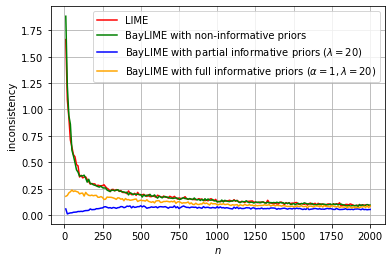

In [23]:
import matplotlib.pyplot as plt
x_index=np.array([])
i=10
while i<=2000:
    x_index=np.append(x_index,i)
    i=i+10
    

plt.plot(x_index,inconsistency_non_Bay,linestyle='-',color='red',label='LIME')
plt.plot(x_index,inconsistency_non_info,linestyle='-',color='green',label='BayLIME with non-informative priors')
plt.plot(x_index,inconsistency_info_prior_fit_alpha,linestyle='-',color='blue',label=r'BayLIME with partial informative priors ($\lambda=20$)')
plt.plot(x_index,inconsistency_full_info_prior,linestyle='-',color='orange',label=r'BayLIME with full informative priors ($\alpha=1,\lambda=20$)')

#plt.xscale('log')
plt.legend(loc='upper right',fontsize=10)#bbox_to_anchor=(1,1)
#plt.axis([10, 300, 0,10])# set the ranges of axis
plt.xlabel('$n$')
plt.ylabel('inconsistency')
plt.grid(True)

plt.show()

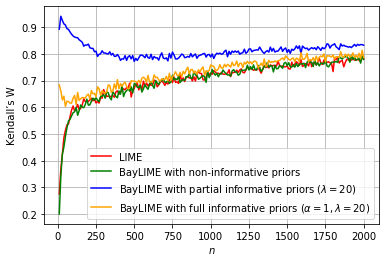

In [24]:
plt.plot(x_index,ken_w_non_Bay,linestyle='-',color='red',label='LIME')
plt.plot(x_index,ken_w_non_info,linestyle='-',color='green',label='BayLIME with non-informative priors')
plt.plot(x_index,ken_w_info_prior_fit_alpha,linestyle='-',color='blue',label=r'BayLIME with partial informative priors ($\lambda=20$)')
plt.plot(x_index,ken_w_full_info_prior,linestyle='-',color='orange',label=r'BayLIME with full informative priors ($\alpha=1,\lambda=20$)')

#plt.xscale('log')
plt.legend(fontsize=10)#bbox_to_anchor=(1,1) ,loc='upper right'
#plt.axis([10, 300, 0,10])# set the ranges of axis
plt.xlabel('$n$')
plt.ylabel('Kendall’s W')
plt.grid(True)

plt.show()